<a href="https://colab.research.google.com/github/danieletirinnanzi/HUPLACLIP-NNs/blob/main/PlantedClique_NeuralNets.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torchvision
import torch.nn as nn
import torchvision.transforms as transforms
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn.functional as F
import math
from google.colab import files

from __future__ import print_function
from __future__ import division
from torchvision import datasets, models, transforms
import time
import os
import copy

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


We define the function that generates the adjacency matrices with and without the cliques. The default probability to get a graph with a clique is  50 . The adjacency matrices in this case represents an Erdos-Renyi graph where the probability  p  to have an edge between two nodes is such that both the graph with and without the planted clique have the same average degree ( p=0.5  by default).

In [ ]:
def Plant(A,k,n):
  A[:k,:k] = torch.ones(k,k)
  r = torch.randperm(n)
  A = A[r[:, None], r]
  return A

def PlantedClique(n,p,k,on_off,hidden):
  if (on_off == 0):
    p_off = p
    A = torch.bernoulli(p_off*torch.ones(n,n))
    A_up = torch.triu(A)
    A = A_up + torch.transpose(A_up, 0, 1)
    A.fill_diagonal_(1)
    return [A,on_off]
  if (on_off == 1):
    if (hidden == 1):
      p_on = p - (1-p)*(k*(k-1))/(n*(n-1))
    else:
      p_on = p
    B = torch.bernoulli(p_on*torch.ones(n,n))
    B_up = torch.triu(B)
    B = B_up + torch.transpose(B_up, 0, 1)
    B.fill_diagonal_(1)
    C = Plant(B,k,n)
    return C,on_off

def GetClique(m,n,k,p=0.5,prob=0.5,hidden = 1):
  on_off = torch.bernoulli(prob*torch.ones(m))
  data = torch.zeros(m,1,n,n)
  for i in range(m):
    data[i][0] = PlantedClique(n,p,k,on_off[i],hidden)[0]
  return data,on_off.type(torch.long).tolist()

# Multilayer Perceptrons (MLPs)

Here we define the MLPs. The meaning of each parameter is explained below. This network works only with graphs of a certain size (in this case $n=60$), a different graph needs a slightely different architecture. There is also an early stopping function, which stops if the validation error starts to increase for several steps.

The architecture is made by stacking many layers of neurons of different sizes. The optimizier is Adam and the loss is the CrossEntropy.

In [ ]:
dim = 100                # graph dimension
lr_rate=0.01            # learning rate
l1=1000                    # number of neurons in the first layer
l2=500                   # number of neurons in the second layer
l3=100                   # number of neurons in the third layer
l4=20                   # number of neurons in the fourth layer
d=0.2                   # dropout probability

#function for the early stopping
def EarlyStopper(validation_loss, counter, min_validation_loss, past=0, patience=0, min_delta=0.01):
        length = validation_loss.shape[0]
        if np.mean(validation_loss[length-past:]) < min_validation_loss and length > past:
            min_validation_loss = np.mean(validation_loss[length-past:])
            counter = 0
        elif np.mean(validation_loss[length-past:]) > (min_validation_loss + min_delta) and length > past:
            counter += 1
            if counter >= patience:
                return True, min_validation_loss, counter
        return False, min_validation_loss, counter

model_d = nn.Sequential(
    nn.Flatten(),
    nn.Linear(dim*dim,l1),
    nn.BatchNorm1d(l1),
    nn.ReLU(),
    nn.Dropout(d),
    nn.Linear(l1,l2),
    nn.BatchNorm1d(l2),
    nn.ReLU(),
    nn.Dropout(d),
    nn.Linear(l2,l3),
    nn.BatchNorm1d(l3),
    nn.ReLU(),
    nn.Linear(l3,2),
    nn.BatchNorm1d(2),
    nn.ReLU(),
)

optim=torch.optim.Adam(model_d.parameters())   # optimization with Adam
criterion = nn.CrossEntropyLoss()            # criterion = Cross Entropy
model_d.to(device)

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=10000, out_features=1000, bias=True)
  (2): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): ReLU()
  (4): Dropout(p=0.2, inplace=False)
  (5): Linear(in_features=1000, out_features=500, bias=True)
  (6): BatchNorm1d(500, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): ReLU()
  (8): Dropout(p=0.2, inplace=False)
  (9): Linear(in_features=500, out_features=100, bias=True)
  (10): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU()
  (12): Linear(in_features=100, out_features=2, bias=True)
  (13): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (14): ReLU()
)

The following is the traing procedure. It works in the following way: at each epoch we generate a batch of training samples. Then we train the network with this batch and check the validation error. This online generation of batches ensures a faster training.

Eventually we also plot the generalization error versus the parameter $k/n$.

If you want to run the code test with small number of epochs, small max_step or smaller samples; the code takes very long.

Training = 0.0 %


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


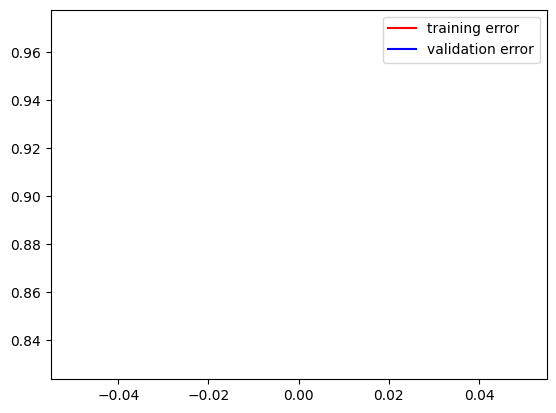

--------------------------------------------
Training = 16.666666666666668 %


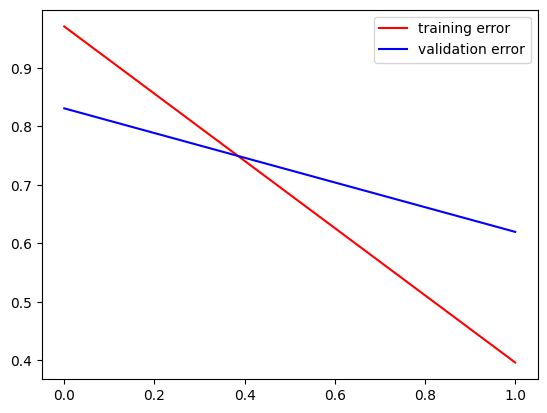

--------------------------------------------
Training = 33.333333333333336 %


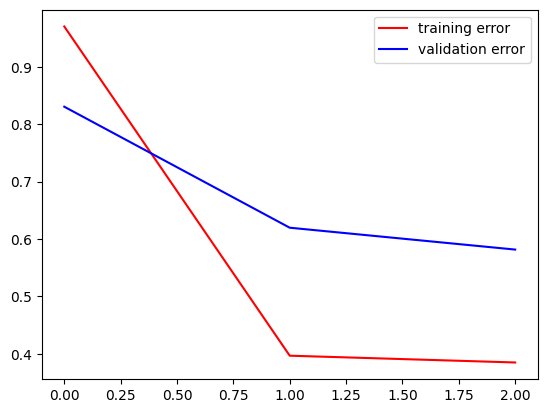

--------------------------------------------
Training = 50.0 %


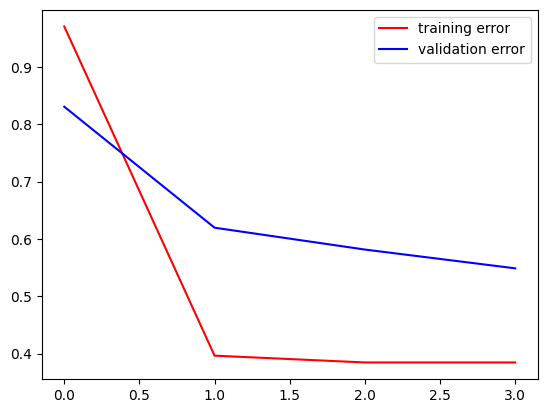

--------------------------------------------
Training = 66.66666666666667 %


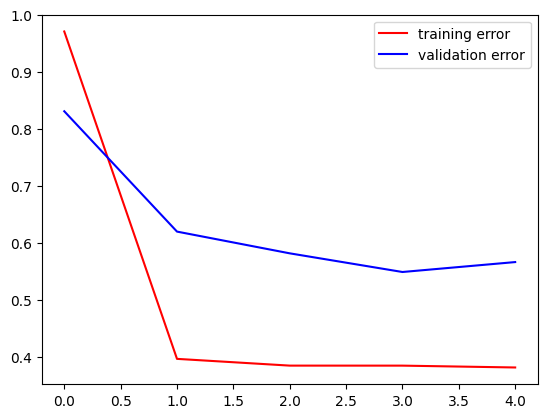

--------------------------------------------
Training = 83.33333333333333 %


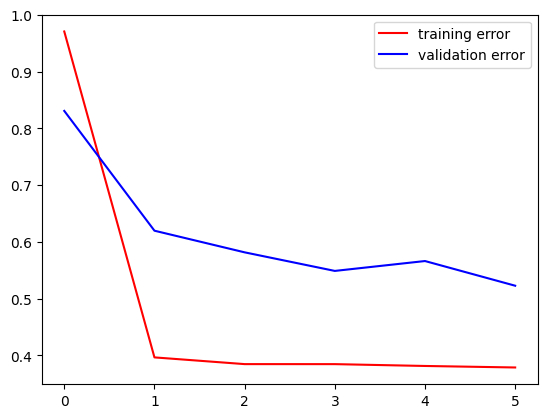

--------------------------------------------
epoch = 0
dim_clique = 50
training error = 0.3787577748298645
validation error = 0.5227760672569275
test error = 0.6505886316299438
--------------------------------------------
Training = 0.0 %


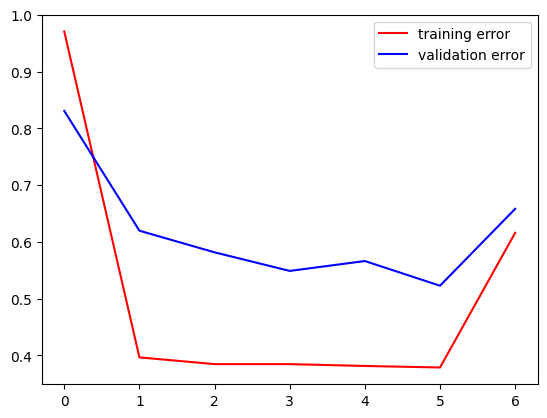

--------------------------------------------
Training = 16.666666666666668 %


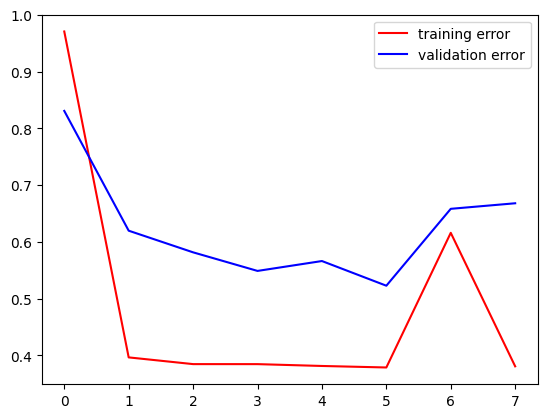

--------------------------------------------
Training = 33.333333333333336 %


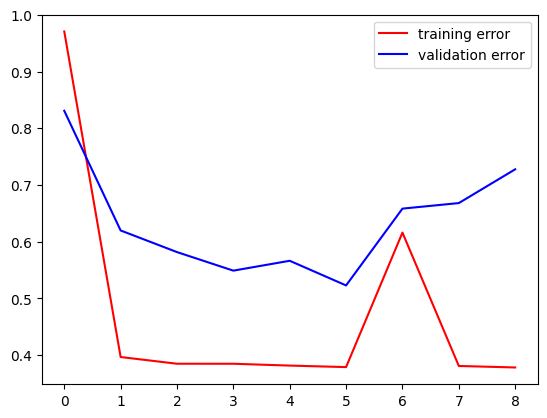

--------------------------------------------
Training = 50.0 %


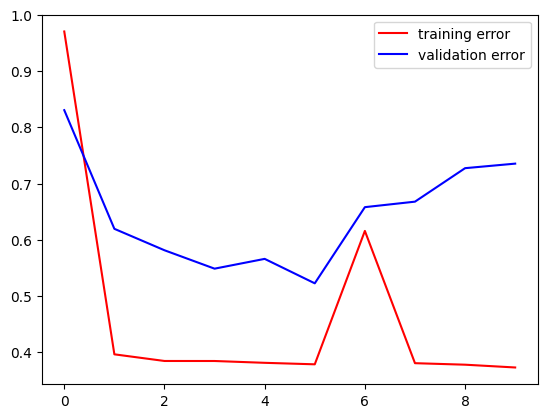

--------------------------------------------
Training = 66.66666666666667 %


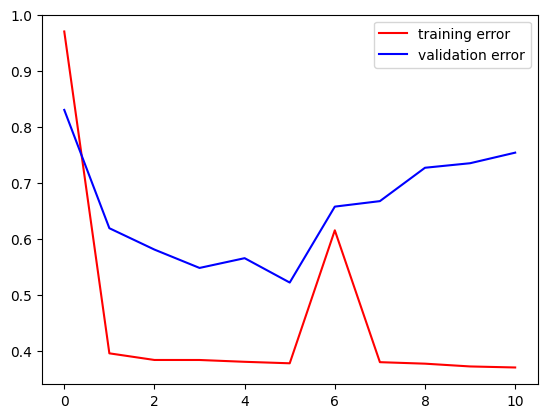

--------------------------------------------
Training = 83.33333333333333 %


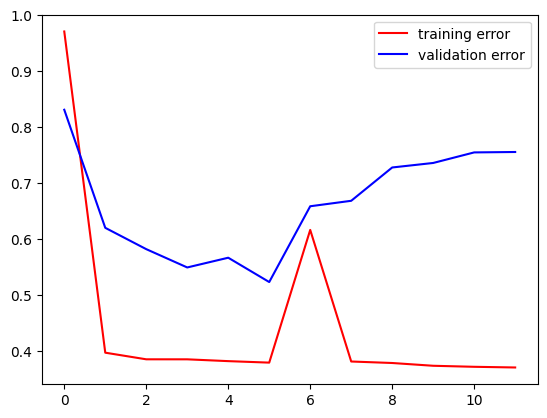

--------------------------------------------
epoch = 1
dim_clique = 50
training error = 0.3700811266899109
validation error = 0.755205512046814
test error = 0.4987313151359558
--------------------------------------------
Training = 0.0 %


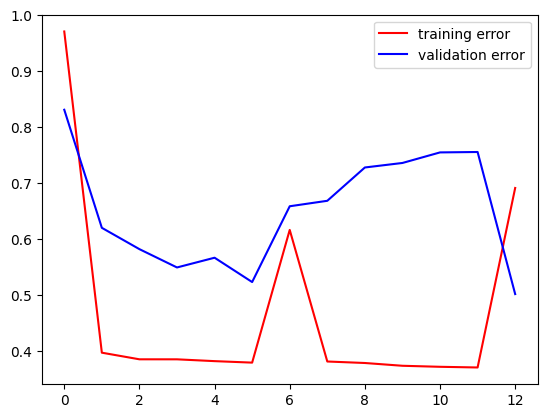

--------------------------------------------
Training = 16.666666666666668 %


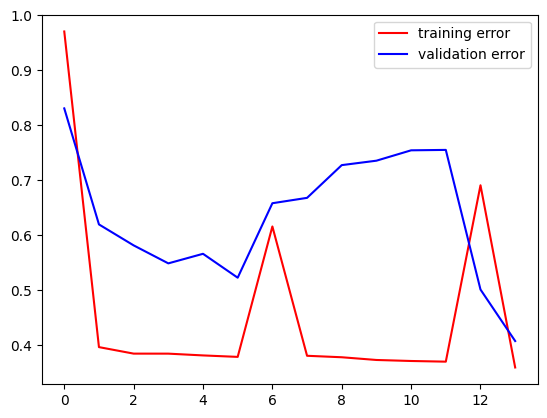

--------------------------------------------
Training = 33.333333333333336 %


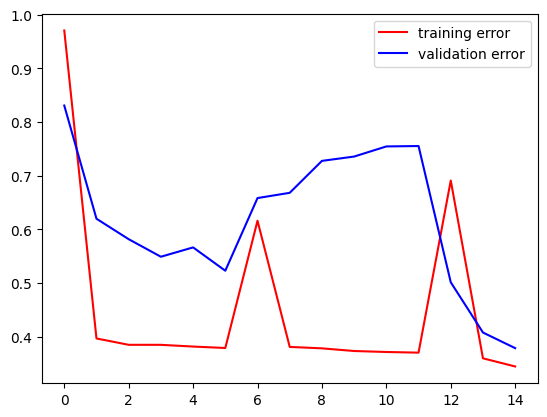

--------------------------------------------
Training = 50.0 %


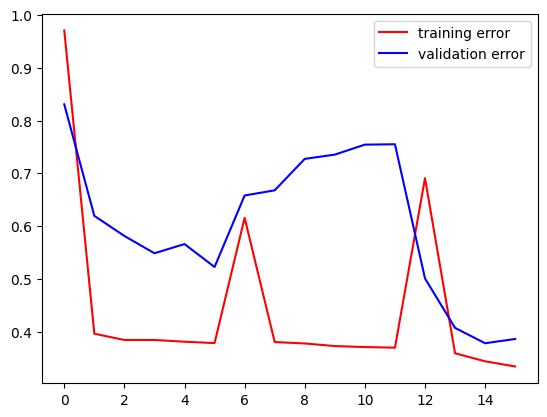

--------------------------------------------
Training = 66.66666666666667 %


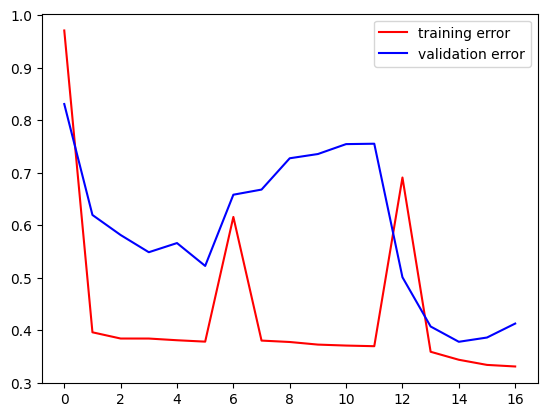

--------------------------------------------
Training = 83.33333333333333 %


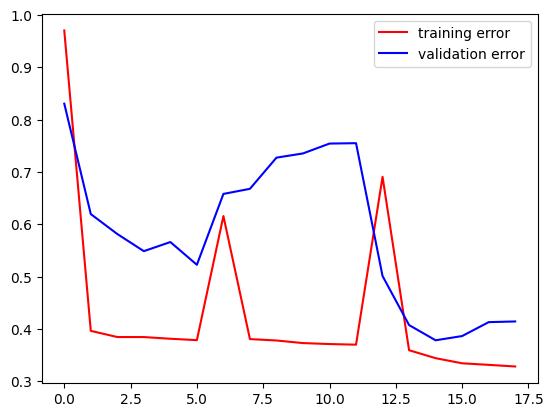

--------------------------------------------
epoch = 2
dim_clique = 50
training error = 0.3284270465373993
validation error = 0.41448354721069336
test error = 0.6825414299964905
--------------------------------------------
Training = 0.0 %


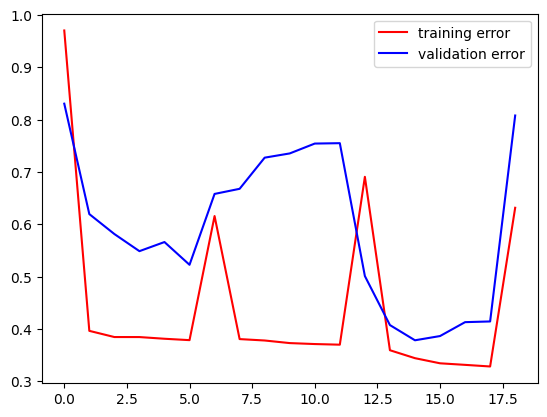

--------------------------------------------
Training = 16.666666666666668 %


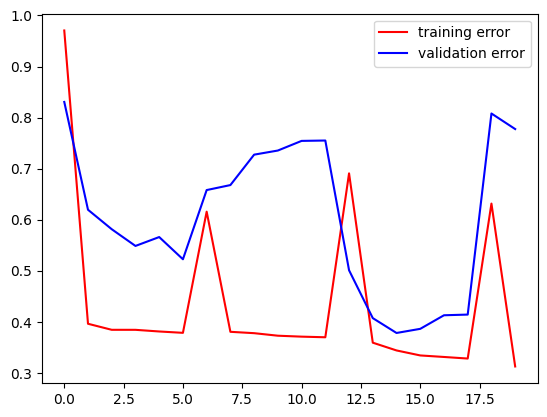

--------------------------------------------
Training = 33.333333333333336 %


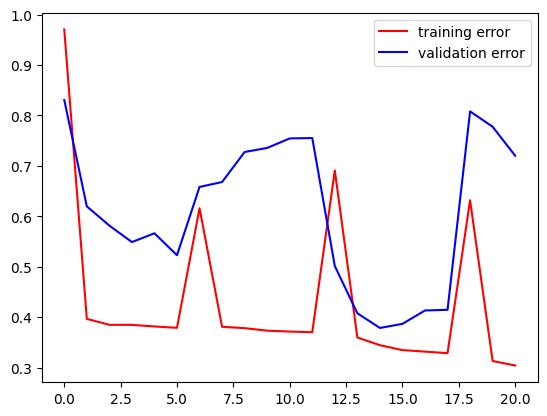

--------------------------------------------
Training = 50.0 %


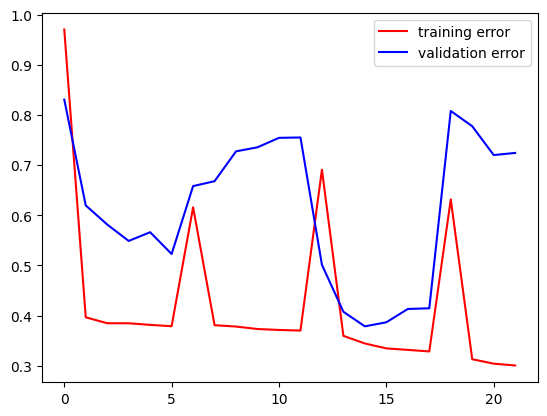

--------------------------------------------
Training = 66.66666666666667 %


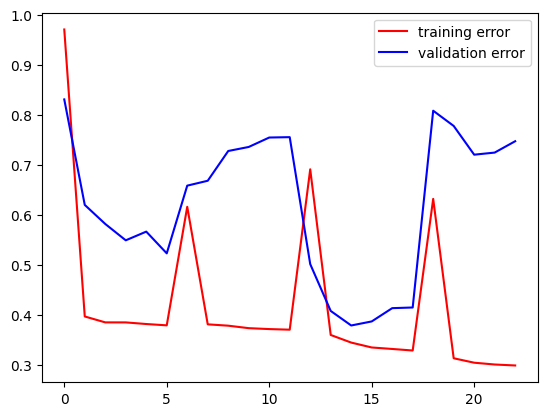

--------------------------------------------
Training = 83.33333333333333 %


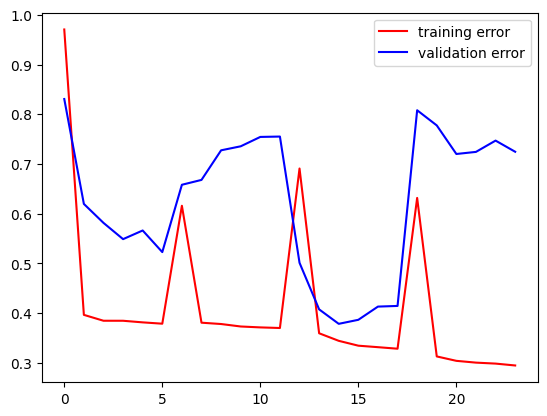

--------------------------------------------
epoch = 3
dim_clique = 50
training error = 0.2946973145008087
validation error = 0.7246166467666626
test error = 0.8807666897773743
--------------------------------------------
Training = 0.0 %


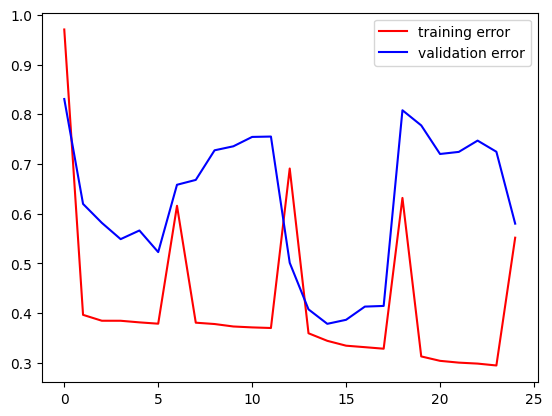

--------------------------------------------
Training = 16.666666666666668 %


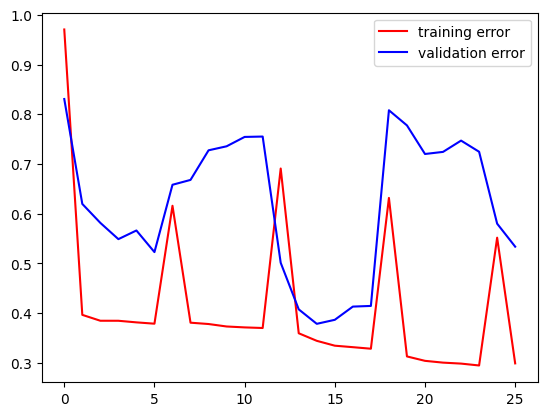

--------------------------------------------
Training = 33.333333333333336 %


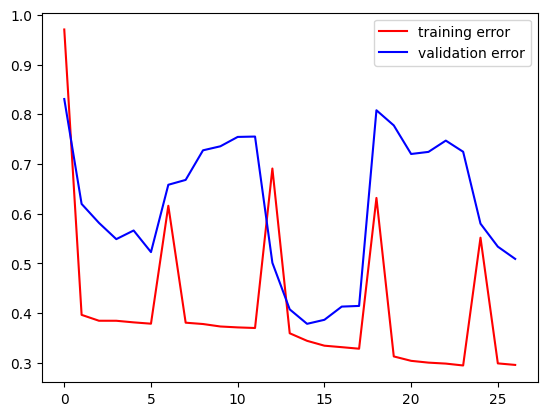

--------------------------------------------
Training = 50.0 %


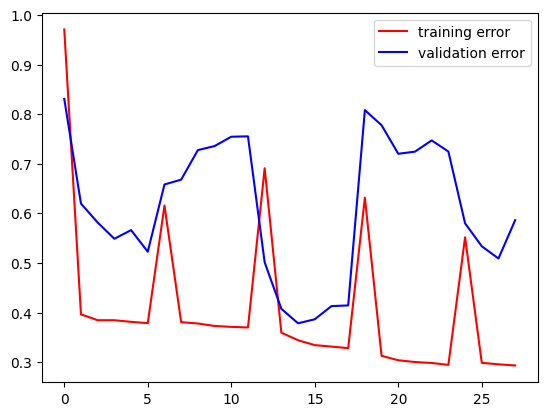

--------------------------------------------
Training = 66.66666666666667 %


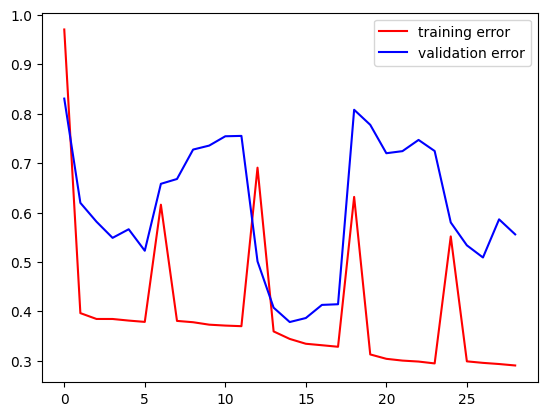

--------------------------------------------
Training = 83.33333333333333 %


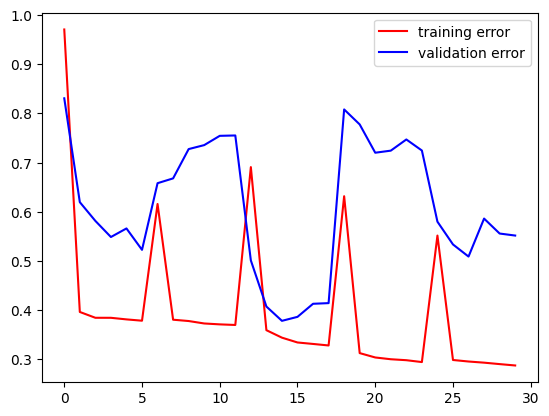

--------------------------------------------
epoch = 4
dim_clique = 50
training error = 0.2877580225467682
validation error = 0.5518041849136353
test error = 0.8422337770462036
--------------------------------------------
Training = 0.0 %


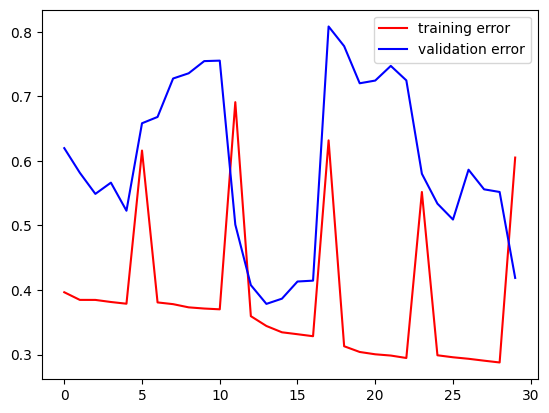

--------------------------------------------
Training = 16.666666666666668 %


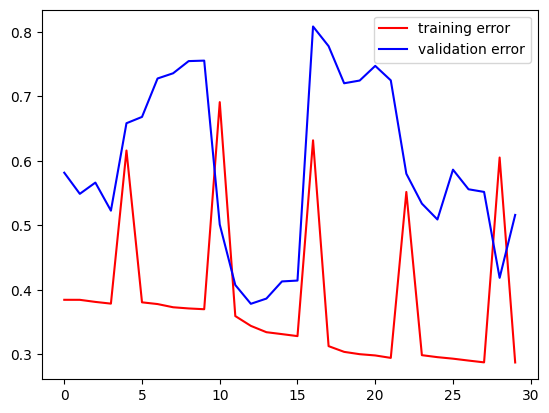

--------------------------------------------
Training = 33.333333333333336 %


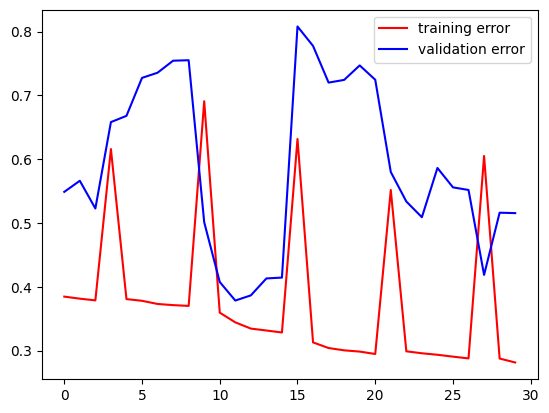

--------------------------------------------
Training = 50.0 %


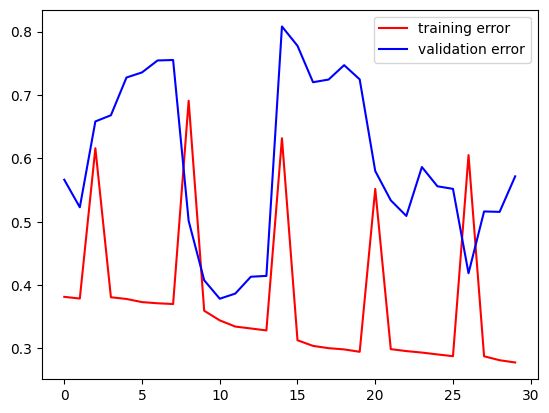

--------------------------------------------
Training = 66.66666666666667 %


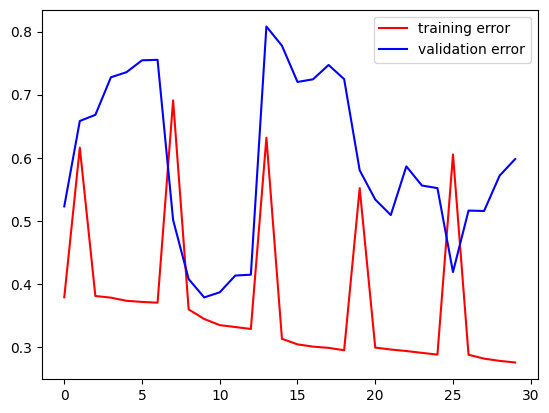

--------------------------------------------
Training = 83.33333333333333 %


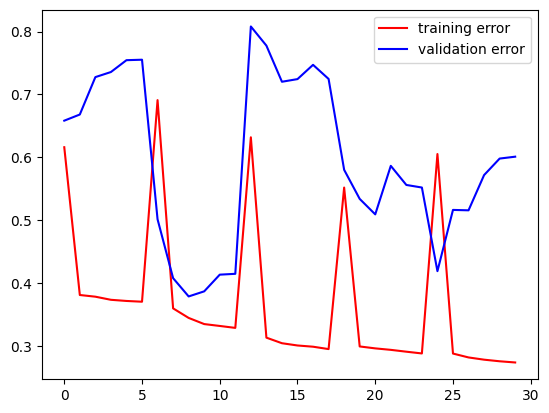

--------------------------------------------
epoch = 5
dim_clique = 50
training error = 0.2733868956565857
validation error = 0.6008893251419067
test error = 0.6588441133499146
--------------------------------------------
Training = 0.0 %


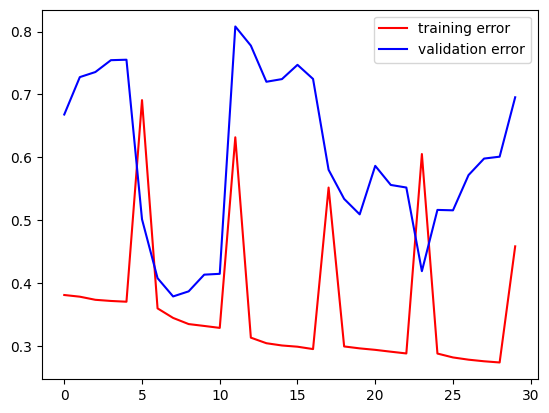

--------------------------------------------
Training = 16.666666666666668 %


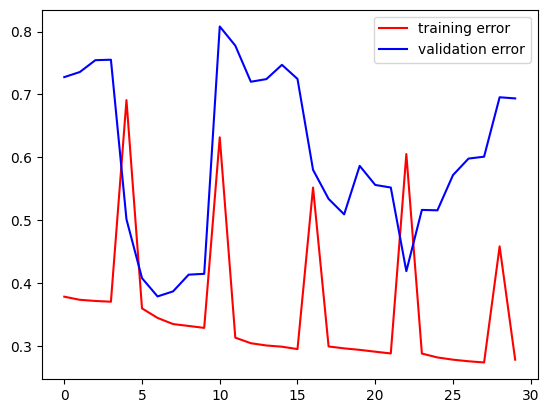

--------------------------------------------
Training = 33.333333333333336 %


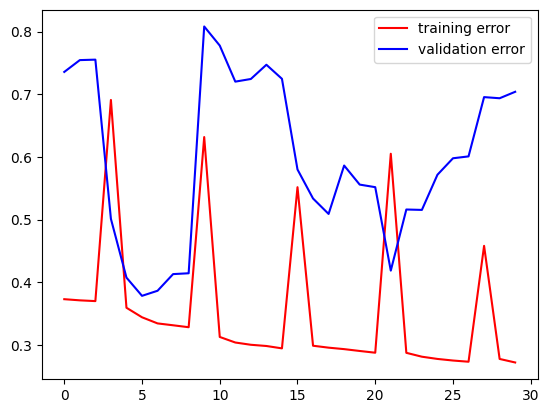

--------------------------------------------
Training = 50.0 %


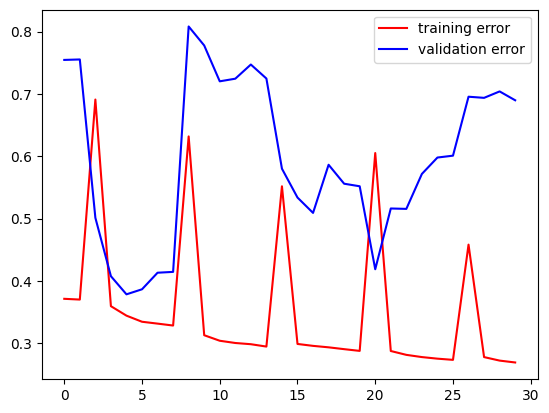

--------------------------------------------
Training = 66.66666666666667 %


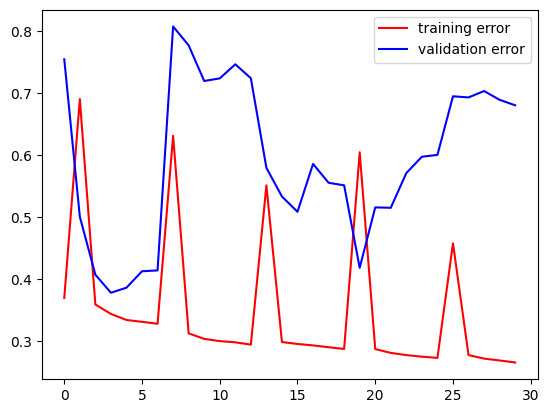

--------------------------------------------
Training = 83.33333333333333 %


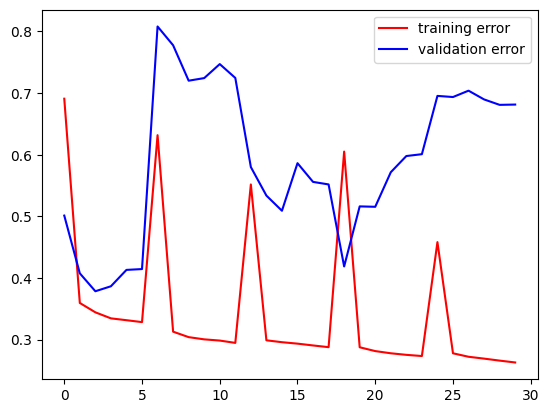

--------------------------------------------
epoch = 6
dim_clique = 50
training error = 0.26292091608047485
validation error = 0.6813994646072388
test error = 0.6474910974502563
--------------------------------------------
Training = 0.0 %


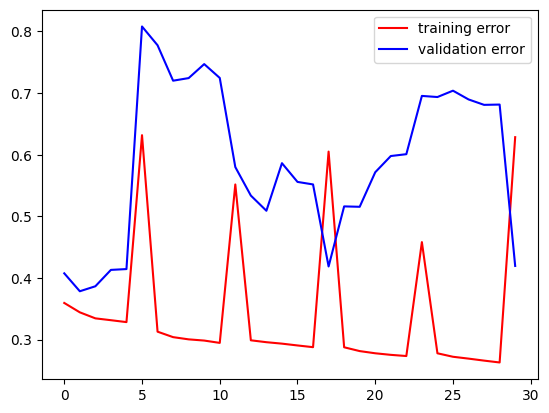

--------------------------------------------
Training = 16.666666666666668 %


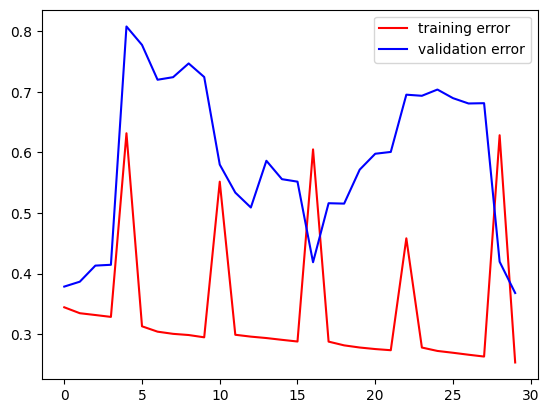

--------------------------------------------
Training = 33.333333333333336 %


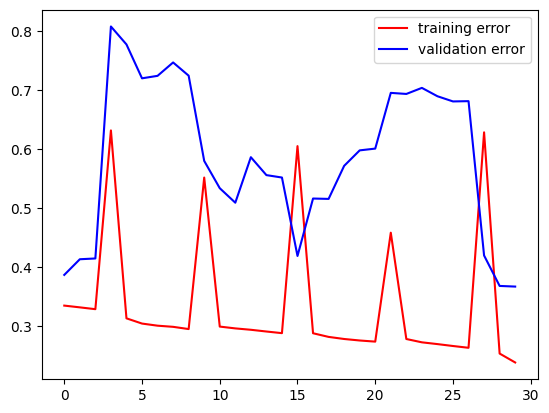

--------------------------------------------
Training = 50.0 %


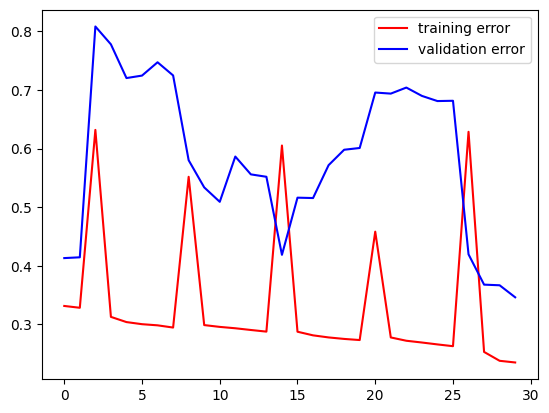

--------------------------------------------
Training = 66.66666666666667 %


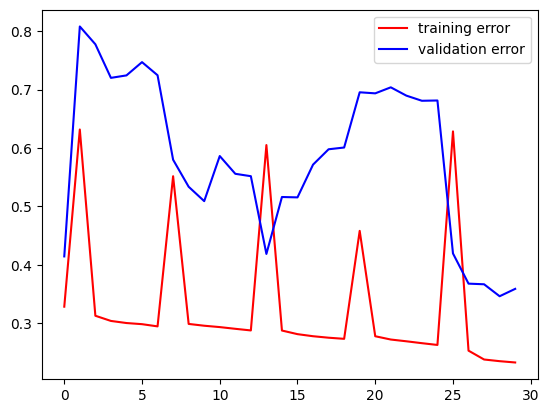

--------------------------------------------
Training = 83.33333333333333 %


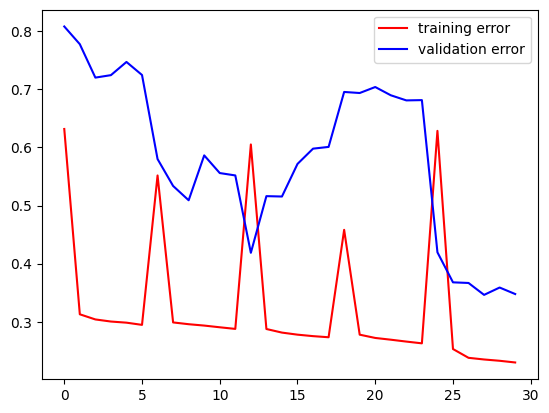

--------------------------------------------
epoch = 7
dim_clique = 50
training error = 0.22998473048210144
validation error = 0.3477652072906494
test error = 0.6476500630378723
--------------------------------------------
Training = 0.0 %


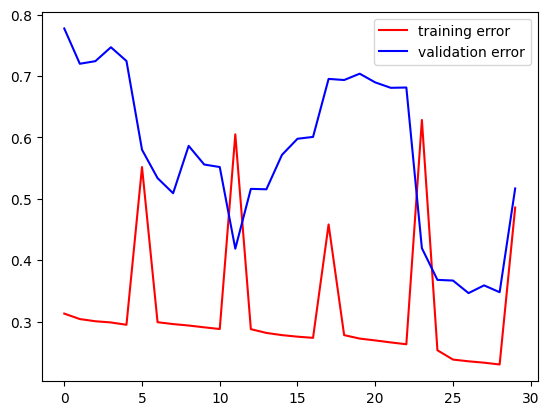

--------------------------------------------
Training = 16.666666666666668 %


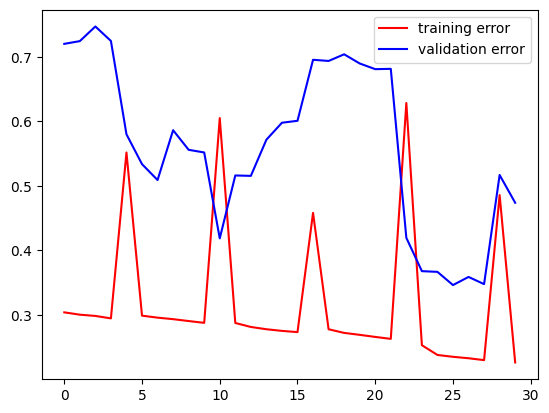

--------------------------------------------
Training = 33.333333333333336 %


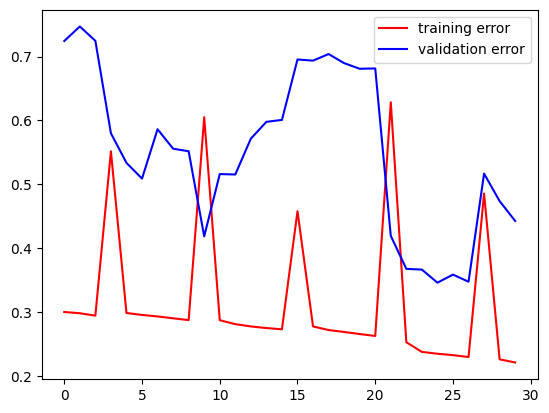

--------------------------------------------
Training = 50.0 %


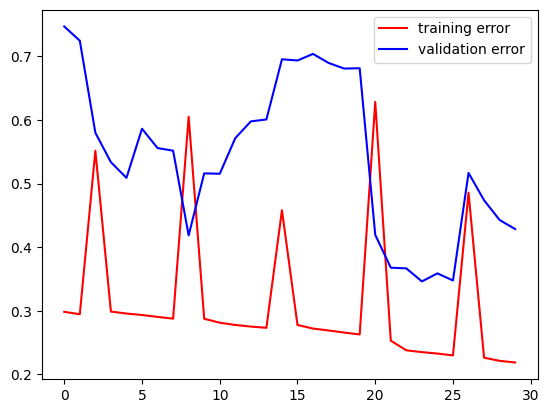

--------------------------------------------
Training = 66.66666666666667 %


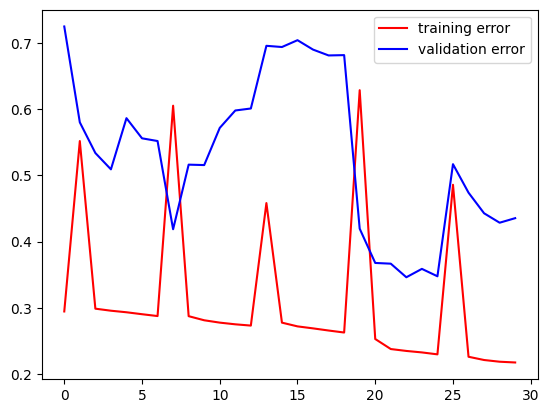

--------------------------------------------
Training = 83.33333333333333 %


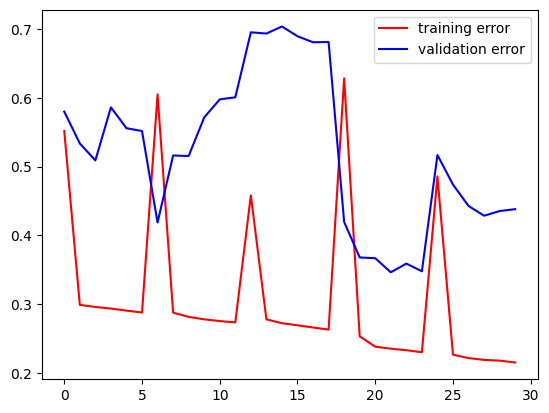

--------------------------------------------
epoch = 8
dim_clique = 50
training error = 0.21507468819618225
validation error = 0.4381171762943268
test error = 0.5472878217697144
--------------------------------------------
Training = 0.0 %


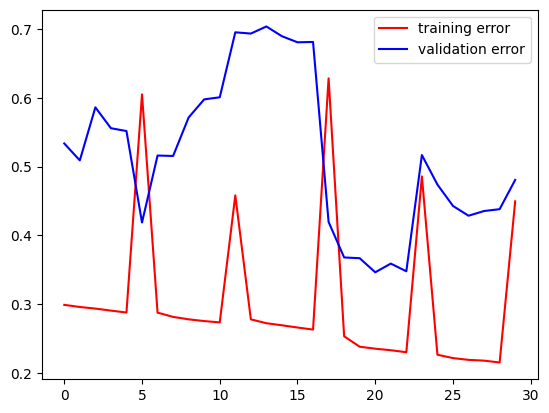

--------------------------------------------
Training = 16.666666666666668 %


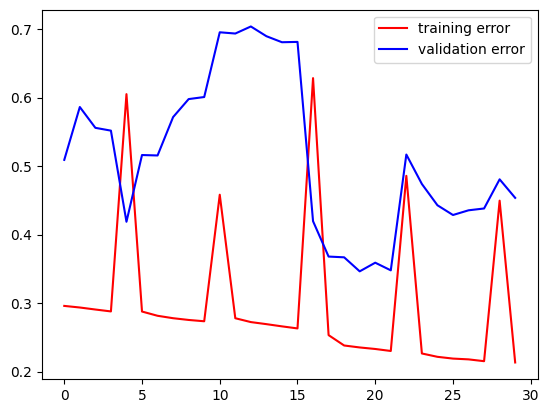

--------------------------------------------
Training = 33.333333333333336 %


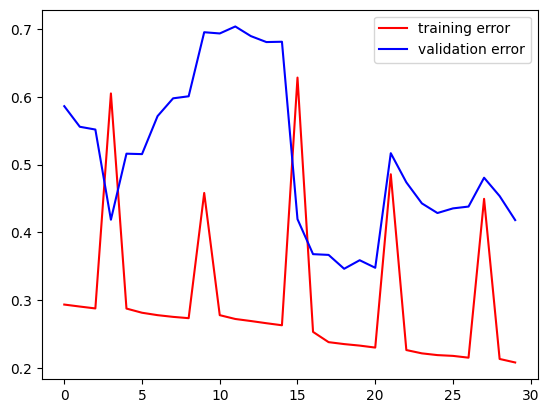

--------------------------------------------
Training = 50.0 %


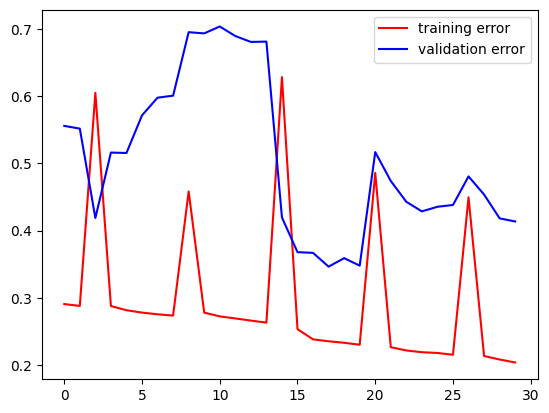

--------------------------------------------
Training = 66.66666666666667 %


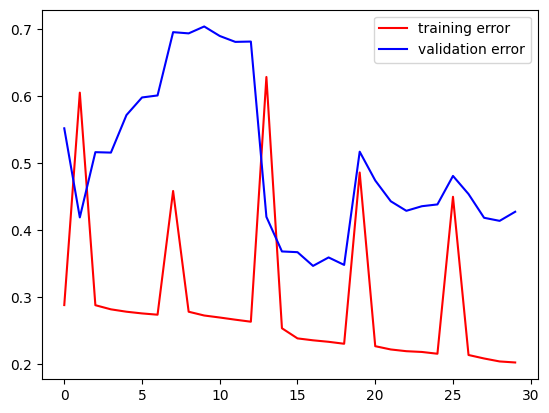

--------------------------------------------
Training = 83.33333333333333 %


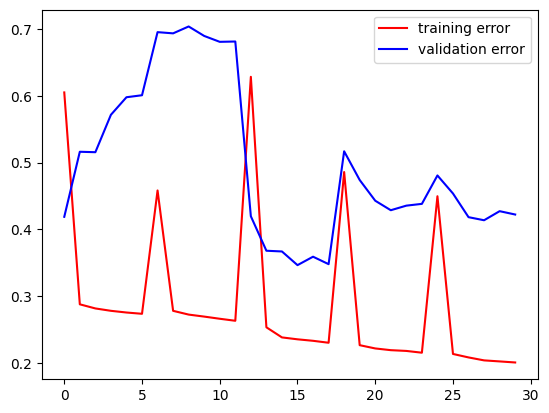

--------------------------------------------
epoch = 9
dim_clique = 50
training error = 0.20042690634727478
validation error = 0.4221456050872803
test error = 0.5163677334785461
--------------------------------------------
Training = 0.0 %


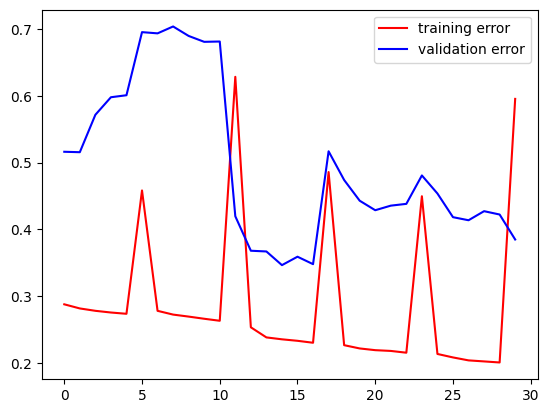

--------------------------------------------
Training = 16.666666666666668 %


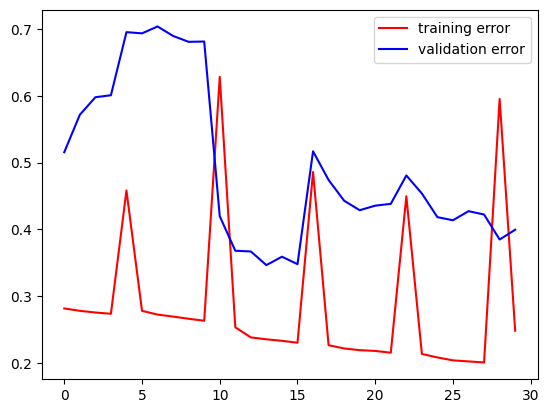

--------------------------------------------
Training = 33.333333333333336 %


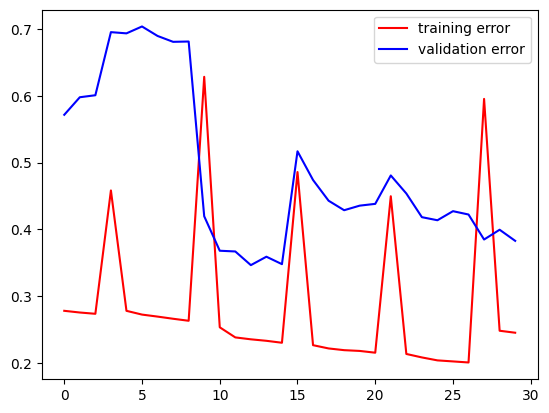

--------------------------------------------
Training = 50.0 %


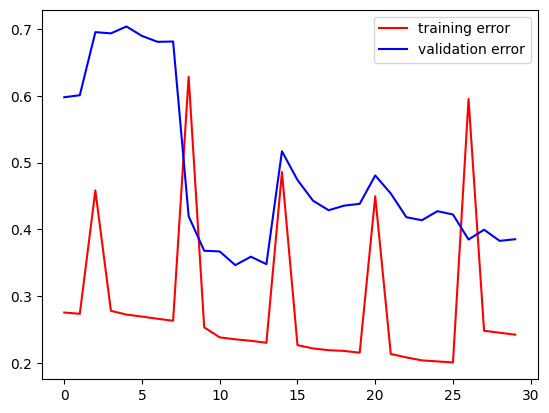

--------------------------------------------
Training = 66.66666666666667 %


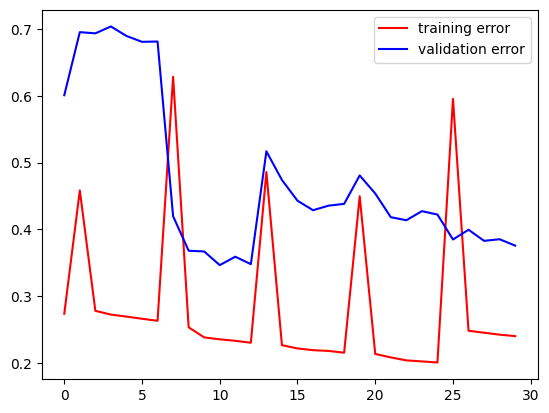

--------------------------------------------
Training = 83.33333333333333 %


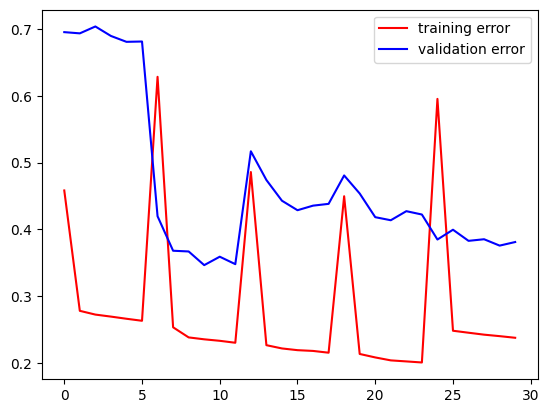

--------------------------------------------
epoch = 10
dim_clique = 50
training error = 0.23743636906147003
validation error = 0.3809201121330261
test error = 0.4780876040458679
--------------------------------------------
Training = 0.0 %


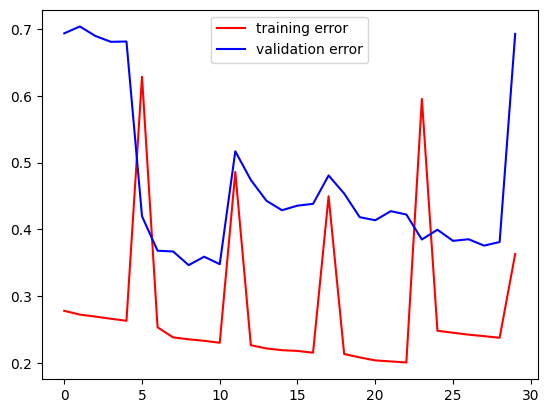

--------------------------------------------
Training = 16.666666666666668 %


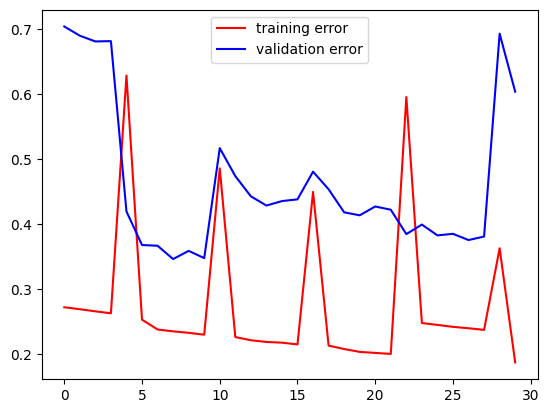

--------------------------------------------
Training = 33.333333333333336 %


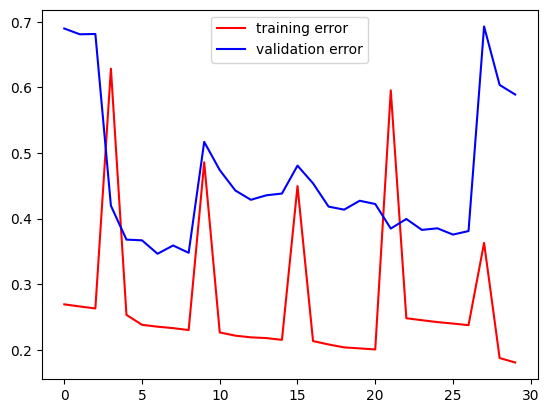

--------------------------------------------
Training = 50.0 %


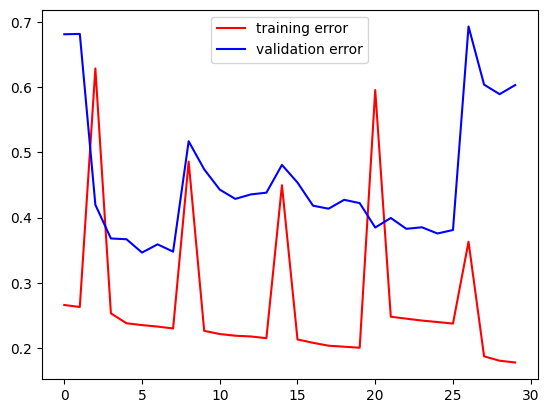

--------------------------------------------
Training = 66.66666666666667 %


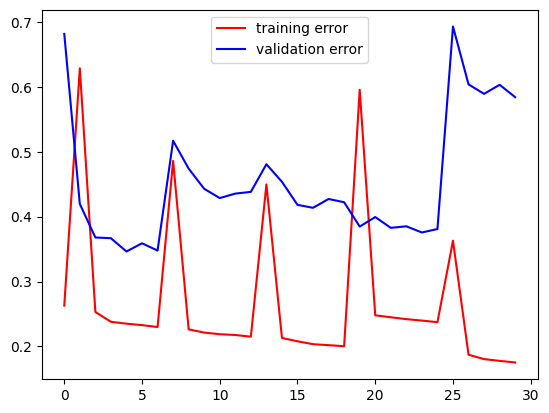

--------------------------------------------
Training = 83.33333333333333 %


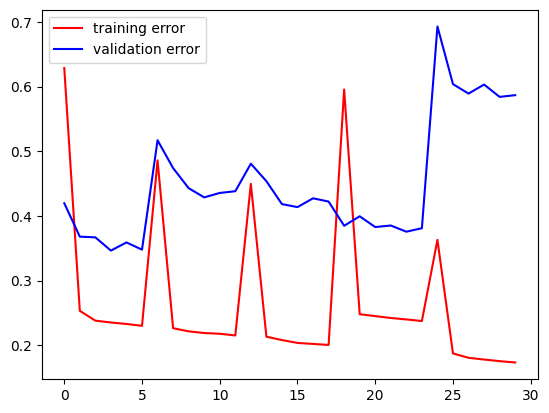

--------------------------------------------
epoch = 11
dim_clique = 50
training error = 0.17332662642002106
validation error = 0.5866460800170898
test error = 0.5383864641189575
--------------------------------------------
Training = 0.0 %


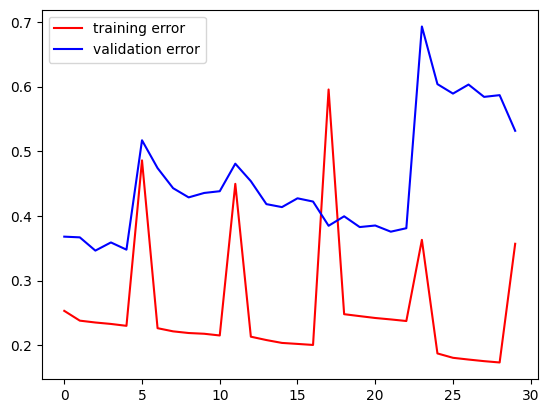

--------------------------------------------
Training = 16.666666666666668 %


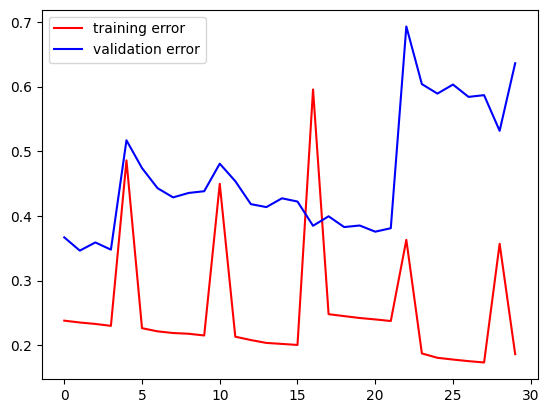

--------------------------------------------
Training = 33.333333333333336 %


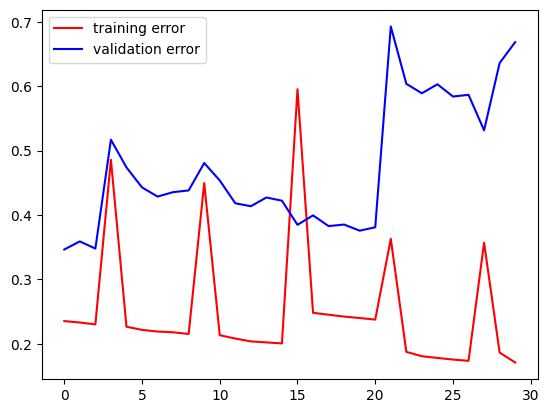

--------------------------------------------
Training = 50.0 %


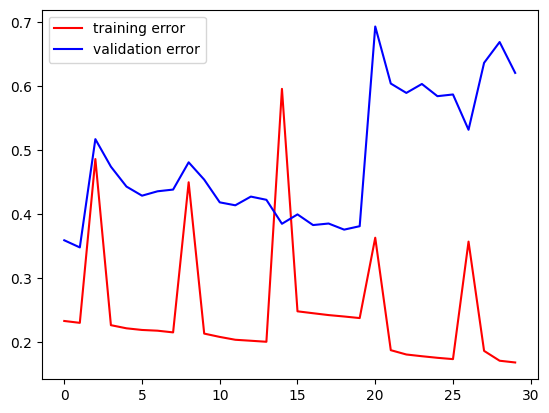

--------------------------------------------
Training = 66.66666666666667 %


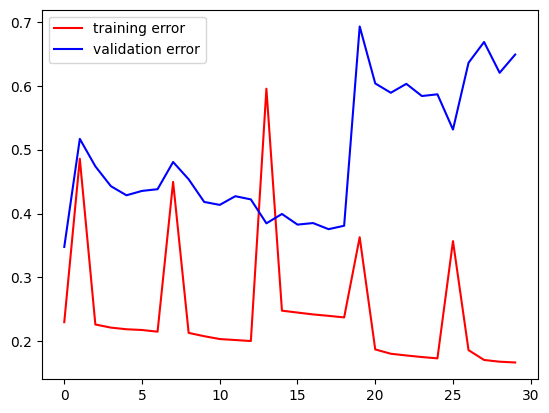

--------------------------------------------
Training = 83.33333333333333 %


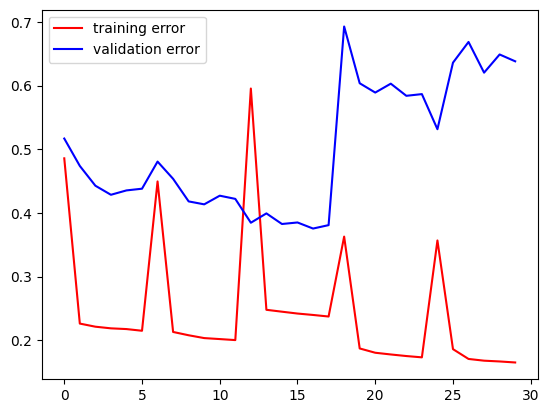

--------------------------------------------
epoch = 12
dim_clique = 50
training error = 0.16527368128299713
validation error = 0.6381531953811646
test error = 0.6091374754905701
--------------------------------------------
Training = 0.0 %


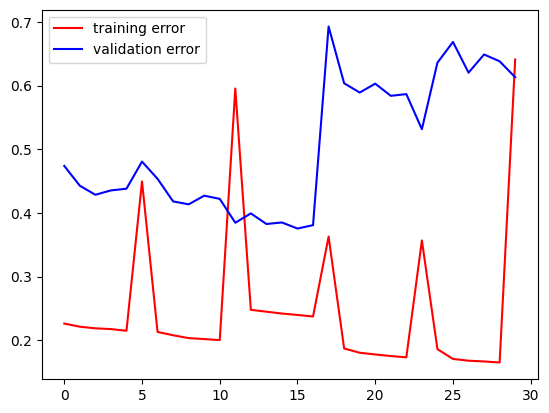

--------------------------------------------
Training = 16.666666666666668 %


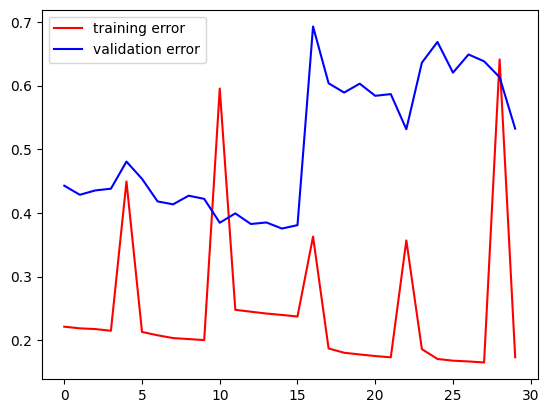

--------------------------------------------
Training = 33.333333333333336 %


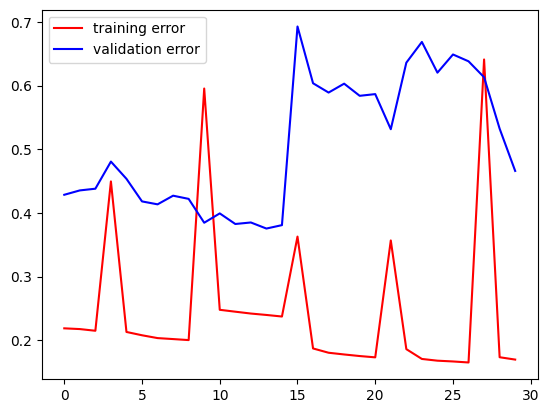

--------------------------------------------
Training = 50.0 %


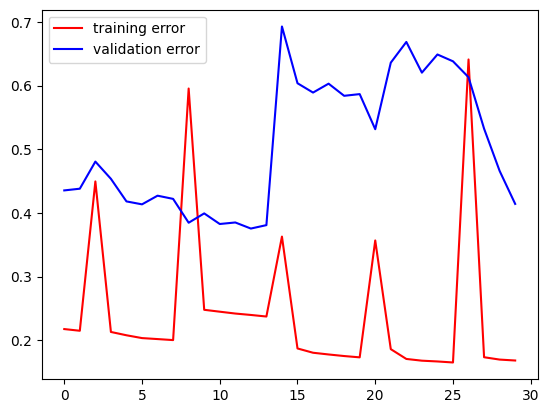

--------------------------------------------
Training = 66.66666666666667 %


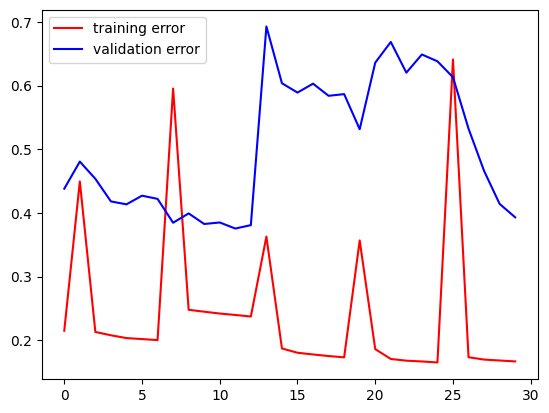

--------------------------------------------
Training = 83.33333333333333 %


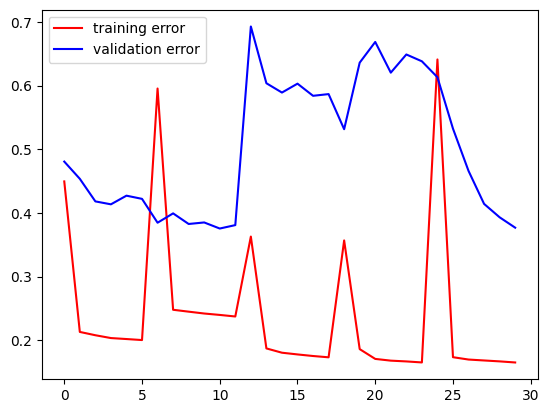

--------------------------------------------
epoch = 13
dim_clique = 50
training error = 0.16521814465522766
validation error = 0.37690016627311707
test error = 0.5261141657829285
--------------------------------------------
Training = 0.0 %


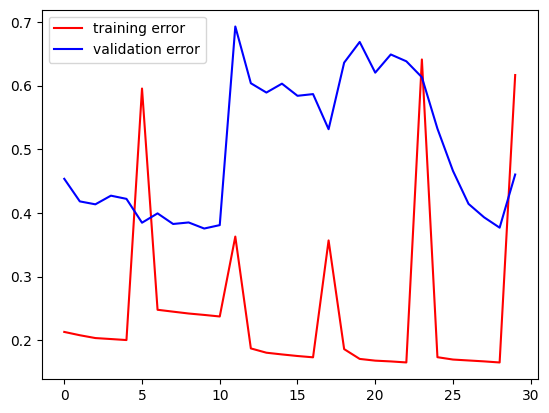

--------------------------------------------
Training = 16.666666666666668 %


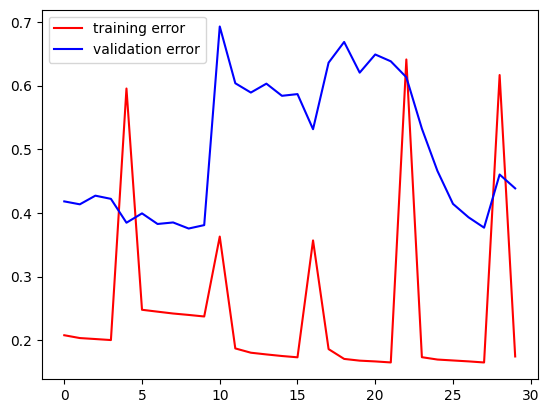

--------------------------------------------
Training = 33.333333333333336 %


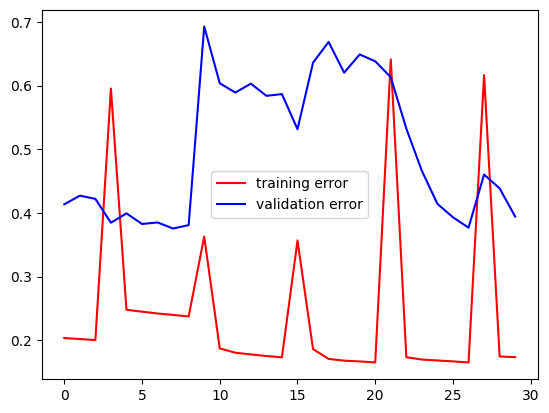

--------------------------------------------
Training = 50.0 %


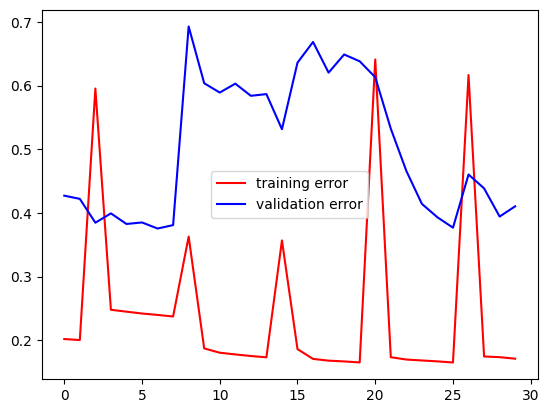

--------------------------------------------
Training = 66.66666666666667 %


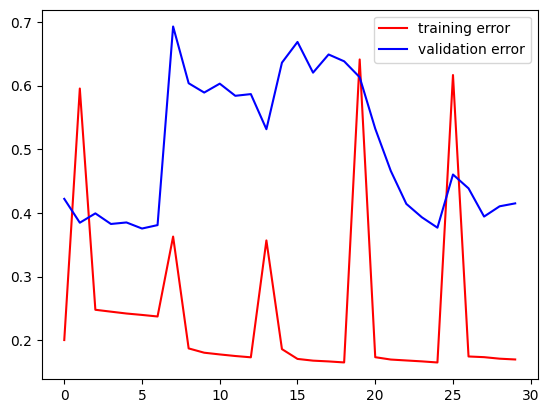

--------------------------------------------
Training = 83.33333333333333 %


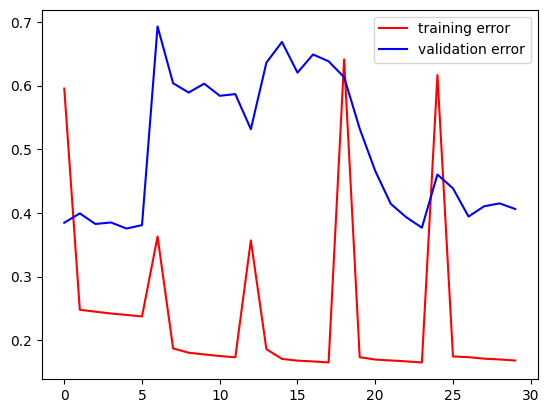

--------------------------------------------
epoch = 14
dim_clique = 50
training error = 0.16830477118492126
validation error = 0.4062279760837555
test error = 0.4088052213191986
--------------------------------------------
Training = 0.0 %


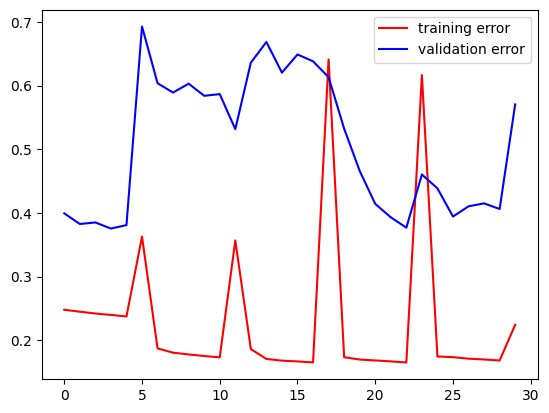

--------------------------------------------
Training = 16.666666666666668 %


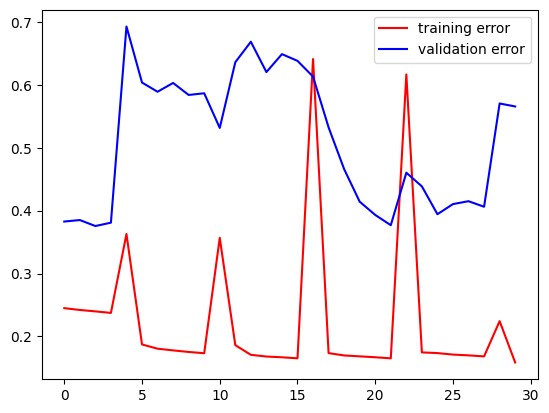

--------------------------------------------
Training = 33.333333333333336 %


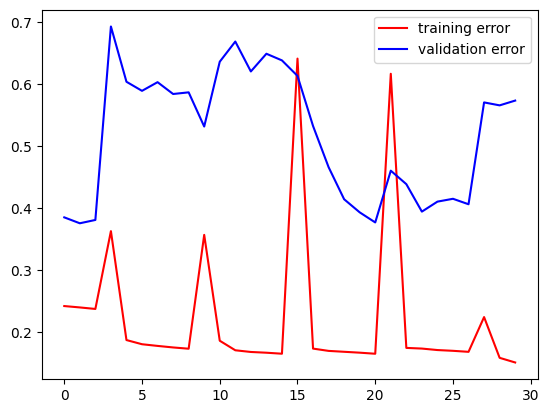

--------------------------------------------
Training = 50.0 %


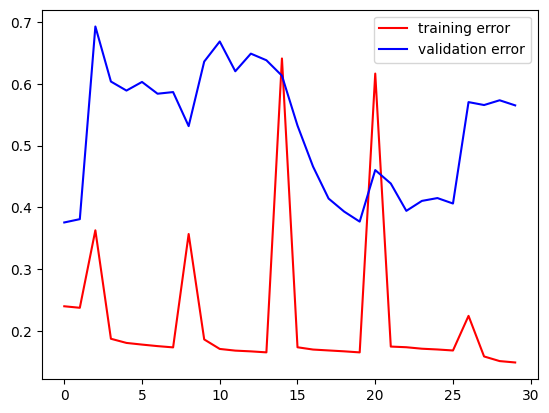

--------------------------------------------
Training = 66.66666666666667 %


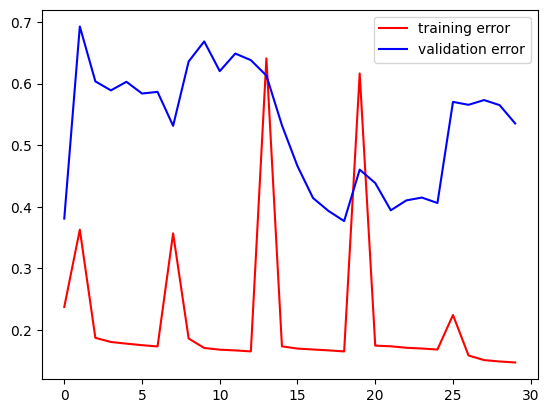

--------------------------------------------
Training = 83.33333333333333 %


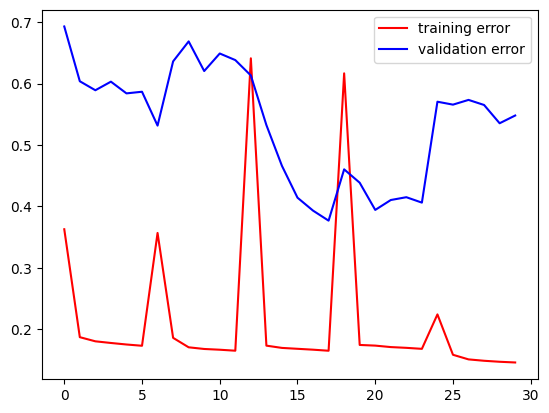

--------------------------------------------
epoch = 15
dim_clique = 50
training error = 0.14612285792827606
validation error = 0.5479509830474854
test error = 0.44985508918762207
--------------------------------------------
Training = 0.0 %


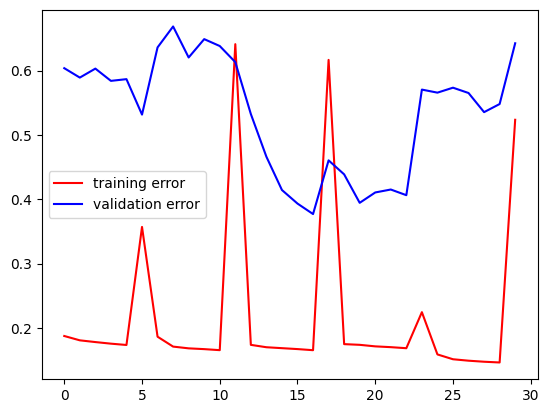

--------------------------------------------
Training = 16.666666666666668 %


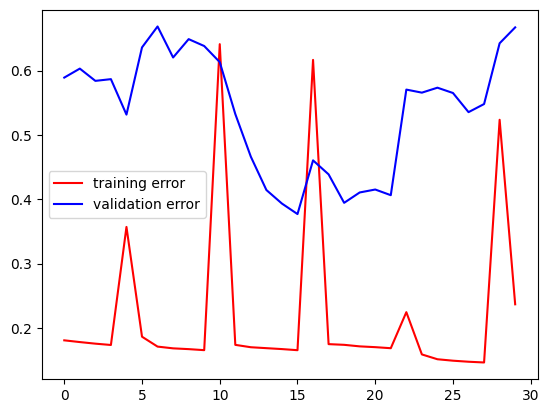

--------------------------------------------
Training = 33.333333333333336 %


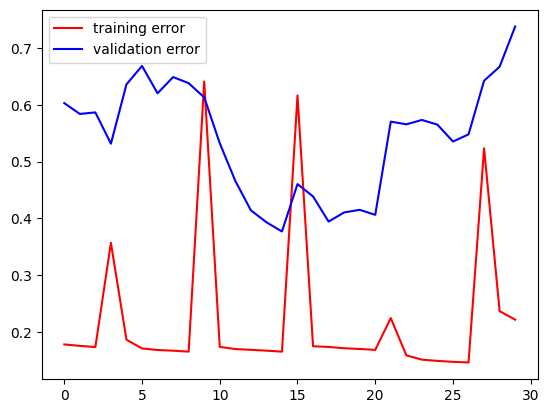

--------------------------------------------
Training = 50.0 %


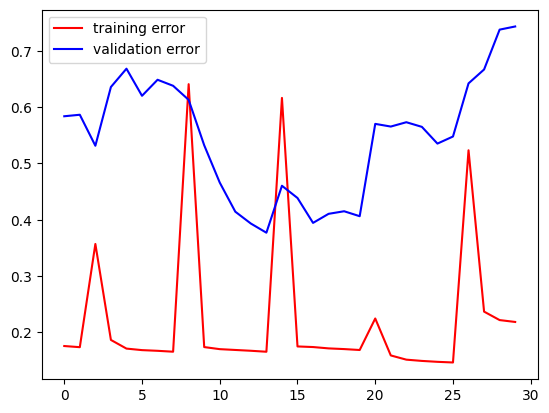

--------------------------------------------
Training = 66.66666666666667 %


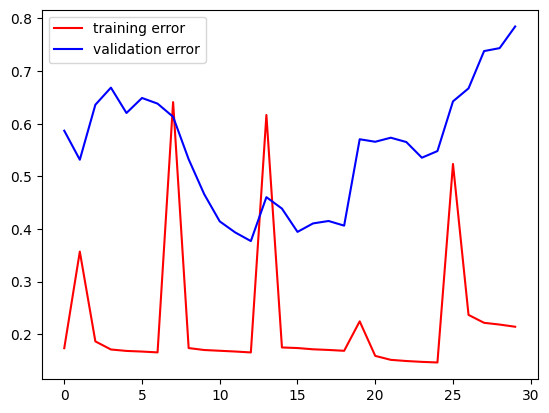

--------------------------------------------
Training = 83.33333333333333 %


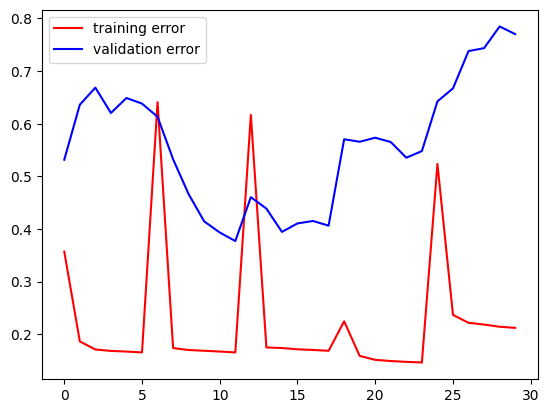

--------------------------------------------
epoch = 16
dim_clique = 50
training error = 0.21195343136787415
validation error = 0.7703348398208618
test error = 0.2479253113269806
--------------------------------------------
Training = 0.0 %


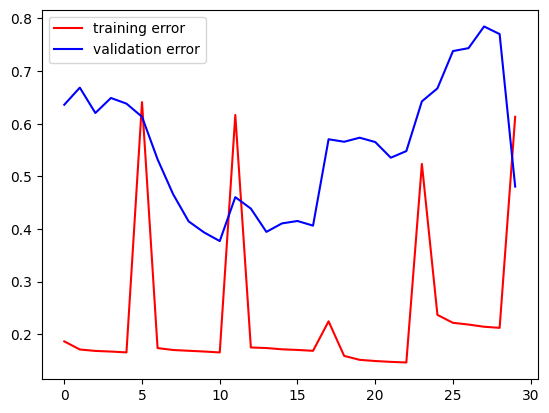

--------------------------------------------
Training = 16.666666666666668 %


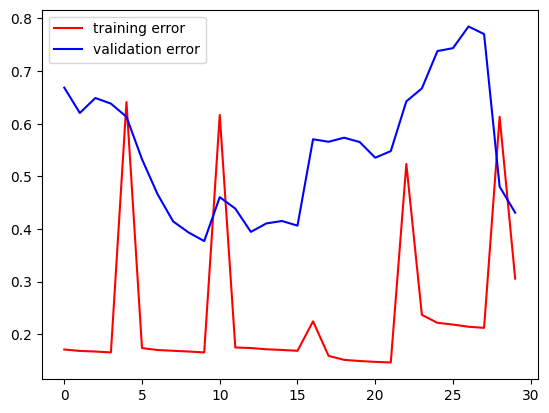

--------------------------------------------
Training = 33.333333333333336 %


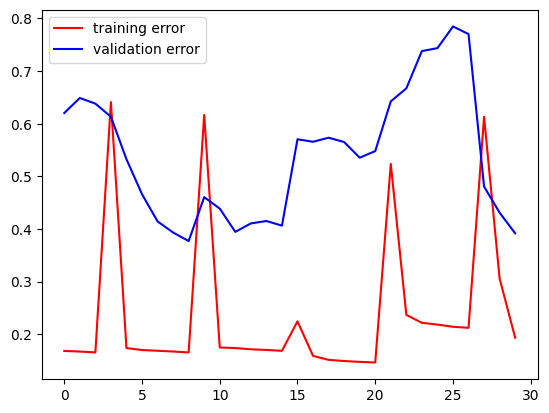

--------------------------------------------
Training = 50.0 %


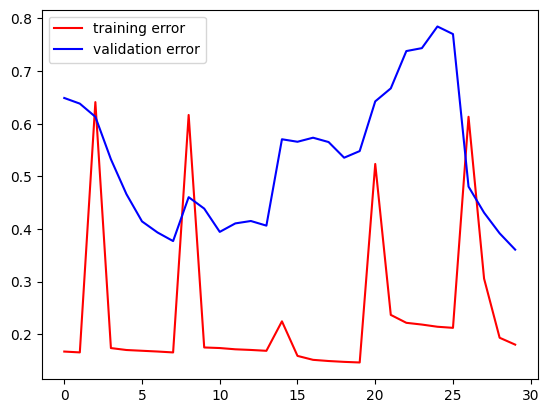

--------------------------------------------
Training = 66.66666666666667 %


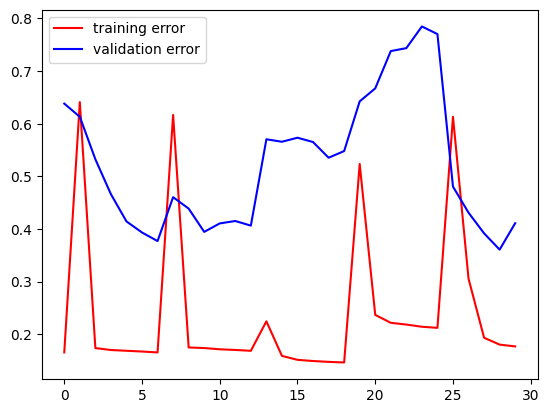

--------------------------------------------
Training = 83.33333333333333 %


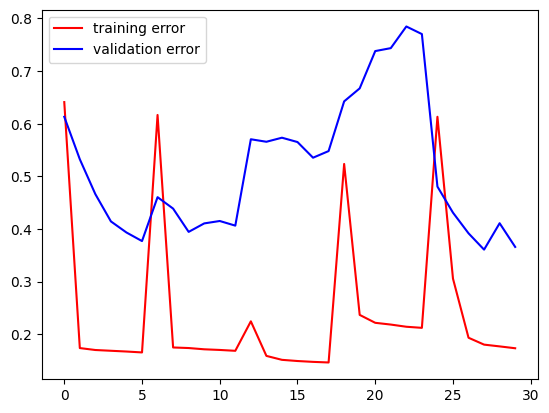

--------------------------------------------
epoch = 17
dim_clique = 50
training error = 0.17316041886806488
validation error = 0.36576858162879944
test error = 0.36514437198638916
--------------------------------------------
Training = 0.0 %


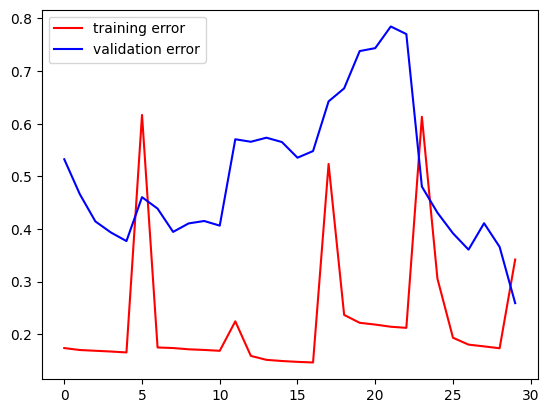

--------------------------------------------
Training = 16.666666666666668 %


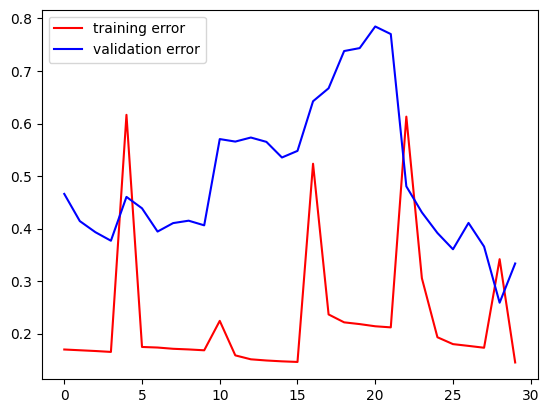

--------------------------------------------
Training = 33.333333333333336 %


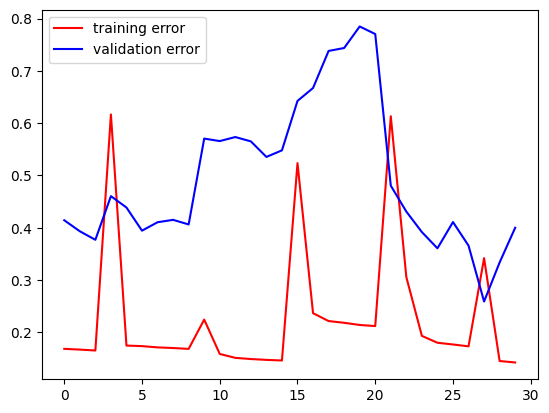

--------------------------------------------
Training = 50.0 %


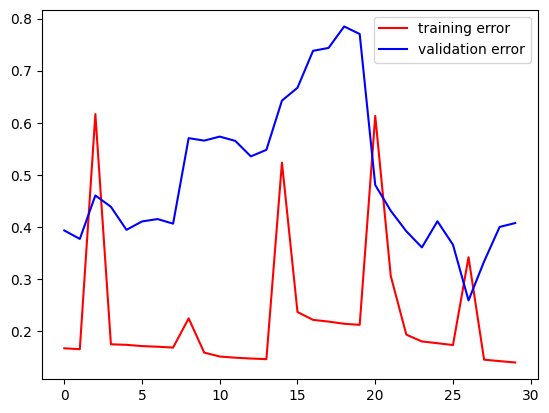

--------------------------------------------
Training = 66.66666666666667 %


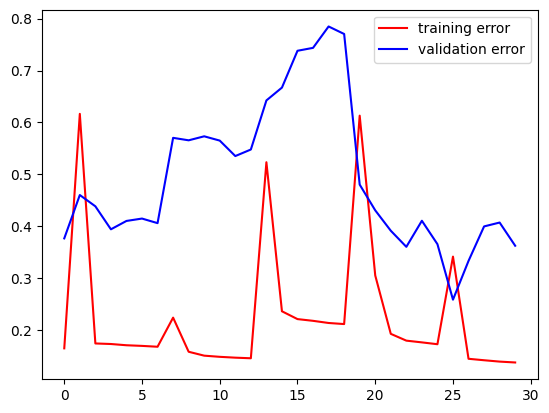

--------------------------------------------
Training = 83.33333333333333 %


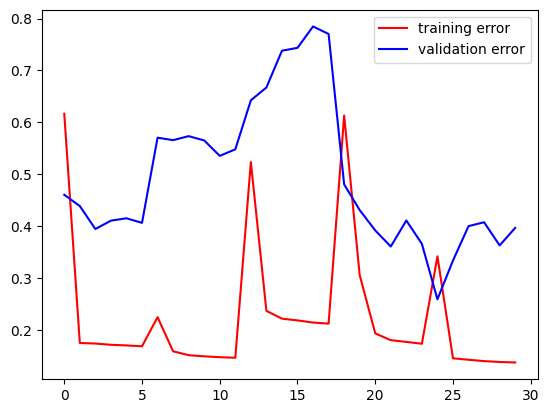

--------------------------------------------
epoch = 18
dim_clique = 50
training error = 0.13707338273525238
validation error = 0.39646512269973755
test error = 0.3467097580432892
--------------------------------------------
Training = 0.0 %


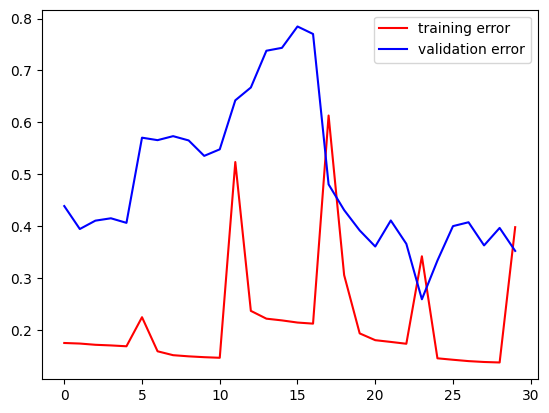

--------------------------------------------
Training = 16.666666666666668 %


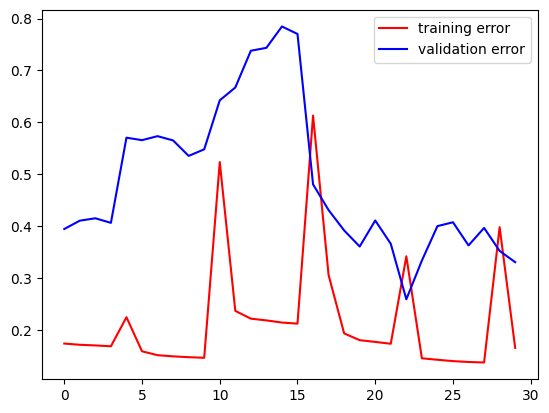

--------------------------------------------
Training = 33.333333333333336 %


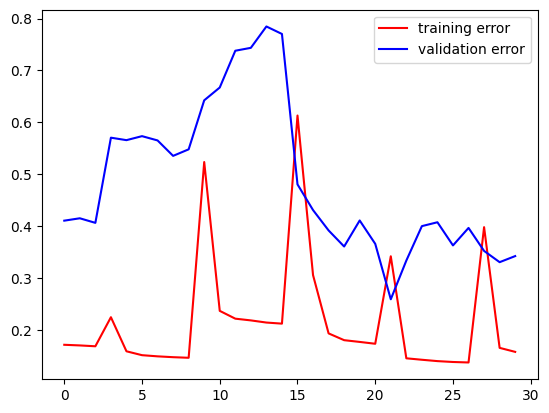

--------------------------------------------
Training = 50.0 %


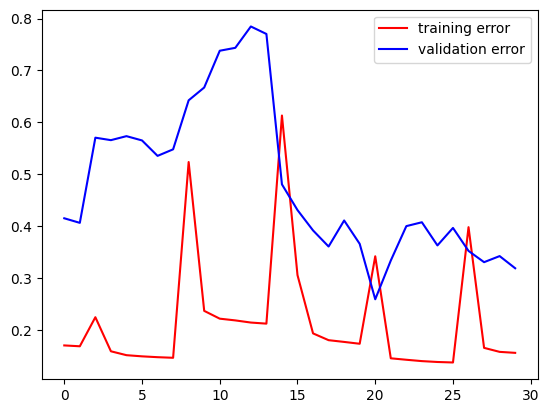

--------------------------------------------
Training = 66.66666666666667 %


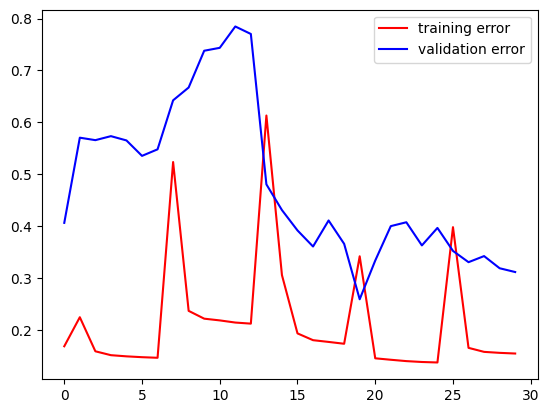

--------------------------------------------
Training = 83.33333333333333 %


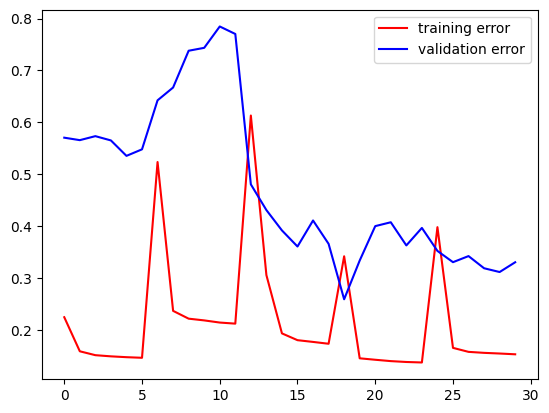

--------------------------------------------
epoch = 19
dim_clique = 50
training error = 0.15284278988838196
validation error = 0.33027657866477966
test error = 0.26161473989486694
--------------------------------------------
Training = 0.0 %


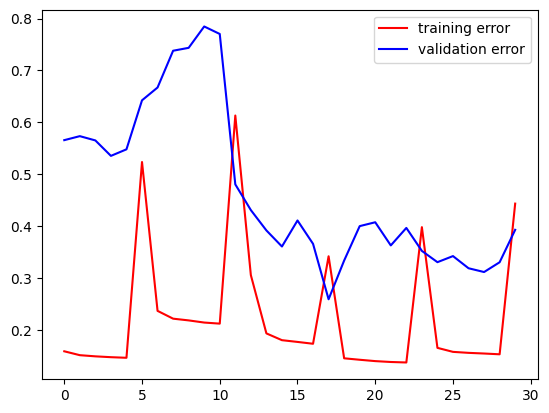

--------------------------------------------
Training = 16.666666666666668 %


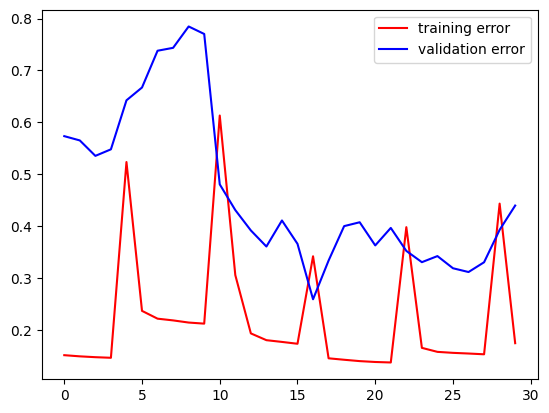

--------------------------------------------
Training = 33.333333333333336 %


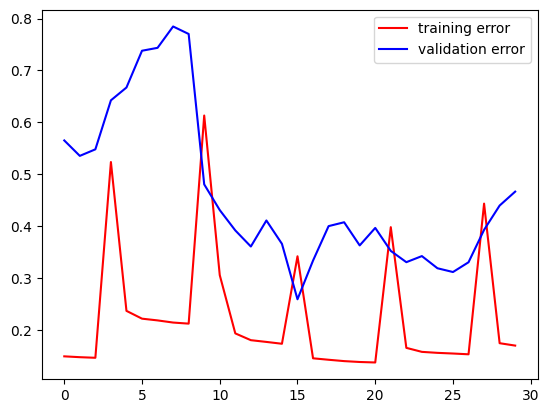

--------------------------------------------
Training = 50.0 %


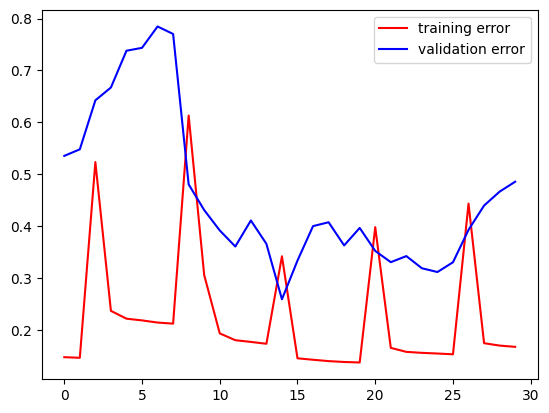

--------------------------------------------
Training = 66.66666666666667 %


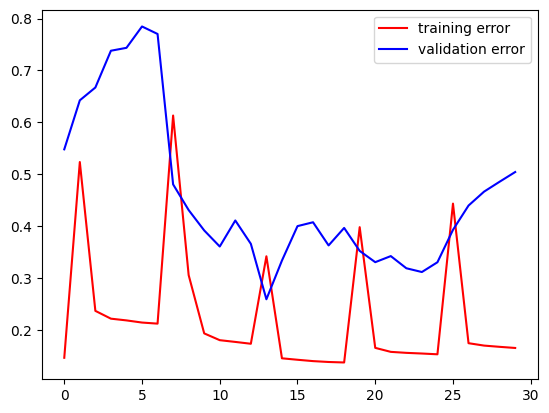

--------------------------------------------
Training = 83.33333333333333 %


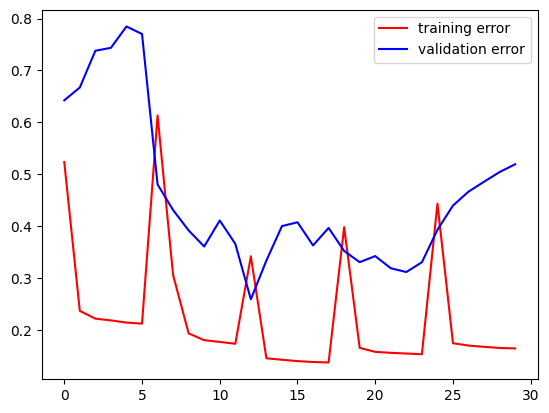

--------------------------------------------
epoch = 20
dim_clique = 50
training error = 0.16420264542102814
validation error = 0.5192219018936157
test error = 0.34747037291526794
--------------------------------------------
Training = 0.0 %


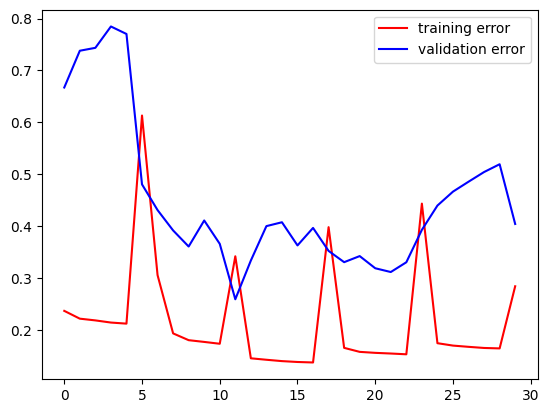

--------------------------------------------
Training = 16.666666666666668 %


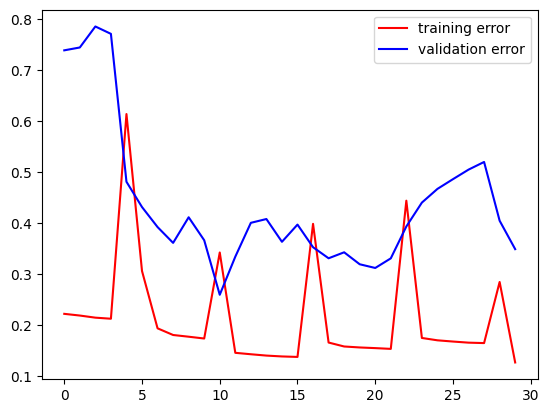

--------------------------------------------
Training = 33.333333333333336 %


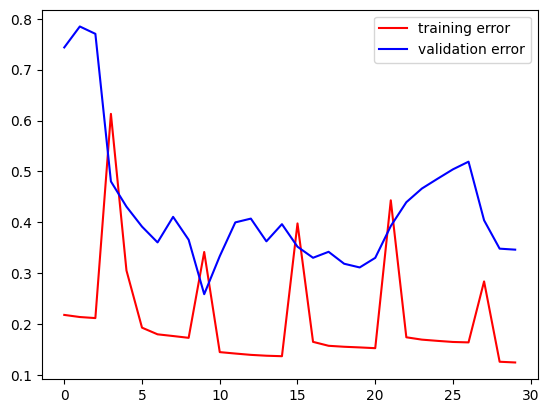

--------------------------------------------
Training = 50.0 %


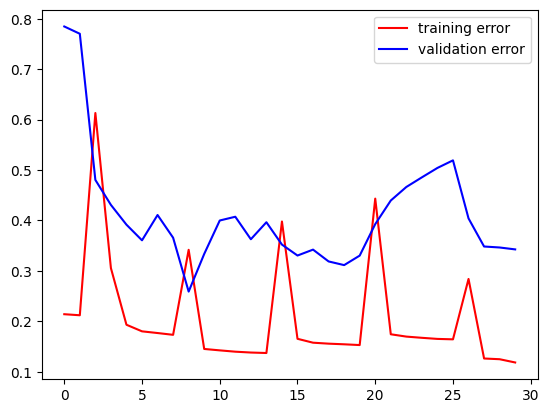

--------------------------------------------
Training = 66.66666666666667 %


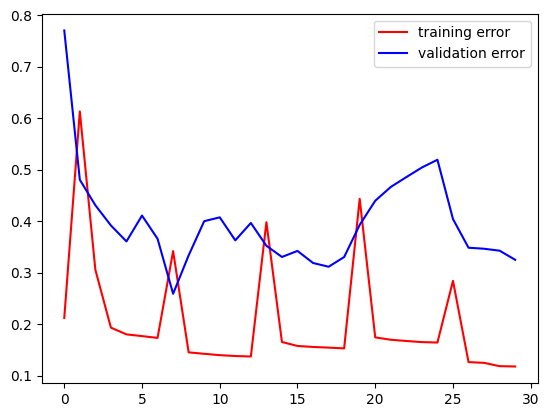

--------------------------------------------
Training = 83.33333333333333 %


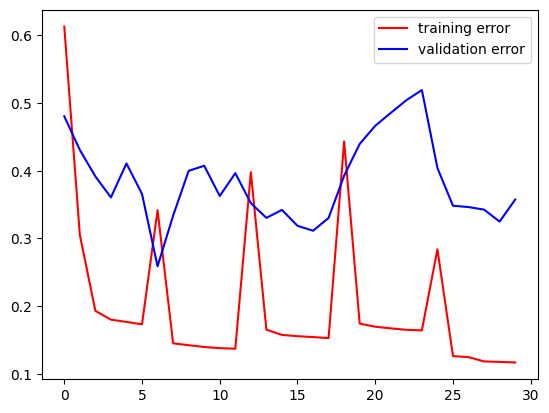

--------------------------------------------
epoch = 21
dim_clique = 50
training error = 0.11679965257644653
validation error = 0.35747310519218445
test error = 0.30203327536582947
--------------------------------------------
Training = 0.0 %
epoch = 22
dim_clique = 50
training error = 0.5477287769317627
validation error = 0.1979093700647354
test error = 0.3025389313697815
--------------------------------------------
Early stop
--------------------------------------------


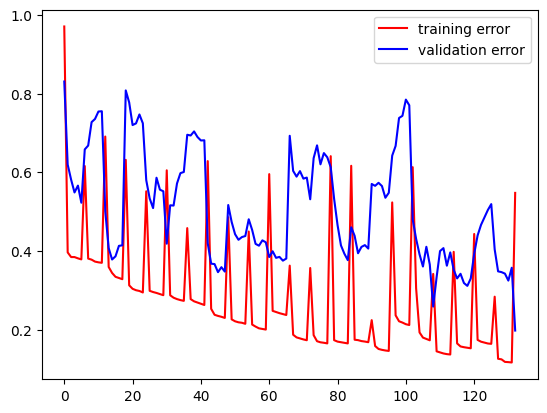

k/n = [5.0] % = [90.0]
Training = 0.0 %


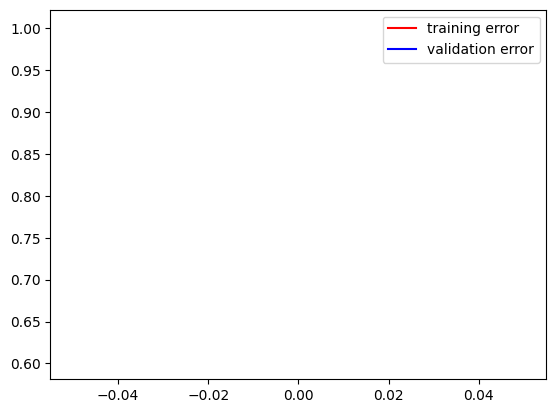

--------------------------------------------
Training = 16.666666666666668 %


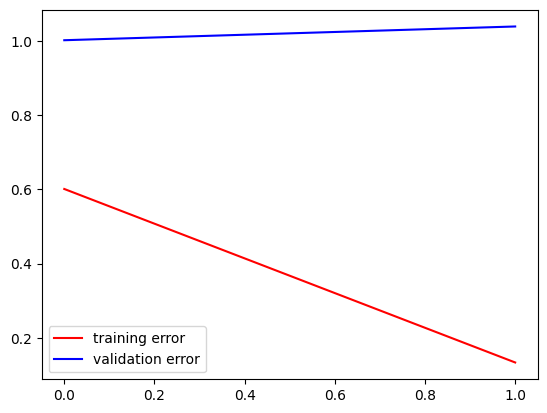

--------------------------------------------
Training = 33.333333333333336 %


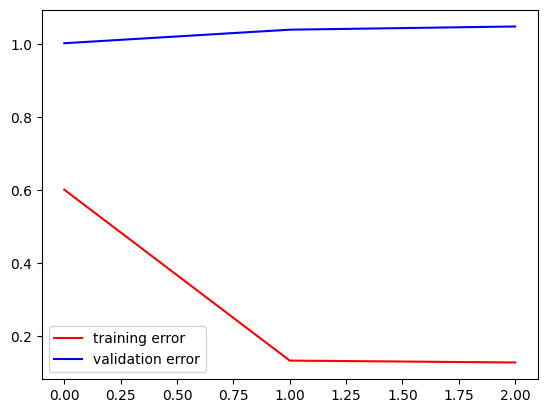

--------------------------------------------
Training = 50.0 %


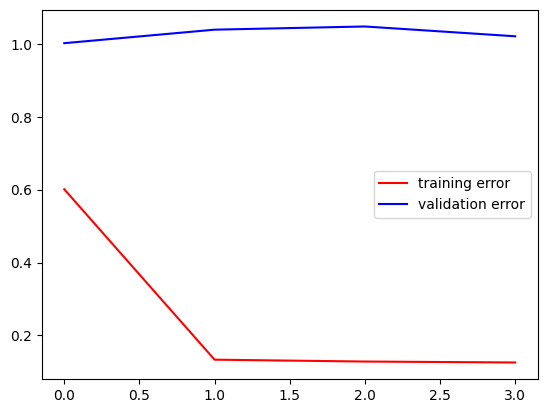

--------------------------------------------
Training = 66.66666666666667 %


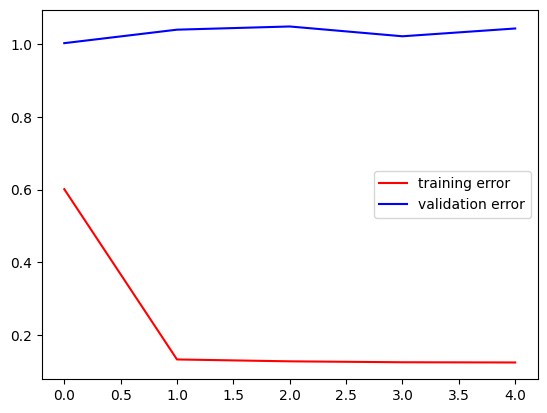

--------------------------------------------
Training = 83.33333333333333 %


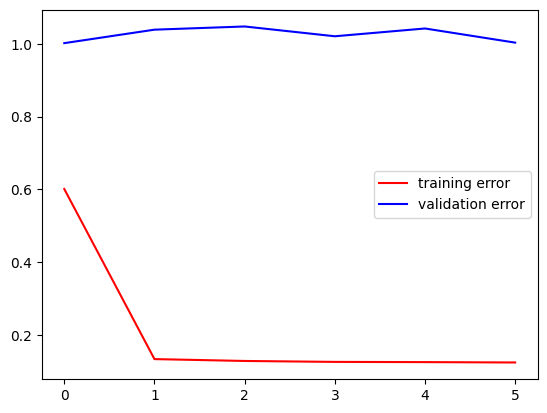

--------------------------------------------
epoch = 0
dim_clique = 45
training error = 0.12394602596759796
validation error = 1.0036245584487915
test error = 0.734360933303833
--------------------------------------------
Training = 0.0 %


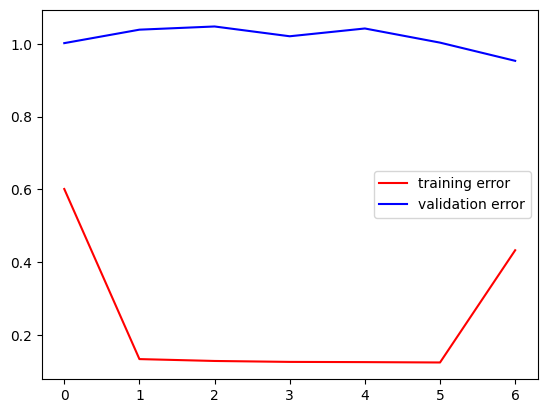

--------------------------------------------
Training = 16.666666666666668 %


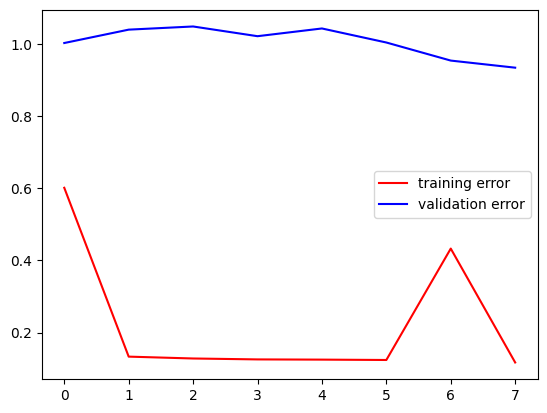

--------------------------------------------
Training = 33.333333333333336 %


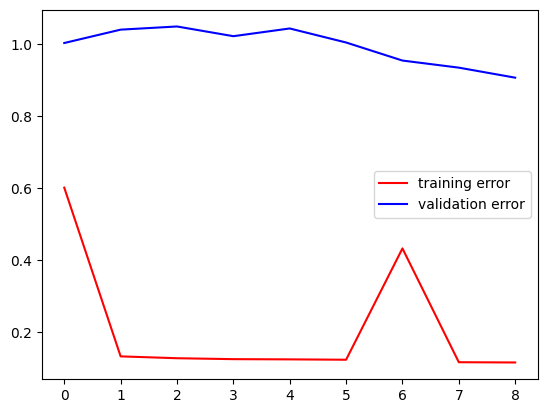

--------------------------------------------
Training = 50.0 %


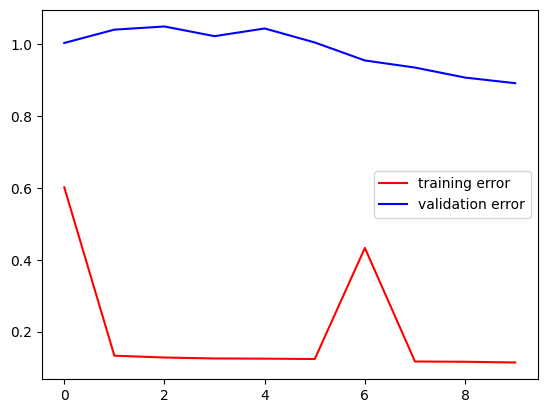

--------------------------------------------
Training = 66.66666666666667 %


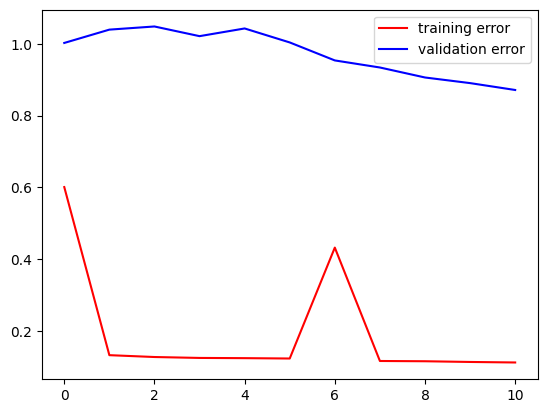

--------------------------------------------
Training = 83.33333333333333 %


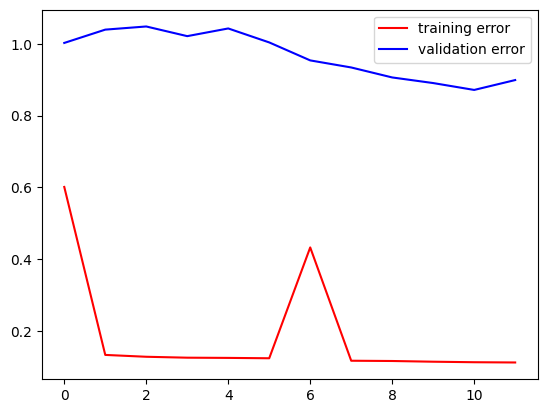

--------------------------------------------
epoch = 1
dim_clique = 45
training error = 0.11219599097967148
validation error = 0.8988067507743835
test error = 0.6015441417694092
--------------------------------------------
Training = 0.0 %


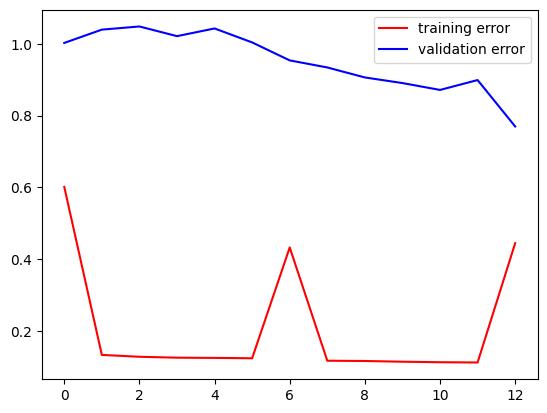

--------------------------------------------
Training = 16.666666666666668 %


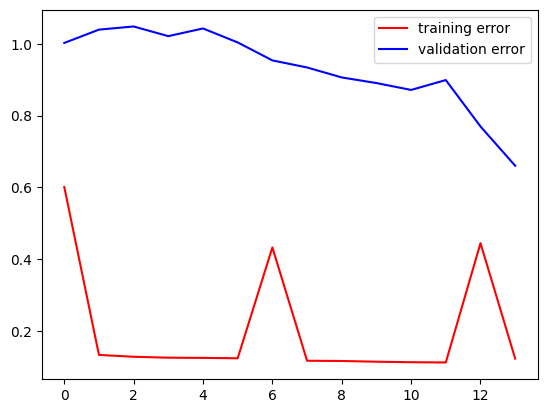

--------------------------------------------
Training = 33.333333333333336 %


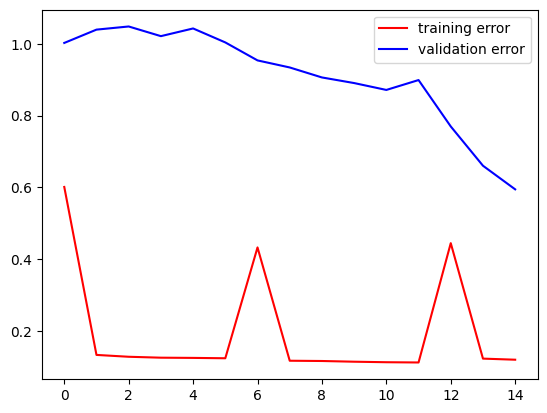

--------------------------------------------
Training = 50.0 %


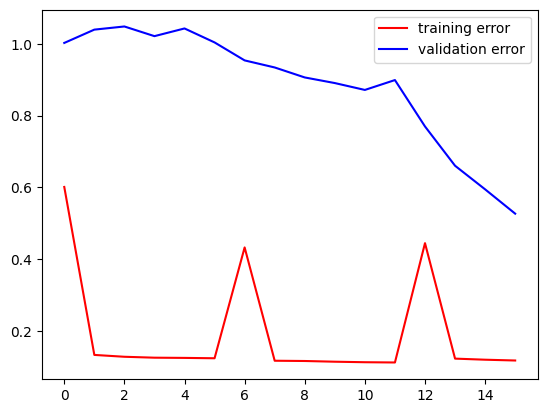

--------------------------------------------
Training = 66.66666666666667 %


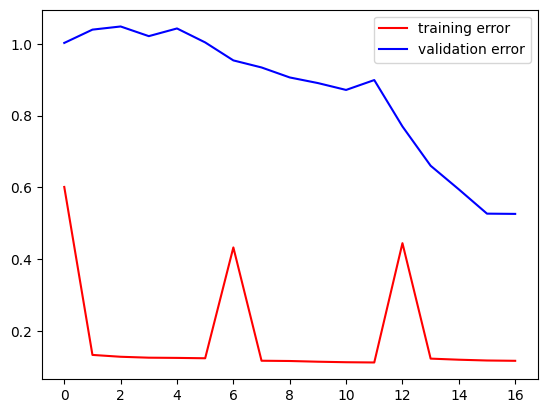

--------------------------------------------
Training = 83.33333333333333 %


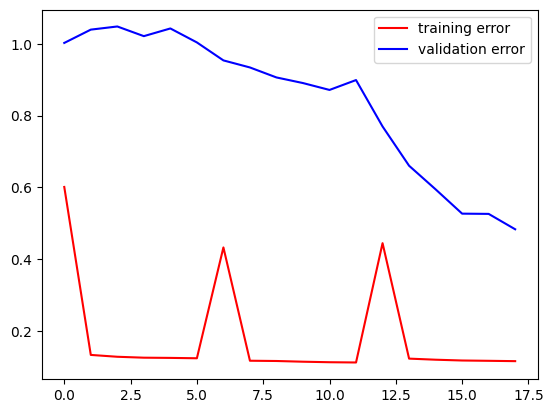

--------------------------------------------
epoch = 2
dim_clique = 45
training error = 0.11590089648962021
validation error = 0.4831838607788086
test error = 0.741946816444397
--------------------------------------------
Training = 0.0 %


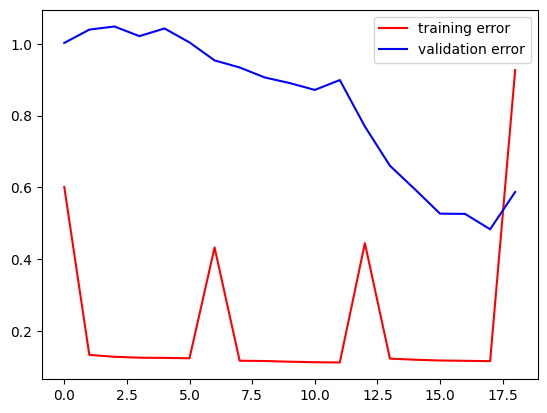

--------------------------------------------
Training = 16.666666666666668 %


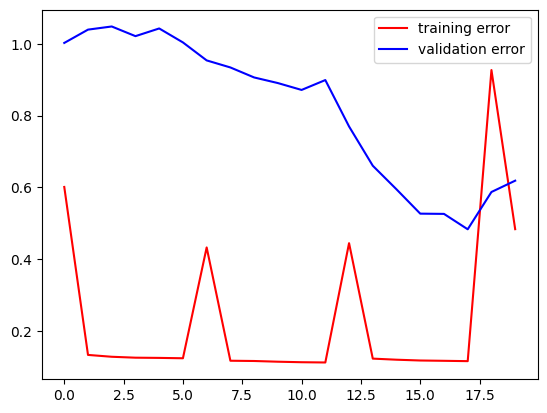

--------------------------------------------
Training = 33.333333333333336 %


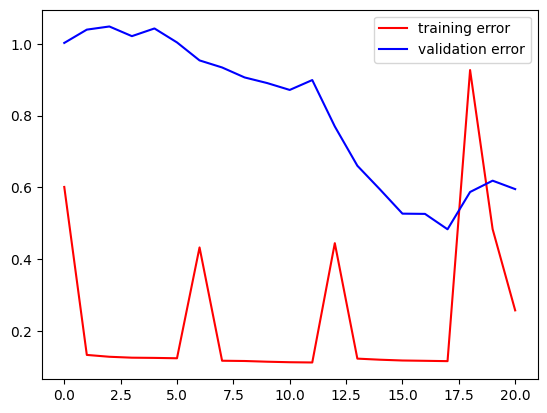

--------------------------------------------
Training = 50.0 %


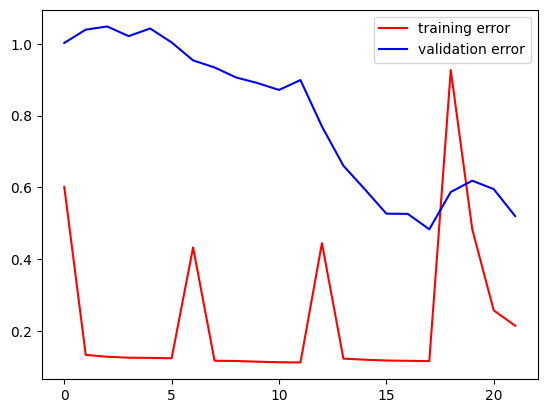

--------------------------------------------
Training = 66.66666666666667 %


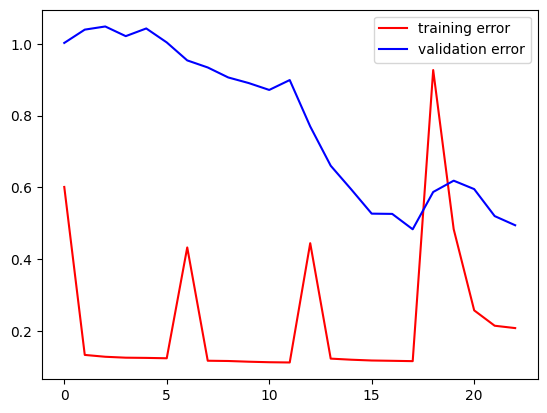

--------------------------------------------
Training = 83.33333333333333 %


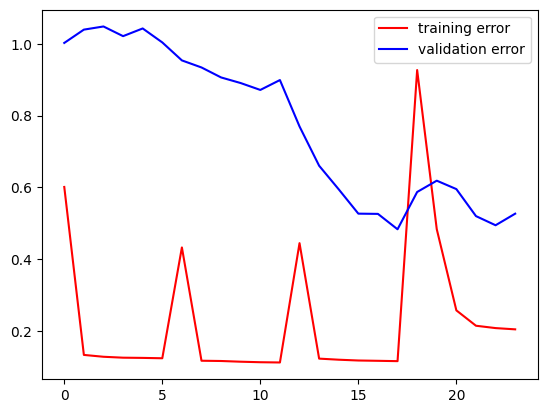

--------------------------------------------
epoch = 3
dim_clique = 45
training error = 0.20446667075157166
validation error = 0.5266327261924744
test error = 0.8440961837768555
--------------------------------------------
Training = 0.0 %


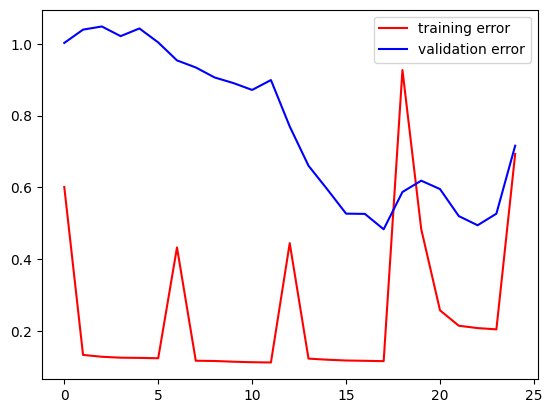

--------------------------------------------
Training = 16.666666666666668 %


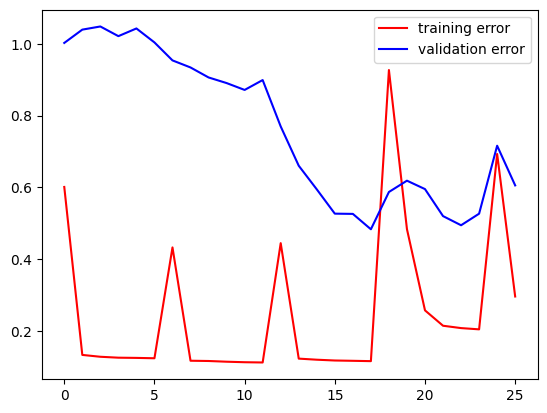

--------------------------------------------
Training = 33.333333333333336 %


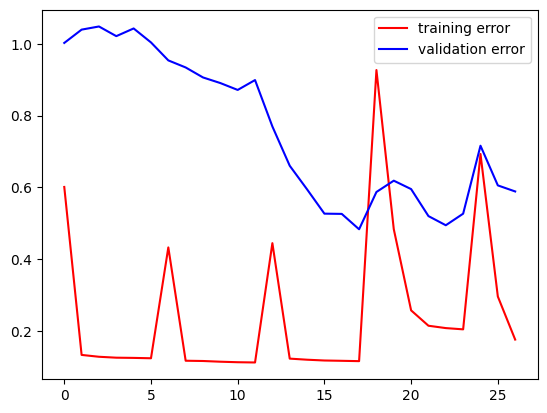

--------------------------------------------
Training = 50.0 %


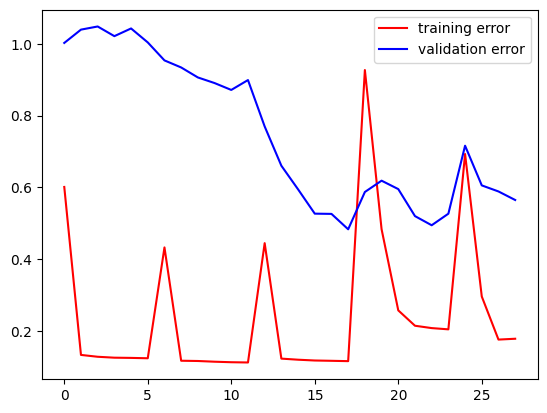

--------------------------------------------
Training = 66.66666666666667 %


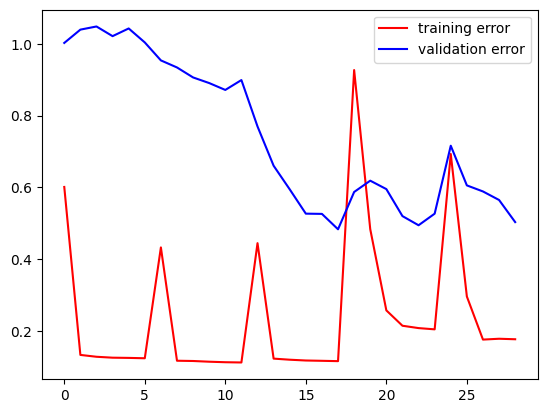

--------------------------------------------
Training = 83.33333333333333 %


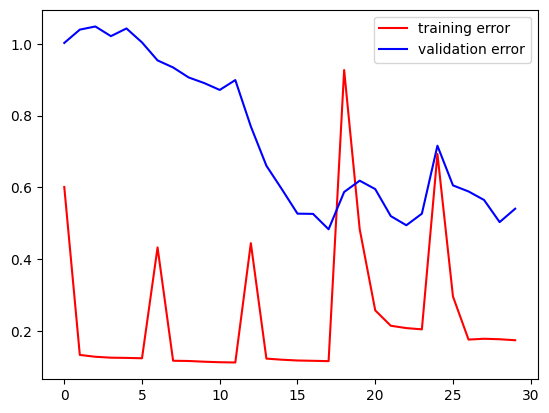

--------------------------------------------
epoch = 4
dim_clique = 45
training error = 0.17414867877960205
validation error = 0.5404735207557678
test error = 1.0553386211395264
--------------------------------------------
Training = 0.0 %


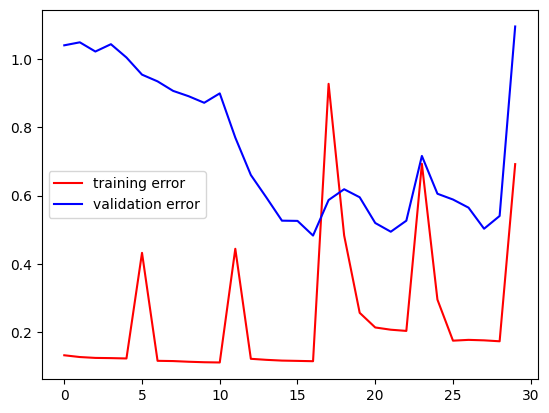

--------------------------------------------
Training = 16.666666666666668 %


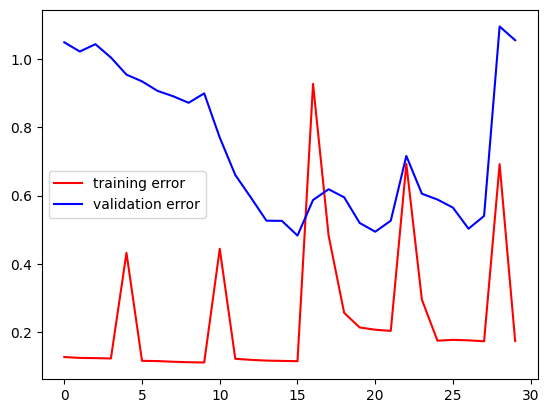

--------------------------------------------
Training = 33.333333333333336 %


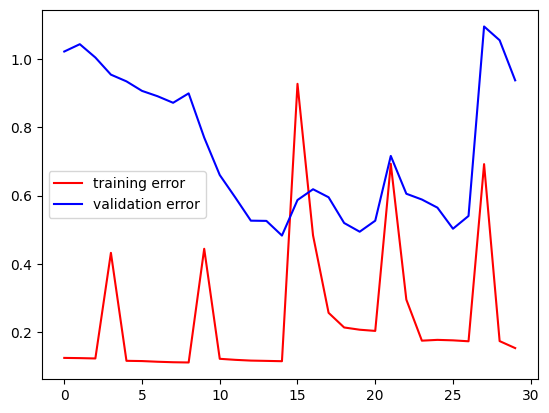

--------------------------------------------
Training = 50.0 %


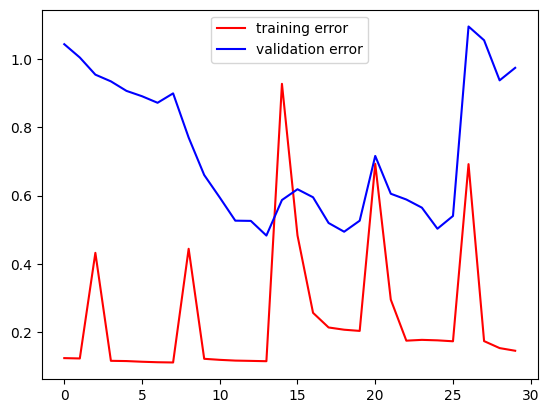

--------------------------------------------
Training = 66.66666666666667 %


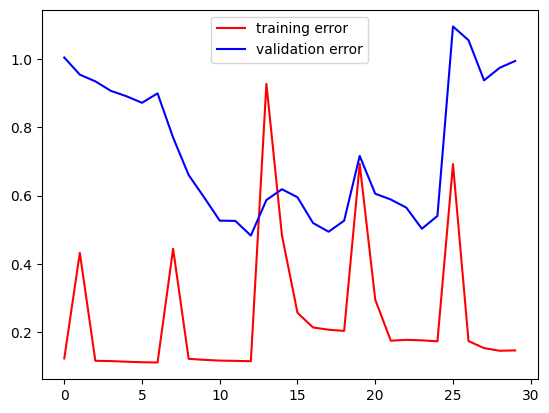

--------------------------------------------
Training = 83.33333333333333 %


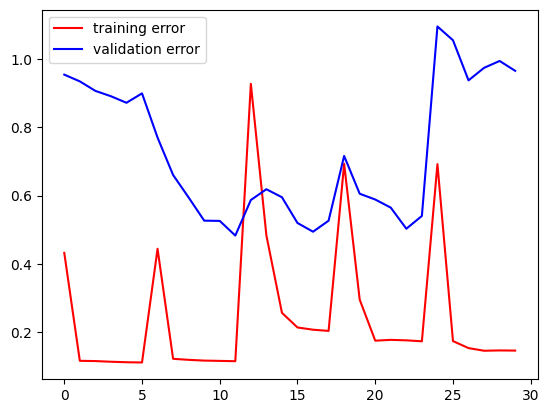

--------------------------------------------
epoch = 5
dim_clique = 45
training error = 0.14695525169372559
validation error = 0.9647035598754883
test error = 1.1487538814544678
--------------------------------------------
Training = 0.0 %


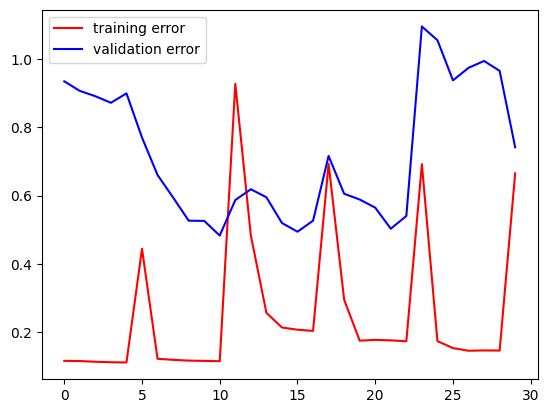

--------------------------------------------
Training = 16.666666666666668 %


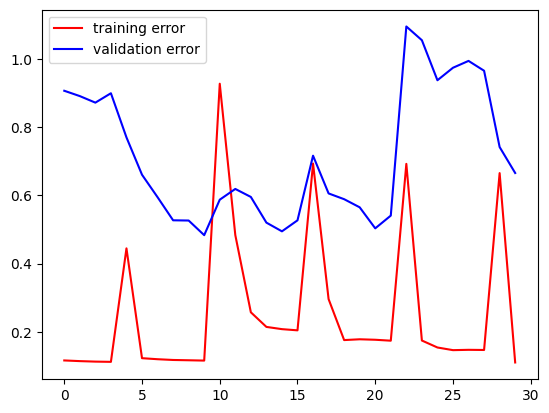

--------------------------------------------
Training = 33.333333333333336 %


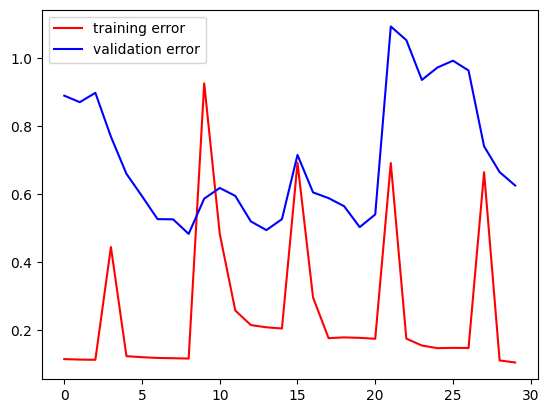

--------------------------------------------
Training = 50.0 %


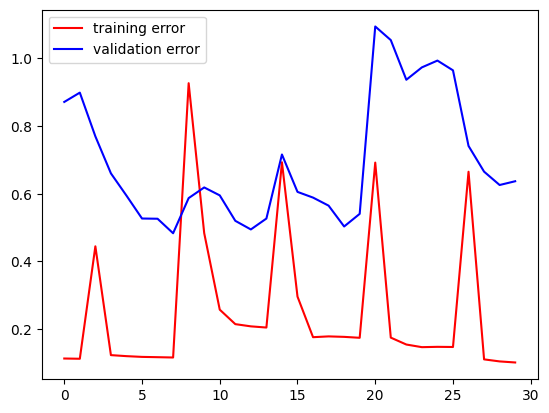

--------------------------------------------
Training = 66.66666666666667 %


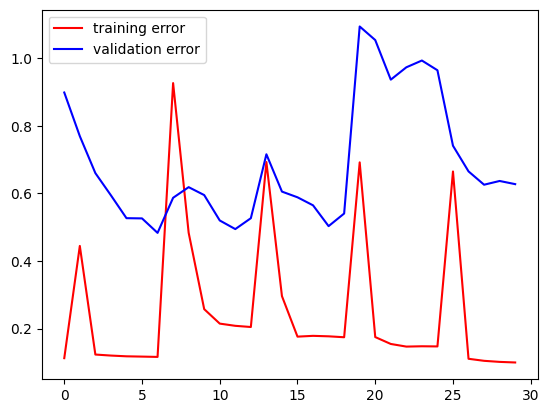

--------------------------------------------
Training = 83.33333333333333 %


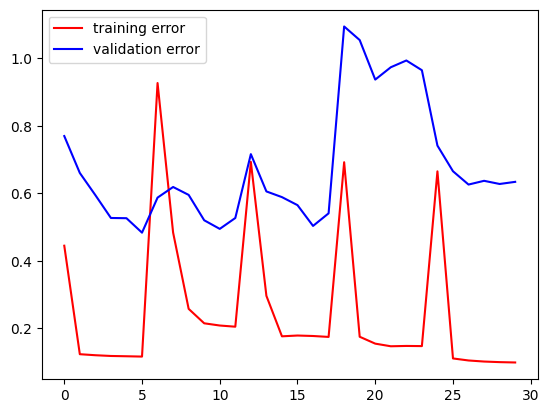

--------------------------------------------
epoch = 6
dim_clique = 45
training error = 0.09841036051511765
validation error = 0.6337935924530029
test error = 1.3315489292144775
--------------------------------------------
Training = 0.0 %


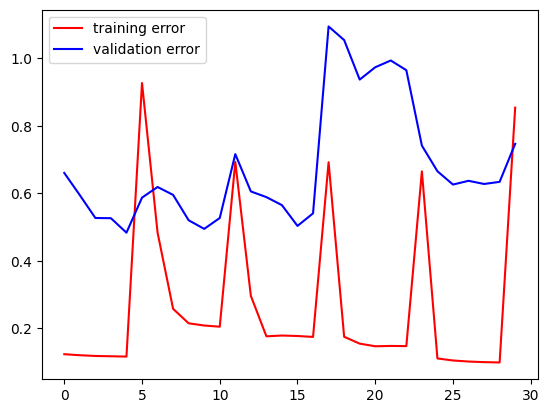

--------------------------------------------
Training = 16.666666666666668 %


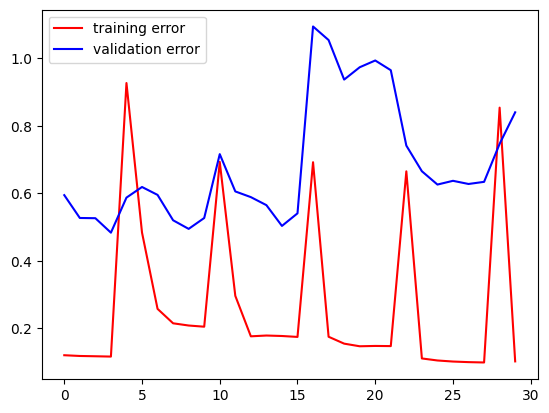

--------------------------------------------
Training = 33.333333333333336 %


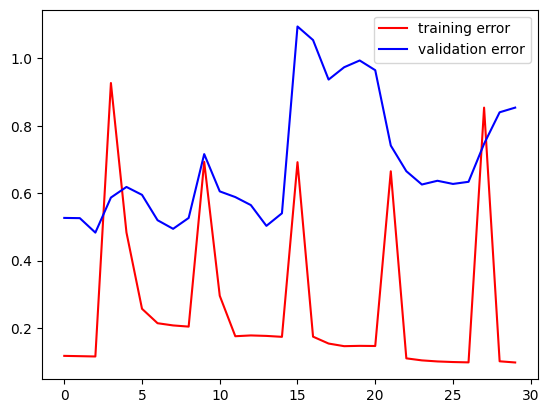

--------------------------------------------
Training = 50.0 %


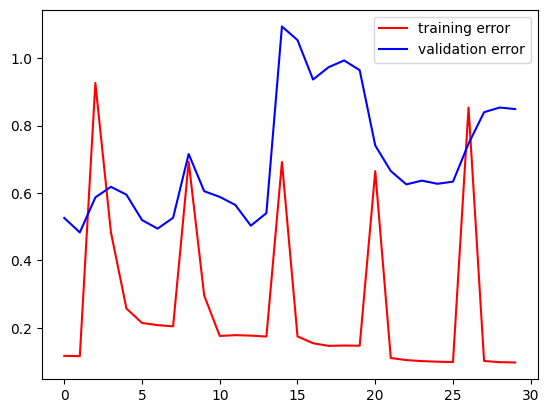

--------------------------------------------
Training = 66.66666666666667 %


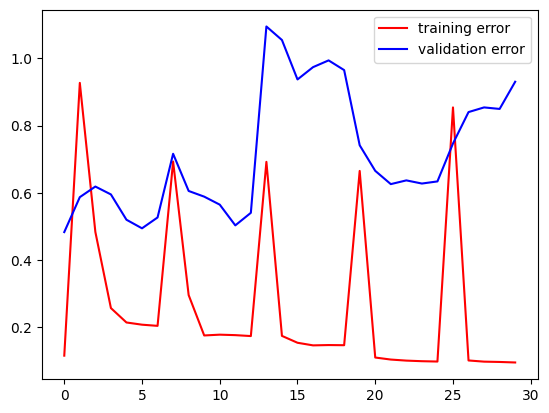

--------------------------------------------
Training = 83.33333333333333 %


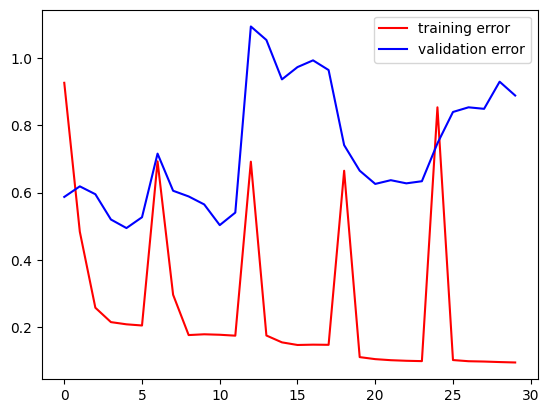

--------------------------------------------
epoch = 7
dim_clique = 45
training error = 0.09439361840486526
validation error = 0.8888734579086304
test error = 1.1716176271438599
--------------------------------------------
Training = 0.0 %


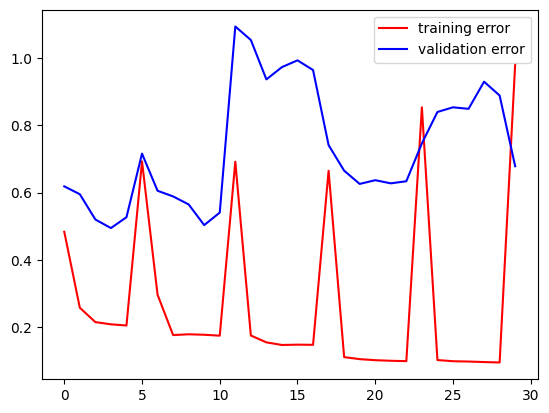

--------------------------------------------
Training = 16.666666666666668 %


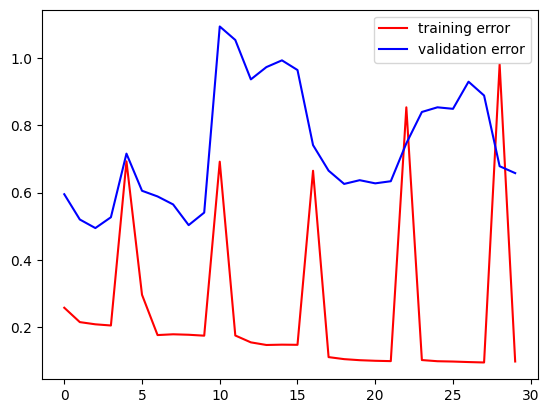

--------------------------------------------
Training = 33.333333333333336 %


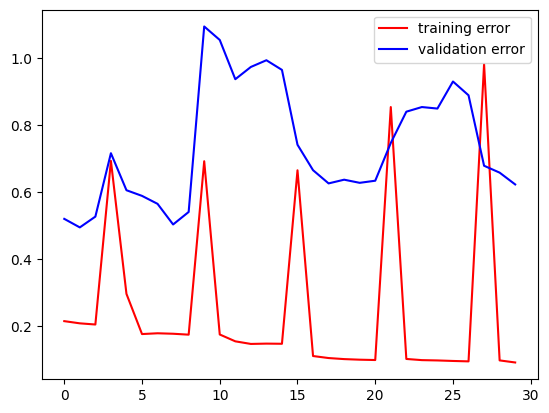

--------------------------------------------
Training = 50.0 %


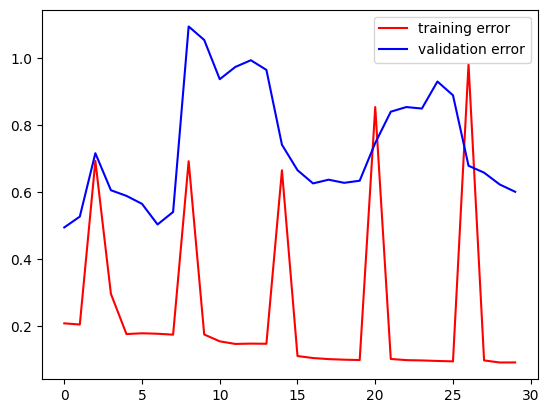

--------------------------------------------
Training = 66.66666666666667 %


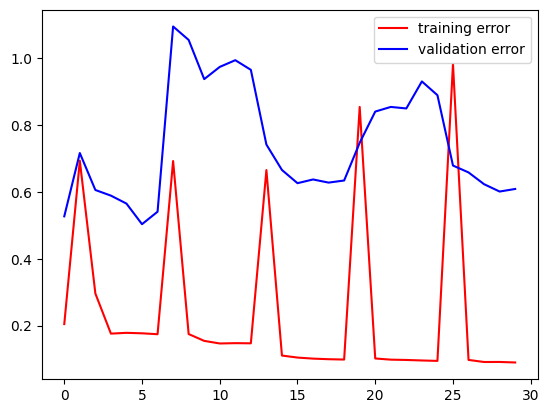

--------------------------------------------
Training = 83.33333333333333 %


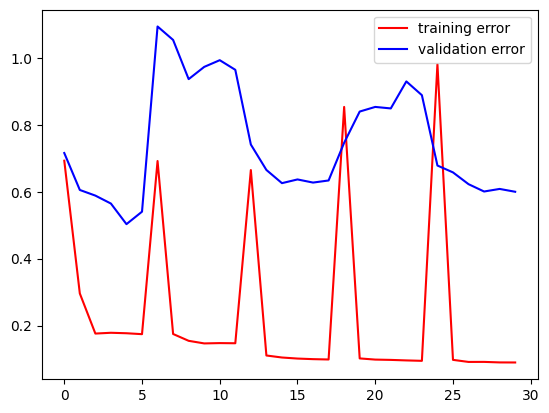

--------------------------------------------
epoch = 8
dim_clique = 45
training error = 0.08947093784809113
validation error = 0.6000386476516724
test error = 0.886656641960144
--------------------------------------------
Training = 0.0 %


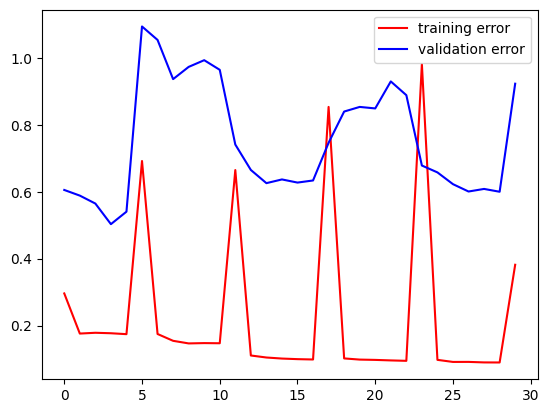

--------------------------------------------
Training = 16.666666666666668 %


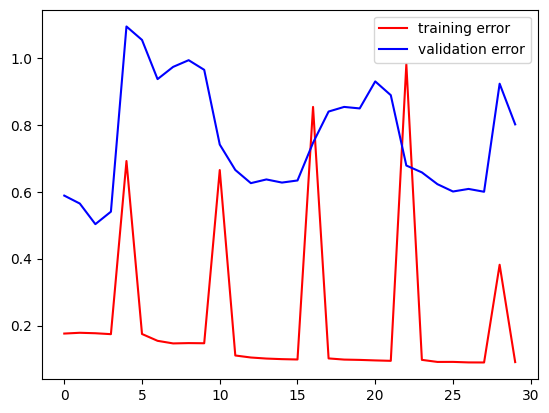

--------------------------------------------
Training = 33.333333333333336 %


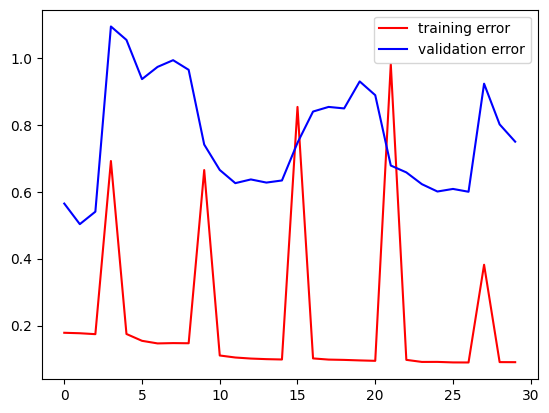

--------------------------------------------
Training = 50.0 %


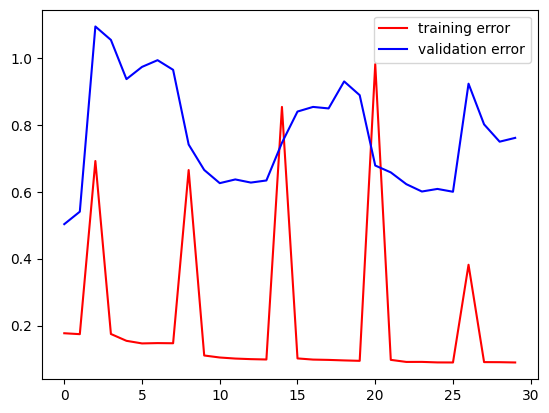

--------------------------------------------
Training = 66.66666666666667 %


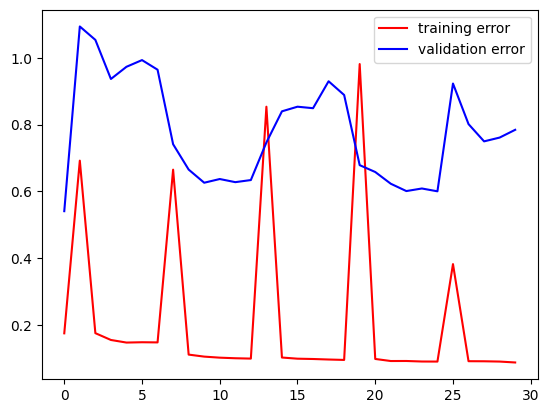

--------------------------------------------
Training = 83.33333333333333 %


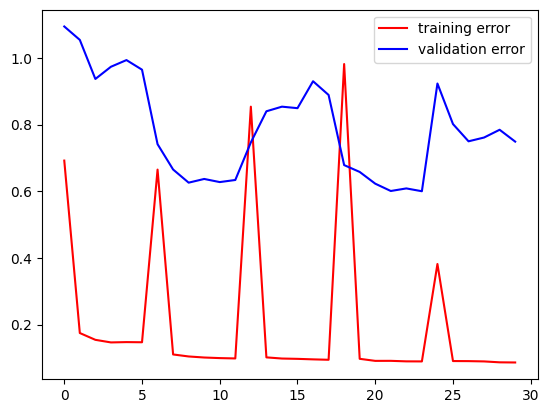

--------------------------------------------
epoch = 9
dim_clique = 45
training error = 0.08630123734474182
validation error = 0.748909056186676
test error = 0.775838315486908
--------------------------------------------
Training = 0.0 %


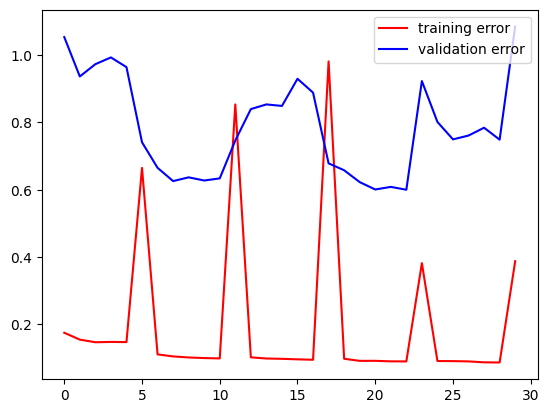

--------------------------------------------
Training = 16.666666666666668 %


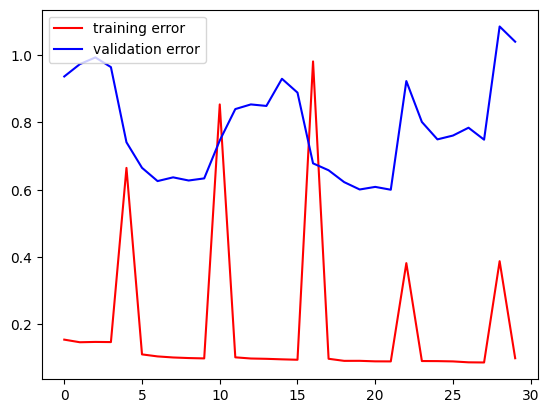

--------------------------------------------
Training = 33.333333333333336 %


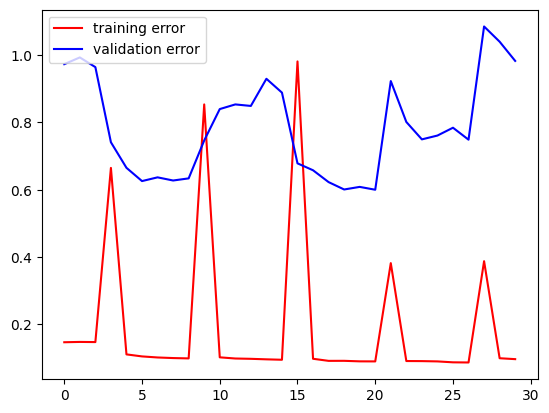

--------------------------------------------
Training = 50.0 %


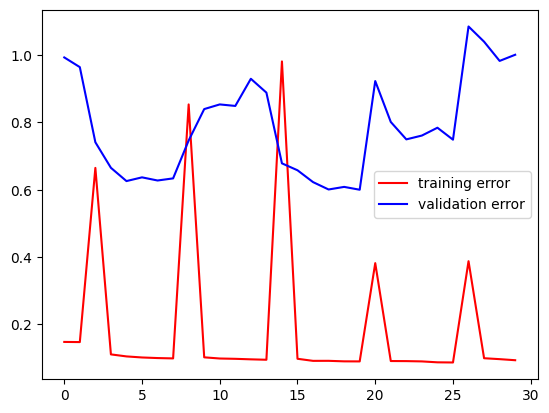

--------------------------------------------
Training = 66.66666666666667 %


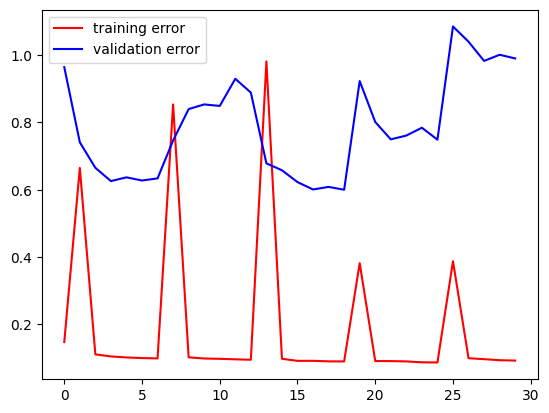

--------------------------------------------
Training = 83.33333333333333 %


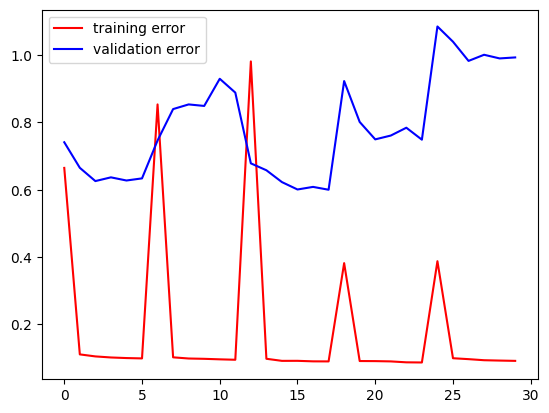

--------------------------------------------
epoch = 10
dim_clique = 45
training error = 0.09108568727970123
validation error = 0.993515133857727
test error = 1.052868127822876
--------------------------------------------
Training = 0.0 %


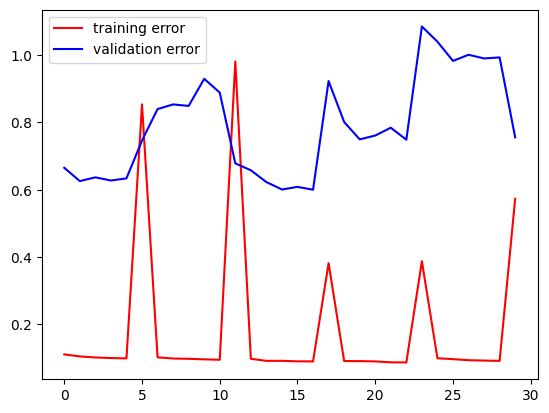

--------------------------------------------
Training = 16.666666666666668 %


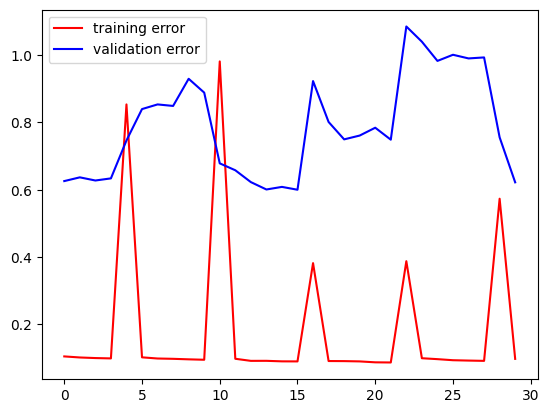

--------------------------------------------
Training = 33.333333333333336 %


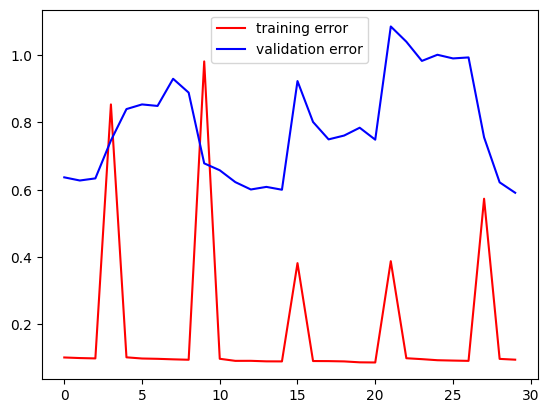

--------------------------------------------
Training = 50.0 %


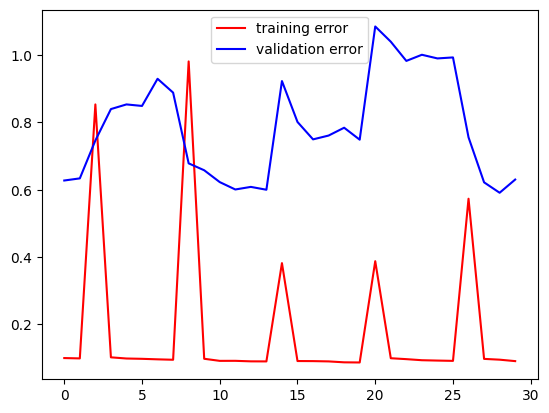

--------------------------------------------
Training = 66.66666666666667 %


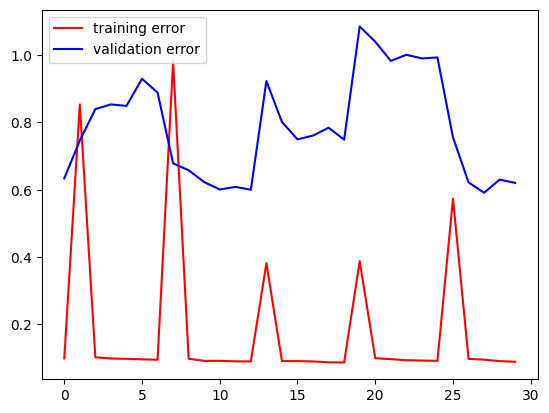

--------------------------------------------
Training = 83.33333333333333 %


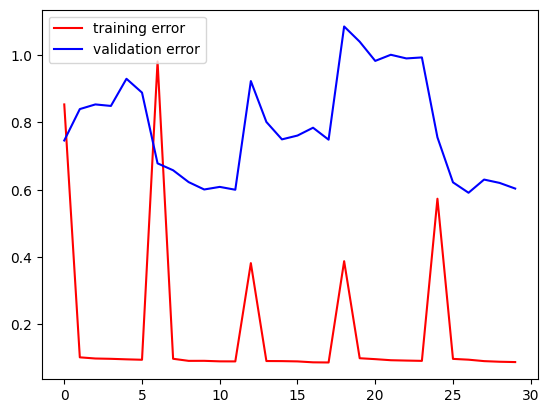

--------------------------------------------
epoch = 11
dim_clique = 45
training error = 0.08749916404485703
validation error = 0.6035474538803101
test error = 0.9806607961654663
--------------------------------------------
Training = 0.0 %


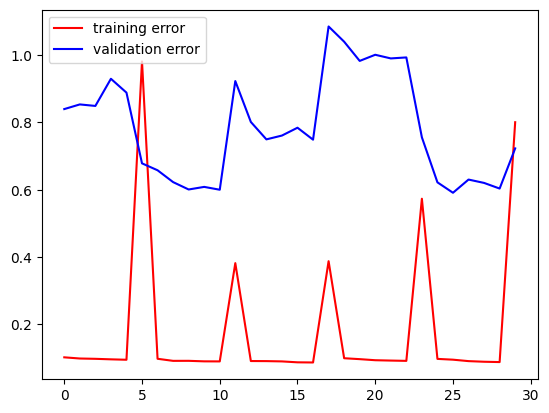

--------------------------------------------
Training = 16.666666666666668 %


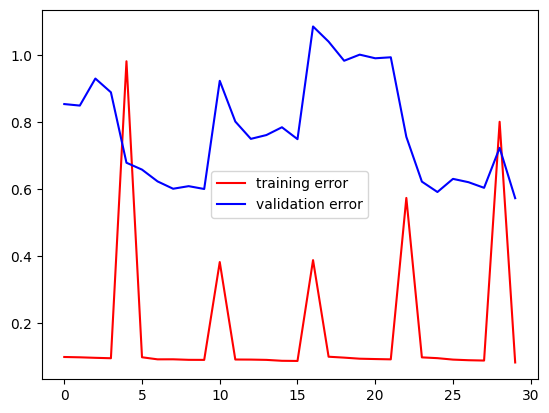

--------------------------------------------
Training = 33.333333333333336 %


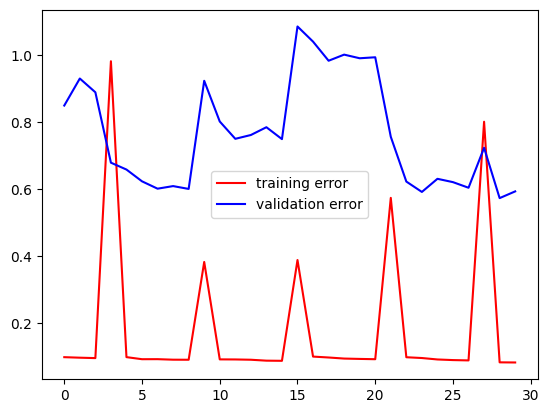

--------------------------------------------
Training = 50.0 %


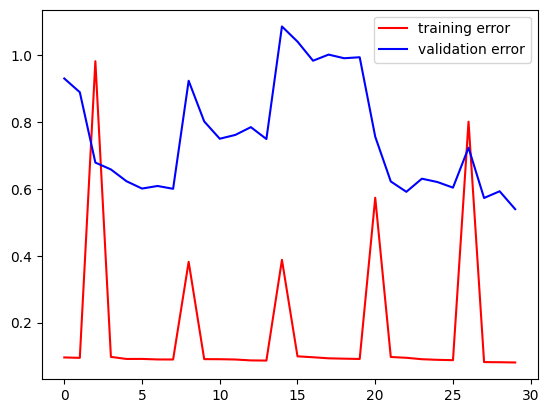

--------------------------------------------
Training = 66.66666666666667 %


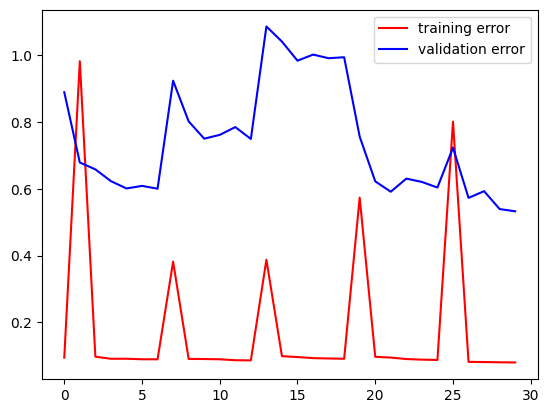

--------------------------------------------
Training = 83.33333333333333 %


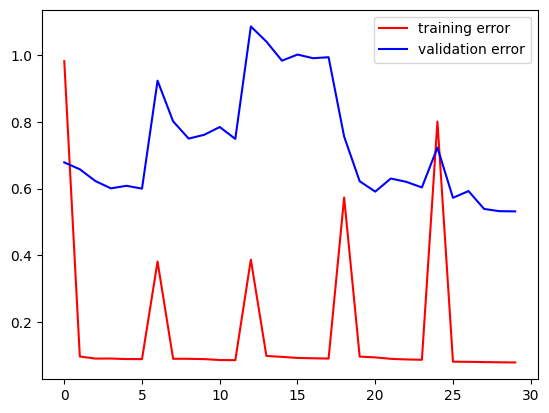

--------------------------------------------
epoch = 12
dim_clique = 45
training error = 0.07940365374088287
validation error = 0.5318776965141296
test error = 1.2247118949890137
--------------------------------------------
Training = 0.0 %


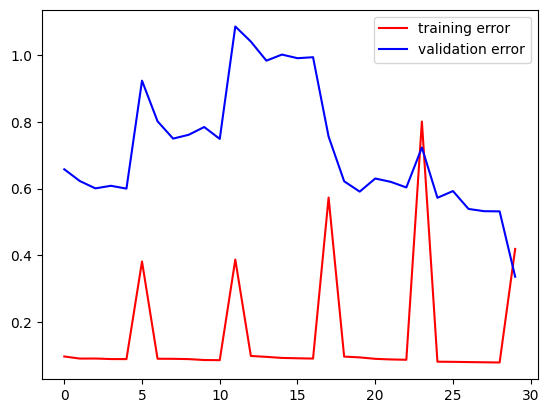

--------------------------------------------
Training = 16.666666666666668 %


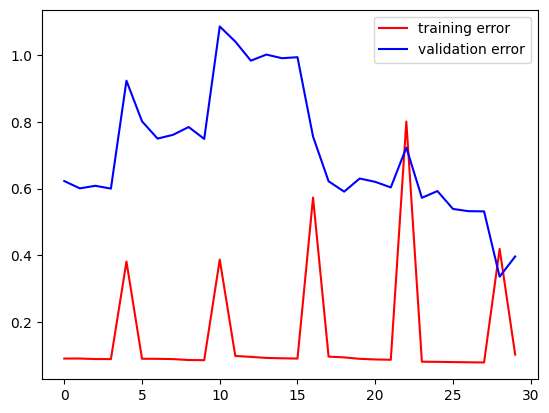

--------------------------------------------
Training = 33.333333333333336 %


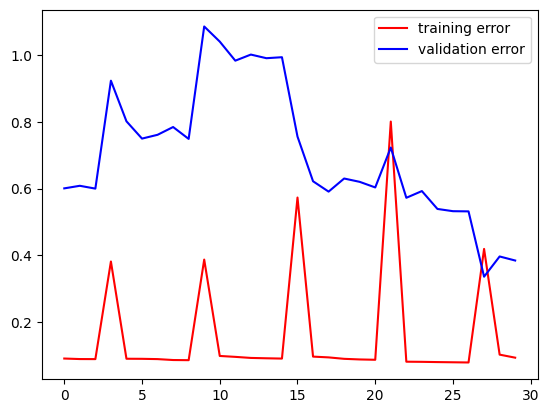

--------------------------------------------
Training = 50.0 %


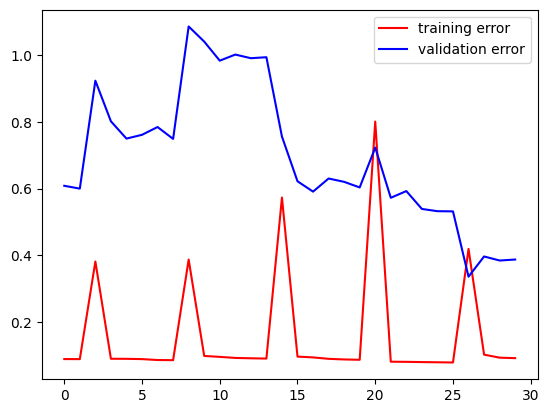

--------------------------------------------
Training = 66.66666666666667 %


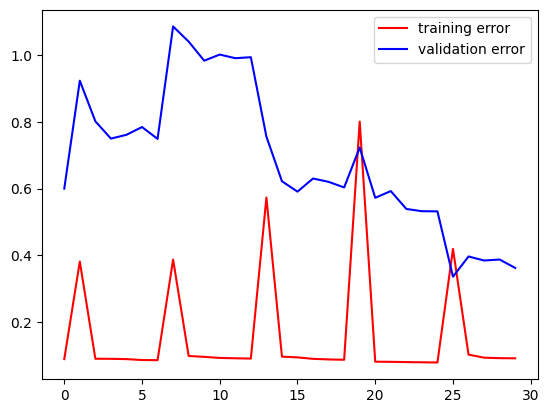

--------------------------------------------
Training = 83.33333333333333 %


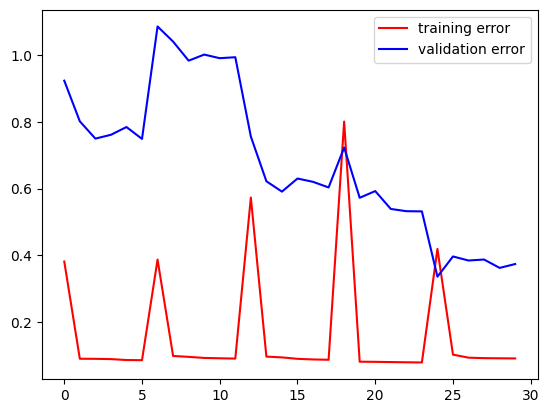

--------------------------------------------
epoch = 13
dim_clique = 45
training error = 0.09153325110673904
validation error = 0.37421590089797974
test error = 1.1480040550231934
--------------------------------------------
Training = 0.0 %


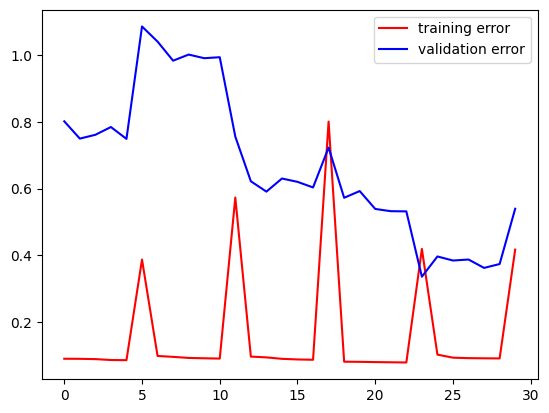

--------------------------------------------
Training = 16.666666666666668 %


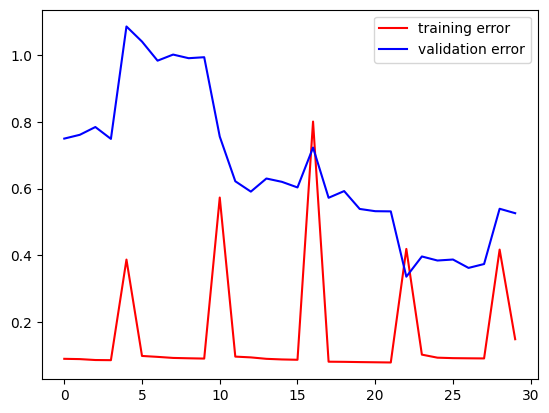

--------------------------------------------
Training = 33.333333333333336 %


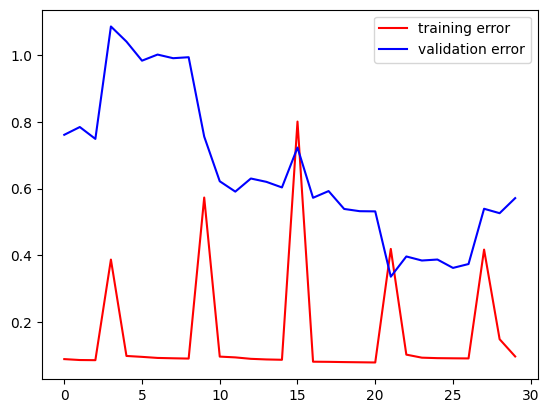

--------------------------------------------
Training = 50.0 %


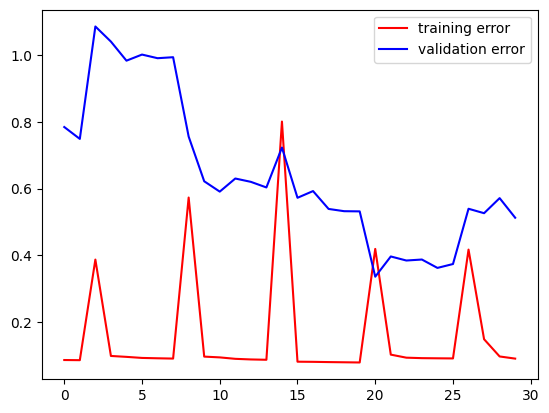

--------------------------------------------
Training = 66.66666666666667 %


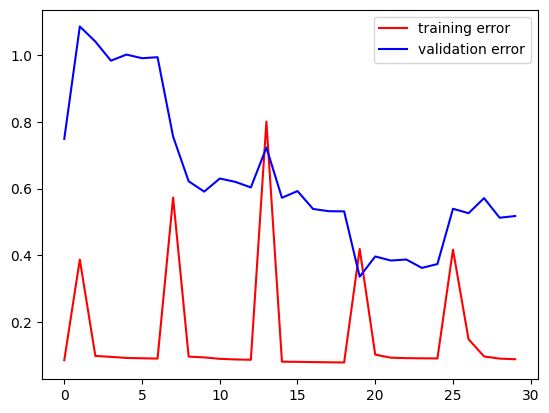

--------------------------------------------
Training = 83.33333333333333 %


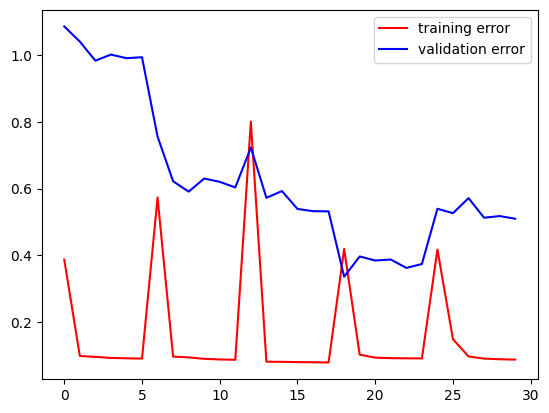

--------------------------------------------
epoch = 14
dim_clique = 45
training error = 0.0880829244852066
validation error = 0.5098248720169067
test error = 1.1417162418365479
--------------------------------------------
Training = 0.0 %


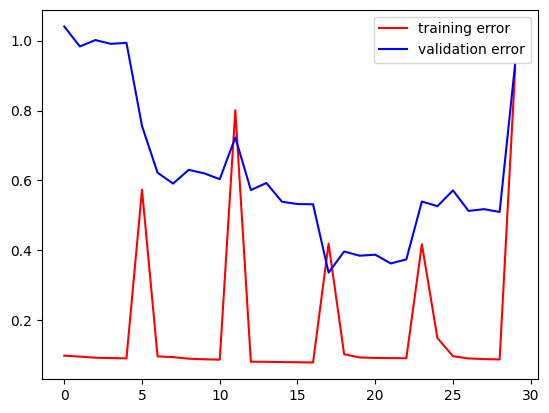

--------------------------------------------
Training = 16.666666666666668 %


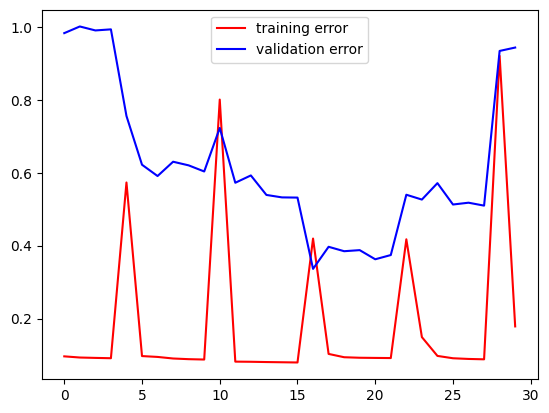

--------------------------------------------
Training = 33.333333333333336 %


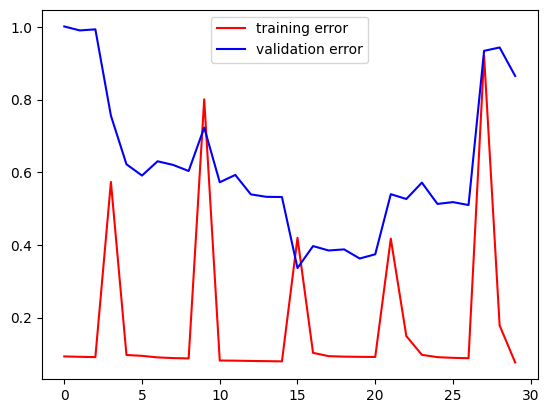

--------------------------------------------
Training = 50.0 %


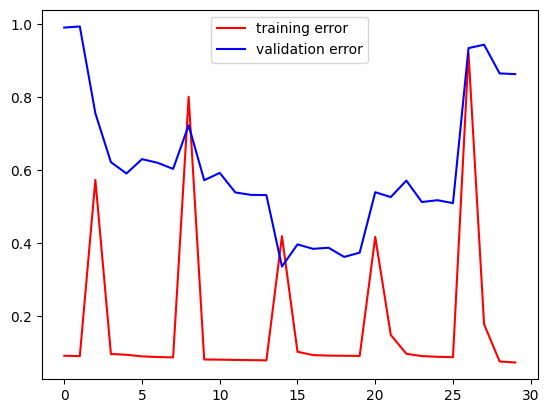

--------------------------------------------
Training = 66.66666666666667 %


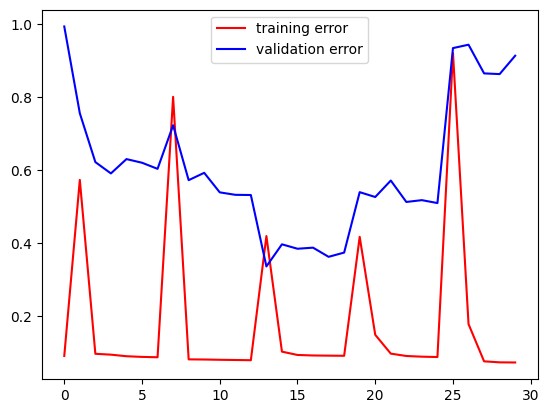

--------------------------------------------
Training = 83.33333333333333 %


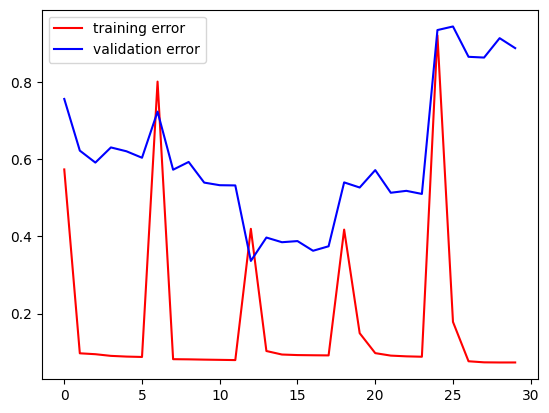

--------------------------------------------
epoch = 15
dim_clique = 45
training error = 0.0732416957616806
validation error = 0.8875328302383423
test error = 0.9950467944145203
--------------------------------------------
Training = 0.0 %


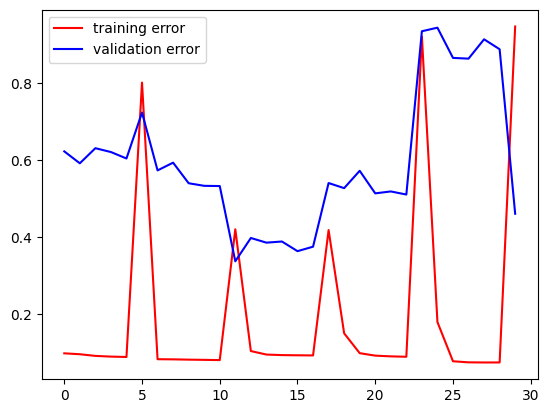

--------------------------------------------
Training = 16.666666666666668 %


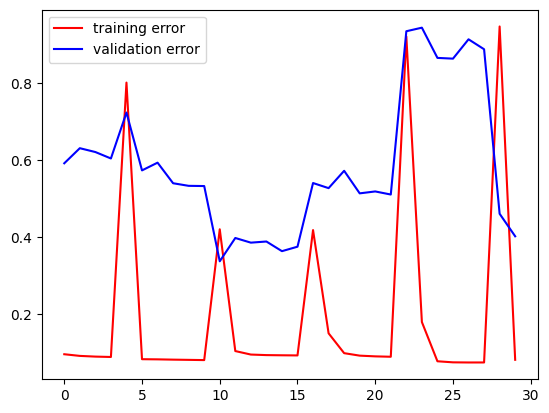

--------------------------------------------
Training = 33.333333333333336 %


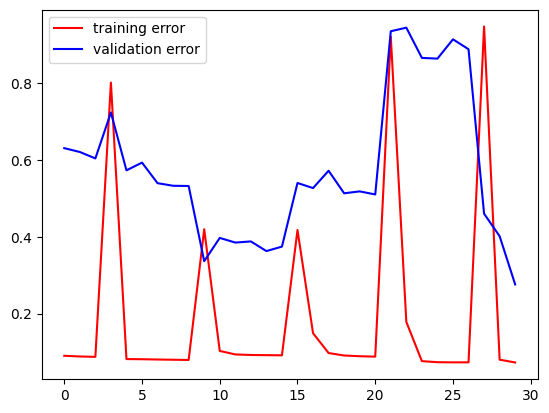

--------------------------------------------
Training = 50.0 %


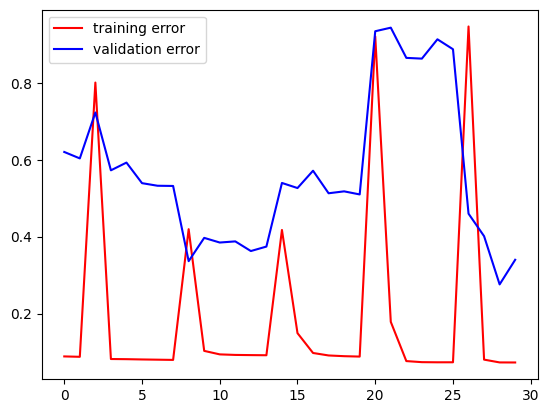

--------------------------------------------
Training = 66.66666666666667 %


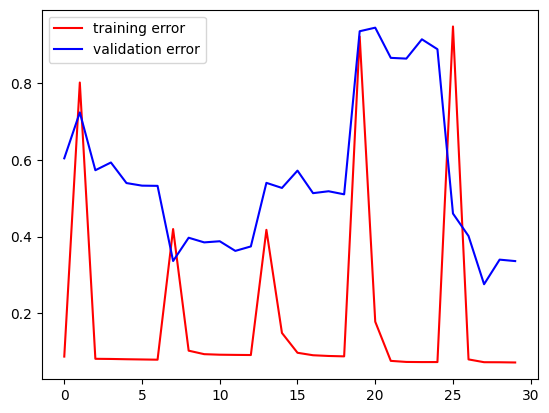

--------------------------------------------
Training = 83.33333333333333 %


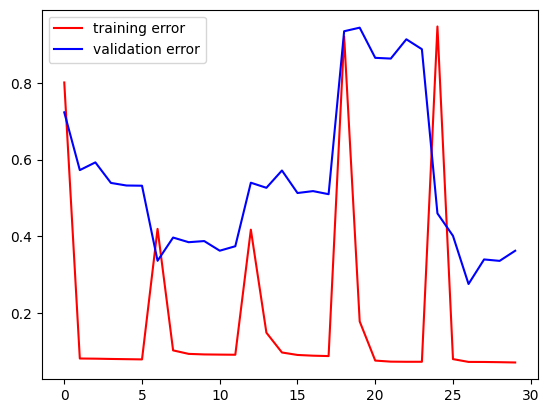

--------------------------------------------
epoch = 16
dim_clique = 45
training error = 0.07139869779348373
validation error = 0.36246514320373535
test error = 1.0154597759246826
--------------------------------------------
Training = 0.0 %


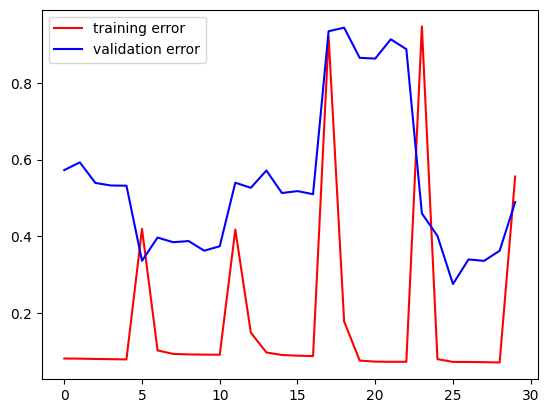

--------------------------------------------
Training = 16.666666666666668 %


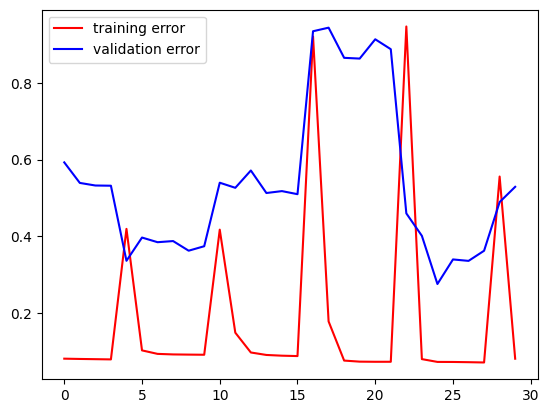

--------------------------------------------
Training = 33.333333333333336 %


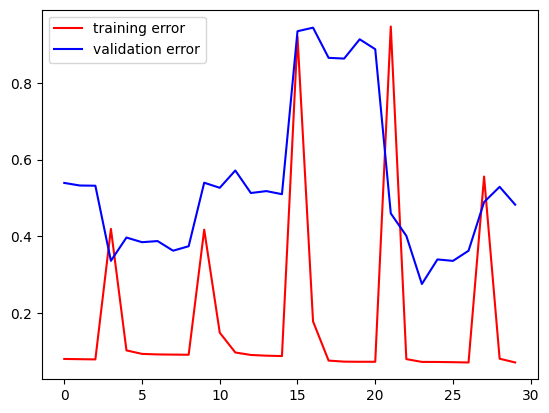

--------------------------------------------
Training = 50.0 %


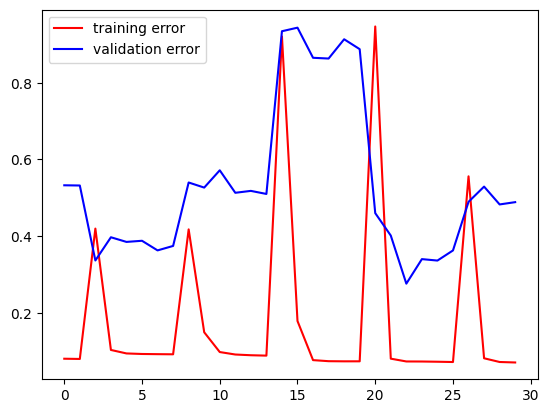

--------------------------------------------
Training = 66.66666666666667 %


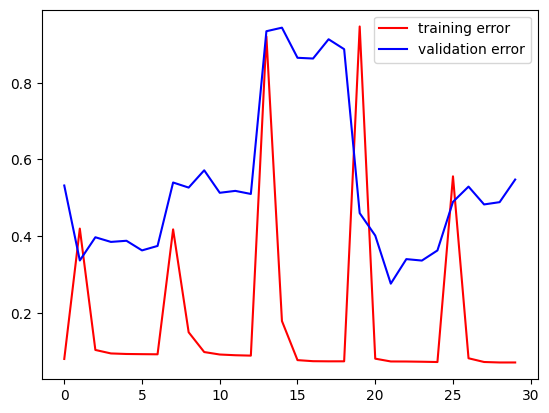

--------------------------------------------
Training = 83.33333333333333 %


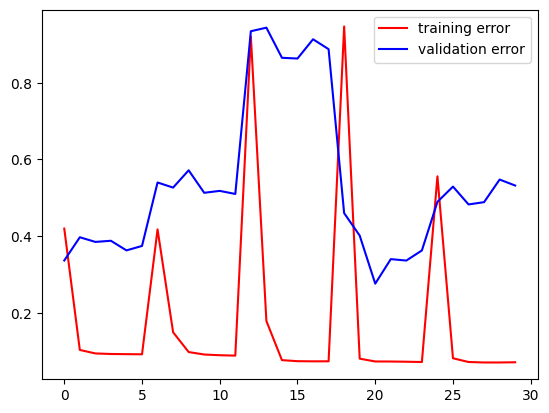

--------------------------------------------
epoch = 17
dim_clique = 45
training error = 0.07077919691801071
validation error = 0.53180330991745
test error = 0.9798941612243652
--------------------------------------------
Training = 0.0 %


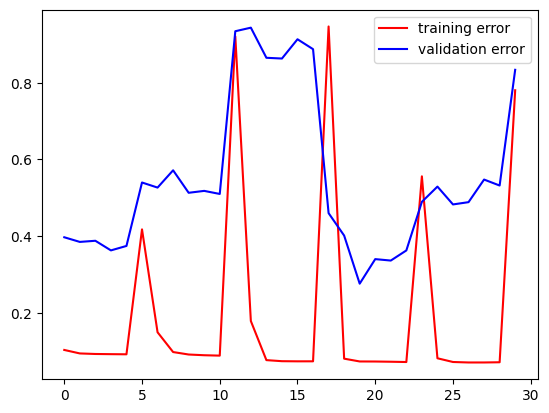

--------------------------------------------
Training = 16.666666666666668 %


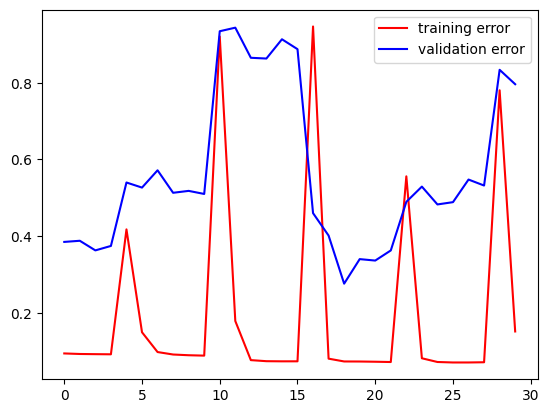

--------------------------------------------
Training = 33.333333333333336 %


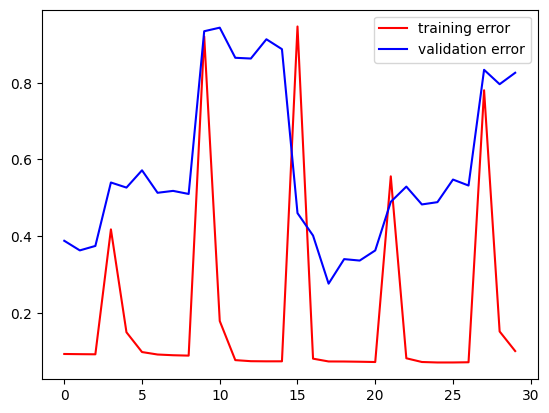

--------------------------------------------
Training = 50.0 %


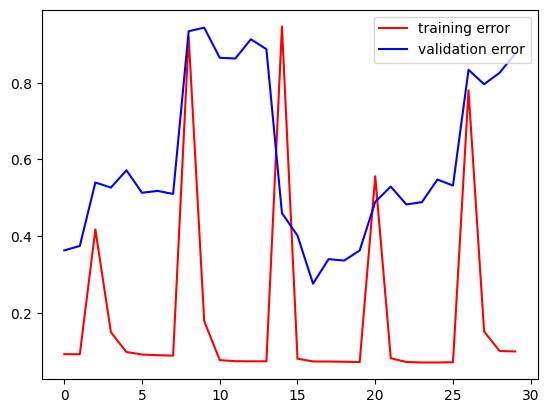

--------------------------------------------
Training = 66.66666666666667 %


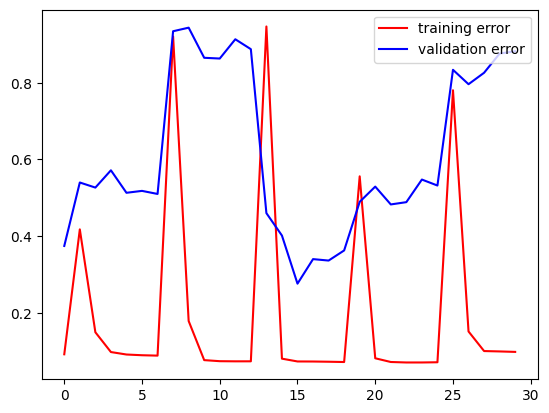

--------------------------------------------
Training = 83.33333333333333 %


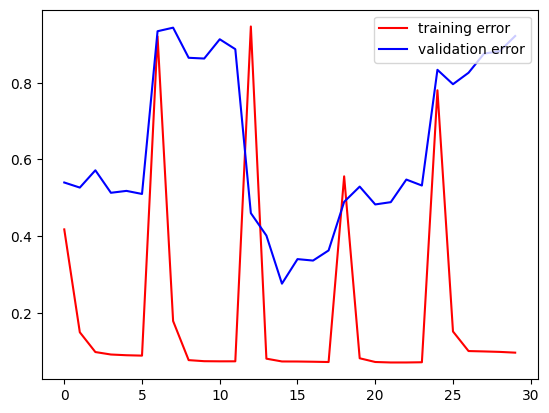

--------------------------------------------
epoch = 18
dim_clique = 45
training error = 0.09584197402000427
validation error = 0.9218796491622925
test error = 0.7531436085700989
--------------------------------------------
Training = 0.0 %


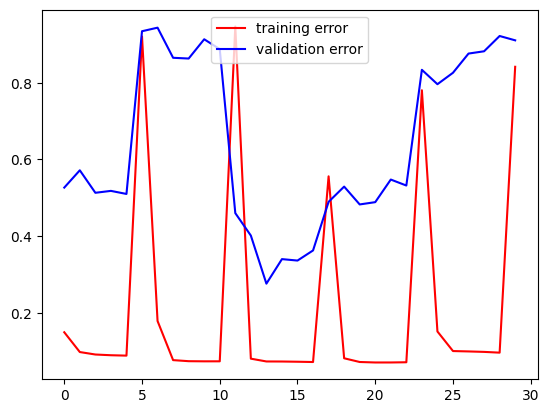

--------------------------------------------
Training = 16.666666666666668 %


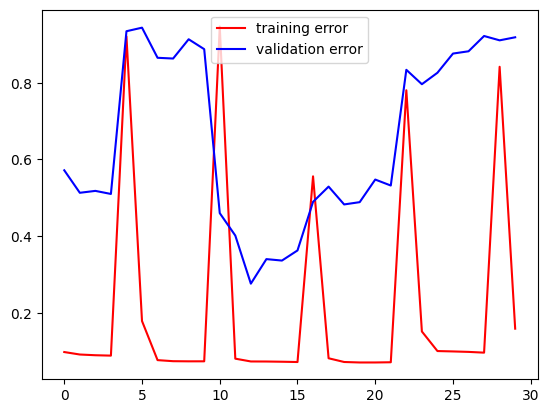

--------------------------------------------
Training = 33.333333333333336 %


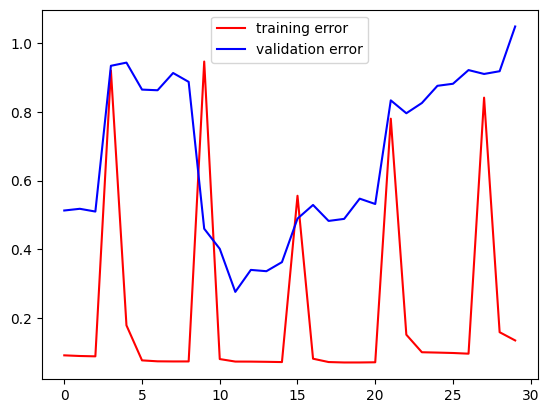

--------------------------------------------
Training = 50.0 %


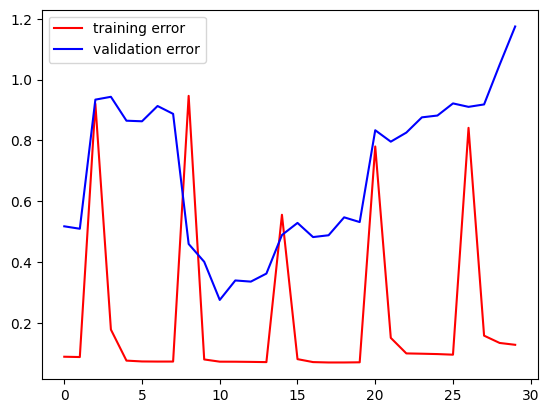

--------------------------------------------
Training = 66.66666666666667 %


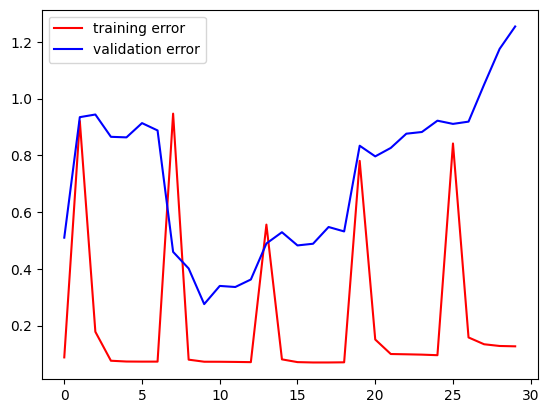

--------------------------------------------
Training = 83.33333333333333 %


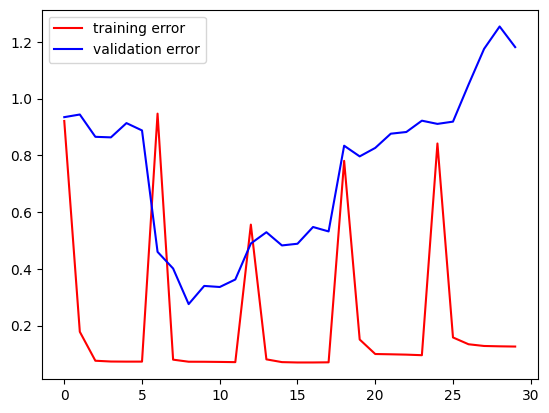

--------------------------------------------
epoch = 19
dim_clique = 45
training error = 0.1263146698474884
validation error = 1.181023120880127
test error = 0.6591277718544006
--------------------------------------------
Training = 0.0 %


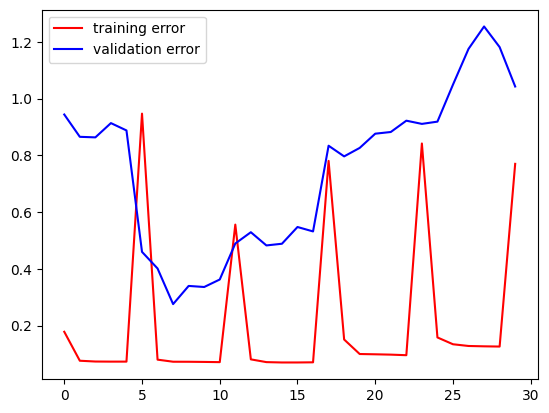

--------------------------------------------
Training = 16.666666666666668 %


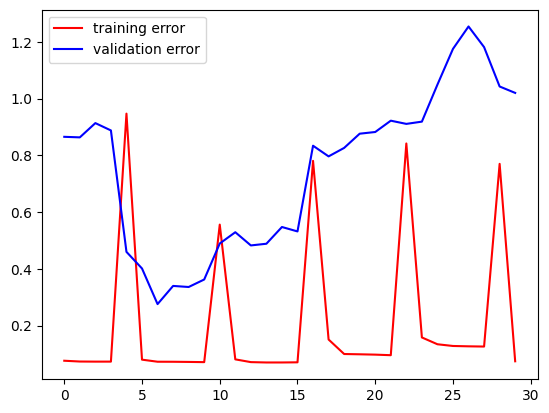

--------------------------------------------
Training = 33.333333333333336 %


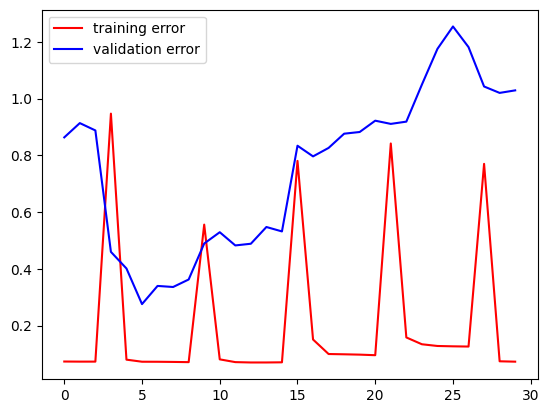

--------------------------------------------
Training = 50.0 %


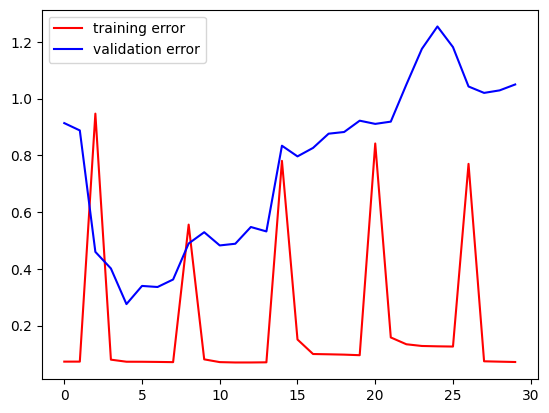

--------------------------------------------
Training = 66.66666666666667 %


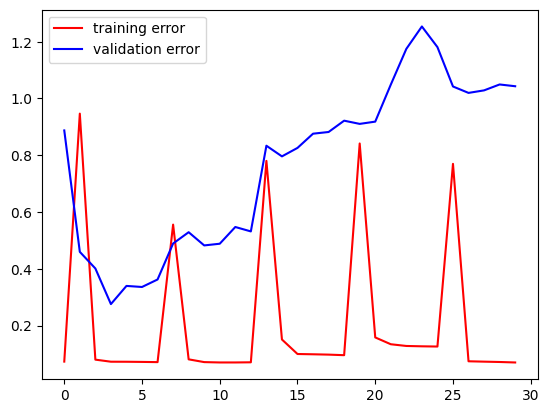

--------------------------------------------
Training = 83.33333333333333 %


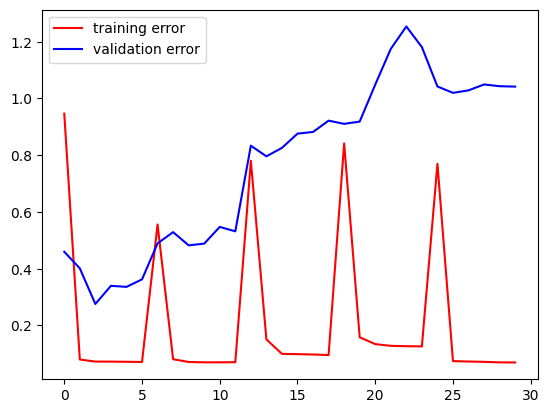

--------------------------------------------
epoch = 20
dim_clique = 45
training error = 0.06968456506729126
validation error = 1.0418272018432617
test error = 0.5578504800796509
--------------------------------------------
Training = 0.0 %


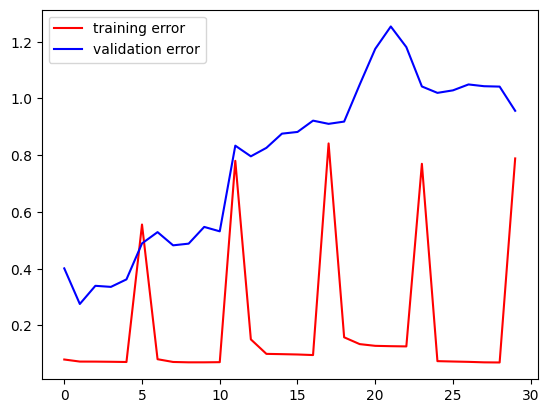

--------------------------------------------
Training = 16.666666666666668 %


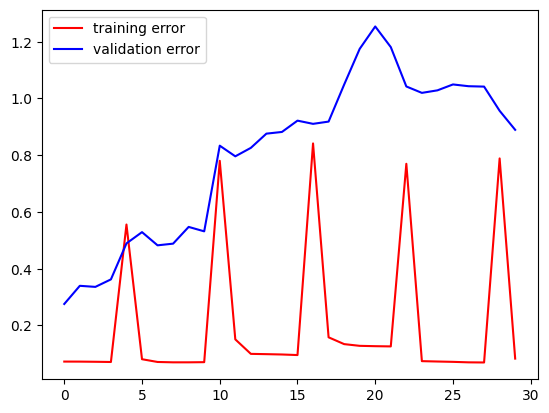

--------------------------------------------
Training = 33.333333333333336 %


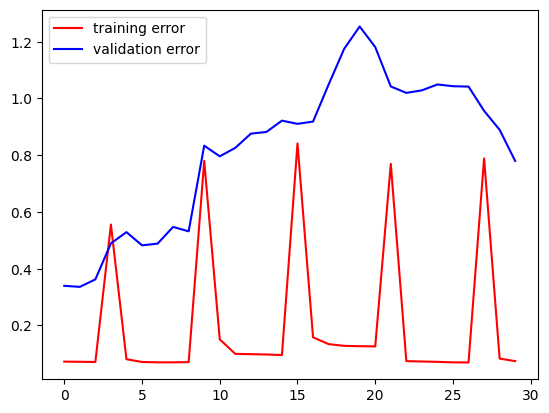

--------------------------------------------
Training = 50.0 %


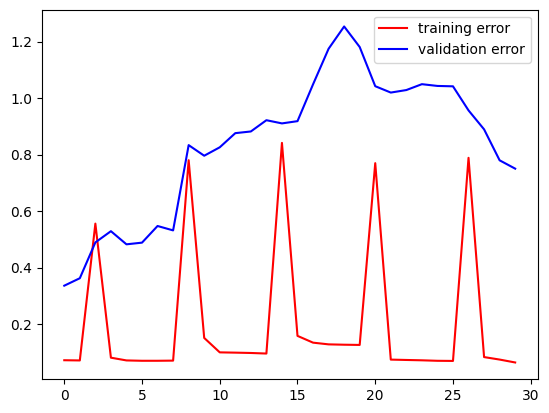

--------------------------------------------
Training = 66.66666666666667 %


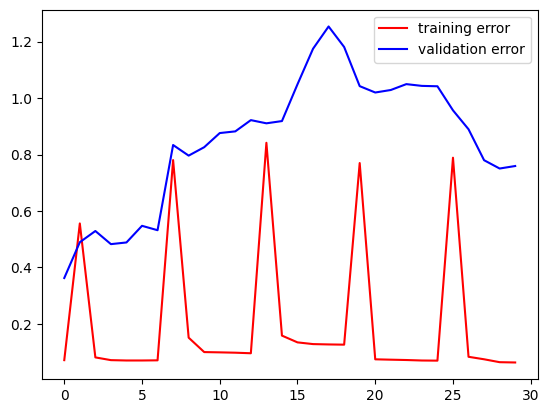

--------------------------------------------
Training = 83.33333333333333 %


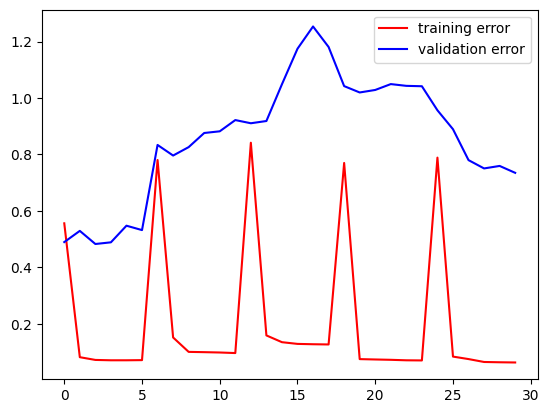

--------------------------------------------
epoch = 21
dim_clique = 45
training error = 0.06244262307882309
validation error = 0.734817385673523
test error = 0.7690127491950989
--------------------------------------------
Training = 0.0 %


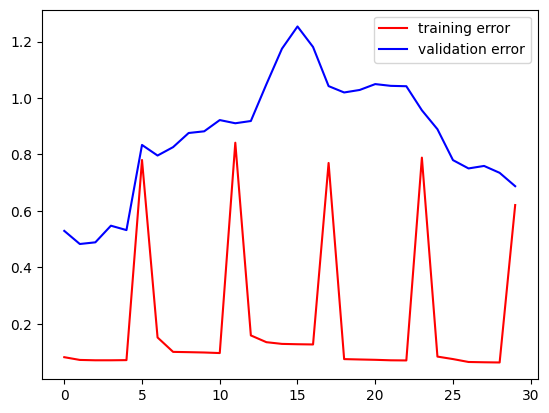

--------------------------------------------
Training = 16.666666666666668 %


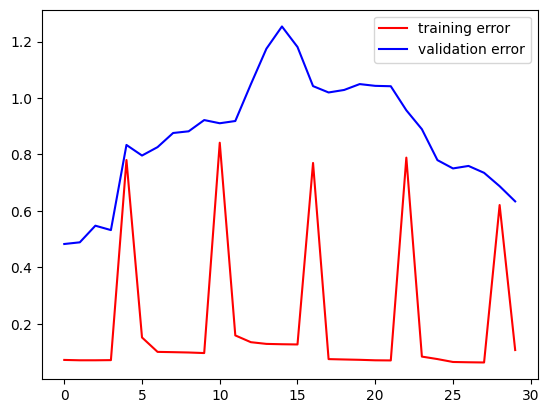

--------------------------------------------
Training = 33.333333333333336 %


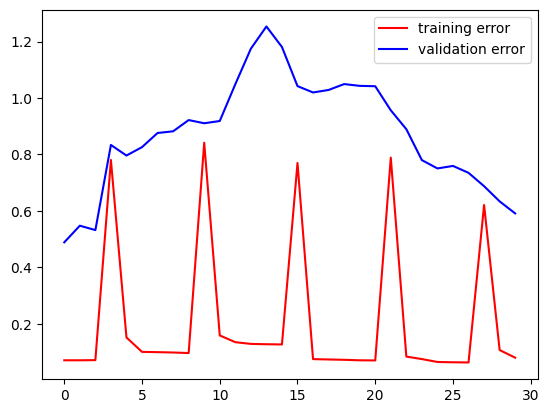

--------------------------------------------
Training = 50.0 %


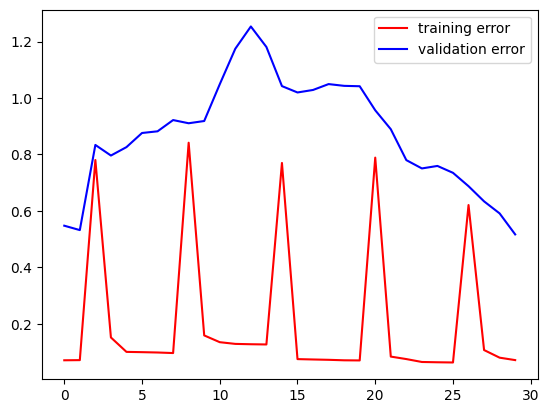

--------------------------------------------
Training = 66.66666666666667 %


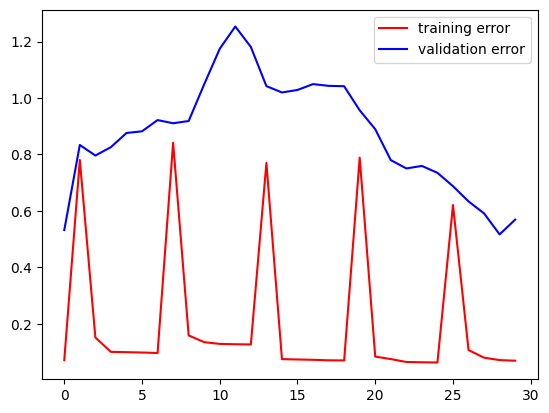

--------------------------------------------
Training = 83.33333333333333 %


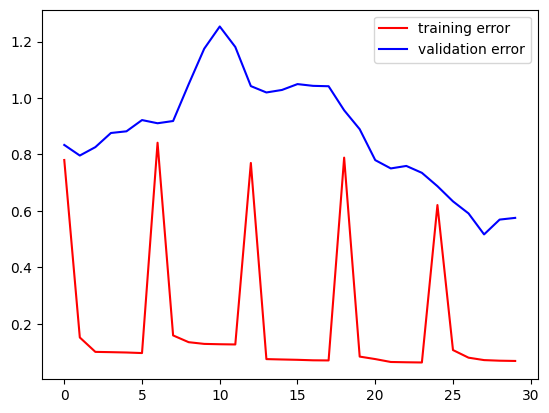

--------------------------------------------
epoch = 22
dim_clique = 45
training error = 0.0678529217839241
validation error = 0.5750991702079773
test error = 0.9434175491333008
--------------------------------------------
Training = 0.0 %


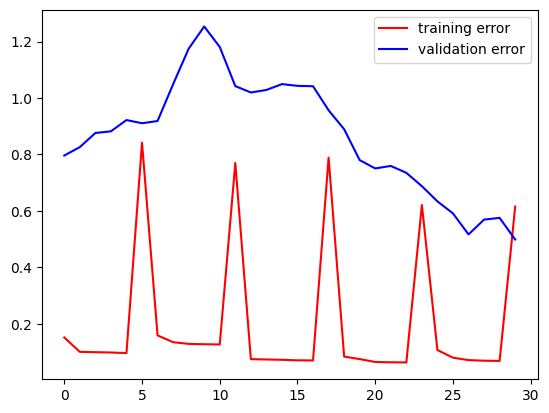

--------------------------------------------
Training = 16.666666666666668 %


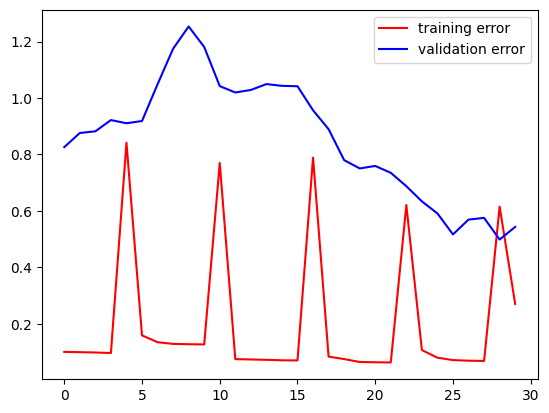

--------------------------------------------
Training = 33.333333333333336 %


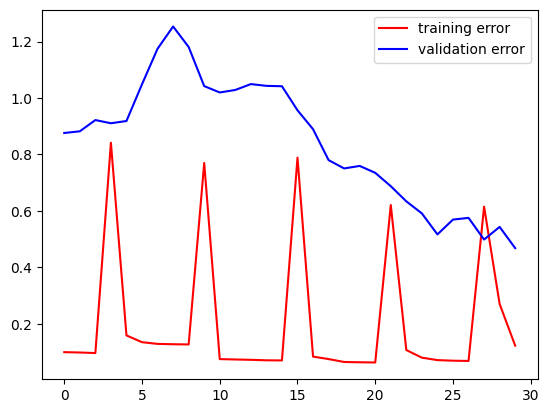

--------------------------------------------
Training = 50.0 %


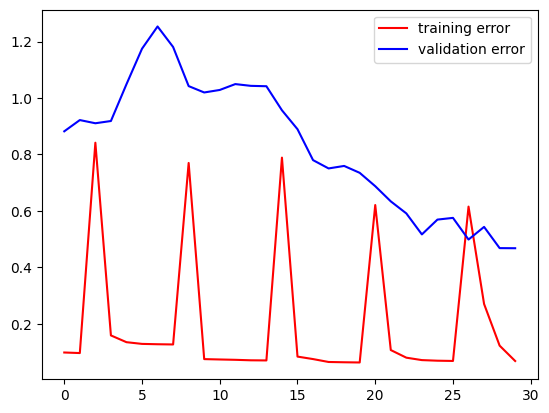

--------------------------------------------
Training = 66.66666666666667 %


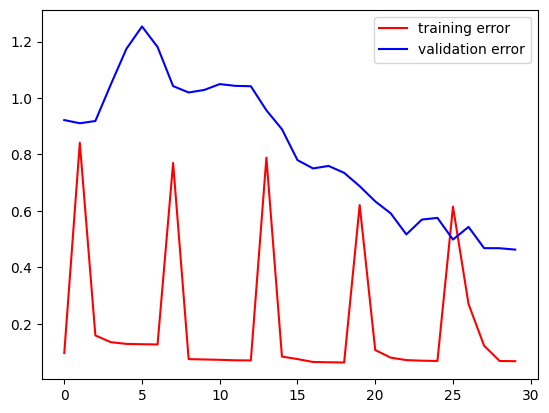

--------------------------------------------
Training = 83.33333333333333 %


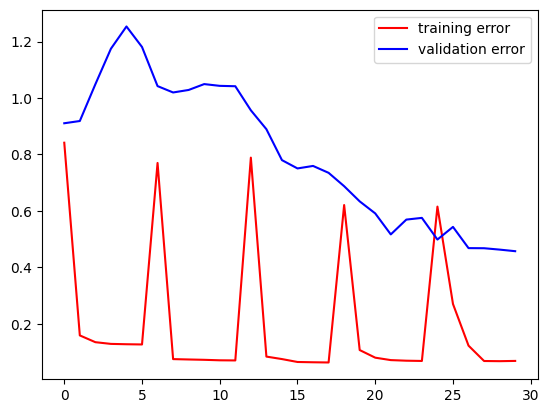

--------------------------------------------
epoch = 23
dim_clique = 45
training error = 0.06796617805957794
validation error = 0.45699548721313477
test error = 0.8869398236274719
--------------------------------------------
Training = 0.0 %


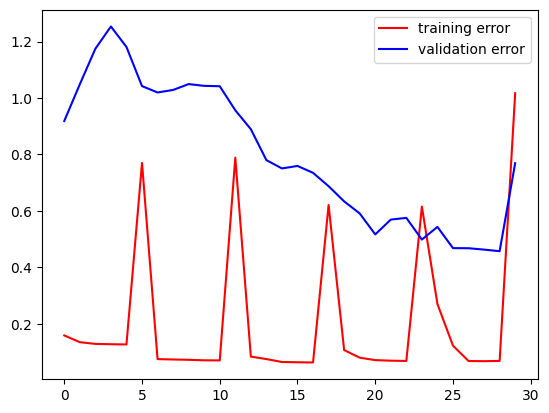

--------------------------------------------
Training = 16.666666666666668 %


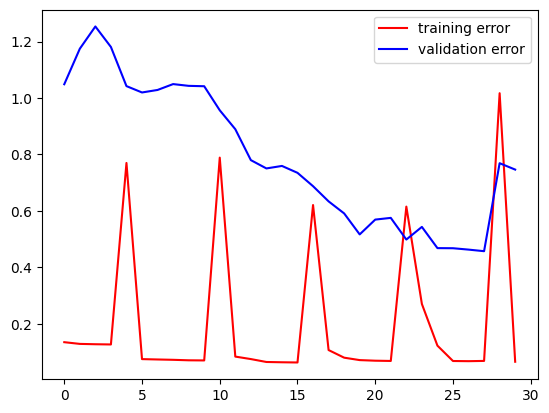

--------------------------------------------
Training = 33.333333333333336 %


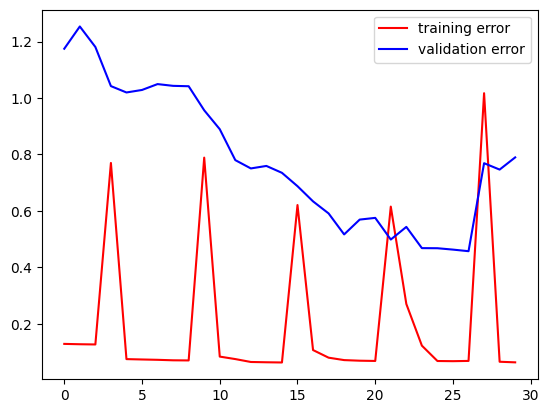

--------------------------------------------
Training = 50.0 %


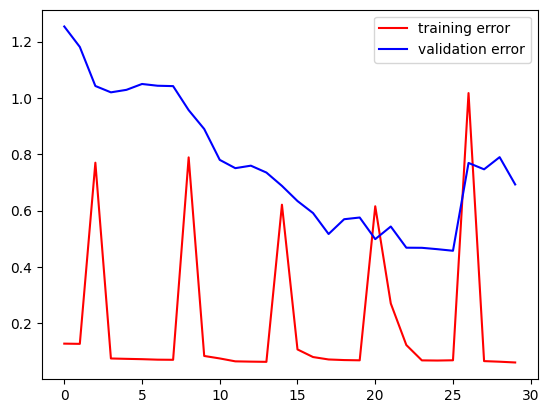

--------------------------------------------
Training = 66.66666666666667 %


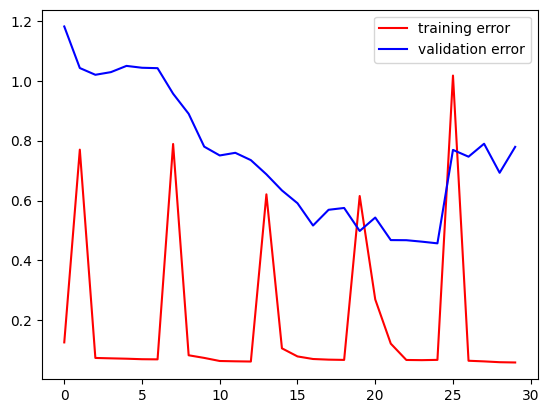

--------------------------------------------
Training = 83.33333333333333 %


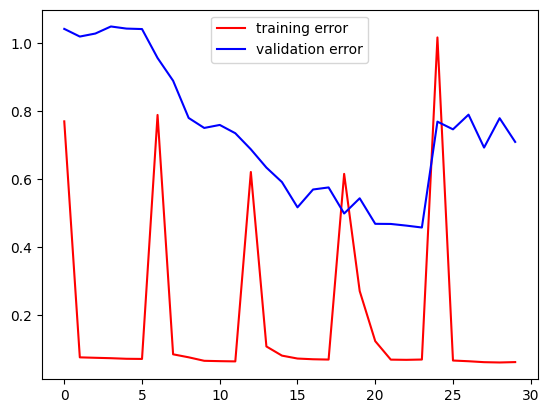

--------------------------------------------
epoch = 24
dim_clique = 45
training error = 0.06040138006210327
validation error = 0.7092388272285461
test error = 1.064673662185669
--------------------------------------------
Training = 0.0 %


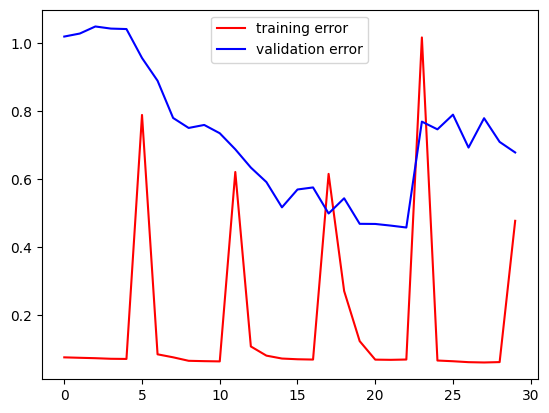

--------------------------------------------
Training = 16.666666666666668 %


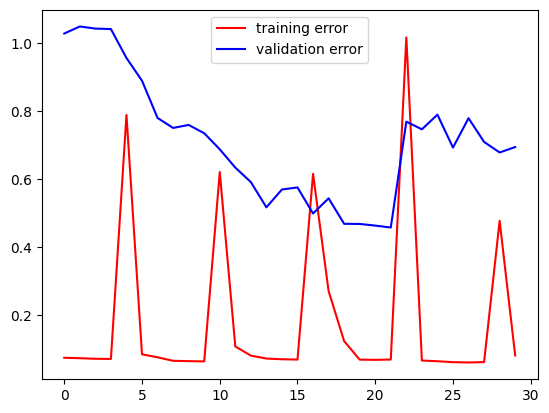

--------------------------------------------
Training = 33.333333333333336 %


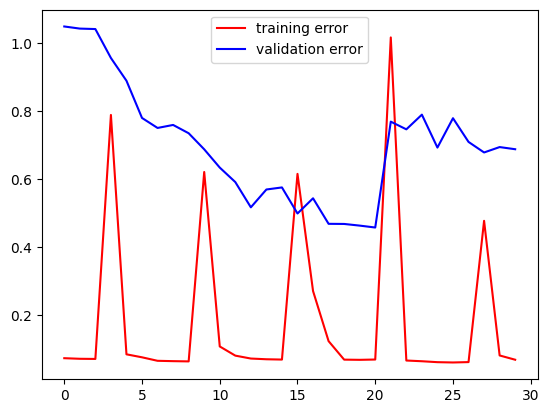

--------------------------------------------
Training = 50.0 %


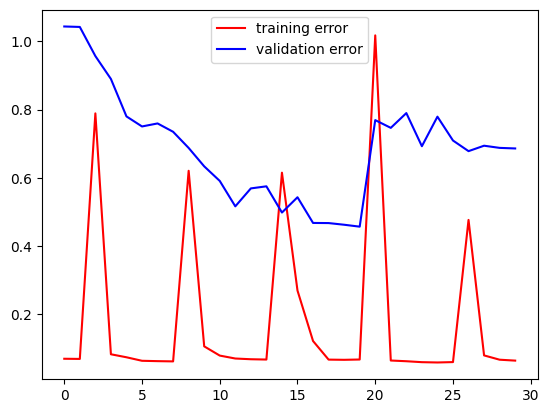

--------------------------------------------
Training = 66.66666666666667 %


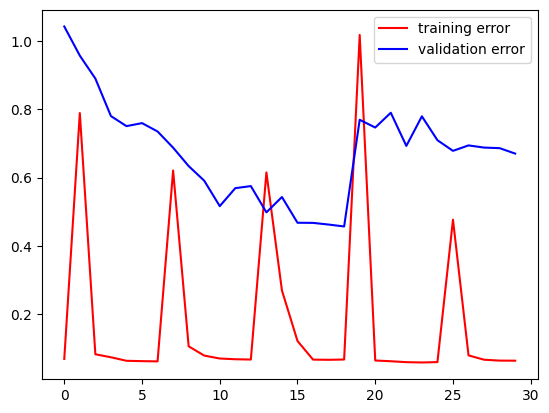

--------------------------------------------
Training = 83.33333333333333 %


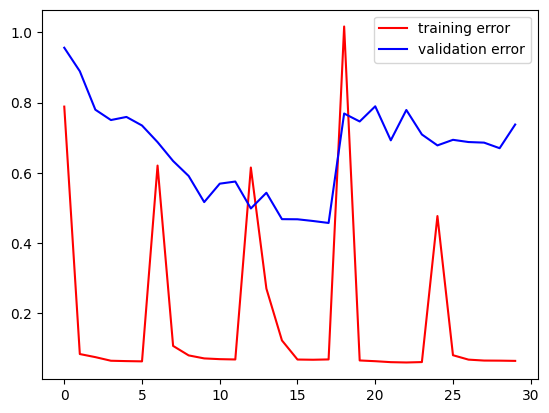

--------------------------------------------
epoch = 25
dim_clique = 45
training error = 0.06381885707378387
validation error = 0.7376192808151245
test error = 1.1027580499649048
--------------------------------------------
Training = 0.0 %


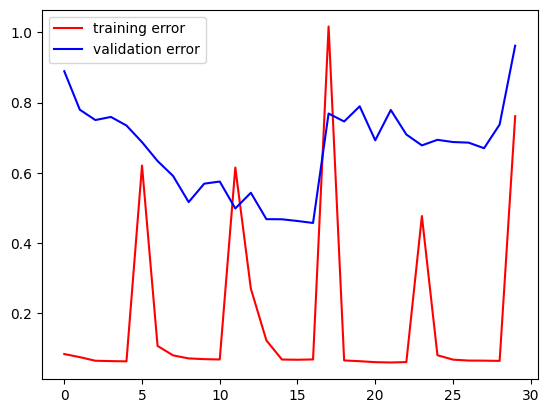

--------------------------------------------
Training = 16.666666666666668 %


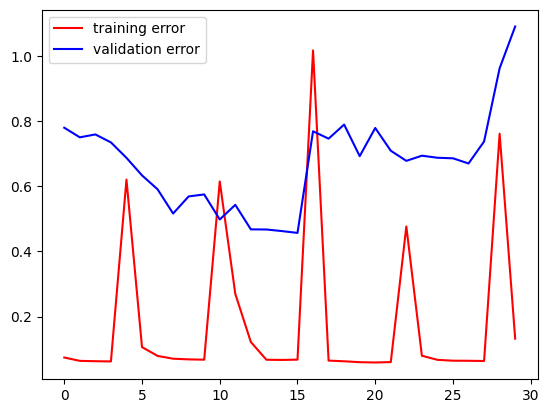

--------------------------------------------
Training = 33.333333333333336 %


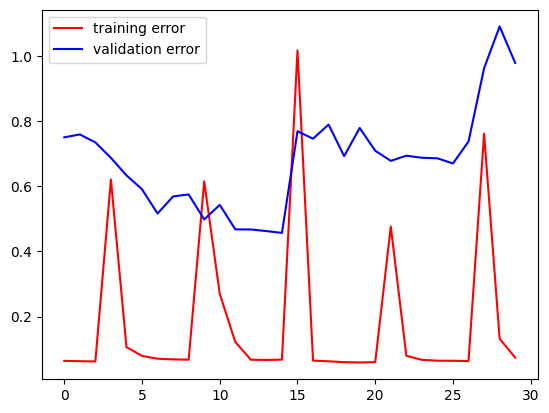

--------------------------------------------
Training = 50.0 %


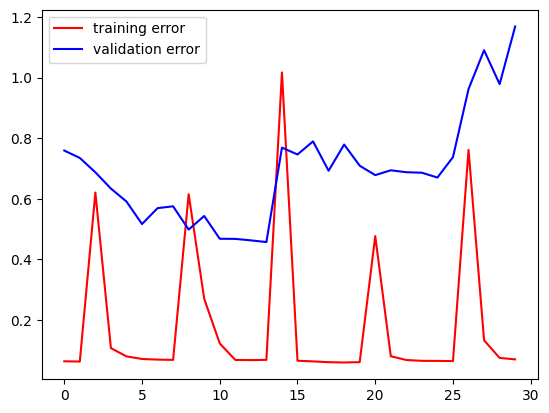

--------------------------------------------
Training = 66.66666666666667 %


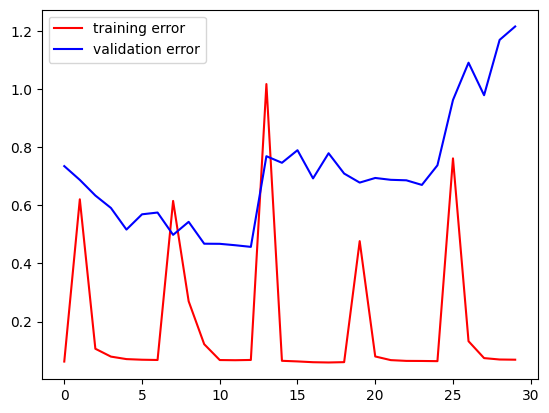

--------------------------------------------
Training = 83.33333333333333 %


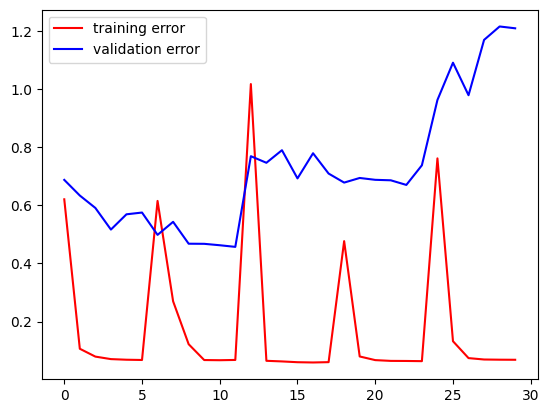

--------------------------------------------
epoch = 26
dim_clique = 45
training error = 0.06857464462518692
validation error = 1.2089563608169556
test error = 1.0612872838974
--------------------------------------------
Training = 0.0 %


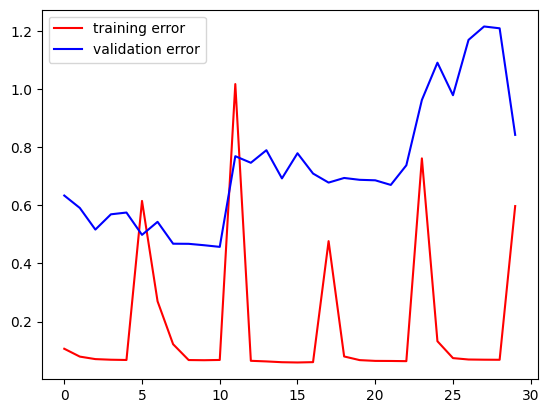

--------------------------------------------
Training = 16.666666666666668 %


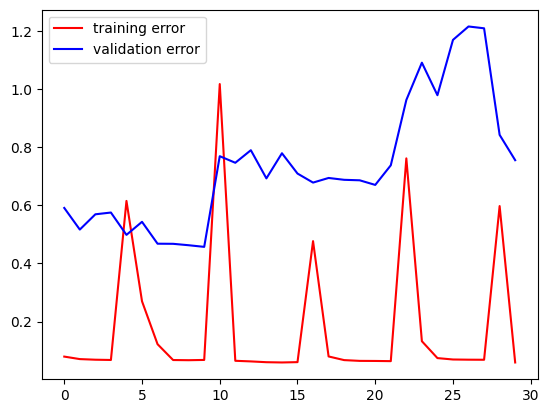

--------------------------------------------
Training = 33.333333333333336 %


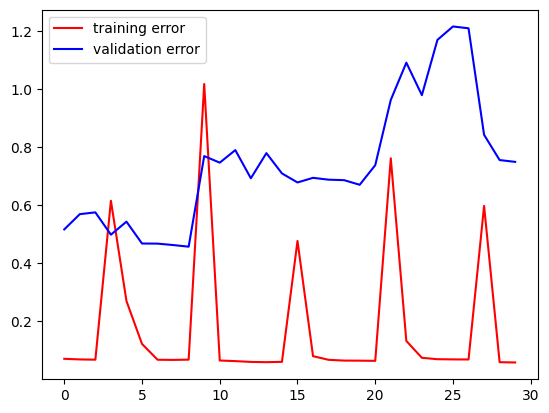

--------------------------------------------
Training = 50.0 %


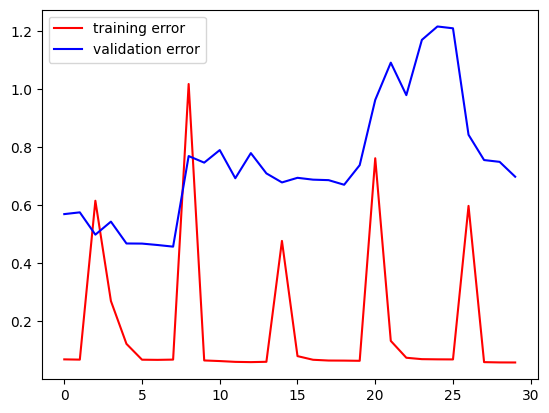

--------------------------------------------
Training = 66.66666666666667 %


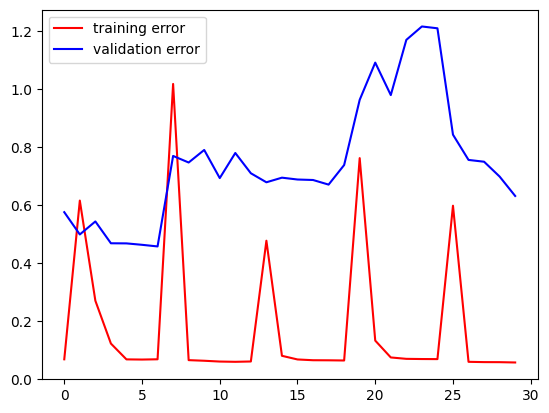

--------------------------------------------
Training = 83.33333333333333 %


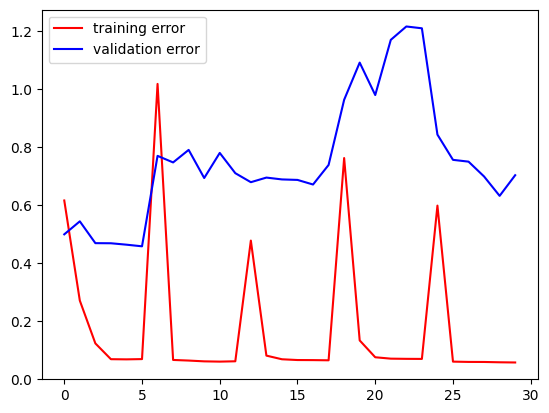

--------------------------------------------
epoch = 27
dim_clique = 45
training error = 0.05630473420023918
validation error = 0.7022302746772766
test error = 0.9103018641471863
--------------------------------------------
Training = 0.0 %


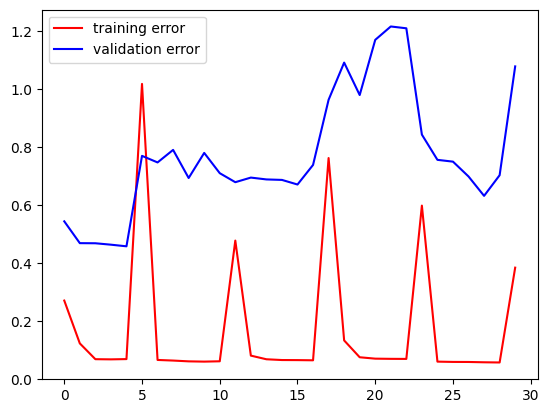

--------------------------------------------
Training = 16.666666666666668 %


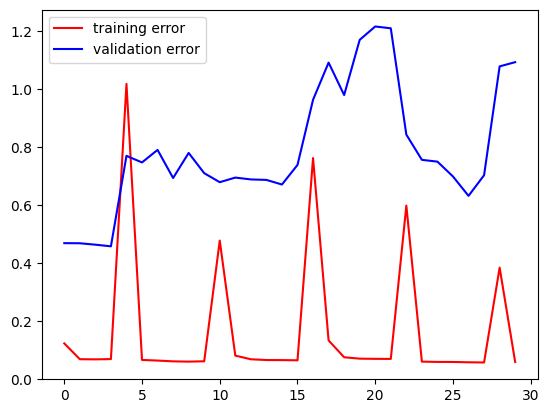

--------------------------------------------
Training = 33.333333333333336 %


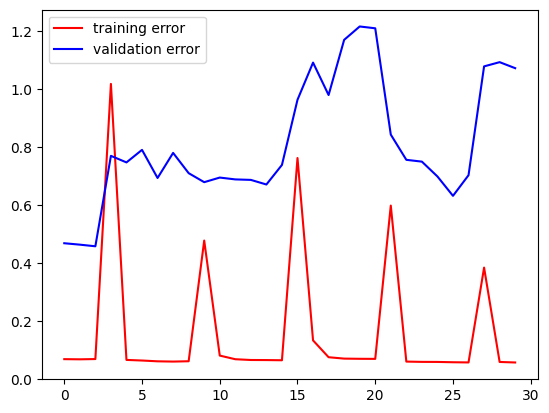

--------------------------------------------
Training = 50.0 %


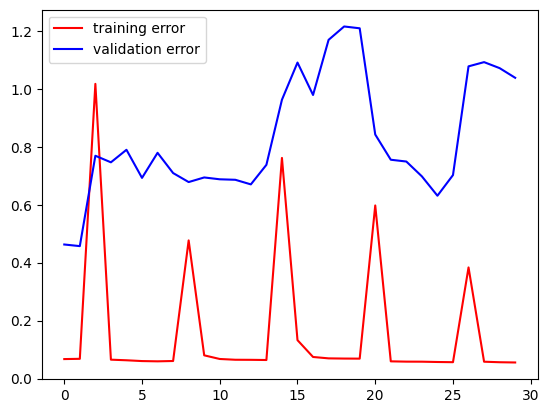

--------------------------------------------
Training = 66.66666666666667 %


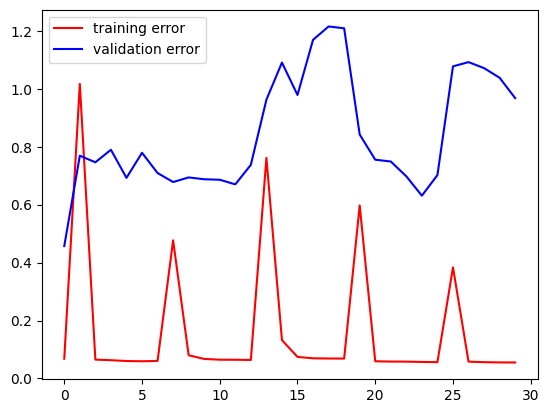

--------------------------------------------
Training = 83.33333333333333 %


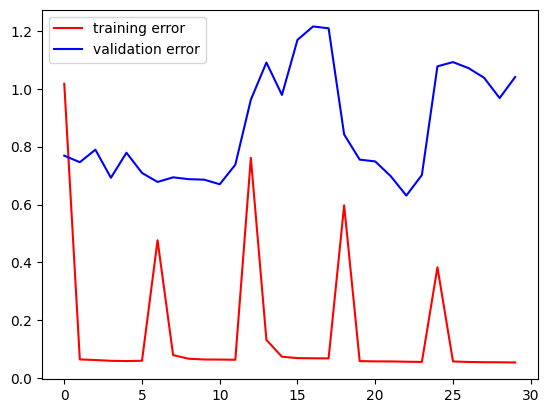

--------------------------------------------
epoch = 28
dim_clique = 45
training error = 0.05441119521856308
validation error = 1.0407170057296753
test error = 1.051155686378479
--------------------------------------------
Training = 0.0 %


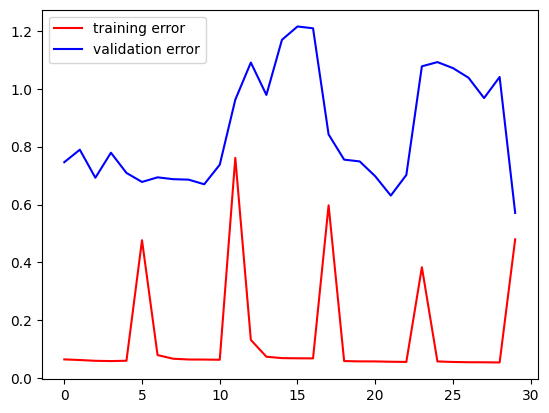

--------------------------------------------
Training = 16.666666666666668 %


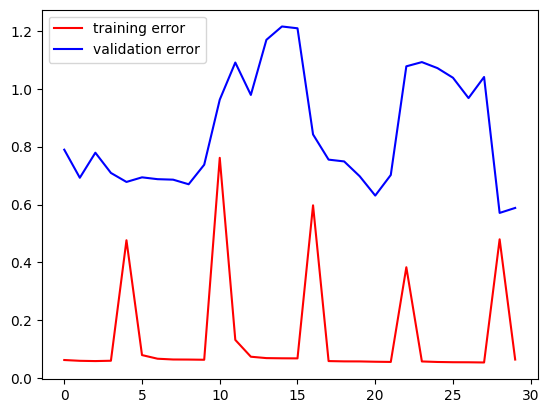

--------------------------------------------
Training = 33.333333333333336 %


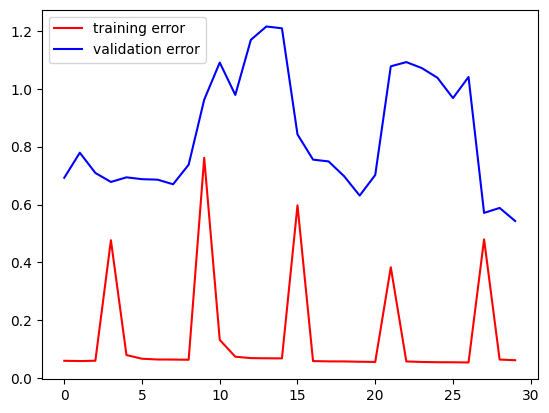

--------------------------------------------
Training = 50.0 %


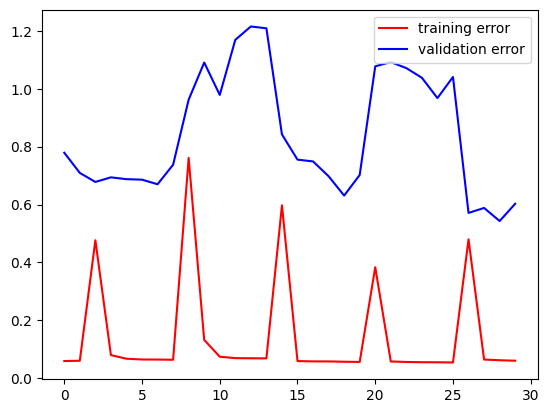

--------------------------------------------
Training = 66.66666666666667 %


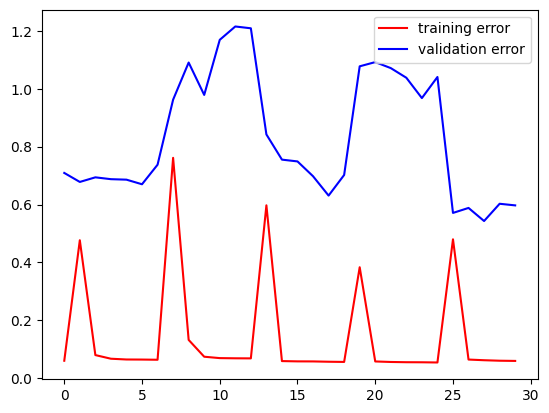

--------------------------------------------
Training = 83.33333333333333 %


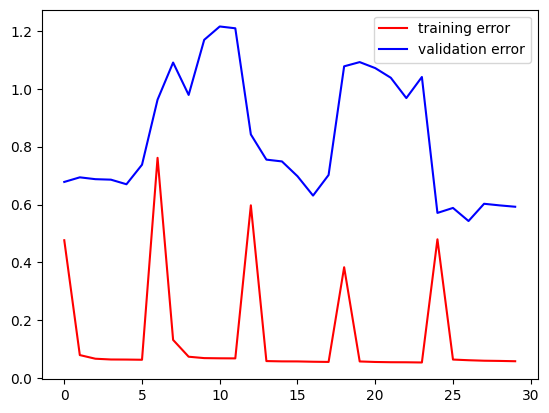

--------------------------------------------
epoch = 29
dim_clique = 45
training error = 0.0587225966155529
validation error = 0.5924426913261414
test error = 0.8901117444038391
--------------------------------------------
Training = 0.0 %


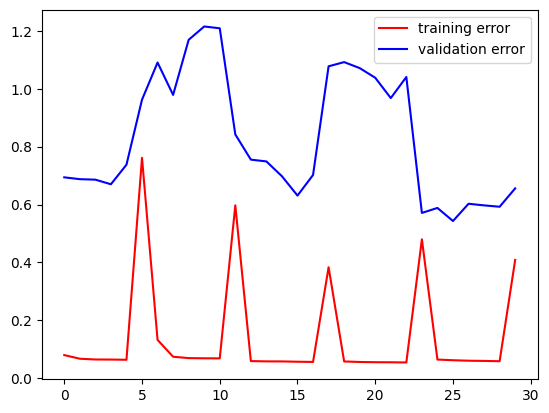

--------------------------------------------
Training = 16.666666666666668 %


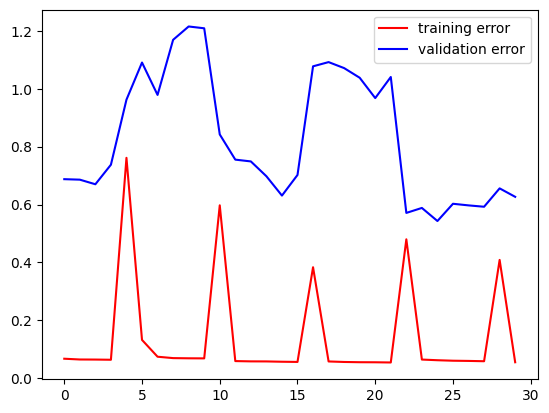

--------------------------------------------
Training = 33.333333333333336 %


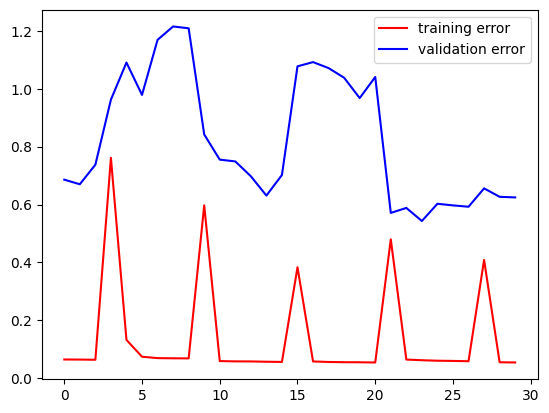

--------------------------------------------
Training = 50.0 %


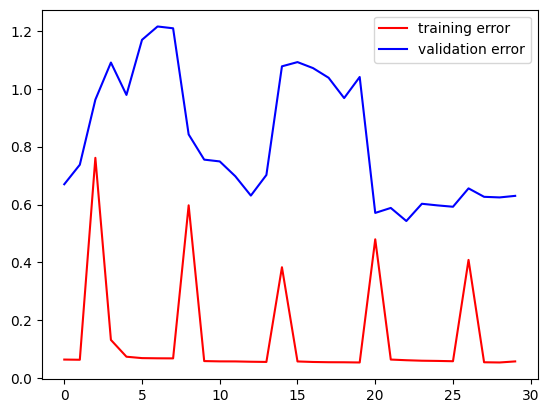

--------------------------------------------
Training = 66.66666666666667 %


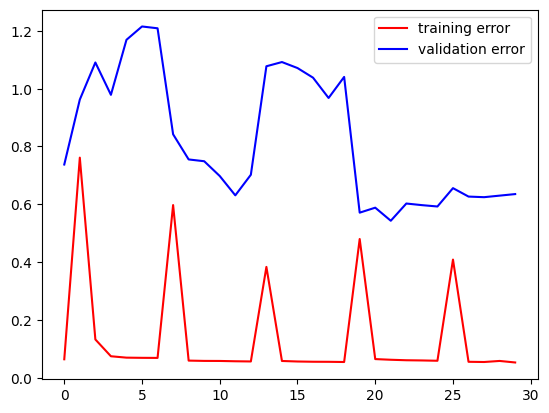

--------------------------------------------
Training = 83.33333333333333 %


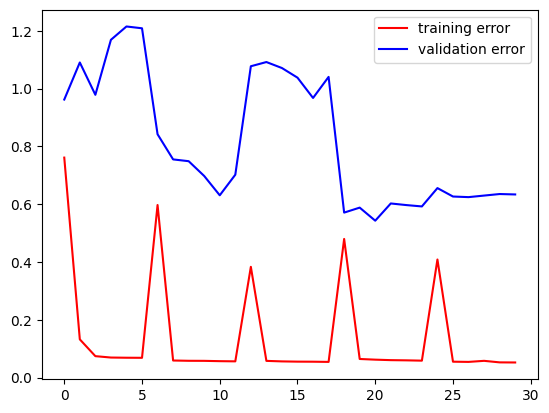

--------------------------------------------
epoch = 30
dim_clique = 45
training error = 0.0524129681289196
validation error = 0.6339196562767029
test error = 0.6297954320907593
--------------------------------------------
Training = 0.0 %


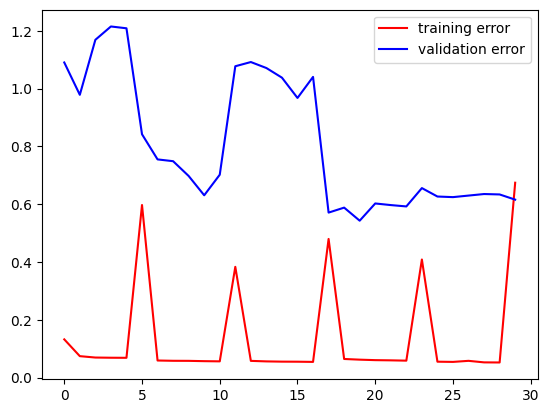

--------------------------------------------
Training = 16.666666666666668 %


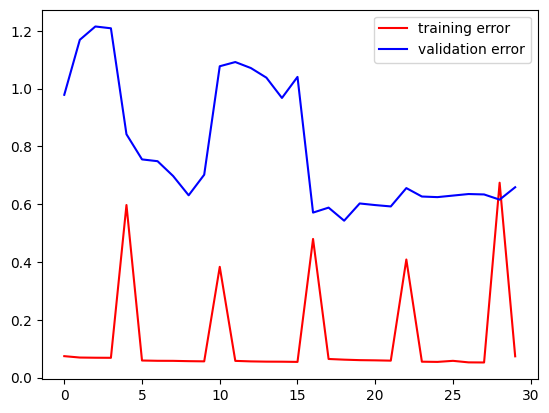

--------------------------------------------
Training = 33.333333333333336 %


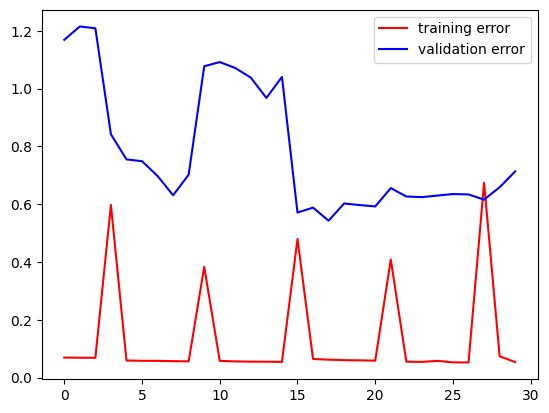

--------------------------------------------
Training = 50.0 %


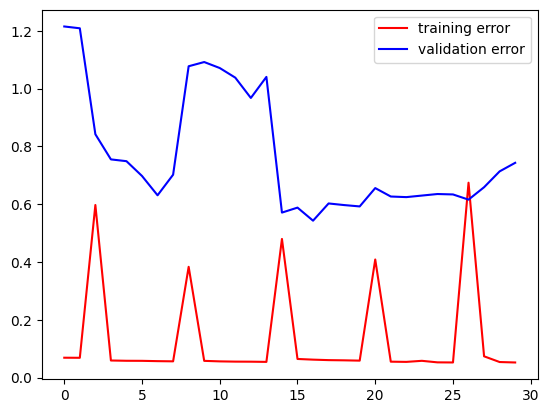

--------------------------------------------
Training = 66.66666666666667 %


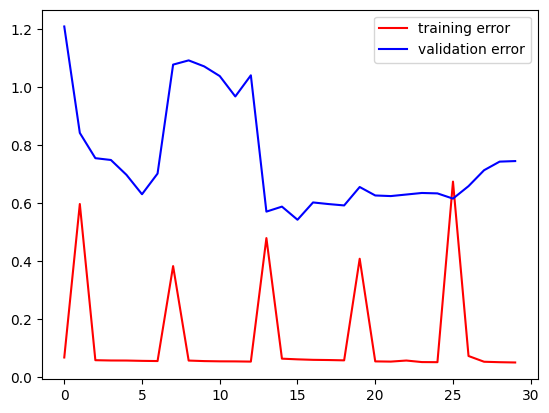

--------------------------------------------
Training = 83.33333333333333 %


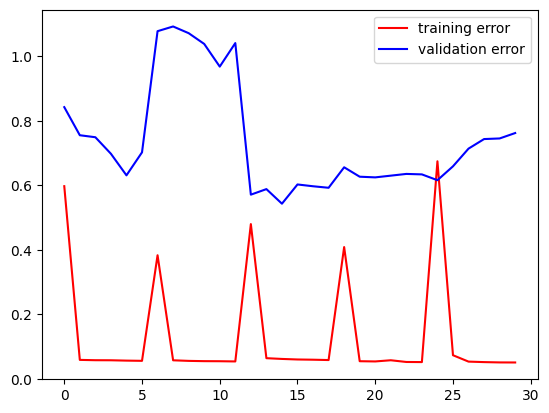

--------------------------------------------
epoch = 31
dim_clique = 45
training error = 0.05121013522148132
validation error = 0.7619936466217041
test error = 0.7201718091964722
--------------------------------------------
Training = 0.0 %


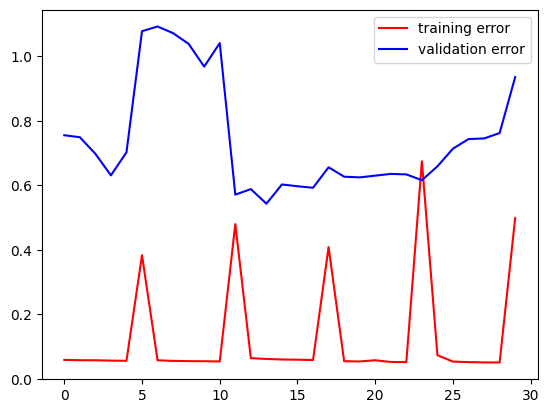

--------------------------------------------
Training = 16.666666666666668 %


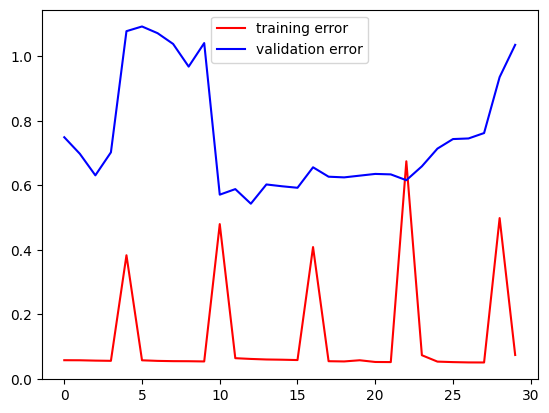

--------------------------------------------
Training = 33.333333333333336 %


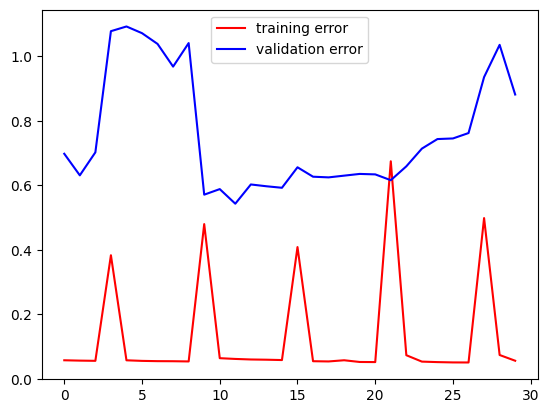

--------------------------------------------
Training = 50.0 %


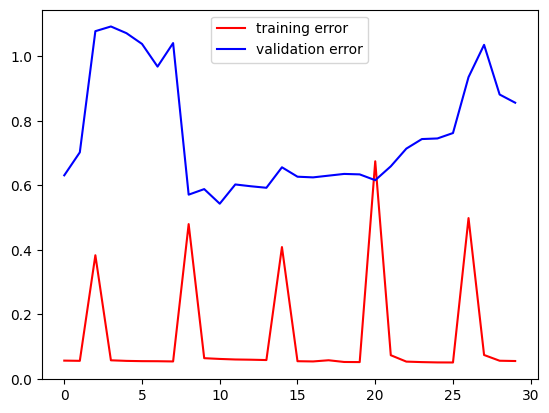

--------------------------------------------
Training = 66.66666666666667 %


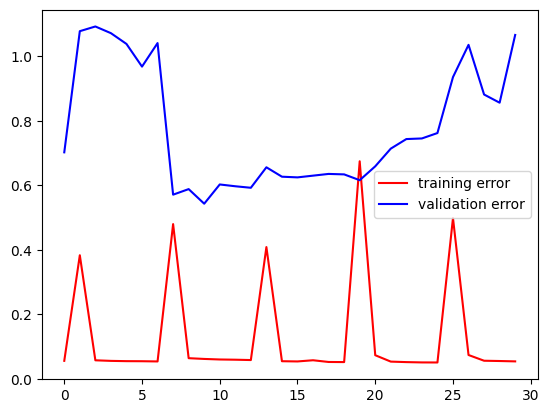

--------------------------------------------
Training = 83.33333333333333 %


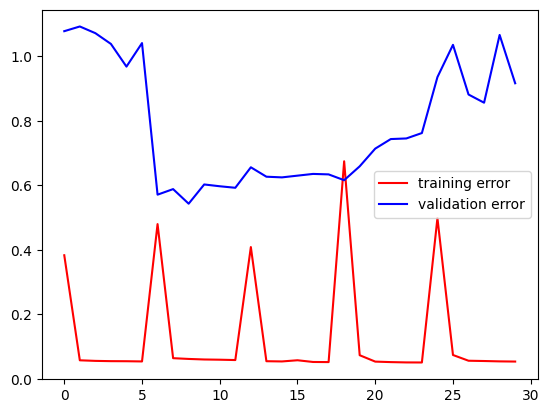

--------------------------------------------
epoch = 32
dim_clique = 45
training error = 0.054075002670288086
validation error = 0.9161683917045593
test error = 0.7911757230758667
--------------------------------------------
Training = 0.0 %


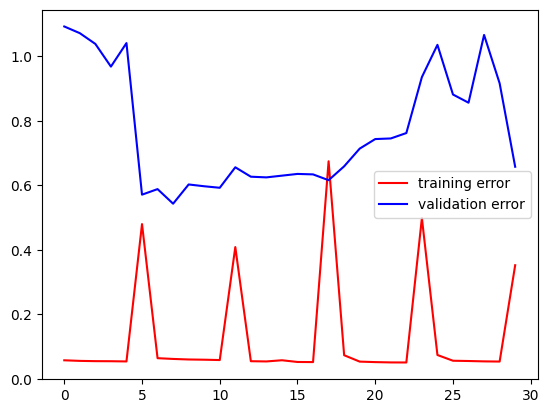

--------------------------------------------
Training = 16.666666666666668 %


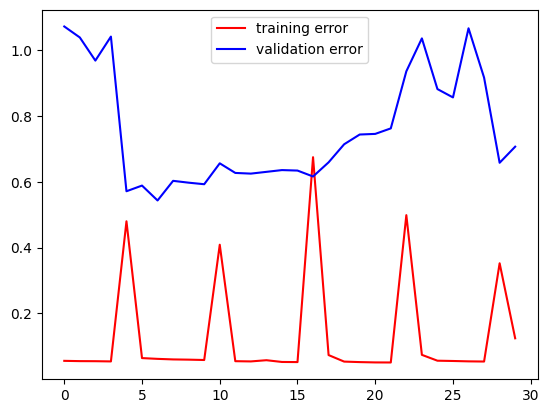

--------------------------------------------
Training = 33.333333333333336 %


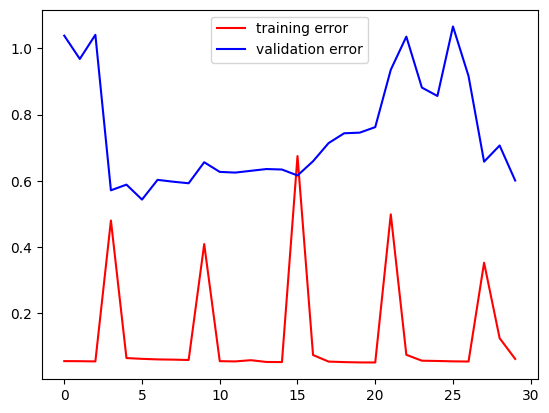

--------------------------------------------
Training = 50.0 %


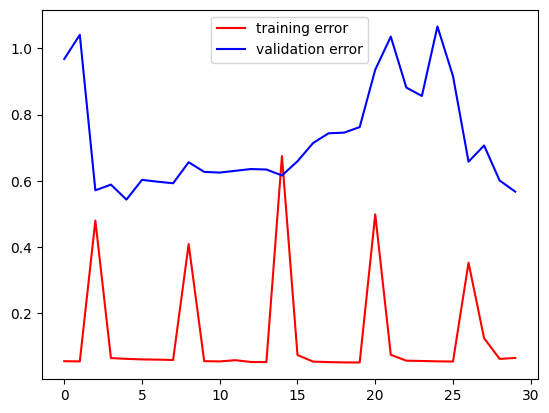

--------------------------------------------
Training = 66.66666666666667 %


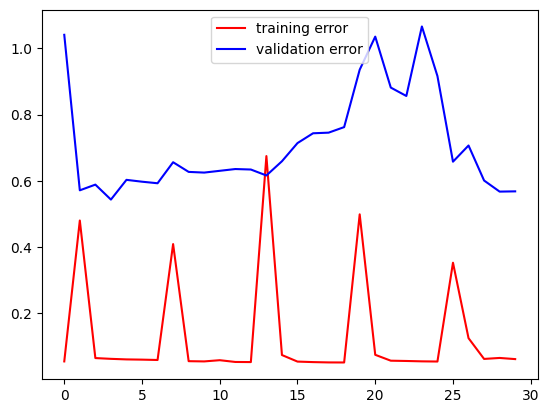

--------------------------------------------
Training = 83.33333333333333 %


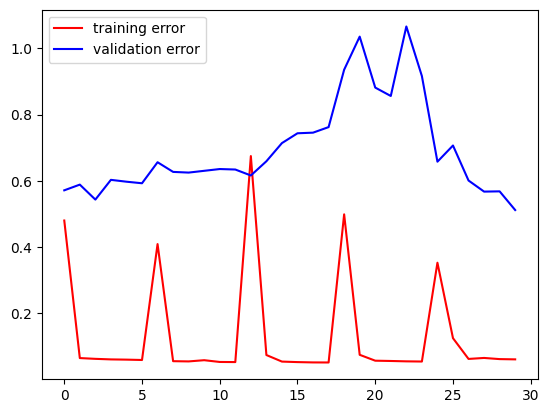

--------------------------------------------
epoch = 33
dim_clique = 45
training error = 0.06060074642300606
validation error = 0.5115454792976379
test error = 0.647261381149292
--------------------------------------------
Training = 0.0 %


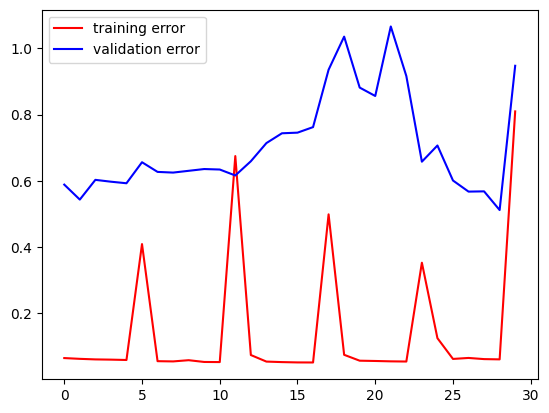

--------------------------------------------
Training = 16.666666666666668 %


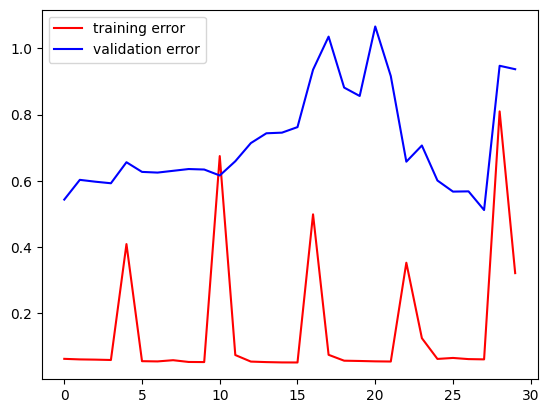

--------------------------------------------
Training = 33.333333333333336 %


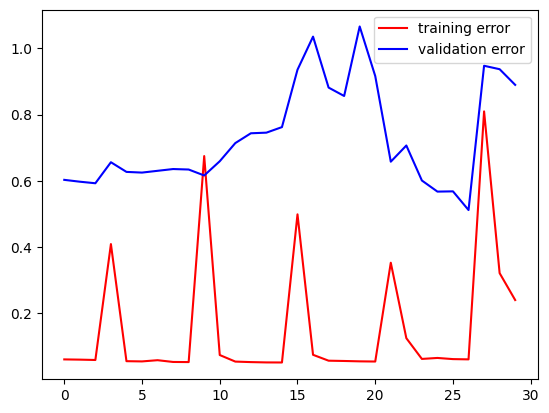

--------------------------------------------
Training = 50.0 %


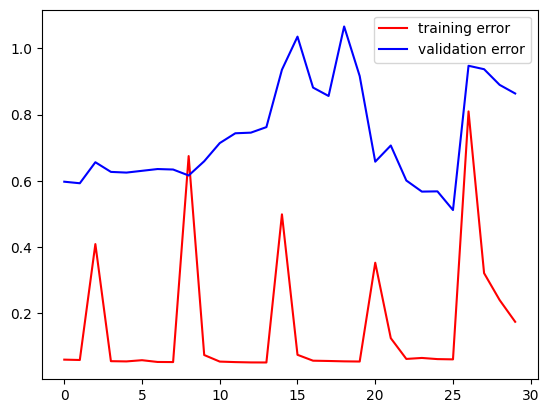

--------------------------------------------
Training = 66.66666666666667 %


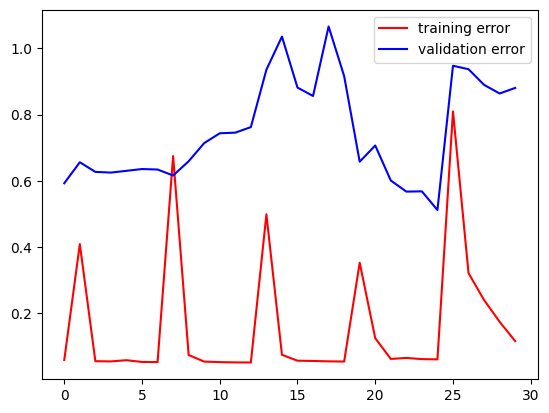

--------------------------------------------
Training = 83.33333333333333 %


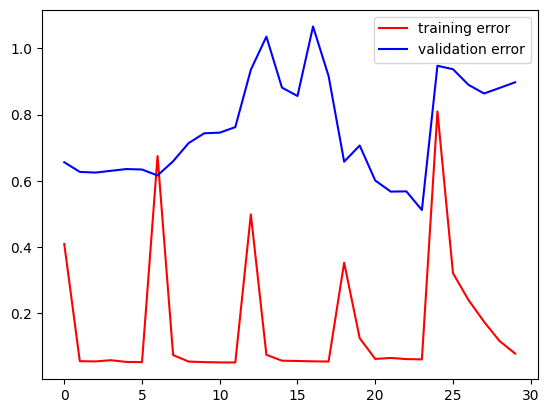

--------------------------------------------
epoch = 34
dim_clique = 45
training error = 0.07814725488424301
validation error = 0.8974019885063171
test error = 0.8772684335708618
--------------------------------------------
Training = 0.0 %


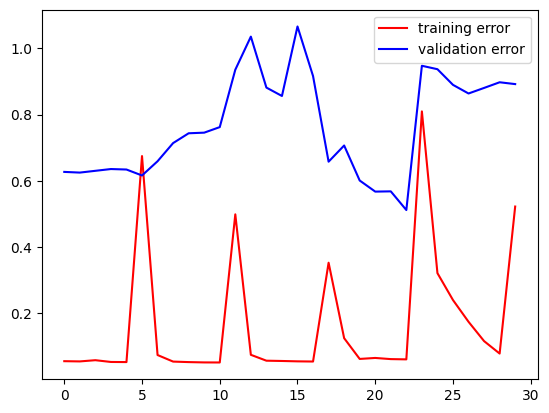

--------------------------------------------
Training = 16.666666666666668 %


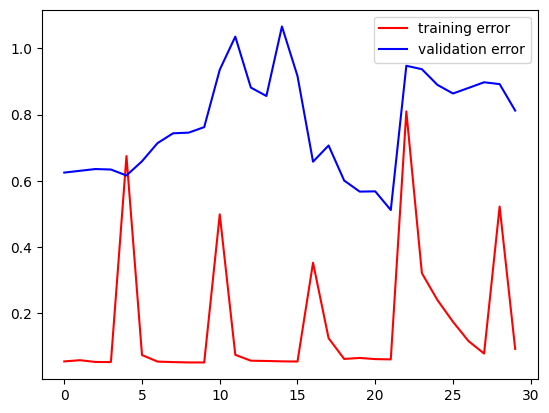

--------------------------------------------
Training = 33.333333333333336 %


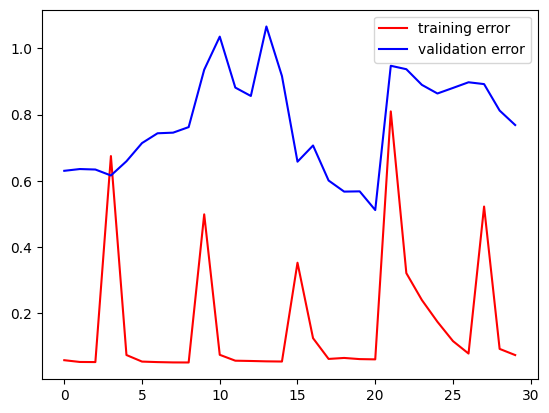

--------------------------------------------
Training = 50.0 %


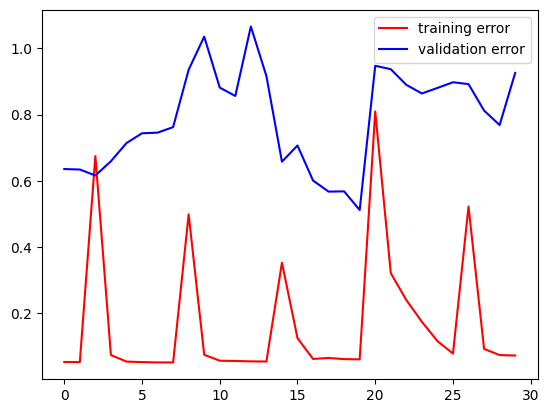

--------------------------------------------
Training = 66.66666666666667 %


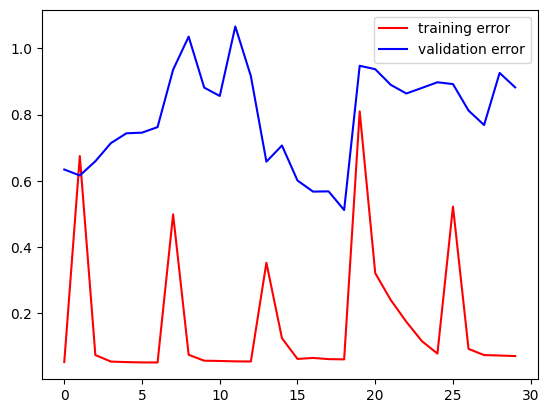

--------------------------------------------
Training = 83.33333333333333 %


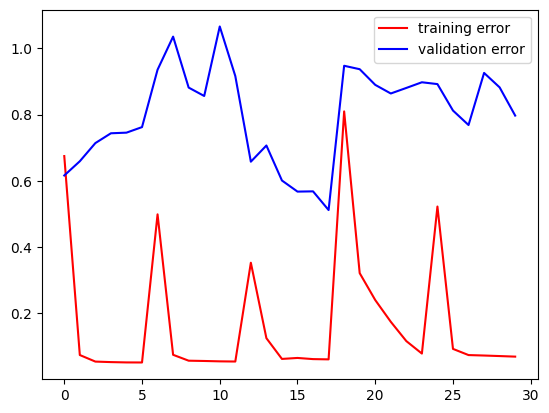

--------------------------------------------
epoch = 35
dim_clique = 45
training error = 0.06888670474290848
validation error = 0.7967962026596069
test error = 0.7563880681991577
--------------------------------------------
Training = 0.0 %


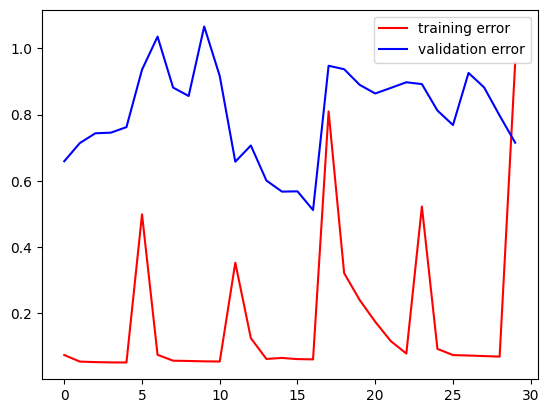

--------------------------------------------
Training = 16.666666666666668 %


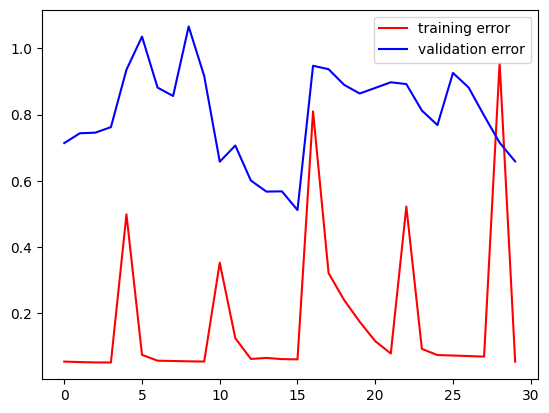

--------------------------------------------
Training = 33.333333333333336 %


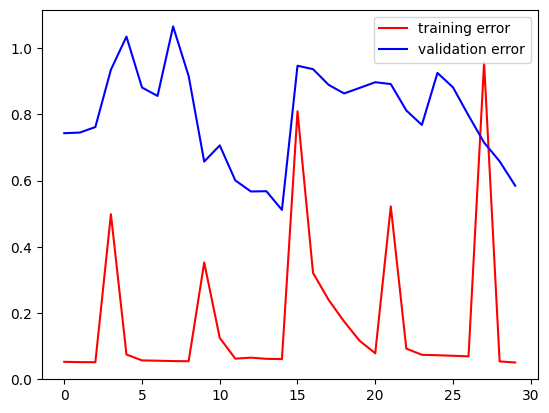

--------------------------------------------
Training = 50.0 %


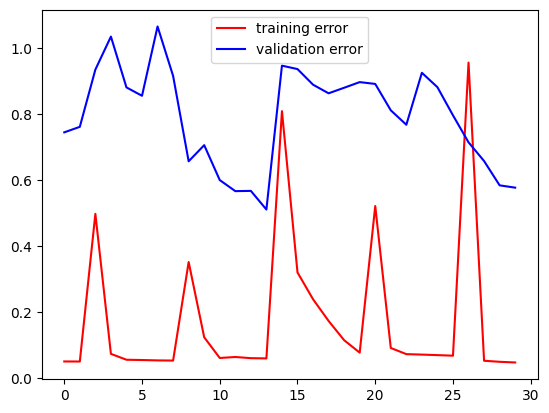

--------------------------------------------
Training = 66.66666666666667 %


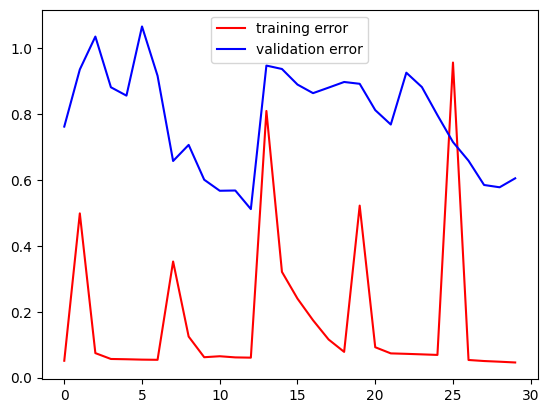

--------------------------------------------
Training = 83.33333333333333 %


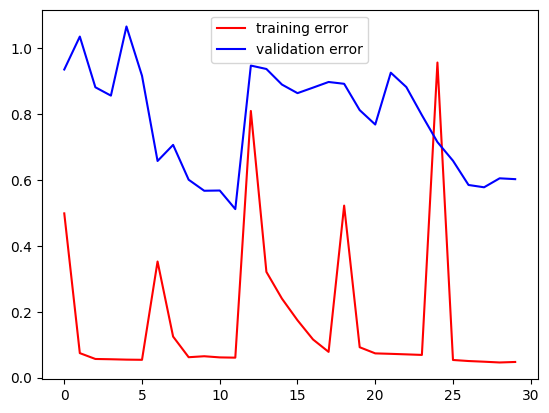

--------------------------------------------
epoch = 36
dim_clique = 45
training error = 0.047518759965896606
validation error = 0.6024535894393921
test error = 1.0137044191360474
--------------------------------------------
Training = 0.0 %


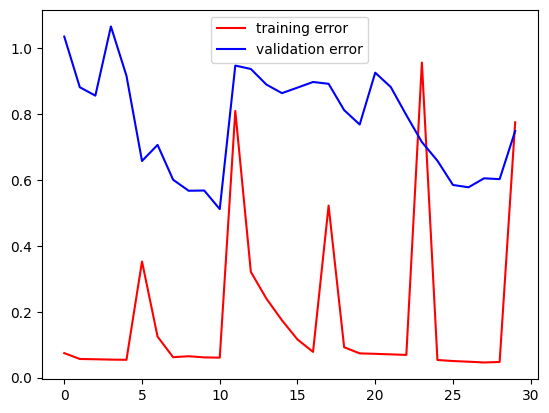

--------------------------------------------
Training = 16.666666666666668 %


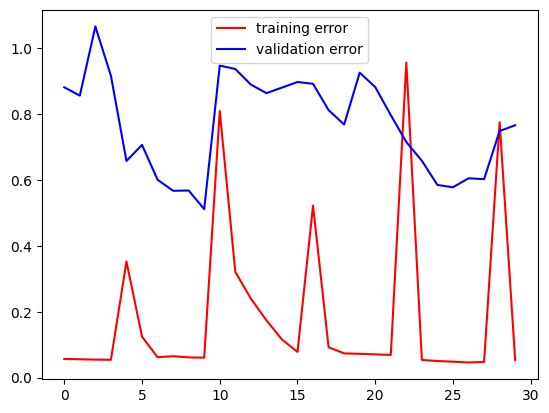

--------------------------------------------
Training = 33.333333333333336 %


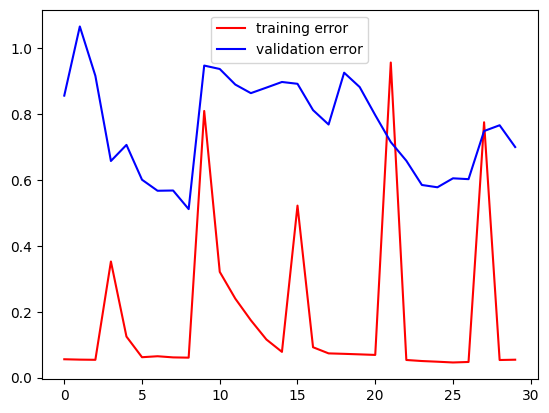

--------------------------------------------
Training = 50.0 %


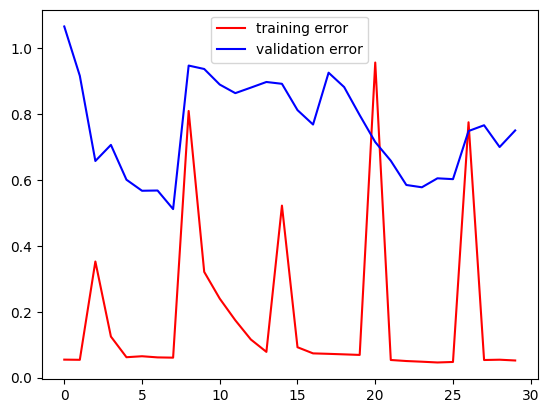

--------------------------------------------
Training = 66.66666666666667 %


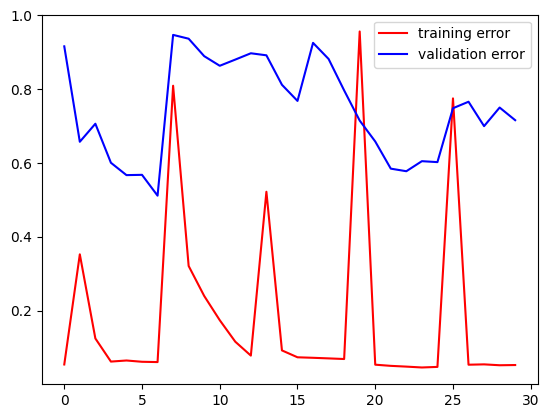

--------------------------------------------
Training = 83.33333333333333 %


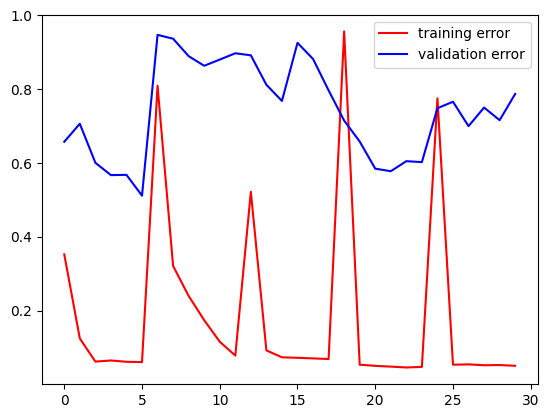

--------------------------------------------
epoch = 37
dim_clique = 45
training error = 0.050505854189395905
validation error = 0.7872558832168579
test error = 1.0008710622787476
--------------------------------------------
Training = 0.0 %


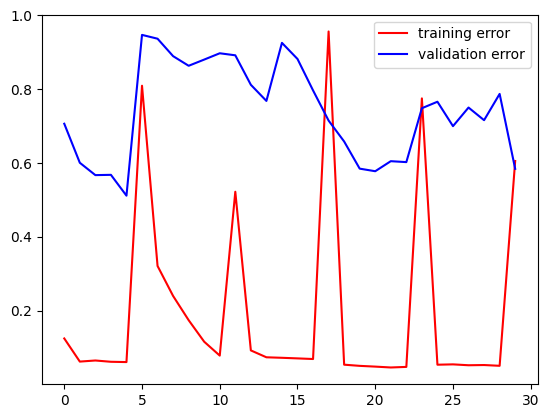

--------------------------------------------
Training = 16.666666666666668 %


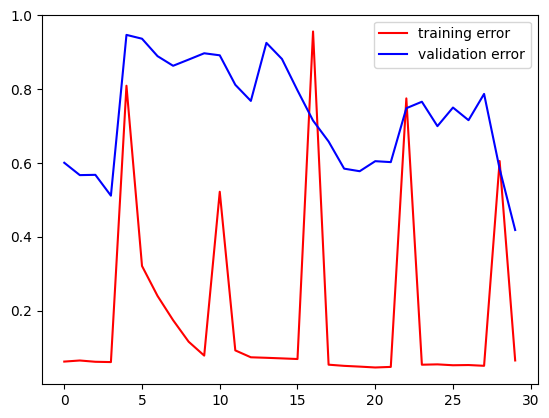

--------------------------------------------
Training = 33.333333333333336 %


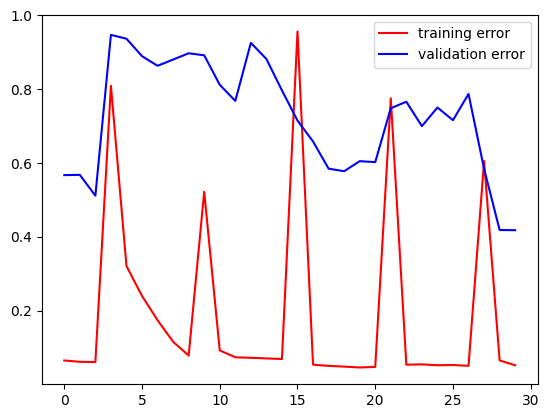

--------------------------------------------
Training = 50.0 %


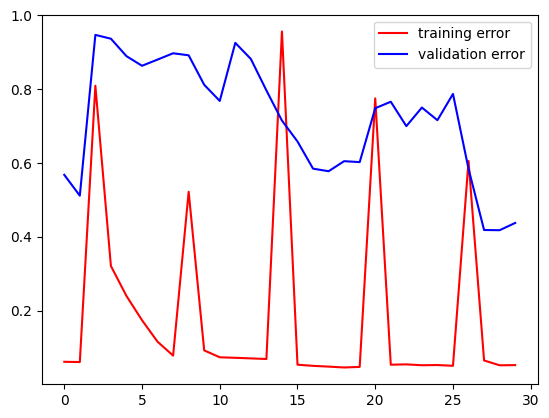

--------------------------------------------
Training = 66.66666666666667 %


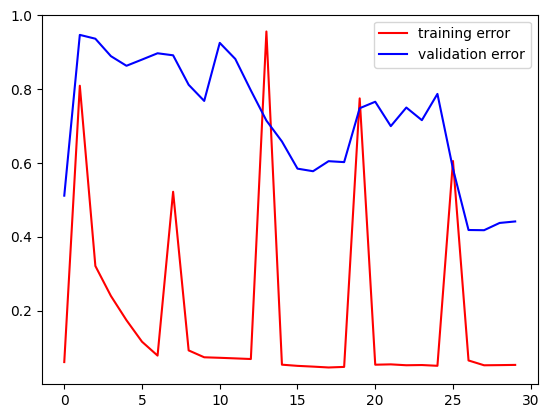

--------------------------------------------
Training = 83.33333333333333 %


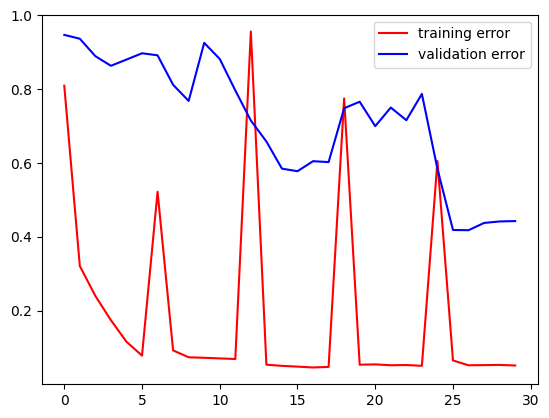

--------------------------------------------
epoch = 38
dim_clique = 45
training error = 0.051328144967556
validation error = 0.4426880478858948
test error = 0.8080800771713257
--------------------------------------------
Training = 0.0 %


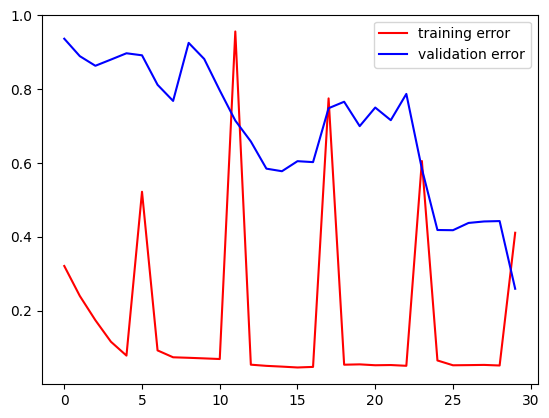

--------------------------------------------
Training = 16.666666666666668 %


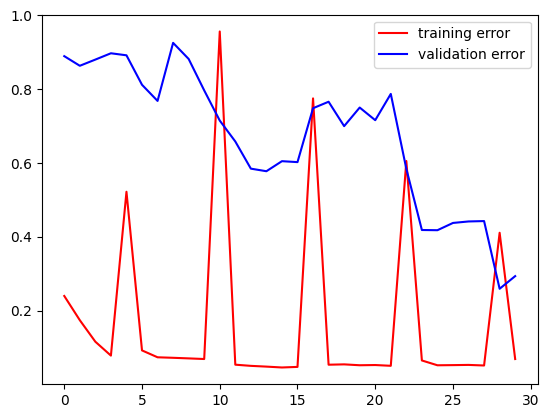

--------------------------------------------
Training = 33.333333333333336 %


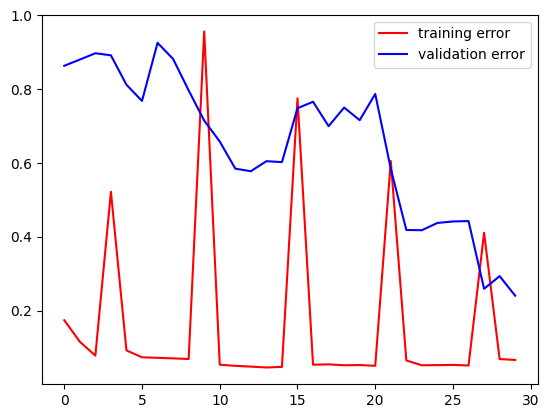

--------------------------------------------
Training = 50.0 %


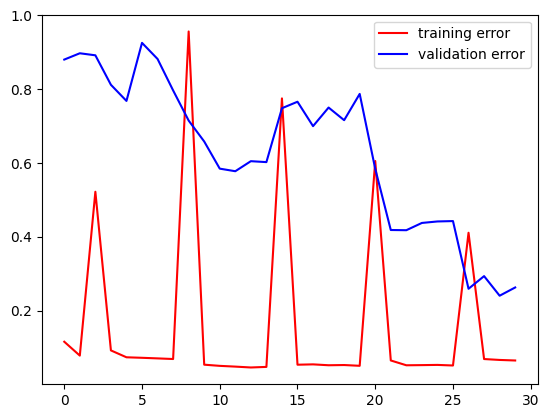

--------------------------------------------
Training = 66.66666666666667 %


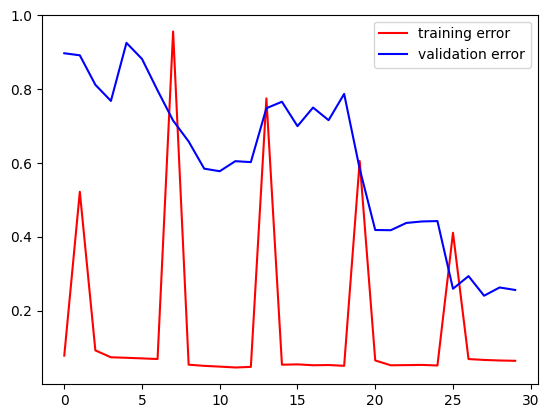

--------------------------------------------
Training = 83.33333333333333 %


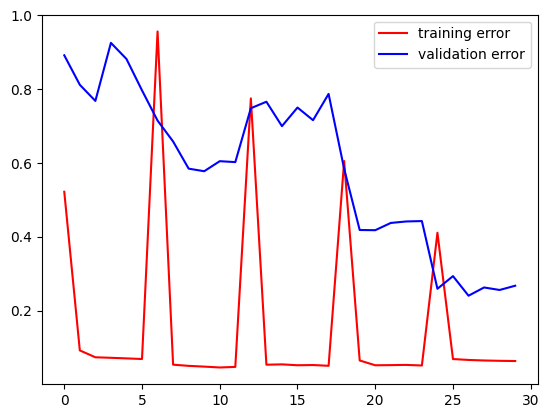

--------------------------------------------
epoch = 39
dim_clique = 45
training error = 0.06343093514442444
validation error = 0.26746630668640137
test error = 0.8232809901237488
--------------------------------------------
Training = 0.0 %


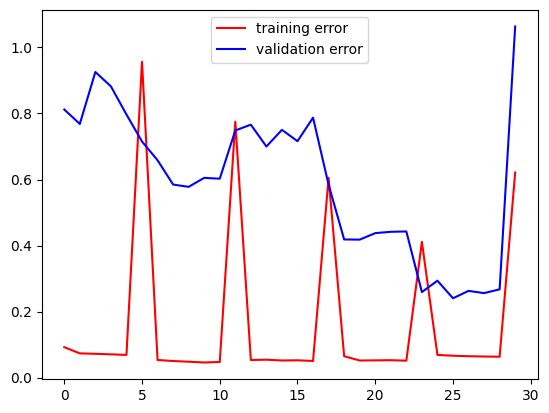

--------------------------------------------
Training = 16.666666666666668 %


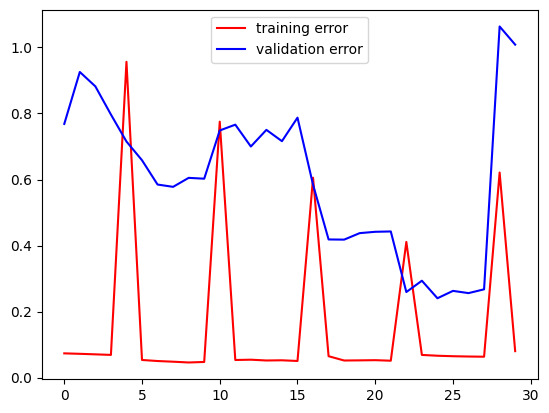

--------------------------------------------
Training = 33.333333333333336 %


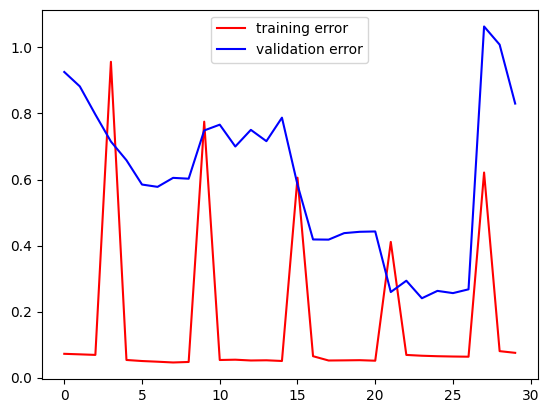

--------------------------------------------
Training = 50.0 %


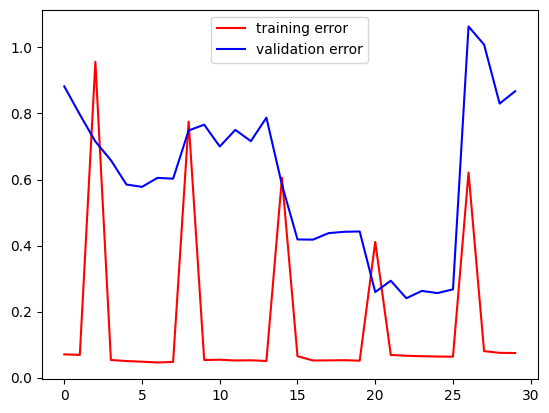

--------------------------------------------
Training = 66.66666666666667 %


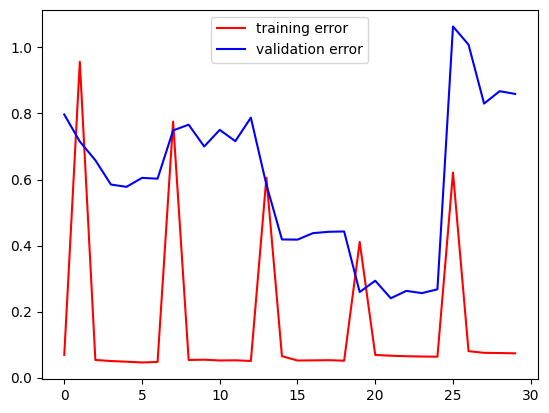

--------------------------------------------
Training = 83.33333333333333 %


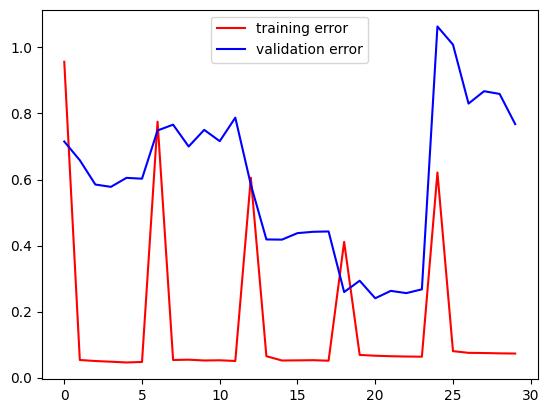

--------------------------------------------
epoch = 40
dim_clique = 45
training error = 0.07303531467914581
validation error = 0.7678235769271851
test error = 0.8662527203559875
--------------------------------------------
Training = 0.0 %


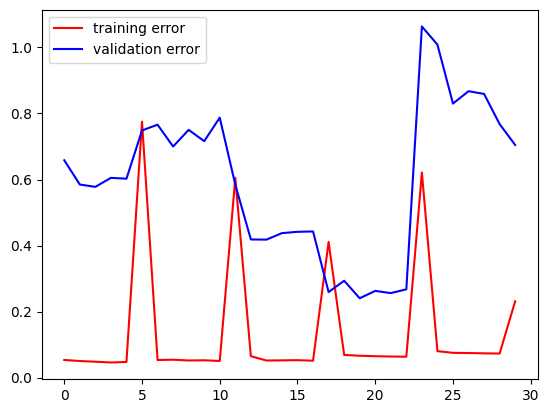

--------------------------------------------
Training = 16.666666666666668 %


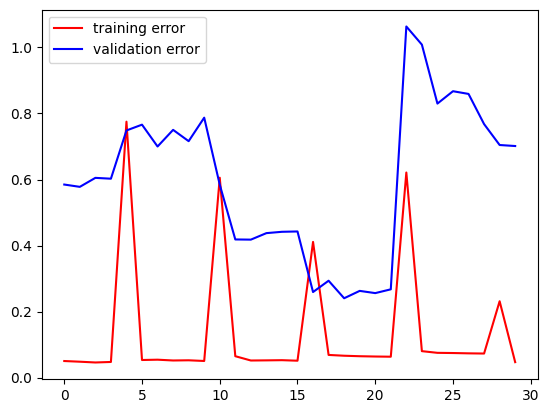

--------------------------------------------
Training = 33.333333333333336 %


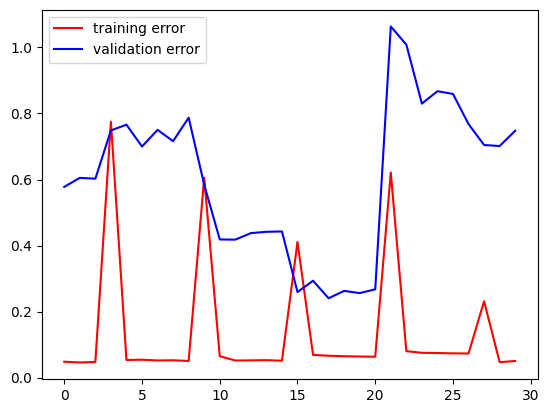

--------------------------------------------
Training = 50.0 %


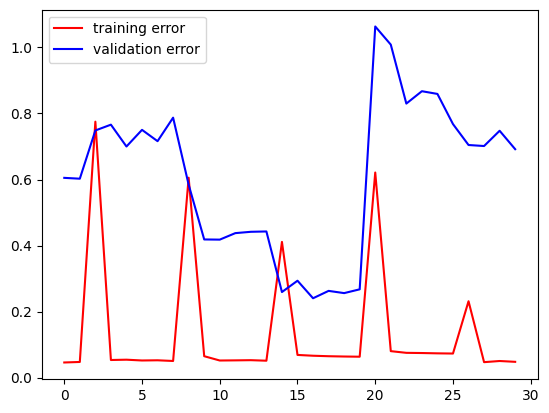

--------------------------------------------
Training = 66.66666666666667 %


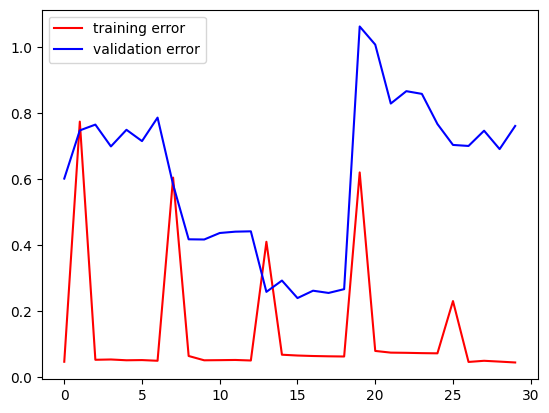

--------------------------------------------
Training = 83.33333333333333 %


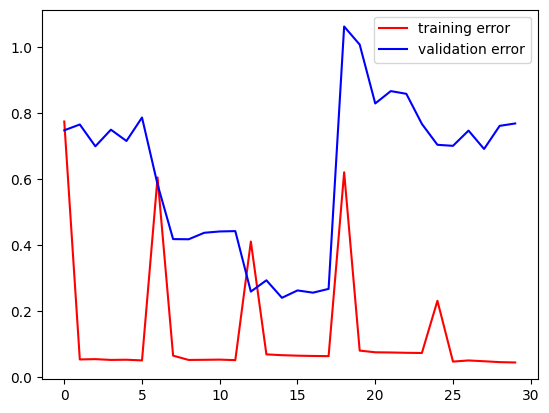

--------------------------------------------
epoch = 41
dim_clique = 45
training error = 0.04425215348601341
validation error = 0.7691828012466431
test error = 0.7729558944702148
--------------------------------------------
Training = 0.0 %


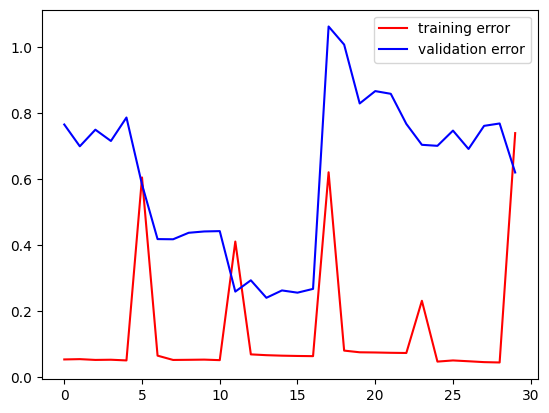

--------------------------------------------
Training = 16.666666666666668 %


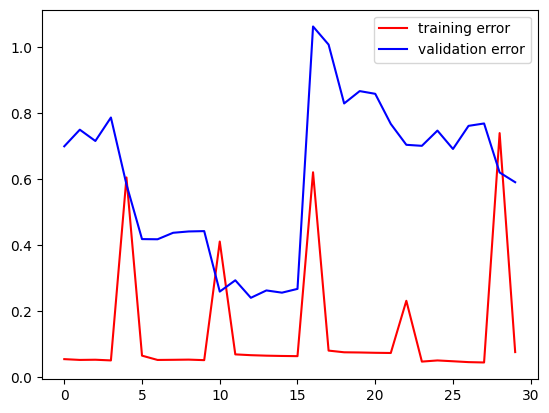

--------------------------------------------
Training = 33.333333333333336 %


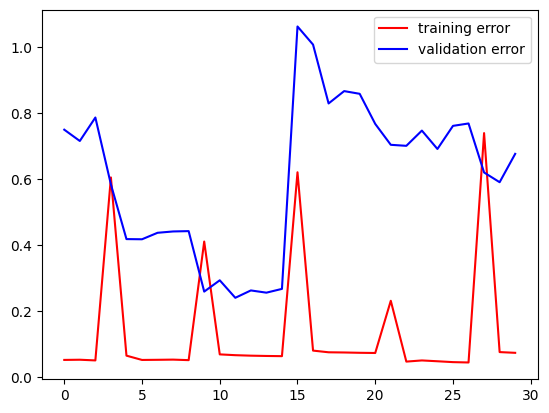

--------------------------------------------
Training = 50.0 %


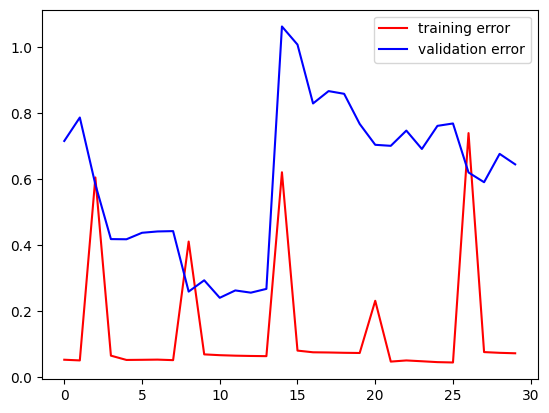

--------------------------------------------
Training = 66.66666666666667 %


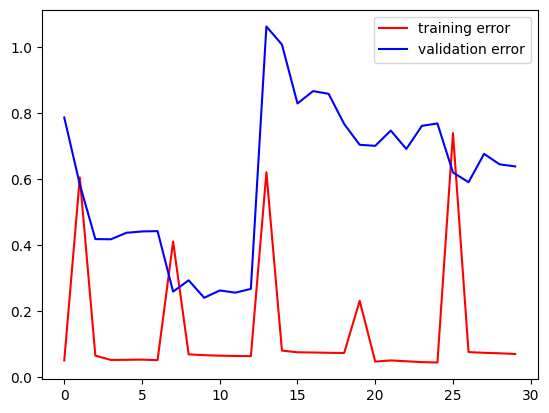

--------------------------------------------
Training = 83.33333333333333 %


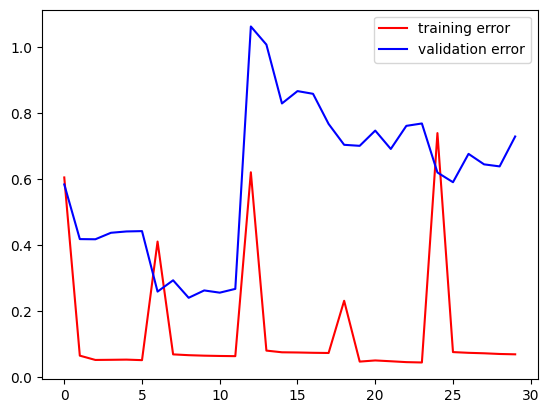

--------------------------------------------
epoch = 42
dim_clique = 45
training error = 0.06898835301399231
validation error = 0.729699969291687
test error = 0.4647546410560608
--------------------------------------------
Training = 0.0 %


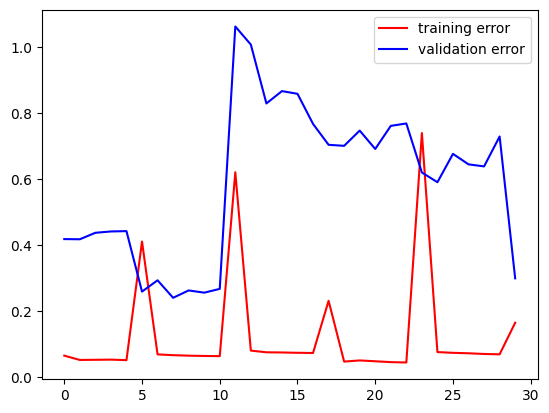

--------------------------------------------
Training = 16.666666666666668 %


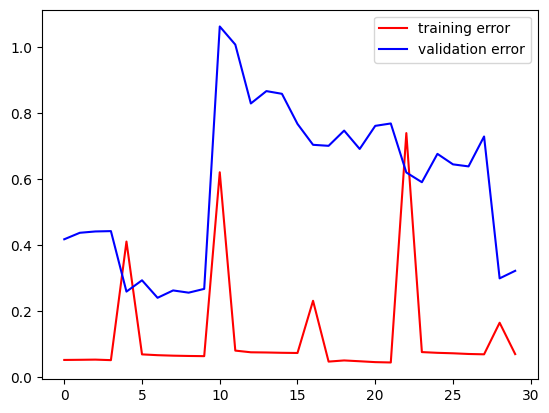

--------------------------------------------
Training = 33.333333333333336 %


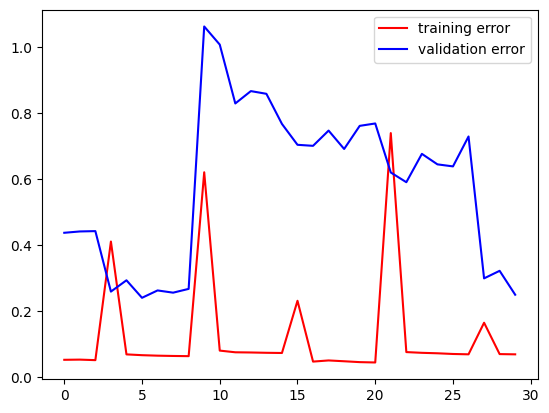

--------------------------------------------
Training = 50.0 %


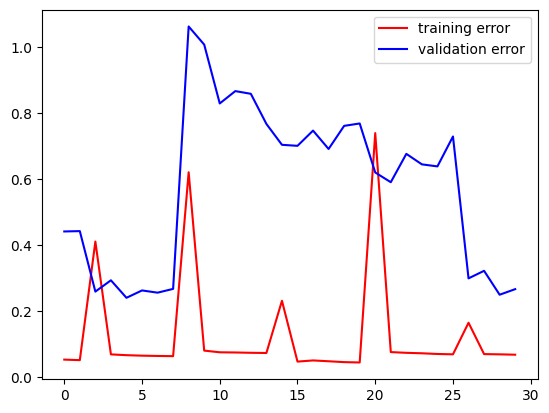

--------------------------------------------
Training = 66.66666666666667 %


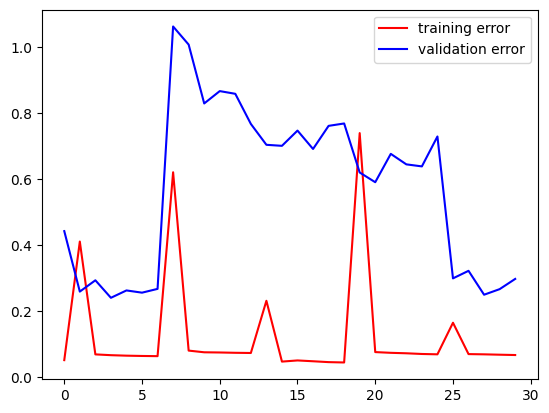

--------------------------------------------
Training = 83.33333333333333 %


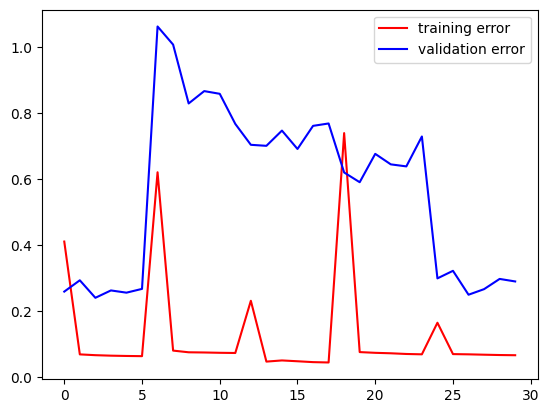

--------------------------------------------
epoch = 43
dim_clique = 45
training error = 0.06624423712491989
validation error = 0.2900392413139343
test error = 0.5306569933891296
--------------------------------------------
Training = 0.0 %


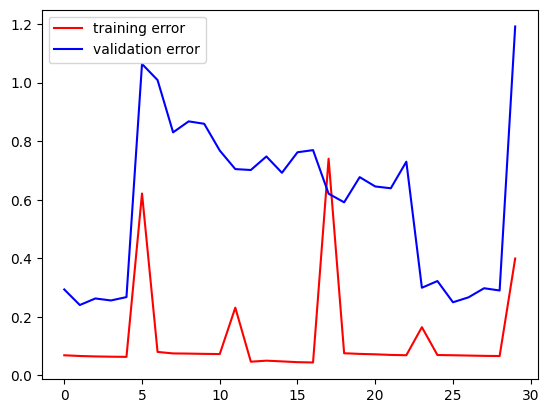

--------------------------------------------
Training = 16.666666666666668 %


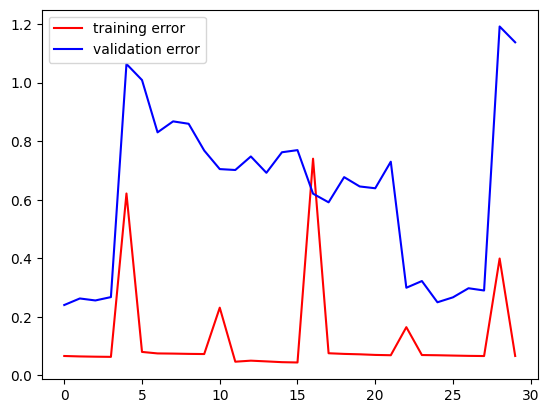

--------------------------------------------
Training = 33.333333333333336 %


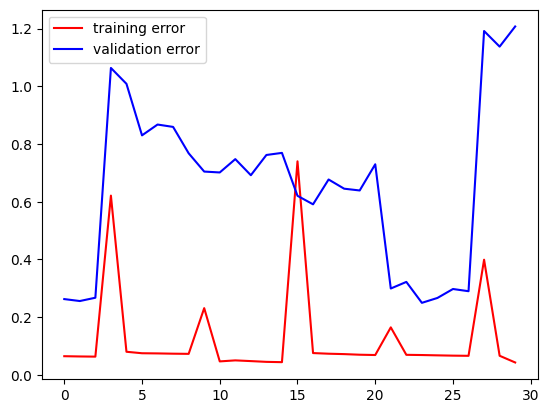

--------------------------------------------
Training = 50.0 %


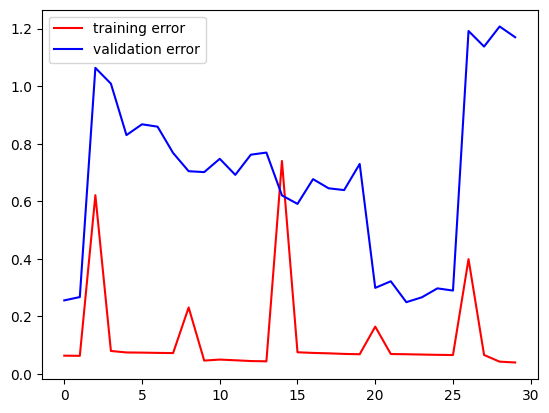

--------------------------------------------
Training = 66.66666666666667 %


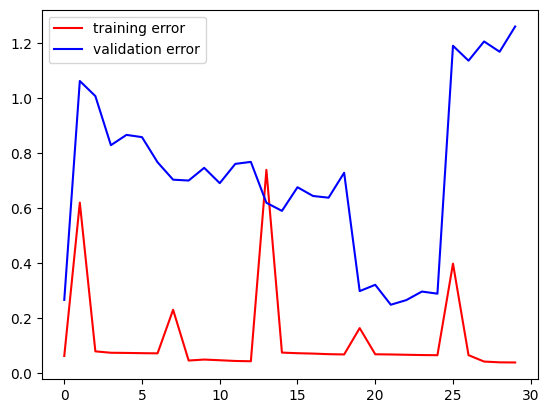

--------------------------------------------
Training = 83.33333333333333 %


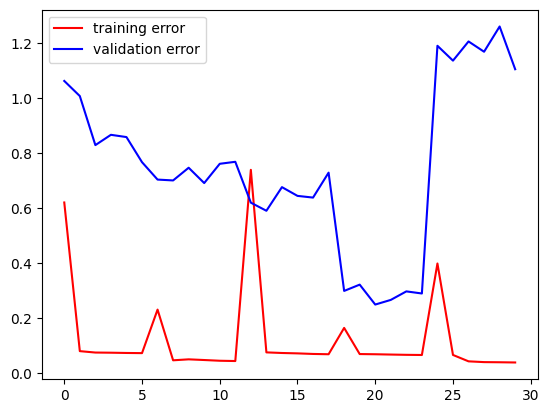

--------------------------------------------
epoch = 44
dim_clique = 45
training error = 0.0390143021941185
validation error = 1.1060079336166382
test error = 0.601186215877533
--------------------------------------------
Training = 0.0 %


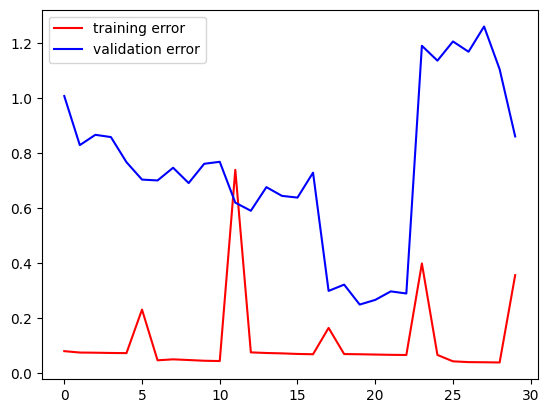

--------------------------------------------
Training = 16.666666666666668 %


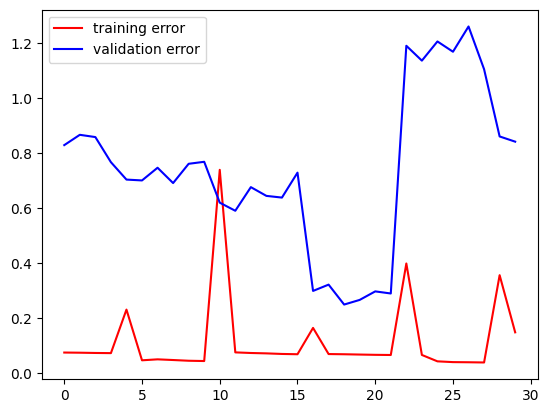

--------------------------------------------
Training = 33.333333333333336 %


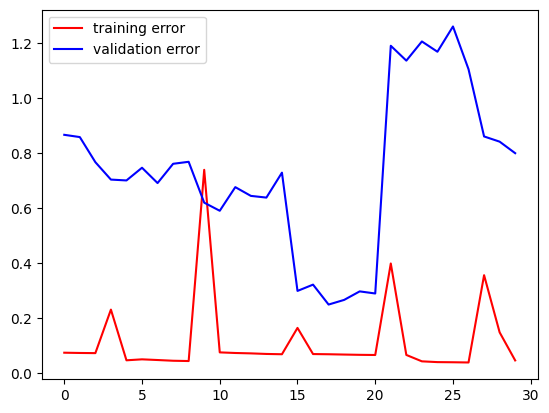

--------------------------------------------
Training = 50.0 %


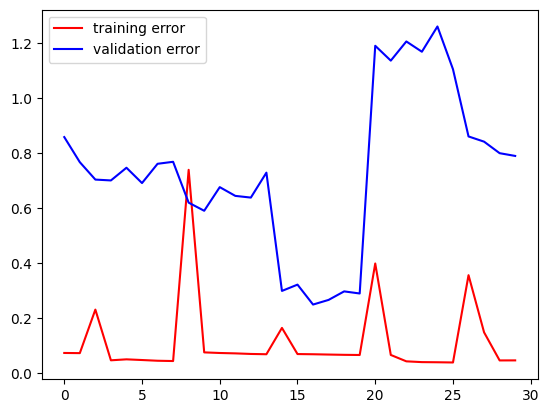

--------------------------------------------
Training = 66.66666666666667 %


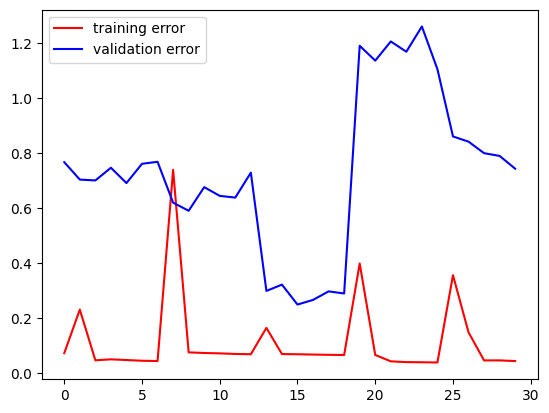

--------------------------------------------
Training = 83.33333333333333 %


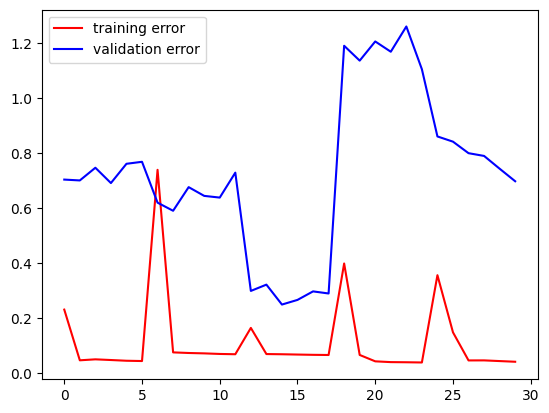

--------------------------------------------
epoch = 45
dim_clique = 45
training error = 0.04165993258357048
validation error = 0.6984163522720337
test error = 0.614086389541626
--------------------------------------------
Training = 0.0 %


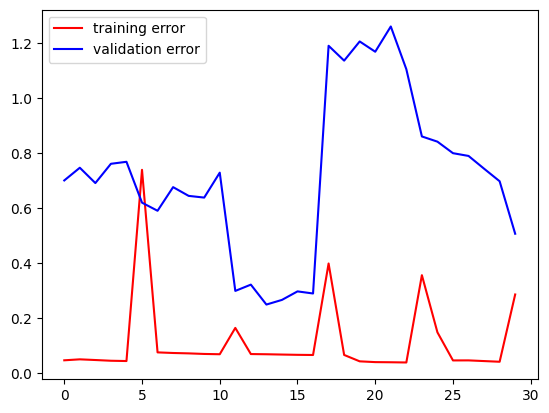

--------------------------------------------
Training = 16.666666666666668 %


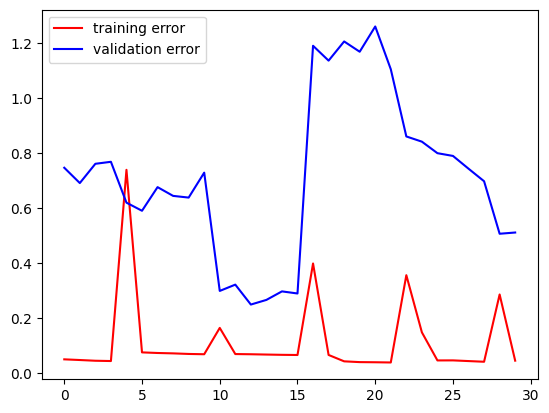

--------------------------------------------
Training = 33.333333333333336 %


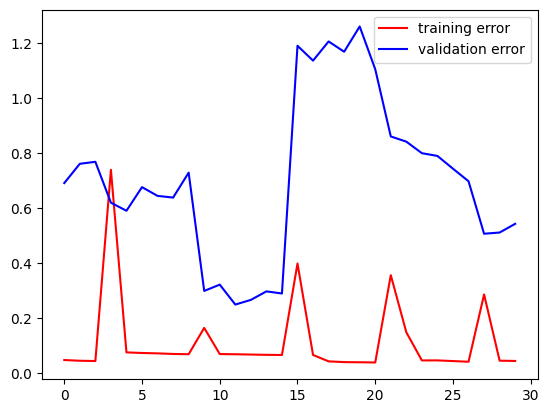

--------------------------------------------
Training = 50.0 %


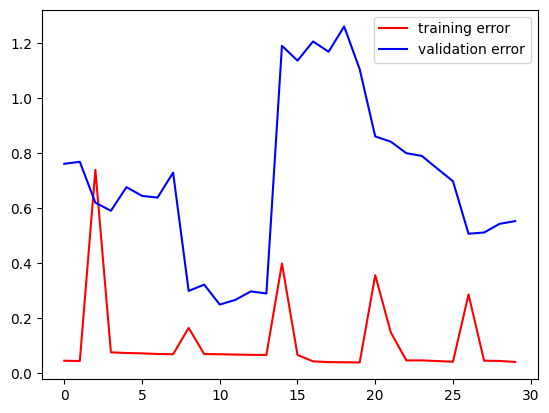

--------------------------------------------
Training = 66.66666666666667 %


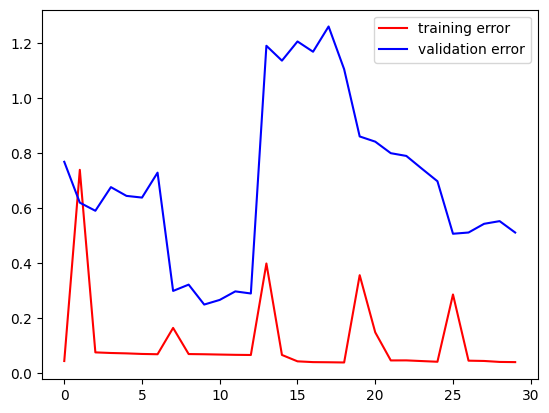

--------------------------------------------
Training = 83.33333333333333 %


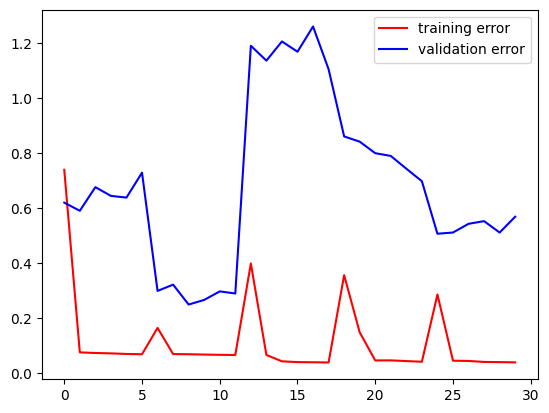

--------------------------------------------
epoch = 46
dim_clique = 45
training error = 0.0393645241856575
validation error = 0.5693601369857788
test error = 0.5811957120895386
--------------------------------------------
Training = 0.0 %
epoch = 47
dim_clique = 45
training error = 0.6579931974411011
validation error = 0.195467010140419
test error = 0.6169124841690063
--------------------------------------------
Early stop
--------------------------------------------


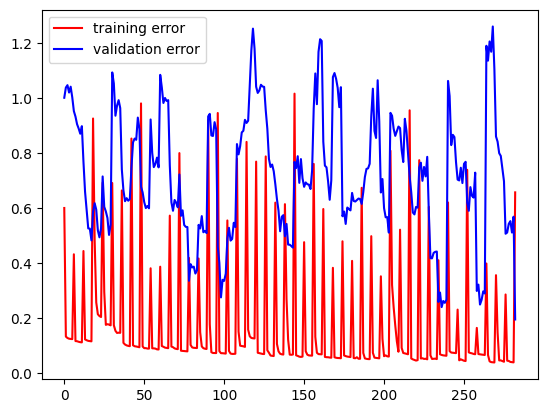

k/n = [5.0, 4.5] % = [90.0, 75.0]


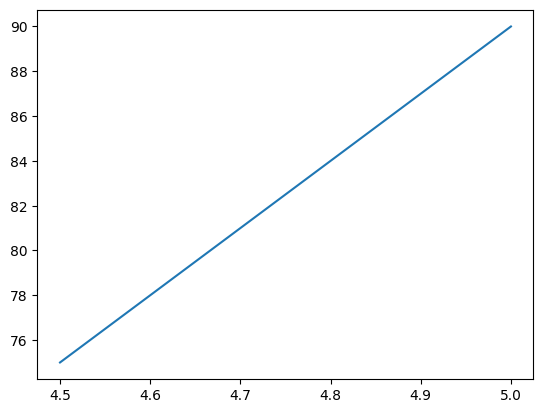

In [ ]:
epoch=50                     # number of epochs
max_steps=30                 # maximum number of steps for each epoch
num_train=20                 # dimension of the training set at each epoch
num_val=20                   # dimension of the validation set
num_test=20                  # dimension of the test set
dim_graph=100                 # number of nodes
start_dim_clique=50          # dimension of the clique to start with
jump=5                       # jump lengths for the first loop
save_step=5                  # number of steps after which we check the early stopping criterion
stop = 41                     # clique size at which we stop
training_exit_error = 0.4    # training error below which we can stop early
validation_exit_error = 0.2  # validation error below which we can stop early

train_error=[]
val_error=[]

generalization=[]
k_over_n=[]
for m in range(0,start_dim_clique-stop,jump):
  dim_clique = start_dim_clique - m
  test = GetClique(num_test,dim_graph,dim_clique, prob = 0.5)
  k_over_n.append(1.0*dim_clique/math.sqrt(dim_graph))
  loss=1.0
  count=0

  for j in range(epoch):
    early_stop_counter=0
    min_validation_loss = np.inf
    train = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    val = GetClique(num_val,dim_graph,dim_clique, prob = 0.5)
    for i in range(max_steps):
      output = model_d(train[0].to(device))
      loss=criterion(output.type(torch.float).to(device), torch.Tensor(train[1]).type(torch.long).to(device))

      # every "print_step" steps we save the error of the train and validation set
      if (i%save_step == 0):
        print('Training =',100.0*i/max_steps,'%')
        train_error.append(loss.item())
        check = model_d(val[0].to(device))   # checks the output on the validation set
        val_loss = criterion(check.to(device), torch.Tensor(val[1]).type(torch.long).to(device)).item()
        val_error.append(val_loss)

        # early_stopping needs the validation loss to check if it has decresed,
        # and if it has, it will make a checkpoint of the current model
        early_exit,min_validation_loss,early_stop_counter = EarlyStopper(np.array(val_error), early_stop_counter, min_validation_loss)
        if (val_error[count]<validation_exit_error or (early_exit and train_error[count]<training_exit_error)):
          count=count+1
          break

        count=count+1
        if (count > 30):
          # plot of test and validation error curves
          x_axis = np.arange(30)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[count-30:count], 'r', label='training error')
          ax.plot(x_axis, val_error[count-30:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')
        else:
          # plot of test and validation error curves
          x_axis = np.arange(count)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[:count], 'r', label='training error')
          ax.plot(x_axis, val_error[:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')

      loss.backward()
      optim.step()
      optim.zero_grad(set_to_none=True)


    # test error
    test_output = model_d(test[0].to(device))   # checks the output on the test set
    test_error = criterion(test_output.to(device), torch.Tensor(test[1]).type(torch.long).to(device))
    if (j%1 == 0):
      print('epoch =',j)
      print('dim_clique =',dim_clique)
      print('training error =', train_error[count-1])
      print('validation error =',val_error[count-1])
      print('test error =',test_error.item())
      print('--------------------------------------------')

    if (val_error[count-1]<validation_exit_error):
          print('Early stop')
          print('--------------------------------------------')
          break
  # plot of test and validation error curves
  x_axis = np.arange(count)
  fig, ax = plt.subplots()
  ax.plot(x_axis, train_error[:count], 'r', label='training error')
  ax.plot(x_axis, val_error[:count], 'b', label='validation error')
  ax.legend()
  plt.show()

  train_error=[]
  val_error=[]

  data = test
  hard_output = torch.zeros([num_test,2])

  soft_output = model_d(data[0].to(device))
  for l in range(num_test):
    if (soft_output[l][0] > soft_output[l][1]):
      hard_output[l][0] = 1.0
    else: hard_output[l][1] = 1.0
  predicted_output = hard_output

  generalization.append(100*(1-torch.sum(torch.square(torch.Tensor(data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test)))
  print('k/n =', k_over_n, '% =', generalization)
  print('==========================================')

plt.plot(k_over_n,generalization)

Here we check the generalization error and we compute the transition at which the network starts to fail.

k = 85 ----> % = 99.66666666666667
k = 84 ----> % = 98.33333333333333
k = 83 ----> % = 99.33333333333333
k = 82 ----> % = 98.33333333333333
k = 81 ----> % = 98.33333333333333
k = 80 ----> % = 99.0
k = 79 ----> % = 99.33333333333333
k = 78 ----> % = 98.0
k = 77 ----> % = 98.66666666666667
k = 76 ----> % = 98.0
k = 75 ----> % = 98.66666666666667
k = 74 ----> % = 98.33333333333333
k = 73 ----> % = 97.33333333333333
k = 72 ----> % = 98.33333333333333
k = 71 ----> % = 99.33333333333333
k = 70 ----> % = 96.66666666666667
k = 69 ----> % = 99.0
k = 68 ----> % = 96.33333333333333
k = 67 ----> % = 97.0
k = 66 ----> % = 97.0
k = 65 ----> % = 95.66666666666667
k = 64 ----> % = 97.0
k = 63 ----> % = 97.33333333333333
k = 62 ----> % = 96.33333333333333
k = 61 ----> % = 94.0
k = 60 ----> % = 95.0
k = 59 ----> % = 94.0
k = 58 ----> % = 94.66666666666667
k = 57 ----> % = 92.0
k = 56 ----> % = 89.0
k = 55 ----> % = 95.33333333333333
k = 54 ----> % = 93.0
k = 53 ----> % = 88.0
k = 52 ----> % = 86.0
k = 5

k = 4 ----> % = 47.333333333333336
k = 3 ----> % = 51.666666666666664
k over sqrt(n) = [8.5, 8.4, 8.3, 8.2, 8.1, 8.0, 7.9, 7.8, 7.7, 7.6, 7.5, 7.4, 7.3, 7.2, 7.1, 7.0, 6.9, 6.8, 6.7, 6.6, 6.5, 6.4, 6.3, 6.2, 6.1, 6.0, 5.9, 5.8, 5.7, 5.6, 5.5, 5.4, 5.3, 5.2, 5.1, 5.0, 4.9, 4.8, 4.7, 4.6, 4.5, 4.4, 4.3, 4.2, 4.1, 4.0, 3.9, 3.8, 3.7, 3.6, 3.5, 3.4, 3.3, 3.2, 3.1, 3.0, 2.9, 2.8, 2.7, 2.6, 2.5, 2.4, 2.3, 2.2, 2.1, 2.0, 1.9, 1.8, 1.7, 1.6, 1.5, 1.4, 1.3, 1.2, 1.1, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3] % = [99.66666666666667, 98.33333333333333, 99.33333333333333, 98.33333333333333, 98.33333333333333, 99.0, 99.33333333333333, 98.0, 98.66666666666667, 98.0, 98.66666666666667, 98.33333333333333, 97.33333333333333, 98.33333333333333, 99.33333333333333, 96.66666666666667, 99.0, 96.33333333333333, 97.0, 97.0, 95.66666666666667, 97.0, 97.33333333333333, 96.33333333333333, 94.0, 95.0, 94.0, 94.66666666666667, 92.0, 89.0, 95.33333333333333, 93.0, 88.0, 86.0, 86.0, 85.33333333333333, 83.0, 77.0, 77.6

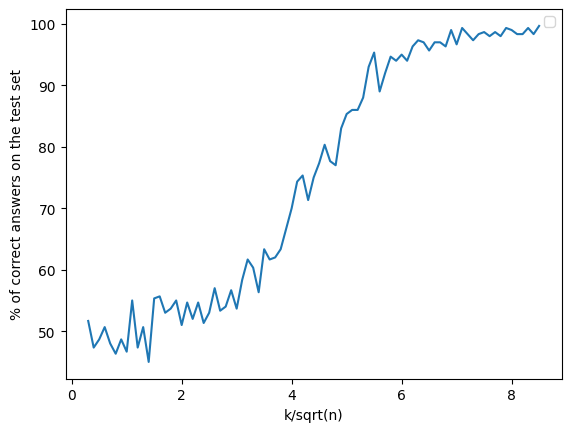

In [ ]:
start_dim_clique = 85
times = 15

generalization_MLP = []
k_vs_sqrt_n_MLP = []

for m in range(0,start_dim_clique-2,1):
  dim_clique = start_dim_clique - m
  k_vs_sqrt_n_MLP.append(1.0*dim_clique/math.sqrt(dim_graph))
  mean = 0

  for j in range(times):
    data = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    hard_output = torch.zeros([num_test,2])

    soft_output = model_d(data[0].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization_MLP.append(mean)
  print('k =',dim_clique,'---->', '% =', mean)
  print('==========================================')
print('k over sqrt(n) =', list(k_vs_sqrt_n_MLP), '% =', list(generalization_MLP))
print('==========================================')

fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_MLP,generalization_MLP)
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()

# Convolutional Neural Networks (CNNs)

Using the functions that generate the graphs we can represent the adjacency matrices as images. For instance let's see two images, one representing a graphs of size $n=60$ with a planted clique of size $k=30$ and the other without it. Can you tell the difference?

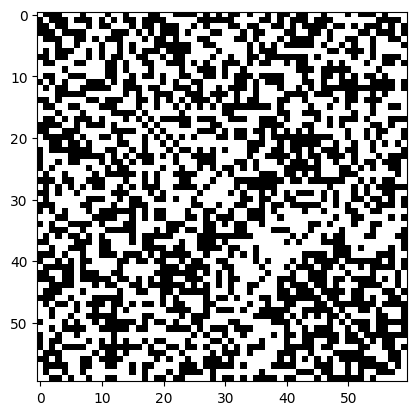

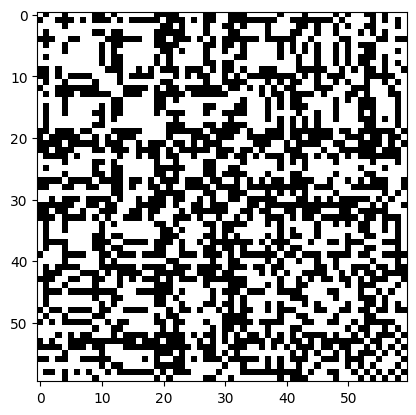

In [ ]:
image_1 = PlantedClique(60,0.5,30,0,1)
image_0 = PlantedClique(60,0.5,30,1,1)

fig, ax = plt.subplots()
ax.imshow(image_1[0], cmap=plt.get_cmap('gray'), vmin=0, vmax=1)
plt.show()
fig, ax = plt.subplots()
ax.imshow(image_0[0], cmap=plt.get_cmap('gray'), vmin=0, vmax=1)
plt.show()

Here we define the CNN. The meaning of each parameter is explained below. This network works only with graphs of a certain size (in this case $n=100$), a different graph needs a slightely different architecture. There is also an early stopping function, which stops if the validation error starts to increase for several steps.

The architecture is basically just a combination of convolutional al pooling layers with kernels of size 3. The optimizier is Adam and the loss is the CrossEntropy.

In [ ]:
lr_rate=0.01            # learning rate
c1=5                    # first convolution layer
c2=10                   # second convolution layer
c3=15                   # third convolution layer
c4=20                   # fourth convolution layer
l3=100                  # linear layer
d=0.2                   # dropout probability
kernel = 3              # kernel size

#function for the early stopping
def EarlyStopper(validation_loss, counter, min_validation_loss, past=3, patience=6, min_delta=0.02):
        length = validation_loss.shape[0]
        if np.mean(validation_loss[length-past:]) < min_validation_loss and length > past:
            min_validation_loss = np.mean(validation_loss[length-past:])
            counter = 0
        elif np.mean(validation_loss[length-past:]) > (min_validation_loss + min_delta) and length > past:
            counter += 1
            if counter >= patience:
                return True, min_validation_loss, counter
        return False, min_validation_loss, counter

#2d convolution with batch normalization and ReLU activation
def convbn(ci,co,ksz,s=1,pz=0):
    return nn.Sequential(
                nn.Conv2d(ci,co,ksz,stride=s,padding=pz,padding_mode = 'circular'),
                nn.ReLU(True),
                nn.BatchNorm2d(co))

#residual block
class Residual(nn.Module):
  def __init__(self, num_channels, use_1x1conv=False, strides=1):
    super().__init__()
    self.conv1 = nn.LazyConv2d(num_channels, kernel_size=3, padding=1,
    stride=strides)
    self.conv2 = nn.LazyConv2d(num_channels, kernel_size=3, padding=1)
    if use_1x1conv:
      self.conv3 = nn.LazyConv2d(num_channels, kernel_size=1,
      stride=strides)
    else:
      self.conv3 = None
      self.bn1 = nn.LazyBatchNorm2d()
      self.bn2 = nn.LazyBatchNorm2d()

  def forward(self, X):
    Y = F.relu(self.bn1(self.conv1(X)))
    Y = self.bn2(self.conv2(Y))
    if self.conv3:
      X = self.conv3(X)
    Y += X
    return F.relu(Y)

# Definition of the CNN architecture
model = nn.Sequential(
            nn.Dropout(0.2),
            convbn(1,c1,kernel,1,1),
            nn.Dropout(d),
            nn.MaxPool2d(kernel),
            Residual(c1),
            convbn(c1,c2,kernel,1,1),
            nn.Dropout(d),
            nn.MaxPool2d(kernel),
            Residual(c2),
            convbn(c2,c3,kernel,1,1),
            nn.Dropout(d),
            nn.MaxPool2d(kernel),
            #Residual(c3),
            #convbn(c3,c4,kernel,1,1),
            #nn.MaxPool2d(kernel),
            nn.Flatten(),
            nn.Linear(135, l3),
            nn.ReLU(),
            nn.Linear(l3, 2),
            nn.ReLU()
            )

optim=torch.optim.Adam(model.parameters())   # optimization with Adam
criterion = nn.CrossEntropyLoss()            # criterion = Cross Entropy
model.to(device)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


Sequential(
  (0): Dropout(p=0.2, inplace=False)
  (1): Sequential(
    (0): Conv2d(1, 5, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(5, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (2): Dropout(p=0.2, inplace=False)
  (3): MaxPool2d(kernel_size=3, stride=3, padding=0, dilation=1, ceil_mode=False)
  (4): Residual(
    (conv1): LazyConv2d(0, 5, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2): LazyConv2d(0, 5, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): LazyBatchNorm2d(0, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): LazyBatchNorm2d(0, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (5): Sequential(
    (0): Conv2d(5, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), padding_mode=circular)
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(10, eps=1e-05, momentum=0.1, affine=True, track_running_stats

The following is the traing procedure. It works in the following way: at each epoch we generate a batch of training samples. Then we train the network with this batch and check the validation error. This online generation of batches ensures a faster training.

Eventually we also plot the generalization error versus the parameter $k/n$.

If you want to run the code test with small number of epochs, small max_step or smaller samples; the code takes very long.

Training = 0.0 %


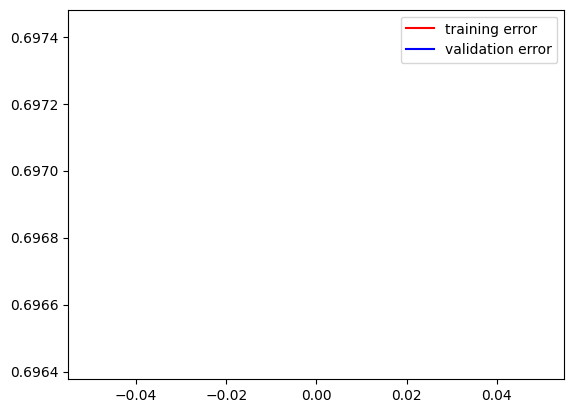

--------------------------------------------
Training = 5.0 %


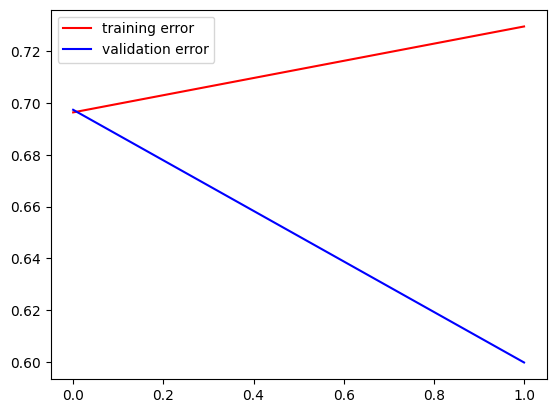

--------------------------------------------
Training = 10.0 %


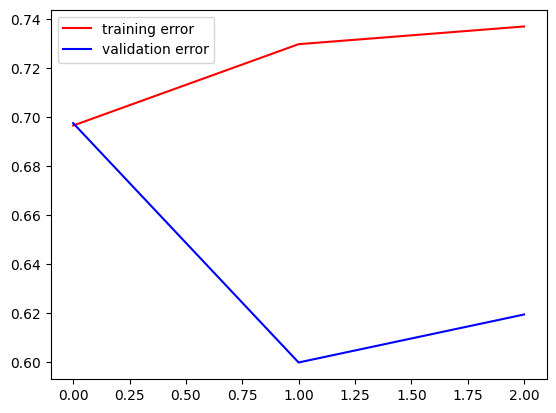

--------------------------------------------
Training = 15.0 %


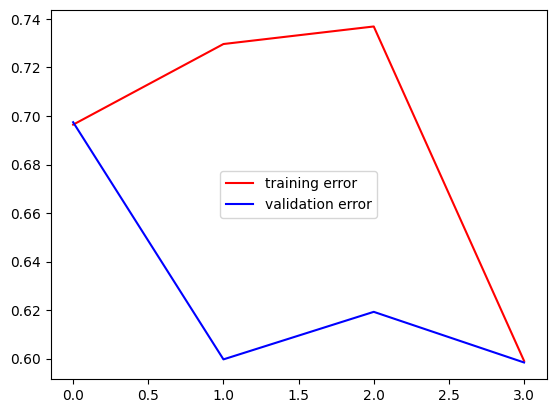

--------------------------------------------
Training = 20.0 %


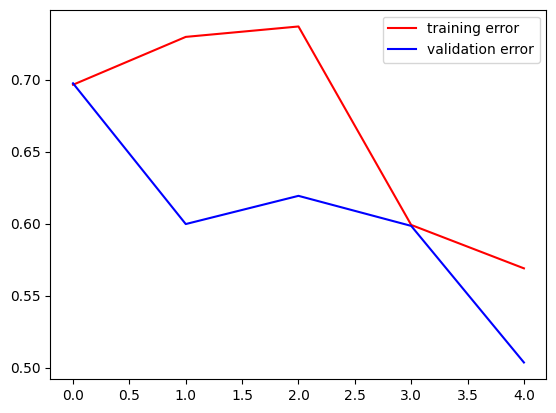

--------------------------------------------
Training = 25.0 %


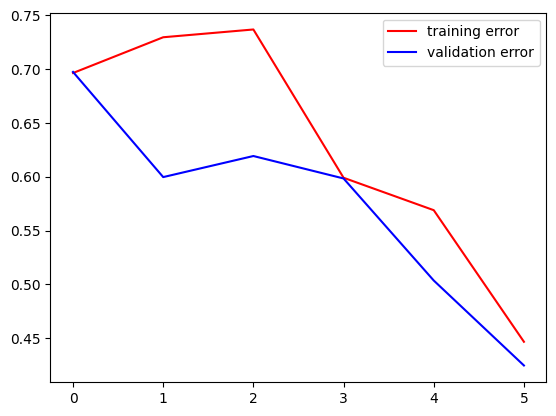

--------------------------------------------
Training = 30.0 %


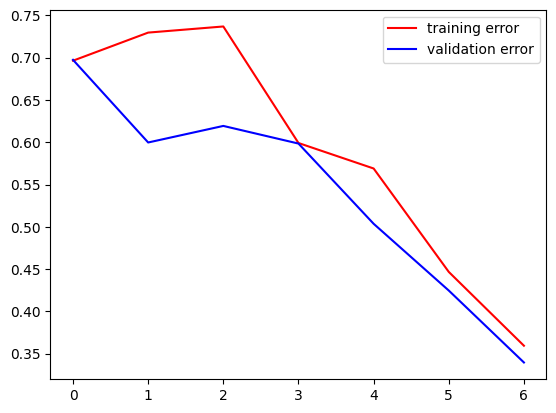

--------------------------------------------
Training = 35.0 %


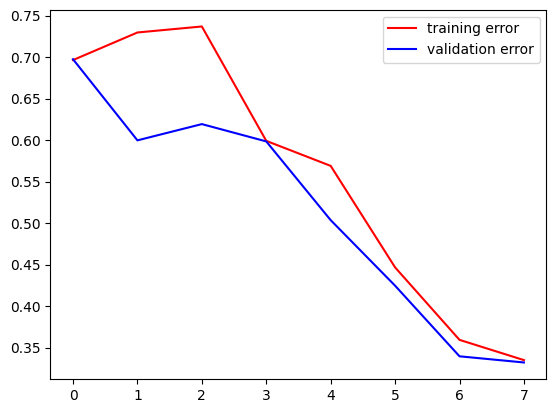

--------------------------------------------
Training = 40.0 %


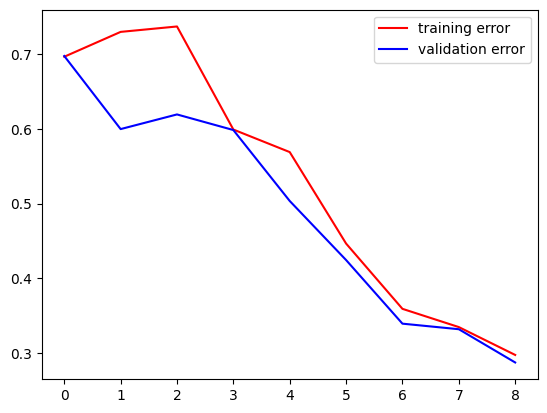

--------------------------------------------
Training = 45.0 %


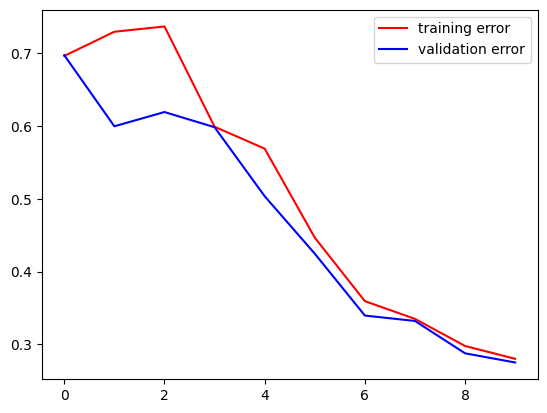

--------------------------------------------
Training = 50.0 %


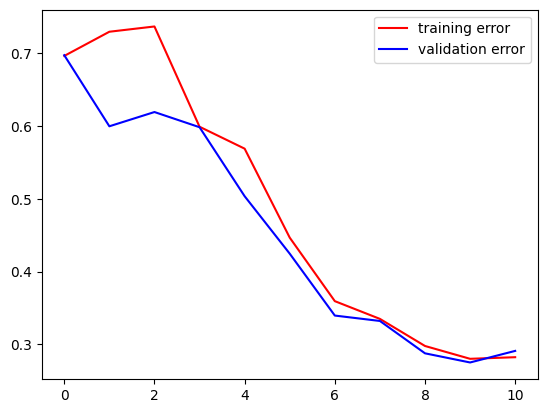

--------------------------------------------
Training = 55.0 %


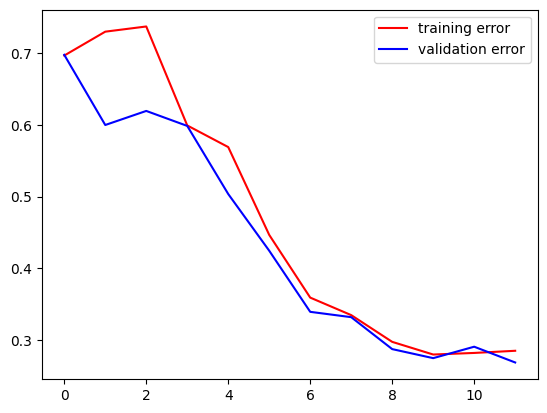

--------------------------------------------
Training = 60.0 %


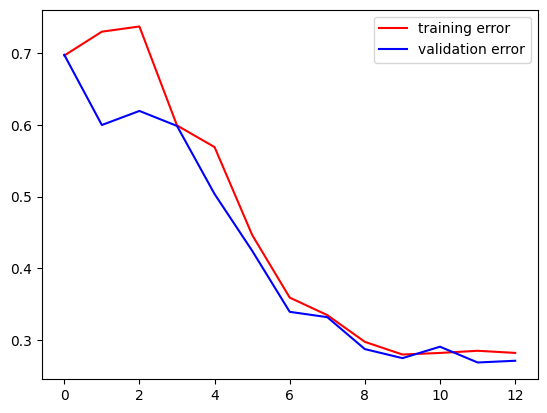

--------------------------------------------
Training = 65.0 %


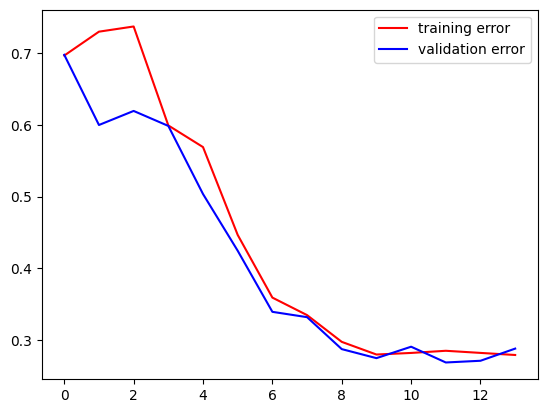

--------------------------------------------
Training = 70.0 %


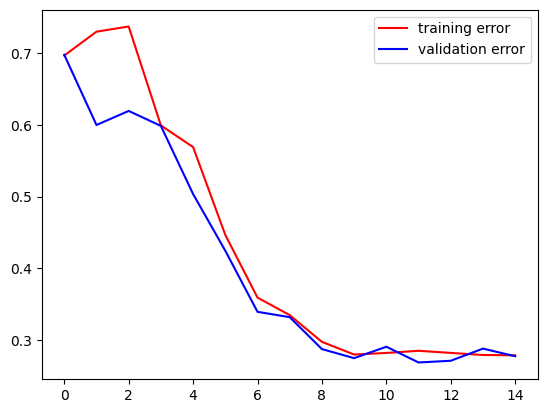

--------------------------------------------
Training = 75.0 %


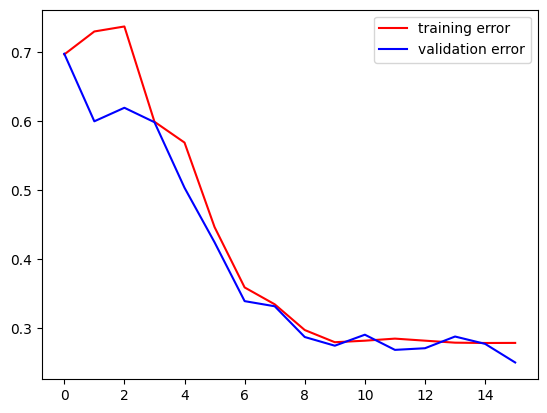

--------------------------------------------
Training = 80.0 %


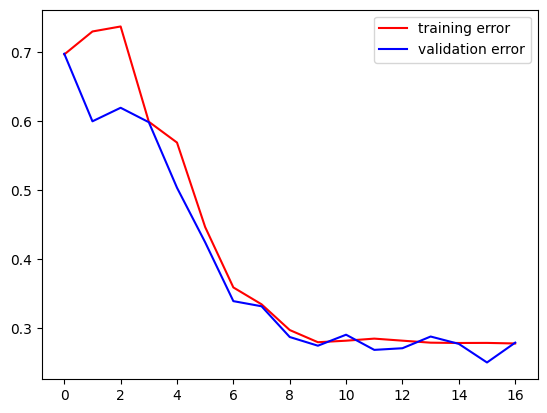

--------------------------------------------
Training = 85.0 %


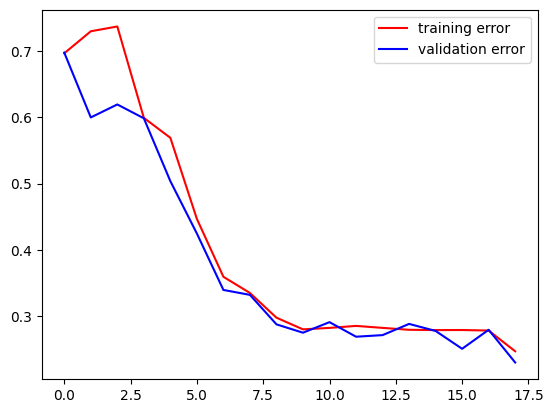

--------------------------------------------
Training = 90.0 %
epoch = 0
dim_clique = 50
training error = 0.04082709550857544
validation error = 0.06358062475919724
test error = 0.05526072531938553
--------------------------------------------
Early stop
--------------------------------------------


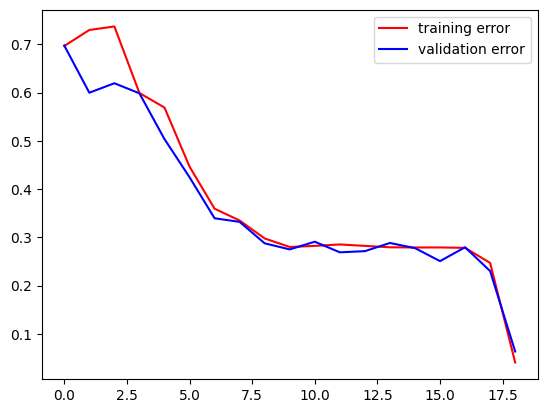

k/n = [5.0] % = [100.0]
Training = 0.0 %
epoch = 0
dim_clique = 48
training error = 0.13917678594589233
validation error = 0.062353719025850296
test error = 0.07658801972866058
--------------------------------------------
Early stop
--------------------------------------------


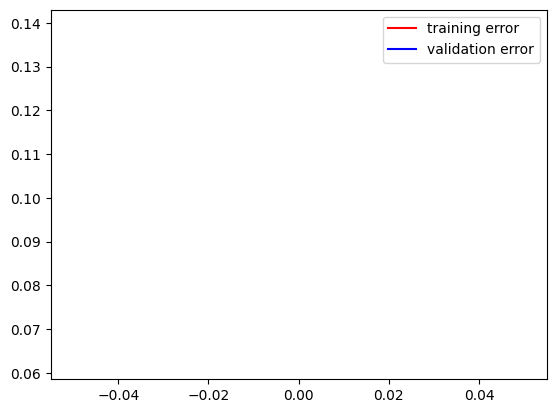

k/n = [5.0, 4.8] % = [100.0, 100.0]
Training = 0.0 %
epoch = 0
dim_clique = 46
training error = 0.10106194019317627
validation error = 0.07713551819324493
test error = 0.06837926805019379
--------------------------------------------
Early stop
--------------------------------------------


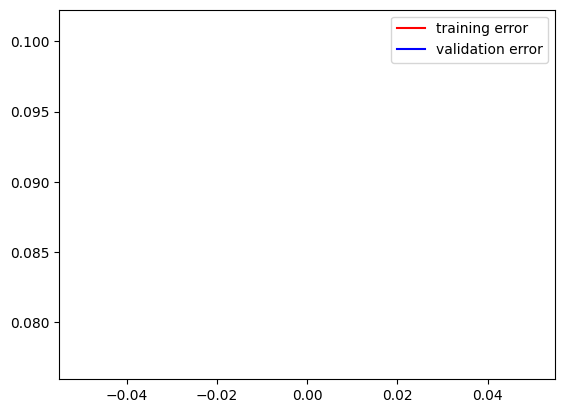

k/n = [5.0, 4.8, 4.6] % = [100.0, 100.0, 100.0]
Training = 0.0 %


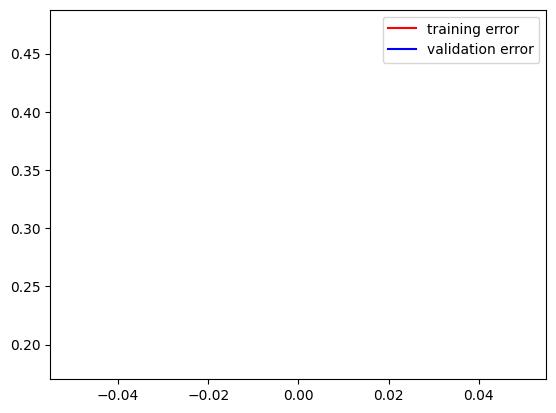

--------------------------------------------
Training = 5.0 %


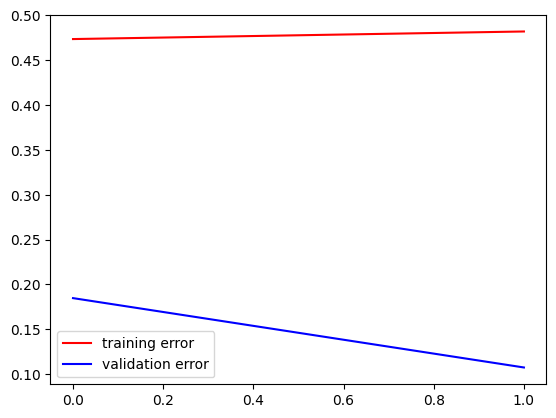

--------------------------------------------
Training = 10.0 %


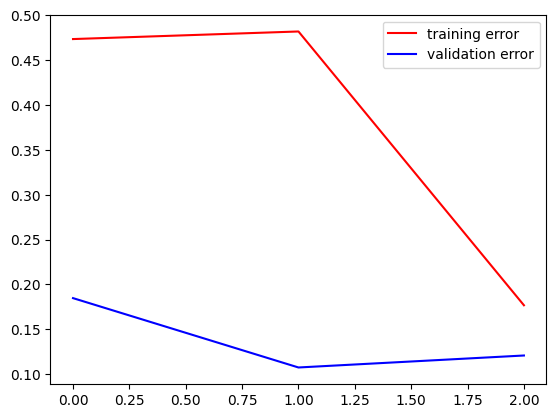

--------------------------------------------
Training = 15.0 %


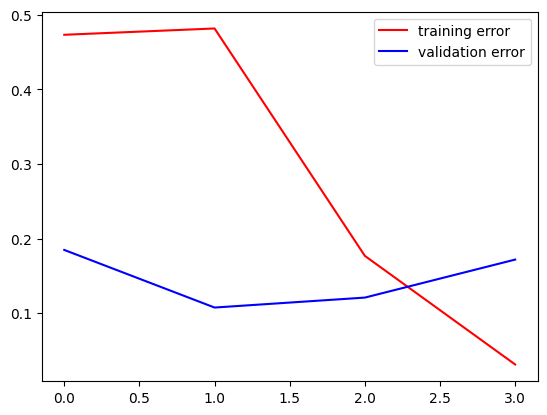

--------------------------------------------
Training = 20.0 %
epoch = 0
dim_clique = 44
training error = 0.02694793976843357
validation error = 0.09714914113283157
test error = 0.041865818202495575
--------------------------------------------
Early stop
--------------------------------------------


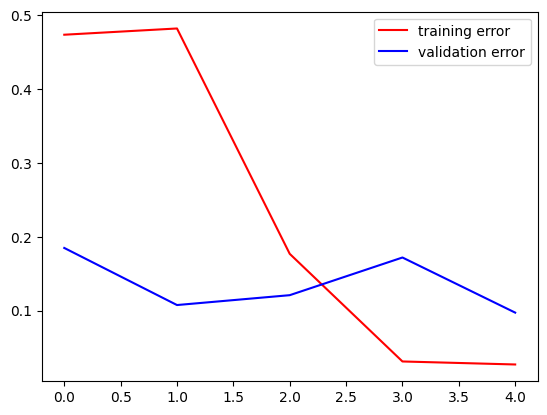

k/n = [5.0, 4.8, 4.6, 4.4] % = [100.0, 100.0, 100.0, 100.0]
Training = 0.0 %


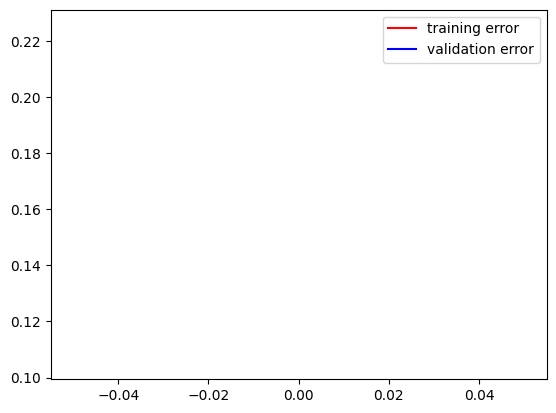

--------------------------------------------
Training = 5.0 %


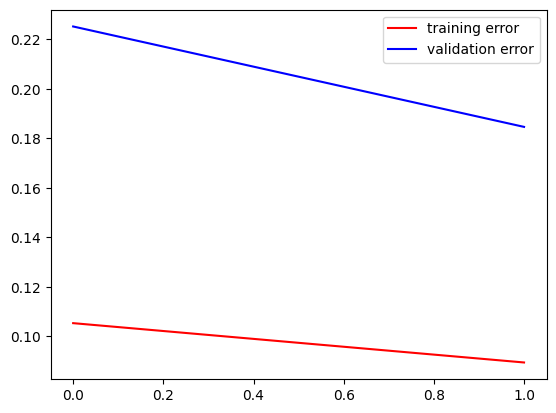

--------------------------------------------
Training = 10.0 %


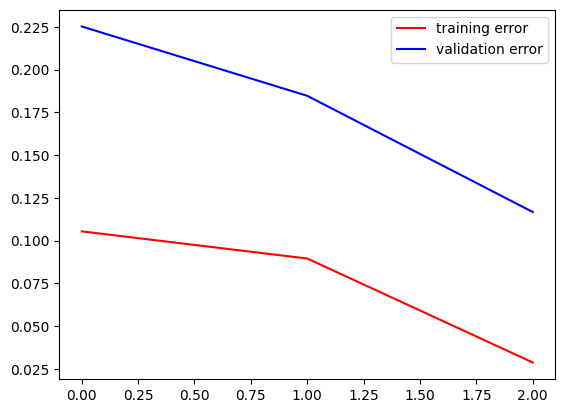

--------------------------------------------
Training = 15.0 %
epoch = 0
dim_clique = 42
training error = 0.09407337754964828
validation error = 0.026119977235794067
test error = 0.7212567329406738
--------------------------------------------
Early stop
--------------------------------------------


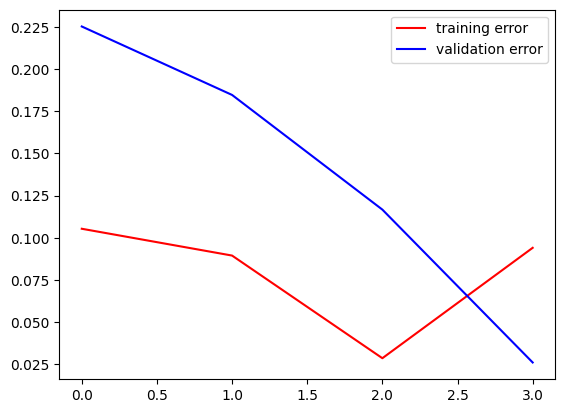

k/n = [5.0, 4.8, 4.6, 4.4, 4.2] % = [100.0, 100.0, 100.0, 100.0, 65.0]
Training = 0.0 %
epoch = 0
dim_clique = 40
training error = 0.5620248317718506
validation error = 0.059691764414310455
test error = 0.061721909791231155
--------------------------------------------
Early stop
--------------------------------------------


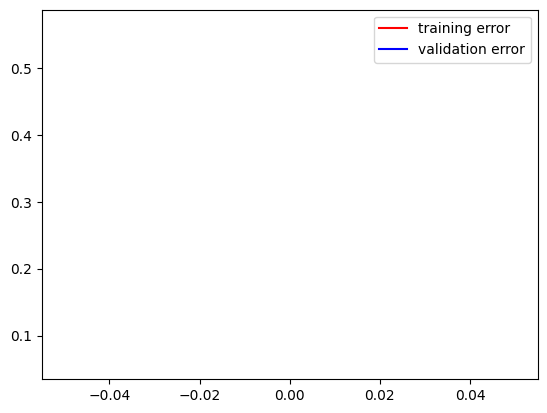

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0]
Training = 0.0 %


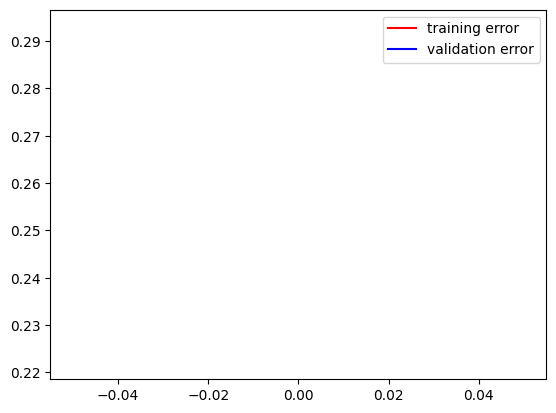

--------------------------------------------
Training = 5.0 %


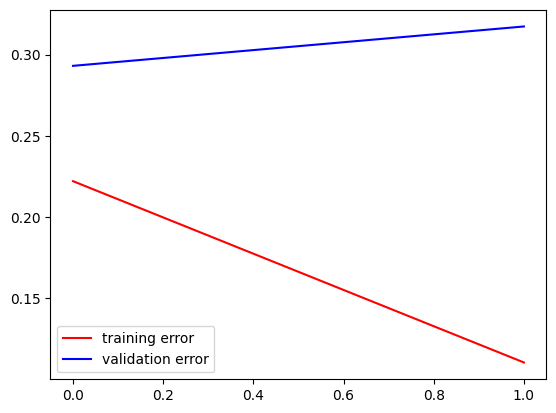

--------------------------------------------
Training = 10.0 %


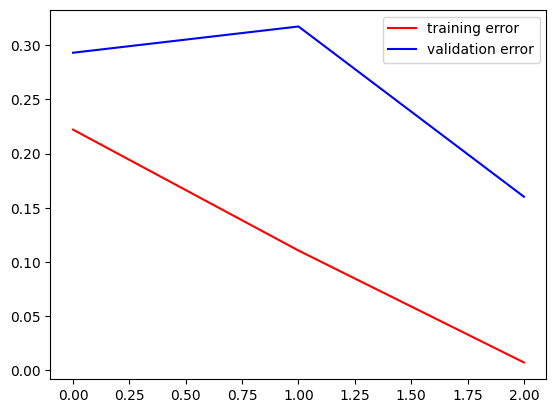

--------------------------------------------
Training = 15.0 %
epoch = 0
dim_clique = 38
training error = 0.01614605449140072
validation error = 0.08234761655330658
test error = 0.1360597312450409
--------------------------------------------
Early stop
--------------------------------------------


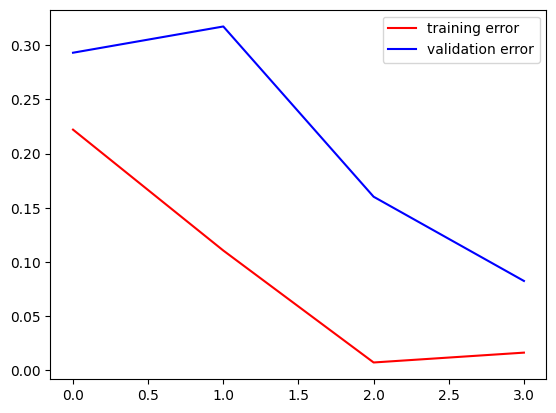

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0]
Training = 0.0 %


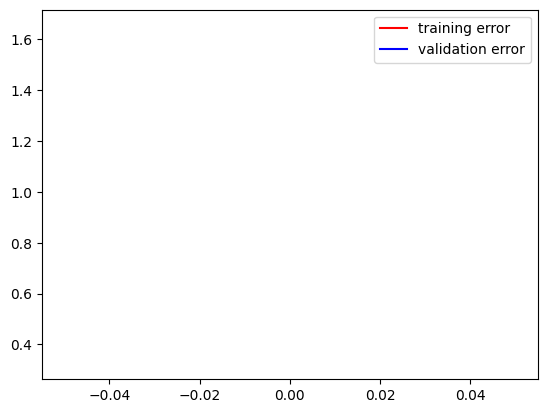

--------------------------------------------
Training = 5.0 %


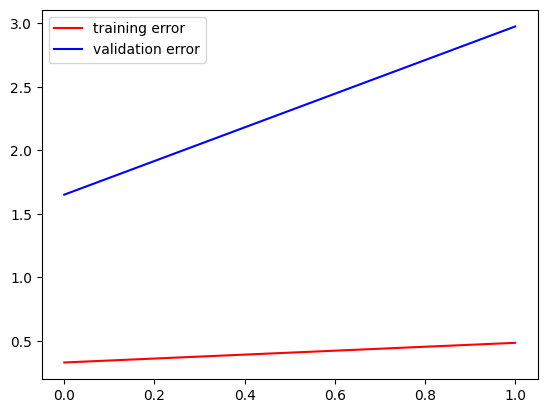

--------------------------------------------
Training = 10.0 %


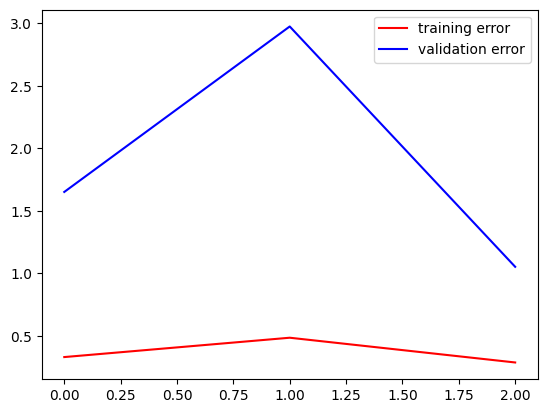

--------------------------------------------
Training = 15.0 %


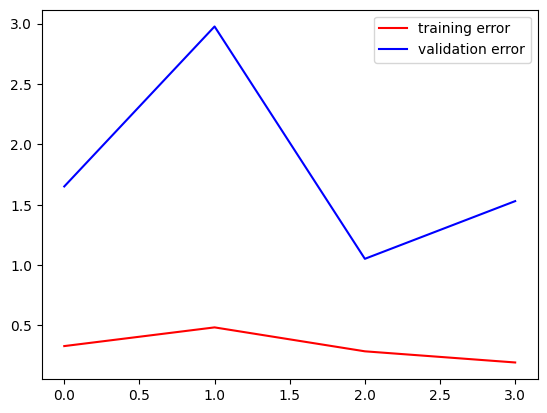

--------------------------------------------
Training = 20.0 %


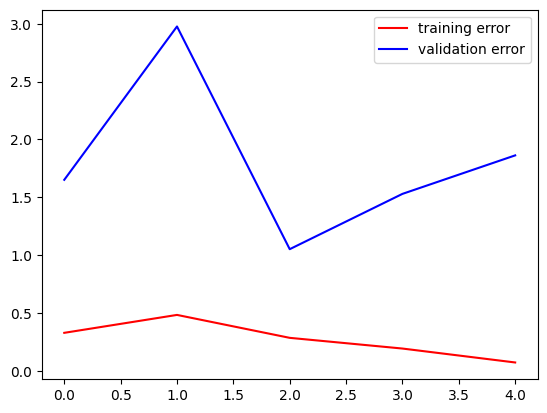

--------------------------------------------
Training = 25.0 %


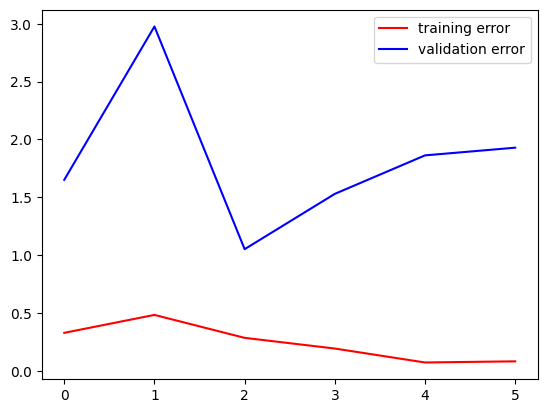

--------------------------------------------
Training = 30.0 %


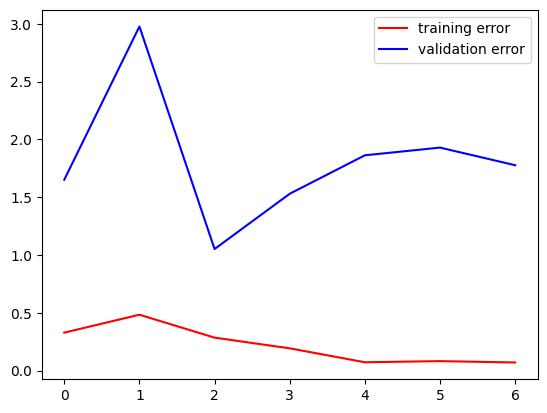

--------------------------------------------
Training = 35.0 %


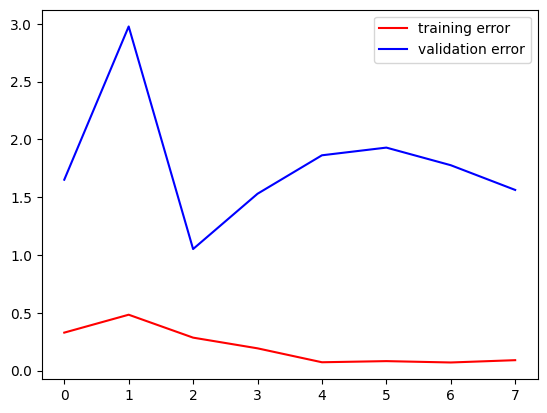

--------------------------------------------
Training = 40.0 %


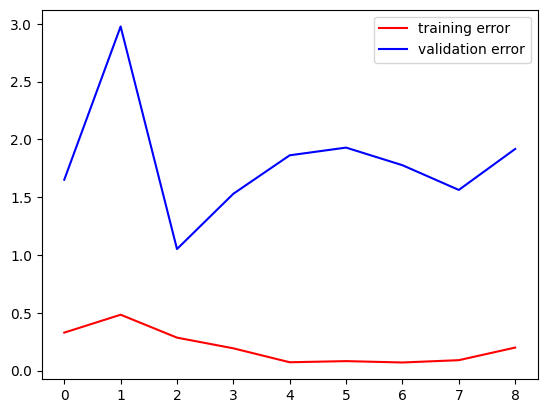

--------------------------------------------
Training = 45.0 %


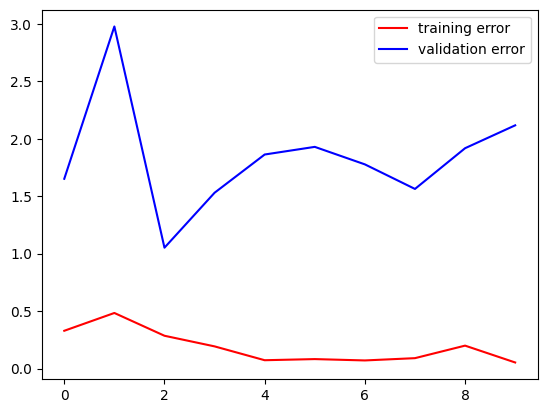

--------------------------------------------
Training = 50.0 %
epoch = 0
dim_clique = 36
training error = 0.15934361517429352
validation error = 1.6623680591583252
test error = 0.20275700092315674
--------------------------------------------
Training = 0.0 %


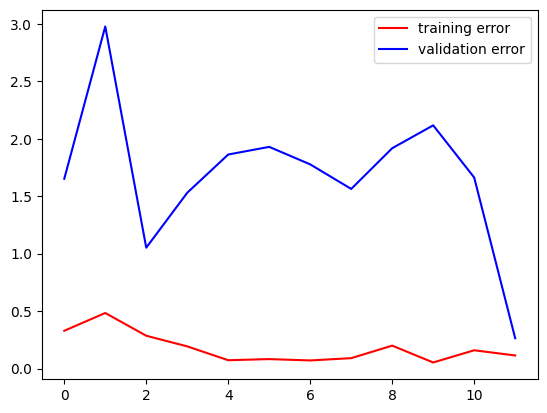

--------------------------------------------
Training = 5.0 %


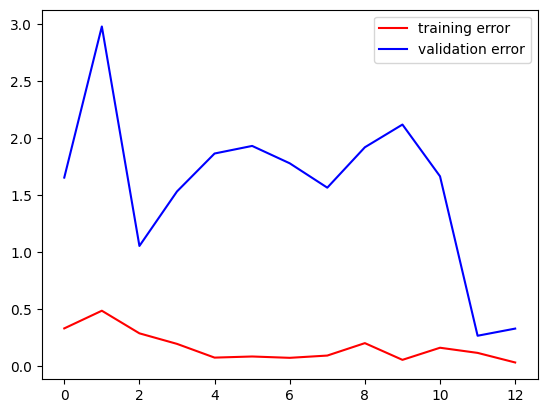

--------------------------------------------
Training = 10.0 %


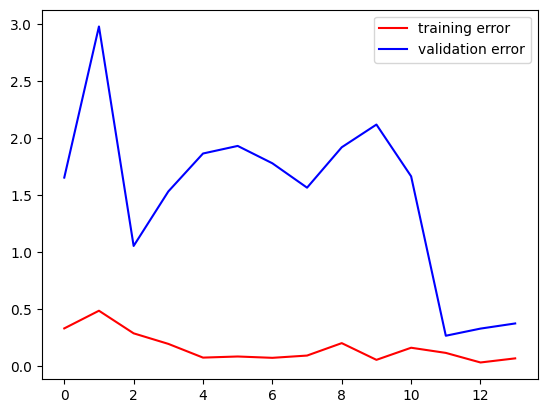

--------------------------------------------
Training = 15.0 %


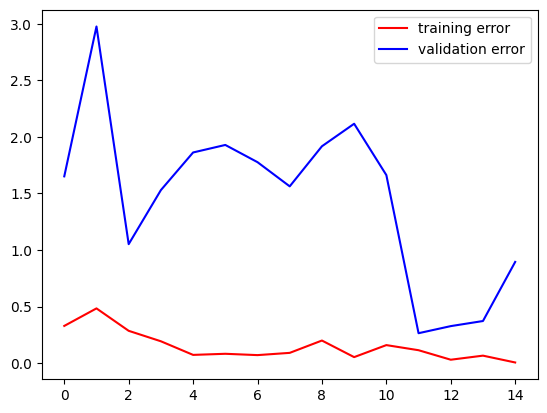

--------------------------------------------
Training = 20.0 %


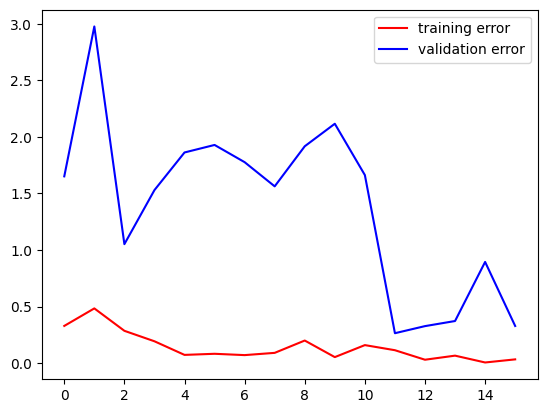

--------------------------------------------
Training = 25.0 %
epoch = 1
dim_clique = 36
training error = 0.010773077607154846
validation error = 0.05988454073667526
test error = 0.09617073088884354
--------------------------------------------
Early stop
--------------------------------------------


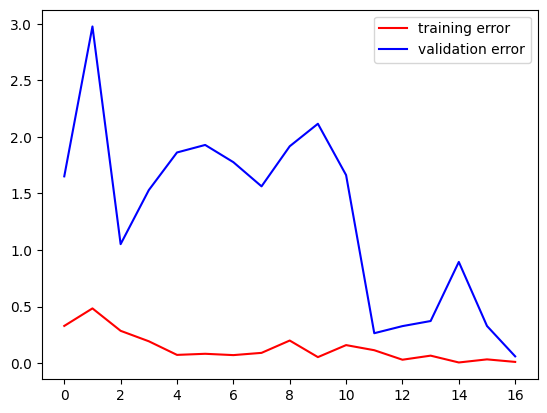

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0]
Training = 0.0 %


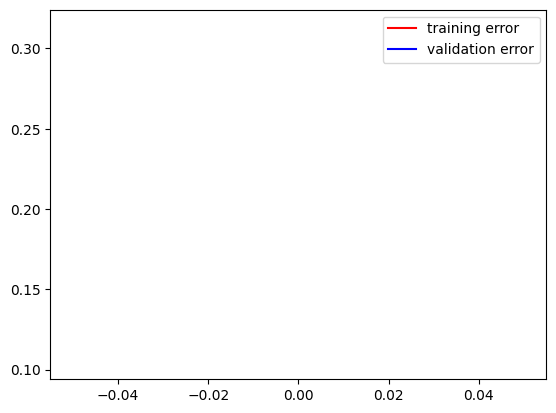

--------------------------------------------
Training = 5.0 %


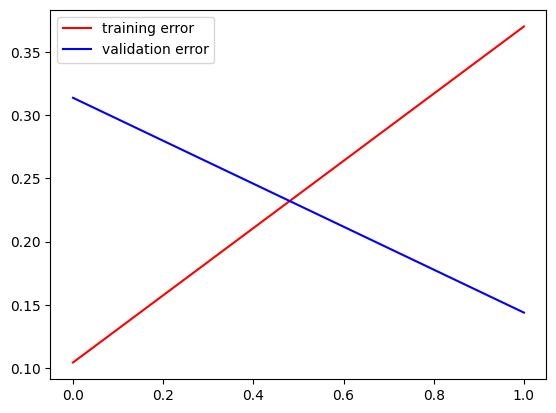

--------------------------------------------
Training = 10.0 %
epoch = 0
dim_clique = 34
training error = 0.16236110031604767
validation error = 0.09587958455085754
test error = 0.364413321018219
--------------------------------------------
Early stop
--------------------------------------------


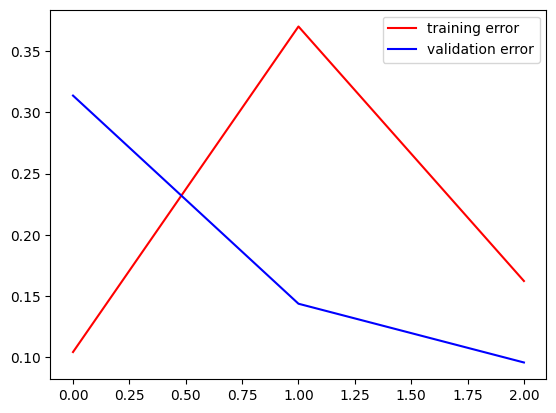

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6, 3.4] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0, 90.0]
Training = 0.0 %


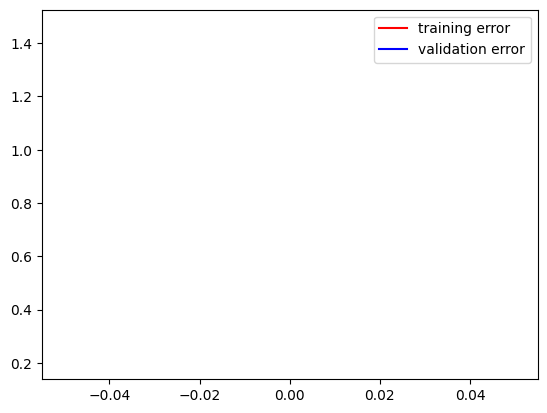

--------------------------------------------
Training = 5.0 %


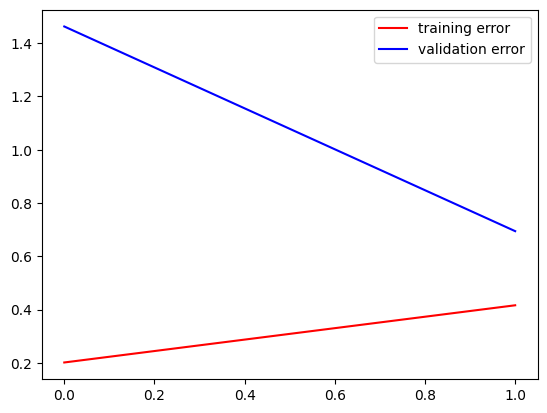

--------------------------------------------
Training = 10.0 %


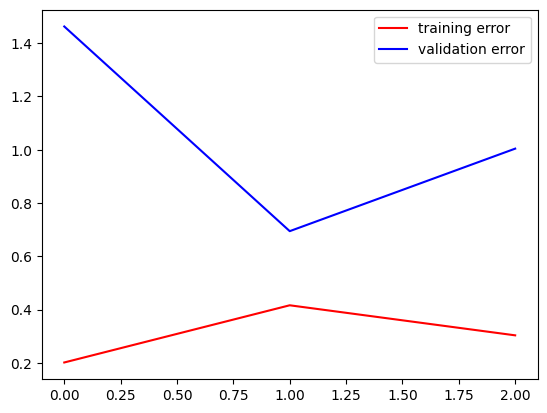

--------------------------------------------
Training = 15.0 %


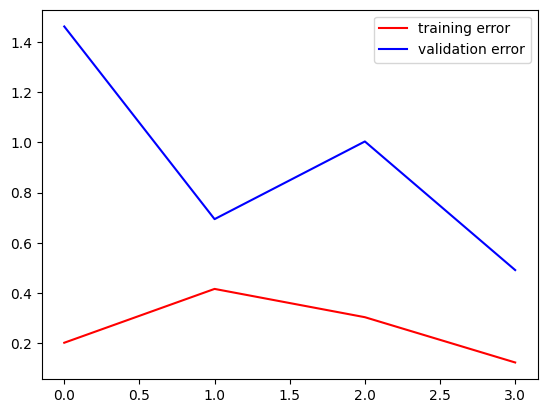

--------------------------------------------
Training = 20.0 %


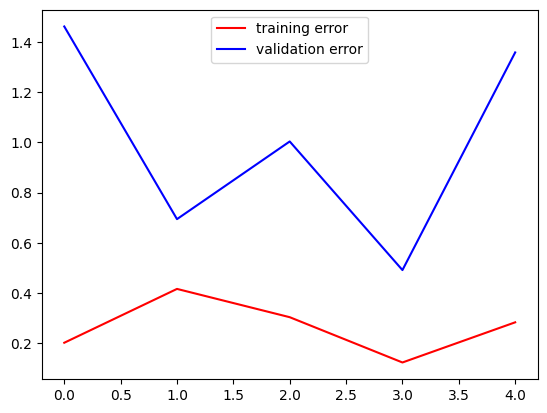

--------------------------------------------
Training = 25.0 %


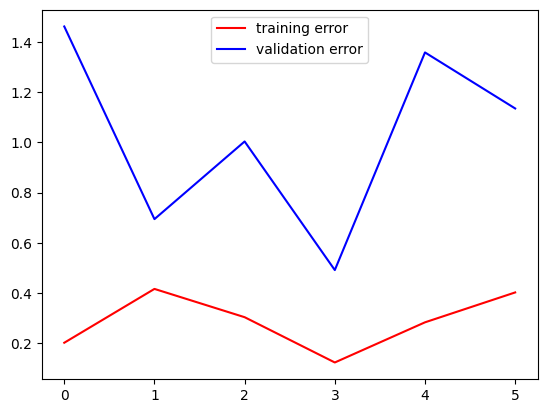

--------------------------------------------
Training = 30.0 %


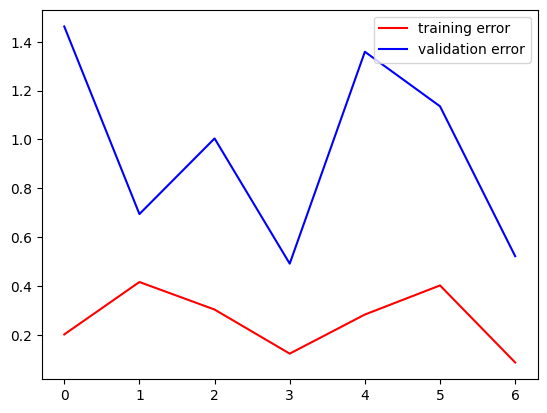

--------------------------------------------
Training = 35.0 %


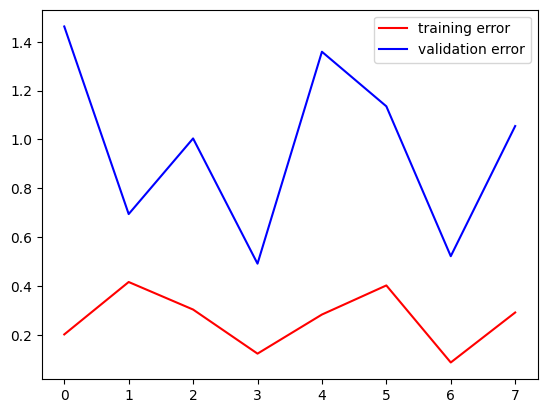

--------------------------------------------
Training = 40.0 %


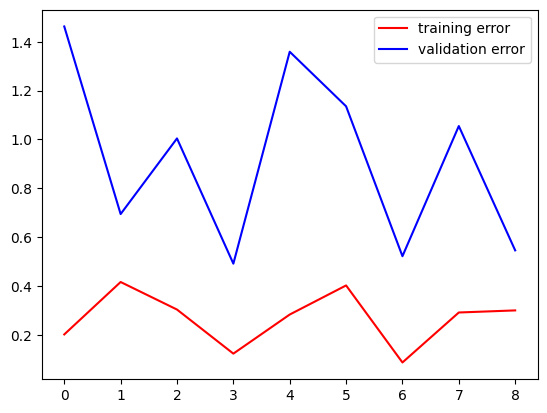

--------------------------------------------
Training = 45.0 %


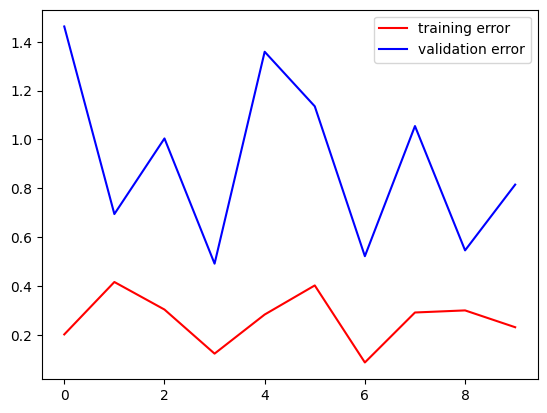

--------------------------------------------
Training = 50.0 %


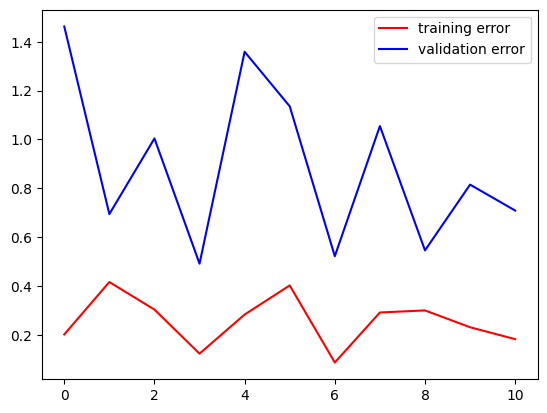

--------------------------------------------
Training = 55.0 %


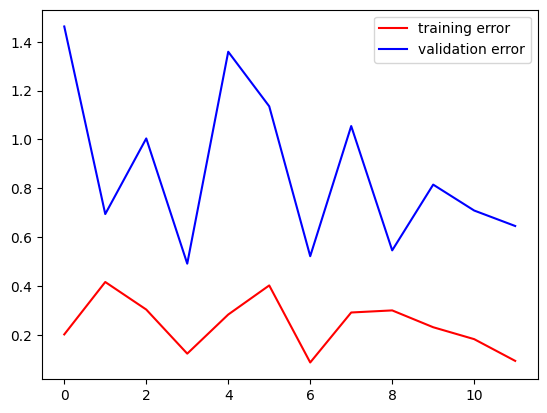

--------------------------------------------
Training = 60.0 %


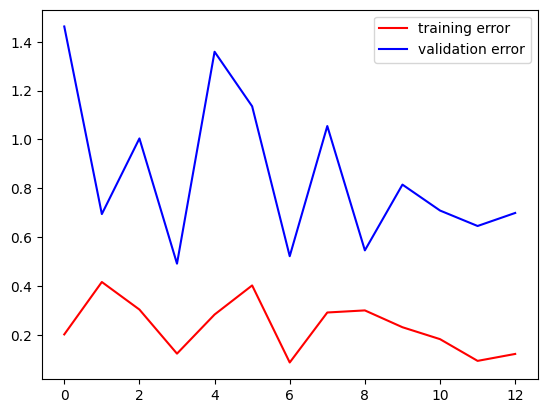

--------------------------------------------
Training = 65.0 %


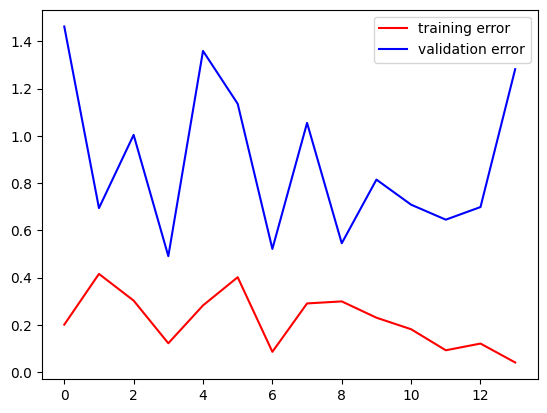

--------------------------------------------
Training = 70.0 %


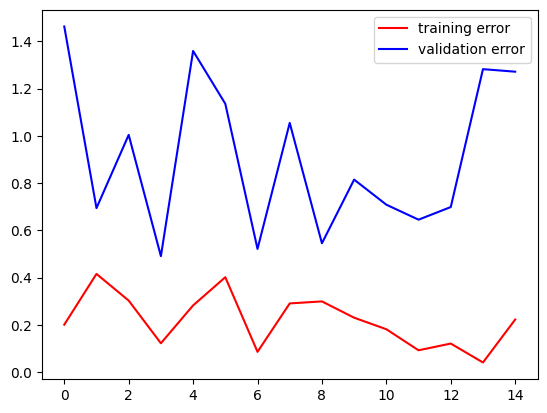

--------------------------------------------
Training = 75.0 %


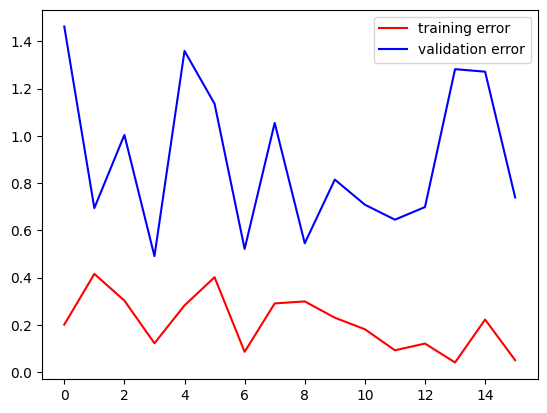

--------------------------------------------
Training = 80.0 %


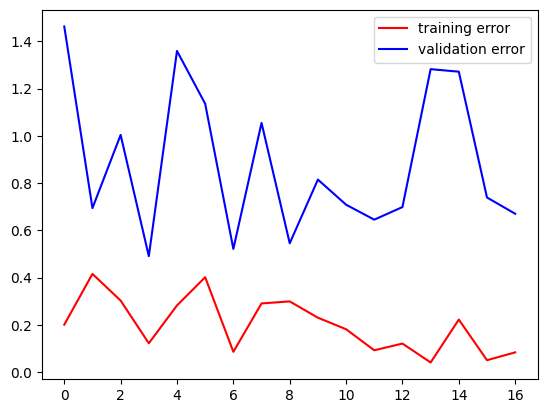

--------------------------------------------
Training = 85.0 %


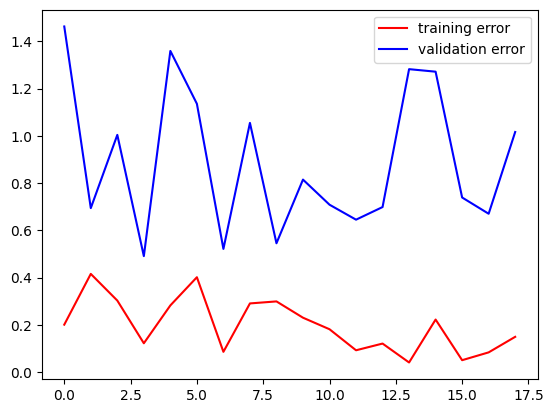

--------------------------------------------
Training = 90.0 %
epoch = 0
dim_clique = 32
training error = 0.044188328087329865
validation error = 1.2257717847824097
test error = 0.3286413252353668
--------------------------------------------
Training = 0.0 %


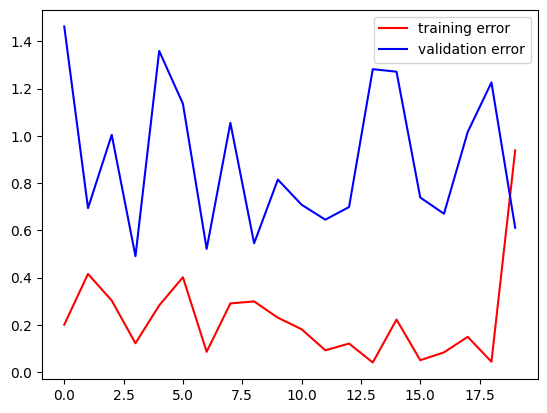

--------------------------------------------
Training = 5.0 %


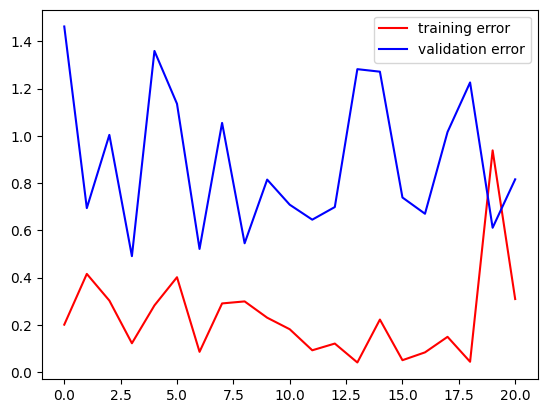

--------------------------------------------
Training = 10.0 %


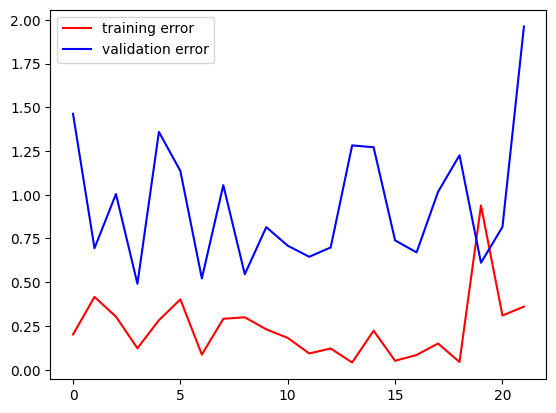

--------------------------------------------
Training = 15.0 %


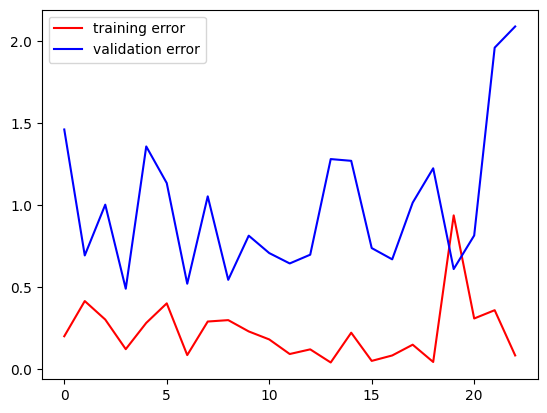

--------------------------------------------
Training = 20.0 %


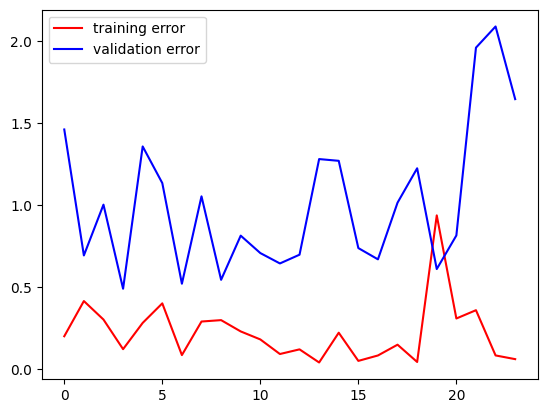

--------------------------------------------
Training = 25.0 %


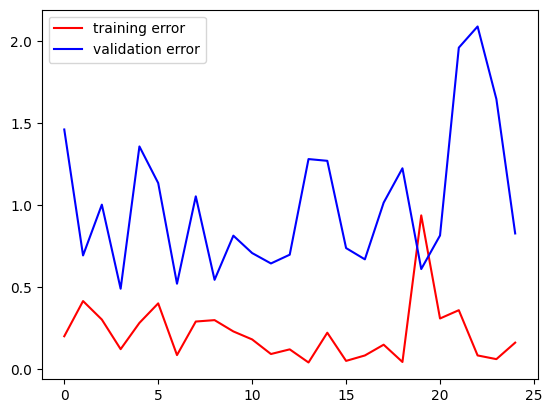

--------------------------------------------
Training = 30.0 %


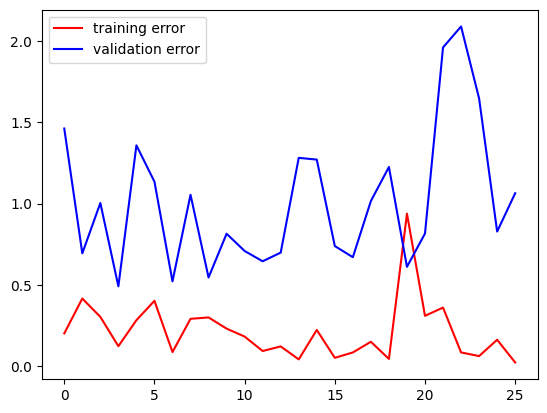

--------------------------------------------
Training = 35.0 %


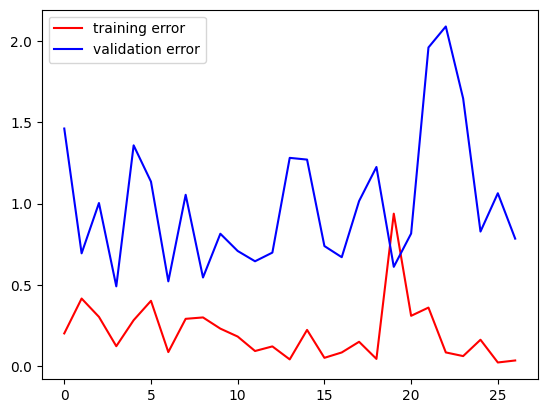

--------------------------------------------
Training = 40.0 %


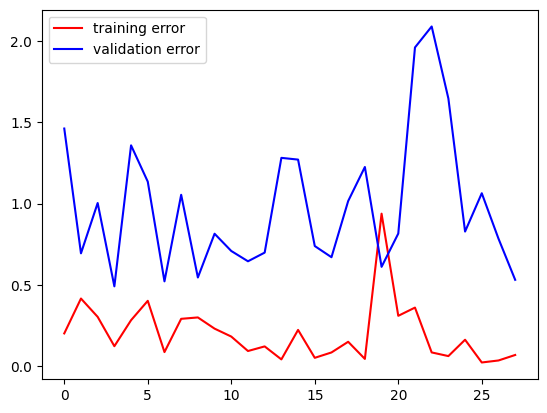

--------------------------------------------
Training = 45.0 %


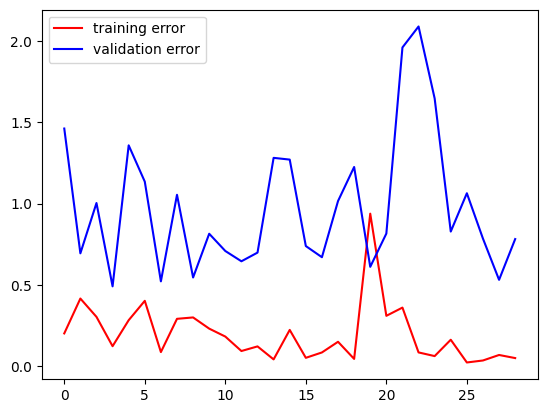

--------------------------------------------
Training = 50.0 %


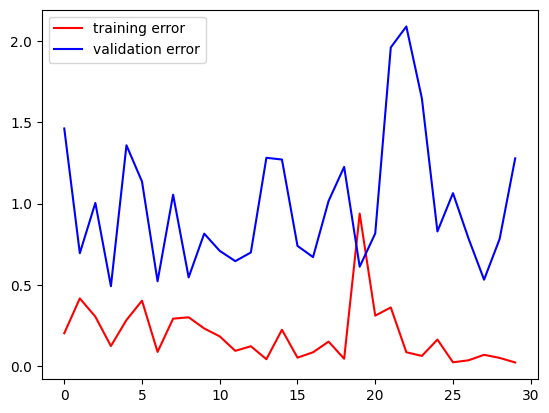

--------------------------------------------
Training = 55.0 %


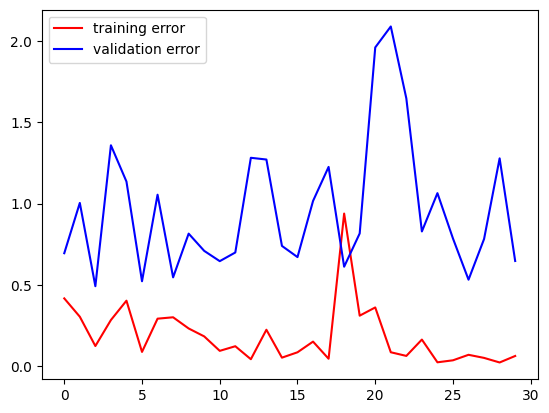

--------------------------------------------
Training = 60.0 %


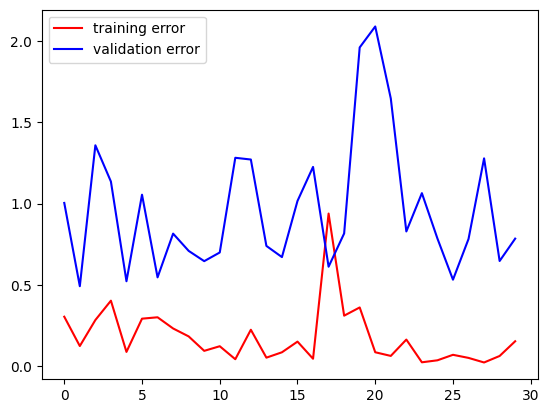

--------------------------------------------
Training = 65.0 %


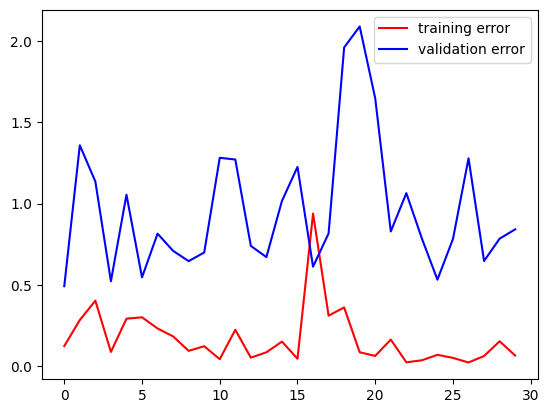

--------------------------------------------
Training = 70.0 %


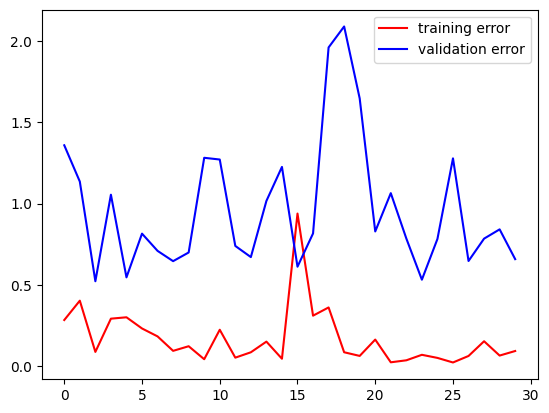

--------------------------------------------
Training = 75.0 %


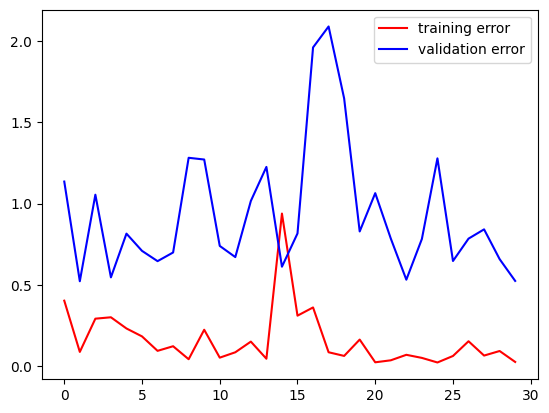

--------------------------------------------
Training = 80.0 %


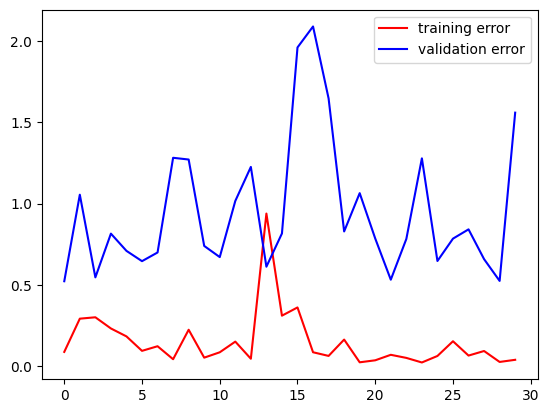

--------------------------------------------
Training = 85.0 %


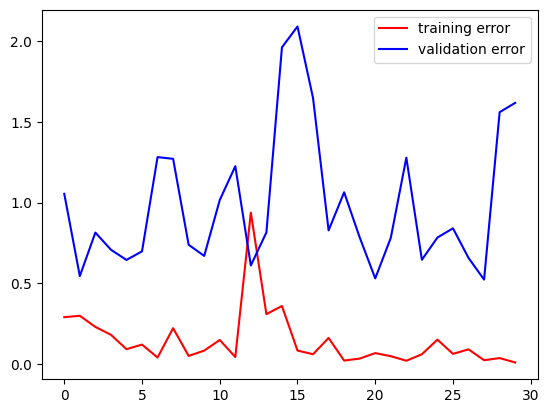

--------------------------------------------
Training = 90.0 %


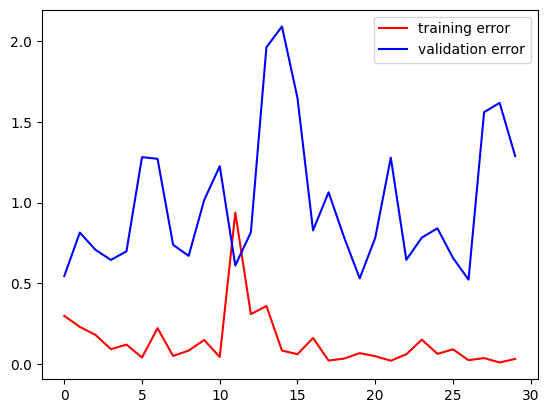

--------------------------------------------
Training = 95.0 %


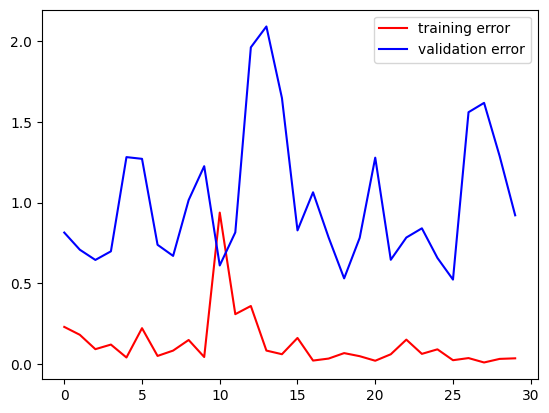

--------------------------------------------
epoch = 1
dim_clique = 32
training error = 0.036116745322942734
validation error = 0.9216486811637878
test error = 0.08517488837242126
--------------------------------------------
Training = 0.0 %


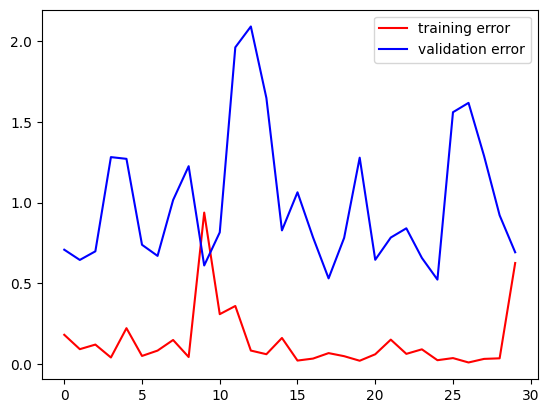

--------------------------------------------
Training = 5.0 %


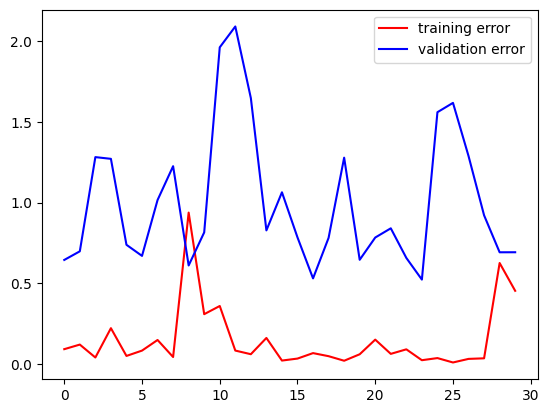

--------------------------------------------
Training = 10.0 %


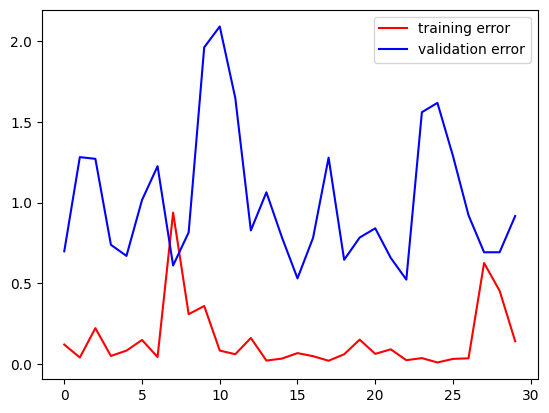

--------------------------------------------
Training = 15.0 %


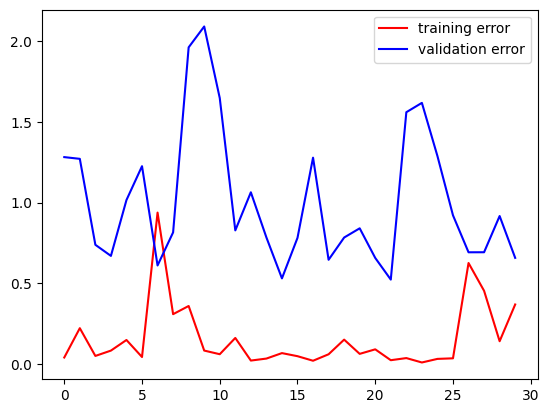

--------------------------------------------
Training = 20.0 %


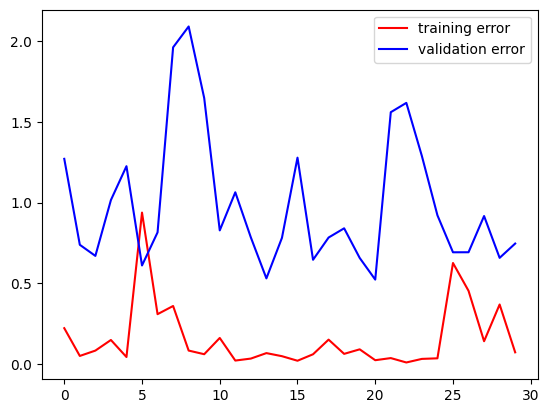

--------------------------------------------
Training = 25.0 %


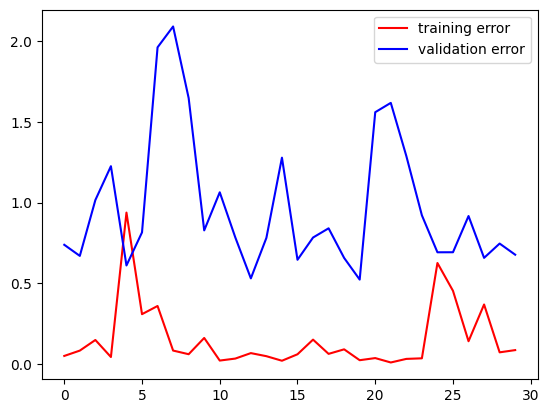

--------------------------------------------
Training = 30.0 %


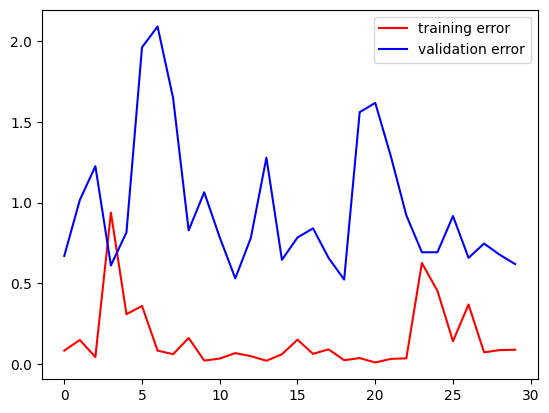

--------------------------------------------
Training = 35.0 %


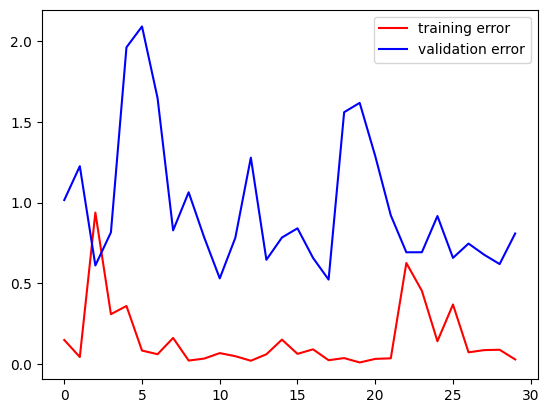

--------------------------------------------
Training = 40.0 %


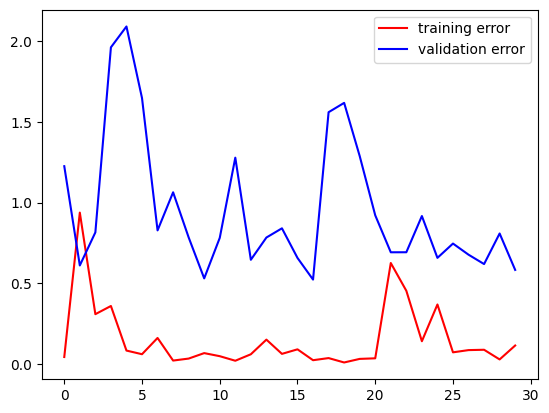

--------------------------------------------
Training = 45.0 %


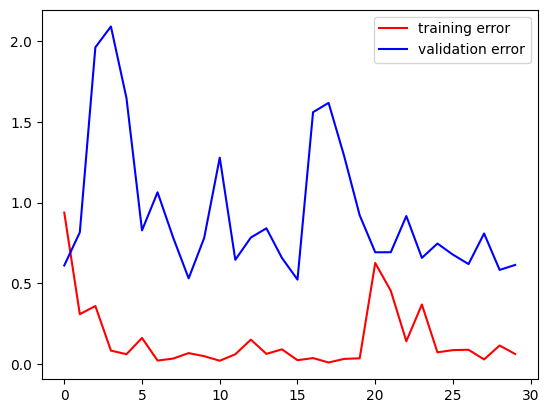

--------------------------------------------
Training = 50.0 %


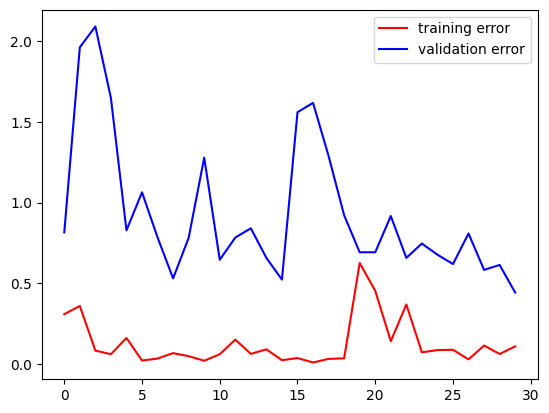

--------------------------------------------
Training = 55.0 %


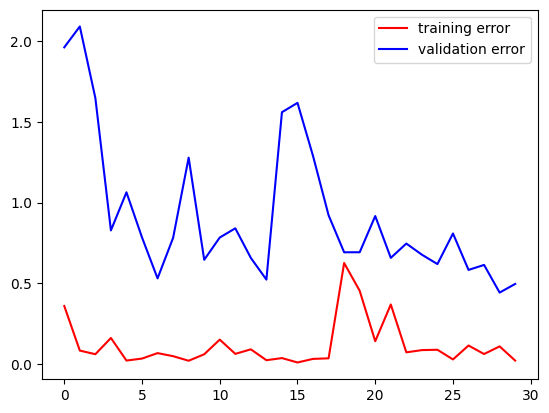

--------------------------------------------
Training = 60.0 %
epoch = 2
dim_clique = 32
training error = 0.15938881039619446
validation error = 0.08402632921934128
test error = 0.2455388605594635
--------------------------------------------
Early stop
--------------------------------------------


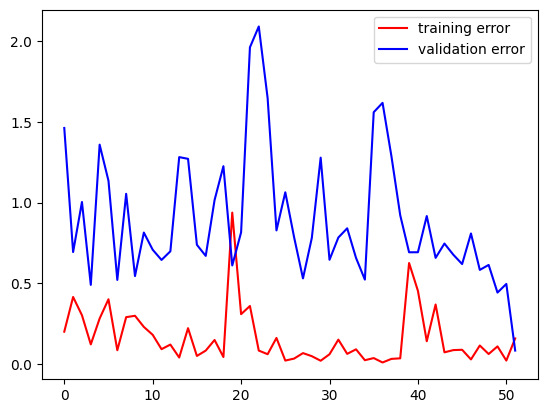

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6, 3.4, 3.2] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0, 90.0, 90.0]
Training = 0.0 %


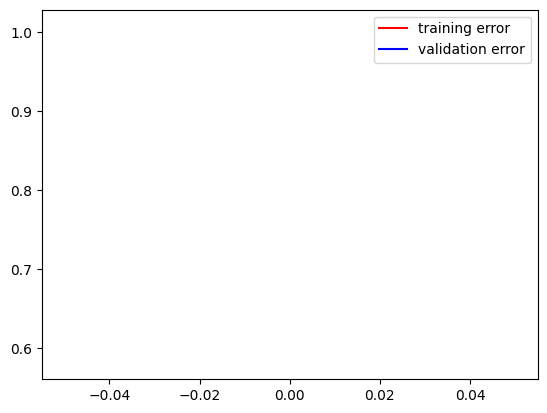

--------------------------------------------
Training = 5.0 %


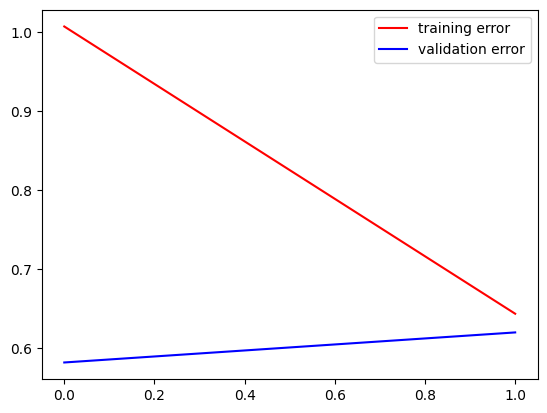

--------------------------------------------
Training = 10.0 %


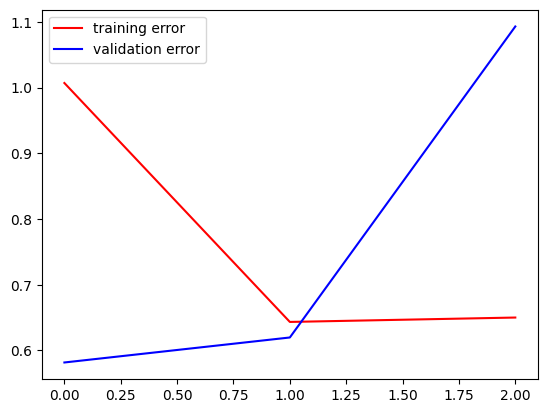

--------------------------------------------
Training = 15.0 %


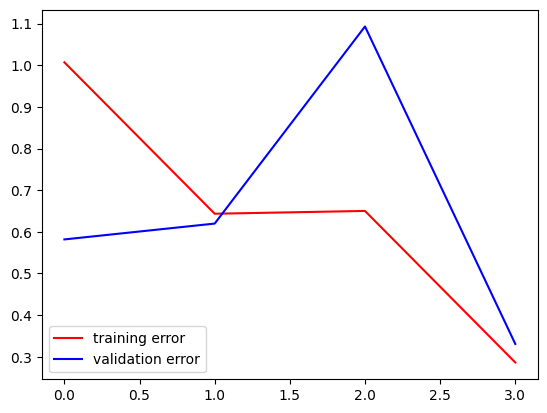

--------------------------------------------
Training = 20.0 %


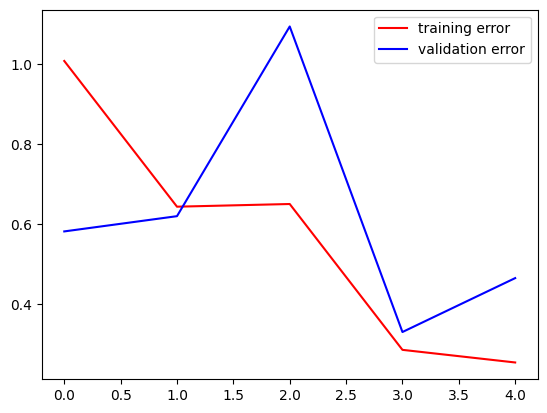

--------------------------------------------
Training = 25.0 %


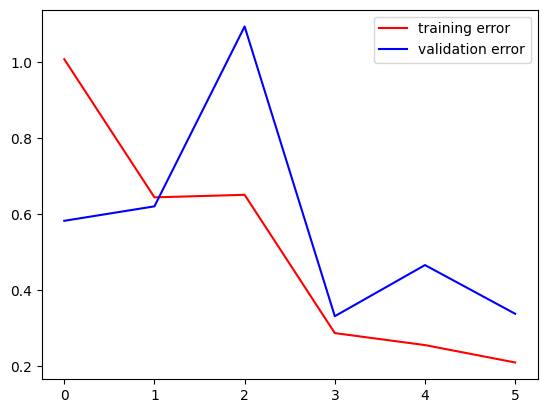

--------------------------------------------
Training = 30.0 %


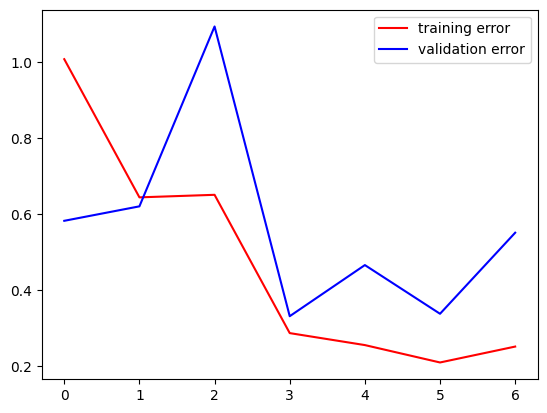

--------------------------------------------
Training = 35.0 %


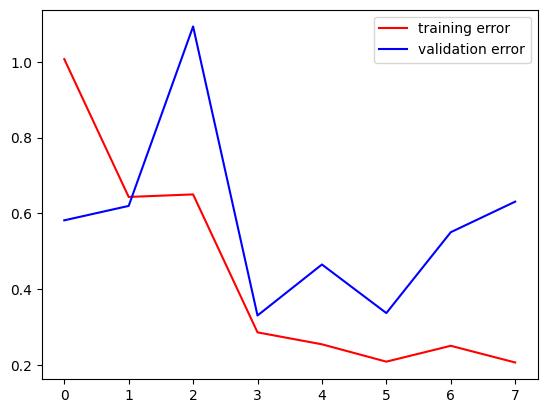

--------------------------------------------
Training = 40.0 %


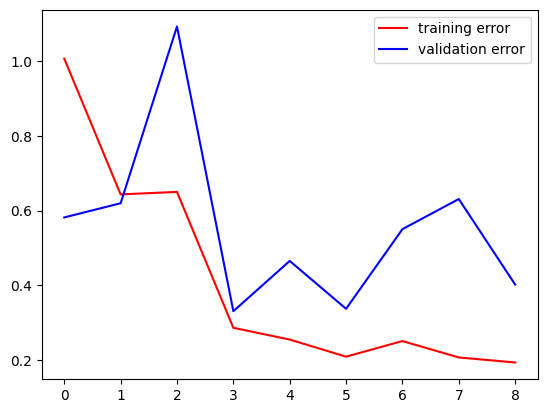

--------------------------------------------
Training = 45.0 %


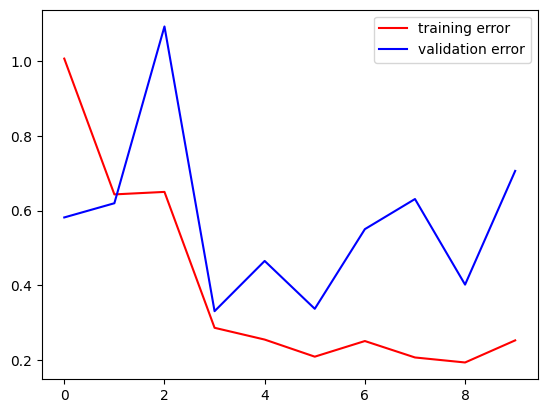

--------------------------------------------
Training = 50.0 %


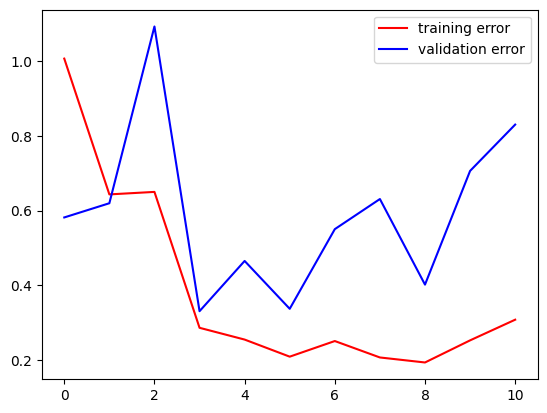

--------------------------------------------
Training = 55.0 %
epoch = 0
dim_clique = 30
training error = 0.14876914024353027
validation error = 0.4481654763221741
test error = 0.4581606388092041
--------------------------------------------
Training = 0.0 %


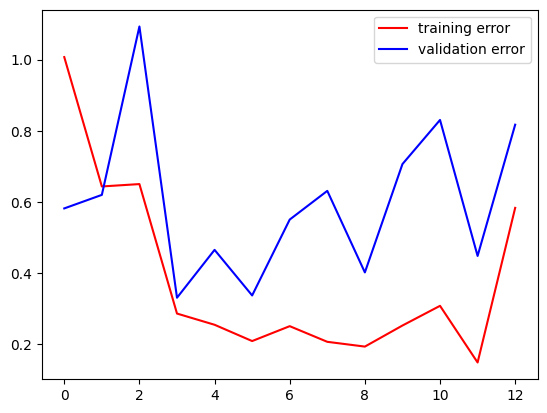

--------------------------------------------
Training = 5.0 %


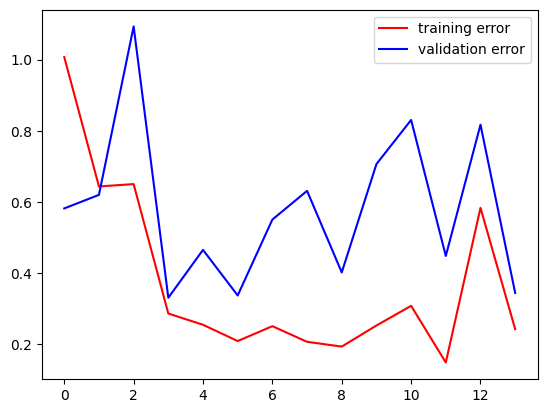

--------------------------------------------
Training = 10.0 %


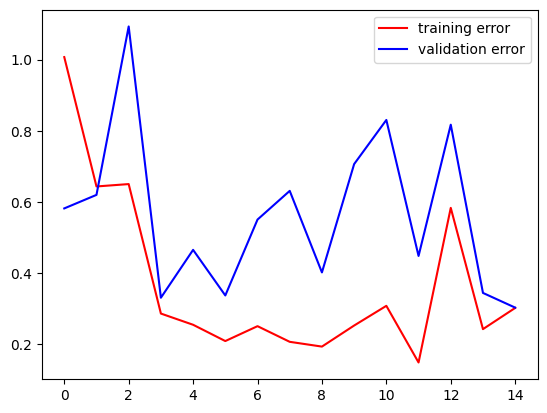

--------------------------------------------
Training = 15.0 %


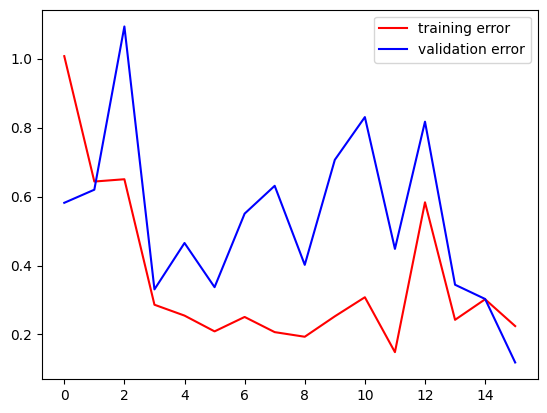

--------------------------------------------
Training = 20.0 %


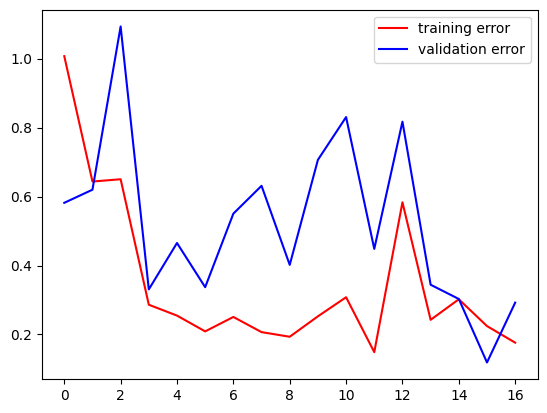

--------------------------------------------
Training = 25.0 %


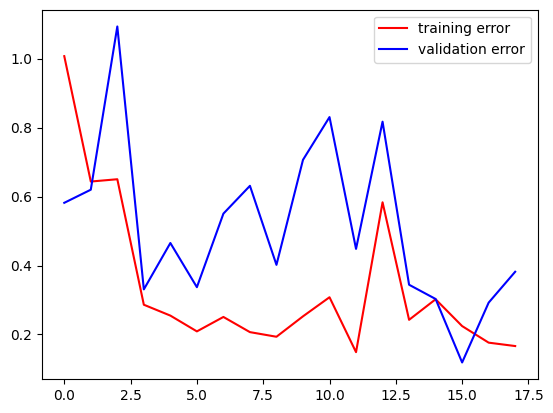

--------------------------------------------
Training = 30.0 %


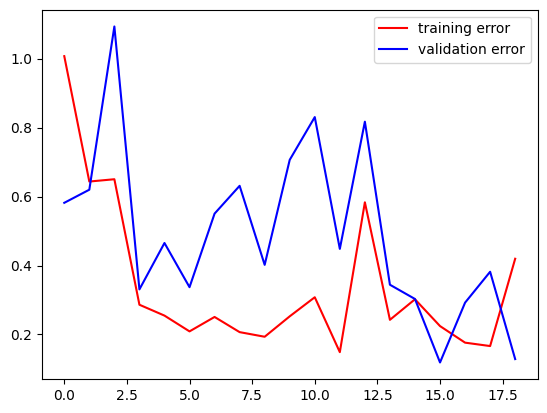

--------------------------------------------
Training = 35.0 %


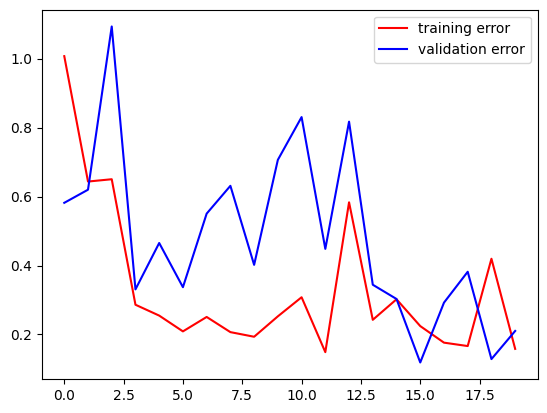

--------------------------------------------
Training = 40.0 %


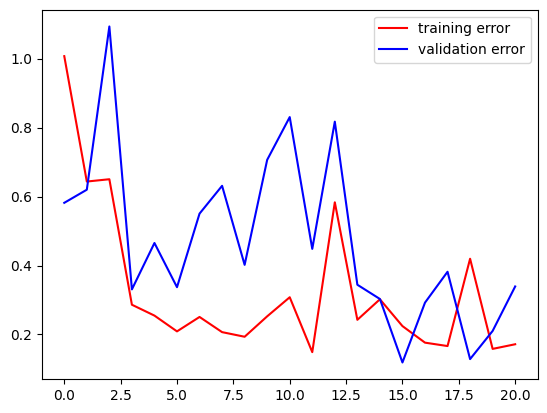

--------------------------------------------
Training = 45.0 %


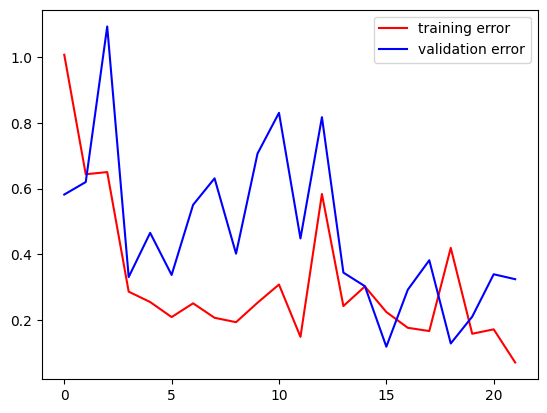

--------------------------------------------
Training = 50.0 %


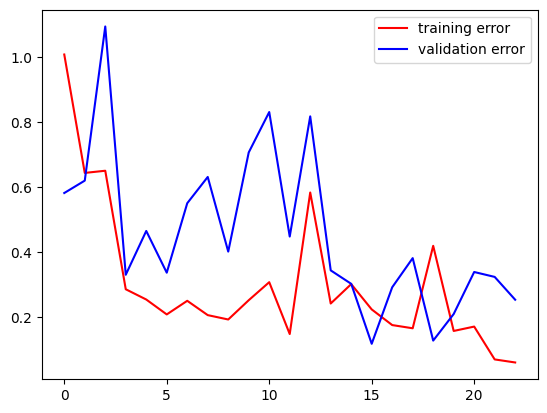

--------------------------------------------
Training = 55.0 %


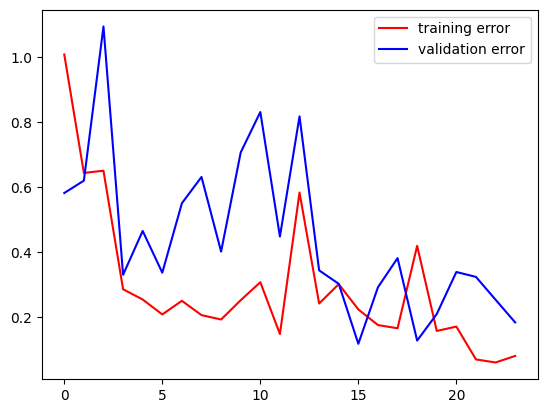

--------------------------------------------
Training = 60.0 %


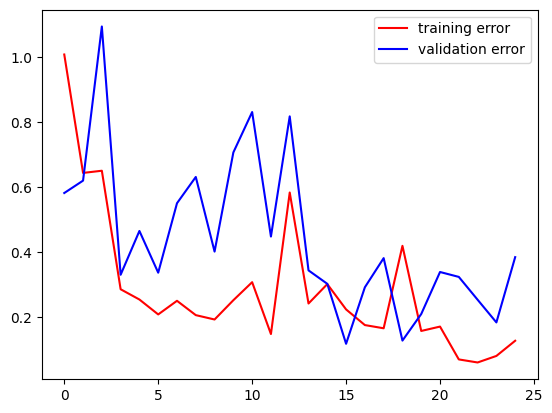

--------------------------------------------
Training = 65.0 %
epoch = 1
dim_clique = 30
training error = 0.13272154331207275
validation error = 0.08589340001344681
test error = 0.2949540317058563
--------------------------------------------
Early stop
--------------------------------------------


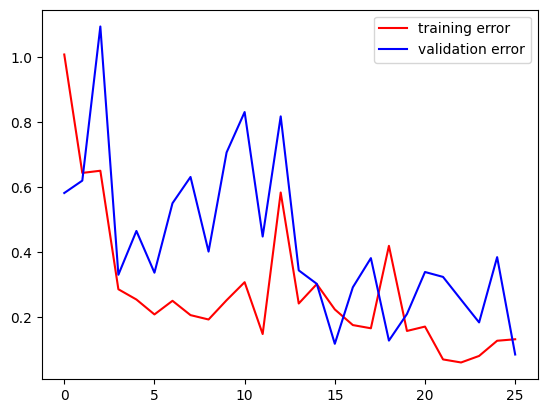

k/n = [5.0, 4.8, 4.6, 4.4, 4.2, 4.0, 3.8, 3.6, 3.4, 3.2, 3.0] % = [100.0, 100.0, 100.0, 100.0, 65.0, 90.0, 90.0, 95.0, 90.0, 90.0, 90.0]


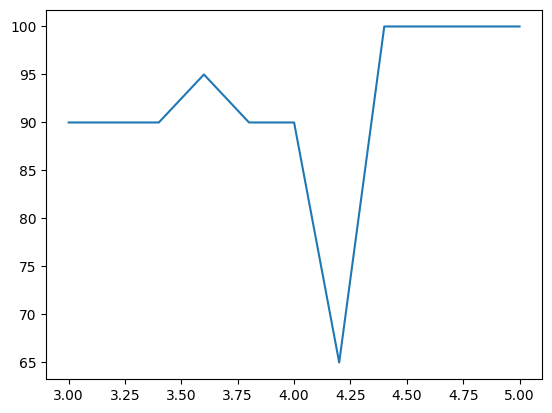

In [ ]:
epoch=5                   # number of epochs
max_steps=100             # maximum number of steps for each epoch
num_train=20              # dimension of the training set at each epoch
num_val=20                # dimension of the validation set
num_test=20               # dimension of the test set
dim_graph=100             # number of nodes
start_dim_clique=50       # dimension of the clique to start with
jump=2                    # jump lengths for the first loop
save_step=5               # number of steps after which we check the early stopping criterion
stop = 29                     # clique size at which we stop
training_exit_error = 0.2    # training error below which we can stop early
validation_exit_error = 0.1  # validation error below which we can stop early

train_error=[]
val_error=[]

generalization=[]
k_over_n=[]
for m in range(0,start_dim_clique-stop,jump):
  dim_clique = start_dim_clique - m
  test = GetClique(num_test,dim_graph,dim_clique, prob = 0.5)
  k_over_n.append(1.0*dim_clique/math.sqrt(dim_graph))
  loss=1.0
  count=0

  for j in range(epoch):
    early_stop_counter=0
    min_validation_loss = np.inf
    train = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    val = GetClique(num_val,dim_graph,dim_clique, prob = 0.5)
    for i in range(max_steps):
      output = model(train[0].to(device))
      loss=criterion(output.type(torch.float).to(device), torch.Tensor(train[1]).type(torch.long).to(device))

      # every "print_step" steps we save the error of the train and validation set
      if (i%save_step == 0):
        print('Training =',100.0*i/max_steps,'%')
        train_error.append(loss.item())
        check = model(val[0].to(device))   # checks the output on the validation set
        val_loss = criterion(check.to(device), torch.Tensor(val[1]).type(torch.long).to(device)).item()
        val_error.append(val_loss)

        # early_stopping needs the validation loss to check if it has decresed,
        # and if it has, it will make a checkpoint of the current model
        early_exit,min_validation_loss,early_stop_counter = EarlyStopper(np.array(val_error), early_stop_counter, min_validation_loss)
        if (val_error[count]<validation_exit_error or (early_exit and train_error[count]<training_exit_error)):
          count=count+1
          break

        count=count+1
        if (count > 30):
          # plot of test and validation error curves
          x_axis = np.arange(30)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[count-30:count], 'r', label='training error')
          ax.plot(x_axis, val_error[count-30:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')
        else:
          # plot of test and validation error curves
          x_axis = np.arange(count)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[:count], 'r', label='training error')
          ax.plot(x_axis, val_error[:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')

      loss.backward()
      optim.step()
      optim.zero_grad(set_to_none=True)


    # test error
    test_output = model(test[0].to(device))   # checks the output on the test set
    test_error = criterion(test_output.to(device), torch.Tensor(test[1]).type(torch.long).to(device))
    if (j%1 == 0):
      print('epoch =',j)
      print('dim_clique =',dim_clique)
      print('training error =', train_error[count-1])
      print('validation error =',val_error[count-1])
      print('test error =',test_error.item())
      print('--------------------------------------------')

    if (val_error[count-1]<validation_exit_error):
          print('Early stop')
          print('--------------------------------------------')
          break
  # plot of test and validation error curves
  x_axis = np.arange(count)
  fig, ax = plt.subplots()
  ax.plot(x_axis, train_error[:count], 'r', label='training error')
  ax.plot(x_axis, val_error[:count], 'b', label='validation error')
  ax.legend()
  plt.show()

  train_error=[]
  val_error=[]

  data = test
  hard_output = torch.zeros([num_test,2])

  soft_output = model(data[0].to(device))
  for l in range(num_test):
    if (soft_output[l][0] > soft_output[l][1]):
      hard_output[l][0] = 1.0
    else: hard_output[l][1] = 1.0
  predicted_output = hard_output

  generalization.append(100*(1-torch.sum(torch.square(torch.Tensor(data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test)))
  print('k/n =', k_over_n, '% =', generalization)
  print('==========================================')

plt.plot(k_over_n,generalization)

Here we check the generalization error and we compute the transition at which the CNN strats to fail.

k = 85 ----> % = 99.33333333333333
k = 84 ----> % = 98.33333333333333
k = 83 ----> % = 99.66666666666667
k = 82 ----> % = 99.33333333333333
k = 81 ----> % = 99.66666666666667
k = 80 ----> % = 100.0
k = 79 ----> % = 100.0
k = 78 ----> % = 99.66666666666667
k = 77 ----> % = 100.0
k = 76 ----> % = 99.33333333333333
k = 75 ----> % = 99.66666666666667
k = 74 ----> % = 99.33333333333333
k = 73 ----> % = 99.66666666666667
k = 72 ----> % = 100.0
k = 71 ----> % = 99.66666666666667
k = 70 ----> % = 99.66666666666667
k = 69 ----> % = 100.0
k = 68 ----> % = 100.0
k = 67 ----> % = 100.0
k = 66 ----> % = 99.33333333333333
k = 65 ----> % = 99.33333333333333
k = 64 ----> % = 99.0
k = 63 ----> % = 100.0
k = 62 ----> % = 100.0
k = 61 ----> % = 100.0
k = 60 ----> % = 99.66666666666667
k = 59 ----> % = 99.66666666666667
k = 58 ----> % = 99.66666666666667
k = 57 ----> % = 98.66666666666667
k = 56 ----> % = 99.66666666666667
k = 55 ----> % = 99.66666666666667
k = 54 ----> % = 100.0
k = 53 ----> % = 100.0
k 

k = 3 ----> % = 51.333333333333336
k over sqrt(n) = [8.5, 8.4, 8.3, 8.2, 8.1, 8.0, 7.9, 7.8, 7.7, 7.6, 7.5, 7.4, 7.3, 7.2, 7.1, 7.0, 6.9, 6.8, 6.7, 6.6, 6.5, 6.4, 6.3, 6.2, 6.1, 6.0, 5.9, 5.8, 5.7, 5.6, 5.5, 5.4, 5.3, 5.2, 5.1, 5.0, 4.9, 4.8, 4.7, 4.6, 4.5, 4.4, 4.3, 4.2, 4.1, 4.0, 3.9, 3.8, 3.7, 3.6, 3.5, 3.4, 3.3, 3.2, 3.1, 3.0, 2.9, 2.8, 2.7, 2.6, 2.5, 2.4, 2.3, 2.2, 2.1, 2.0, 1.9, 1.8, 1.7, 1.6, 1.5, 1.4, 1.3, 1.2, 1.1, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3] % = [99.33333333333333, 98.33333333333333, 99.66666666666667, 99.33333333333333, 99.66666666666667, 100.0, 100.0, 99.66666666666667, 100.0, 99.33333333333333, 99.66666666666667, 99.33333333333333, 99.66666666666667, 100.0, 99.66666666666667, 99.66666666666667, 100.0, 100.0, 100.0, 99.33333333333333, 99.33333333333333, 99.0, 100.0, 100.0, 100.0, 99.66666666666667, 99.66666666666667, 99.66666666666667, 98.66666666666667, 99.66666666666667, 99.66666666666667, 100.0, 100.0, 99.33333333333333, 98.66666666666667, 99.33333333333333, 

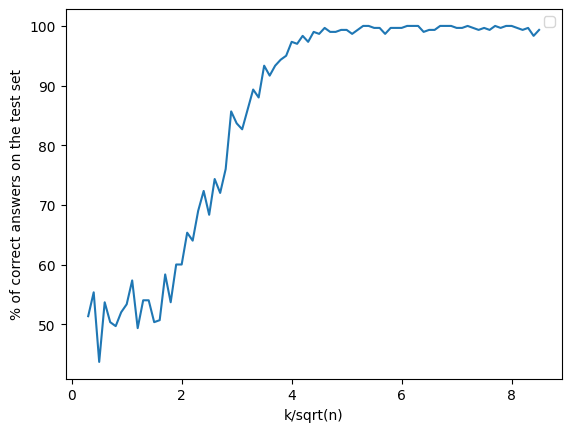

In [ ]:
start_dim_clique = 85
times = 15

generalization_CNN = []
k_vs_sqrt_n_CNN = []

for m in range(0,start_dim_clique-2,1):
  dim_clique = start_dim_clique - m
  k_vs_sqrt_n_CNN.append(1.0*dim_clique/math.sqrt(dim_graph))
  mean = 0

  for j in range(times):
    data = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    hard_output = torch.zeros([num_test,2])

    soft_output = model(data[0].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[1])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization_CNN.append(mean)
  print('k =',dim_clique,'---->', '% =', mean)
  print('==========================================')
print('k over sqrt(n) =', list(k_vs_sqrt_n_CNN), '% =', list(generalization_CNN))
print('==========================================')

fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_CNN,generalization_CNN)
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()

# Graph Neural Networks (GNNs)

In [ ]:
# Install required packages.
import os
import torch
os.environ['TORCH'] = torch.__version__
print(torch.__version__)

!pip install -q torch-scatter -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install -q torch-sparse -f https://data.pyg.org/whl/torch-${TORCH}.html
!pip install -q git+https://github.com/pyg-team/pytorch_geometric.git

# Helper function for visualization.
%matplotlib inline
import networkx as nx
import matplotlib.pyplot as plt

2.1.0+cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 83.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 55.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


We build a different dataset generator in the case of GNNs. In fact out graph nodes have no labels, which is not in line with standard GNN architectures. Therefore we have to choose to assign features based on (?). These features some connectivity properties of each node.

In [ ]:
def Plant(A,k,n):
  A[:k,:k] = torch.ones(k,k)
  r = torch.randperm(n)
  A = A[r[:, None], r]
  return A

def PlantedClique(n,p,k,on_off,hidden):
  if (on_off == 0):
    if (hidden == 1):
      p_off = p + (1-p)*(k*(k-1))/(n*(n-1))
    else:
      p_off = p
    A = torch.bernoulli(p_off*torch.ones(n,n))
    A_up = torch.triu(A)
    A = A_up + torch.transpose(A_up, 0, 1)
    A.fill_diagonal_(0)
    return A,on_off
  if (on_off == 1):
    p_on = p
    B = torch.bernoulli(p_on*torch.ones(n,n))
    B_up = torch.triu(B)
    B = B_up + torch.transpose(B_up, 0, 1)
    B.fill_diagonal_(1)
    C = Plant(B,k,n).fill_diagonal_(0)
    return C,on_off

def GetClique(m,n,k,p=0.5,prob=0.5,hidden = 1):
  on_off = torch.bernoulli(prob*torch.ones(m))
  attrib = torch.rand((n*m,5))
  for i in range(m):
    if (i==0):
      data_0 = PlantedClique(n,p,k,on_off[i],hidden)[0]
      batch = i*torch.ones(n)
    else:
      x = PlantedClique(n,p,k,on_off[i],hidden)[0]
      data_0 = torch.block_diag(data_0, x)
      batch = torch.cat((batch, i*torch.ones(n)), 0)

  v_1=torch.sum(data_0,dim=1)
  copy_v_1 = v_1.repeat(n*m,1)
  v_2=torch.sum(copy_v_1*data_0,dim=1)/v_1
  copy_v_2 = v_1.repeat(n*m,1)-v_2.repeat(n*m,1).t()
  copy_v_2 = copy_v_2*copy_v_2
  v_3=torch.sqrt(torch.sum(copy_v_2*data_0,dim=1)/v_1)
  v_4,v_4_ind=torch.max(copy_v_1*data_0,dim=1)
  v_5_contra,v_5_ind=torch.max(data_0/(copy_v_1),dim=1)
  v_5 = 1/v_5_contra

  attrib[:,0] = v_1
  attrib[:,1] = v_2
  attrib[:,2] = v_3
  attrib[:,3] = v_4
  attrib[:,4] = v_5

  data = data_0.long().nonzero().t().contiguous()
  batch = batch.long()
  return attrib,data,batch,on_off.type(torch.long).tolist()

The architecture is just a deep Graph Convolutional network. Also here we use an EarlyStopper function and dropout.

In [ ]:
from torch.nn import Linear
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
from torch_geometric.nn import global_mean_pool

#function for the early stopping
def EarlyStopper(validation_loss, counter, min_validation_loss, past=2, patience=2, min_delta=0.02):
        length = validation_loss.shape[0]
        if np.mean(validation_loss[length-past:]) < min_validation_loss and length > past:
            min_validation_loss = np.mean(validation_loss[length-past:])
            counter = 0
        elif np.mean(validation_loss[length-past:]) > (min_validation_loss + min_delta) and length > past:
            counter += 1
            if counter >= patience:
                return True, min_validation_loss, counter
        return False, min_validation_loss, counter


class GCN(torch.nn.Module):
    def __init__(self, hidden_channels_1, hidden_channels_2, hidden_channels_3, hidden_channels_4, hidden_channels_5):
        super(GCN, self).__init__()
        torch.manual_seed(12345)
        self.conv1 = GCNConv(5, hidden_channels_1)
        self.conv2 = GCNConv(hidden_channels_1, hidden_channels_2)
        self.conv3 = GCNConv(hidden_channels_2, hidden_channels_3)
        self.conv4 = GCNConv(hidden_channels_3, hidden_channels_4)
        self.conv5 = GCNConv(hidden_channels_4, hidden_channels_5)
        self.lin = Linear(hidden_channels_5, 2)

    def forward(self, x, edge_index, batch):
        # 1. Obtain node embeddings
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = self.conv2(x, edge_index)
        x = x.relu()
        x = self.conv3(x, edge_index)
        x = x.relu()
        x = self.conv4(x, edge_index)
        x = x.relu()
        x = self.conv5(x, edge_index)

        # 2. Readout layer
        x = global_mean_pool(x, batch)  # [batch_size, hidden_channels]

        # 3. Apply a final classifier
        x = F.dropout(x, p=0.2, training=self.training)
        x = self.lin(x)

        return x

model_g = GCN(hidden_channels_1=100, hidden_channels_2=80, hidden_channels_3=60, hidden_channels_4=40, hidden_channels_5=20)
optim=torch.optim.Adam(model_g.parameters())   # optimization by Adam
criterion = nn.CrossEntropyLoss()
model_g.to(device)

GCN(
  (conv1): GCNConv(5, 100)
  (conv2): GCNConv(100, 80)
  (conv3): GCNConv(80, 60)
  (conv4): GCNConv(60, 40)
  (conv5): GCNConv(40, 20)
  (lin): Linear(in_features=20, out_features=2, bias=True)
)

Usual training...

Training = 0.0 %


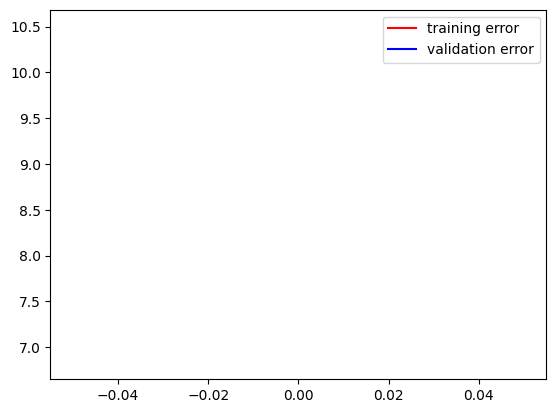

--------------------------------------------
Training = 5.0 %


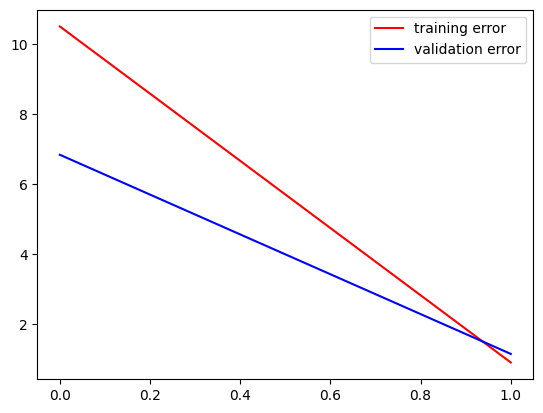

--------------------------------------------
Training = 10.0 %


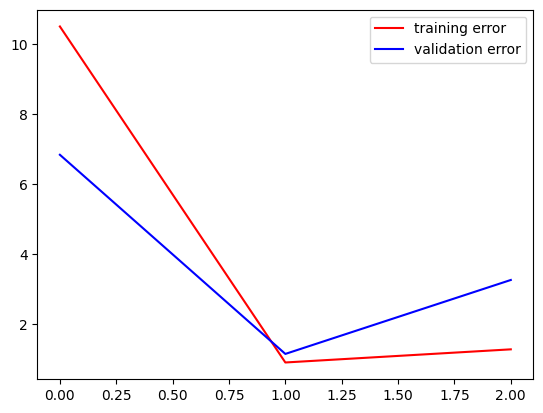

--------------------------------------------
Training = 15.0 %


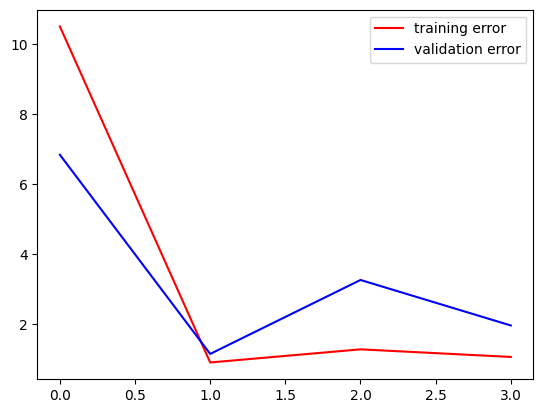

--------------------------------------------
Training = 20.0 %


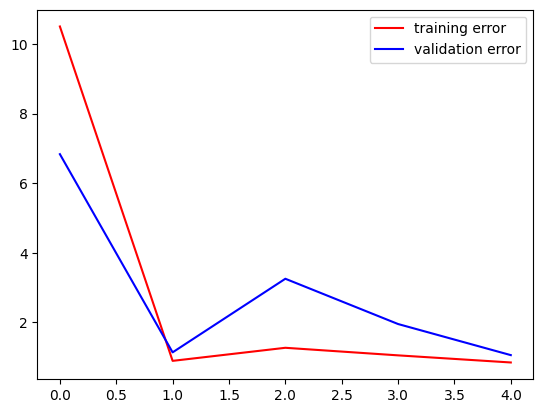

--------------------------------------------
Training = 25.0 %


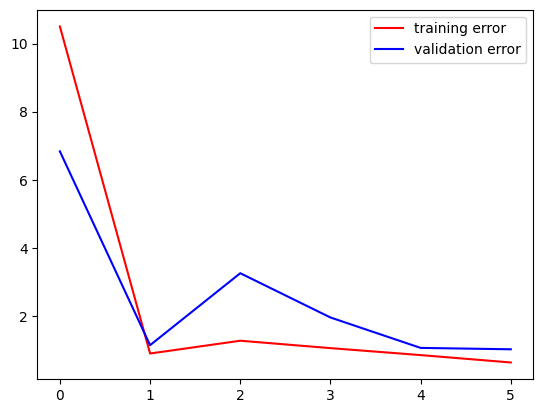

--------------------------------------------
Training = 30.0 %


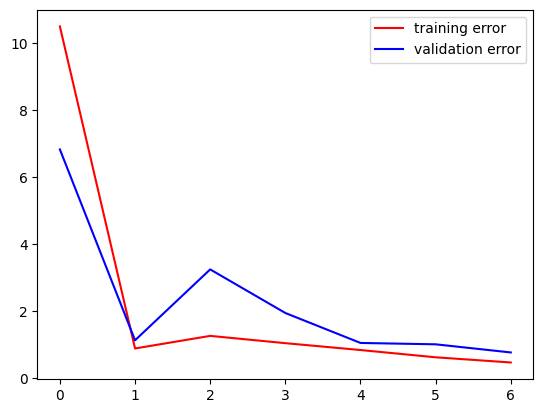

--------------------------------------------
Training = 35.0 %


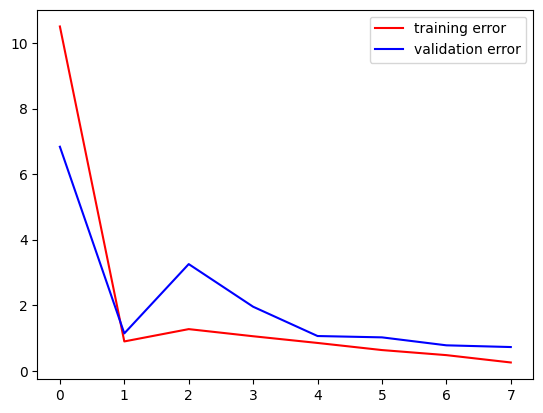

--------------------------------------------
Training = 40.0 %


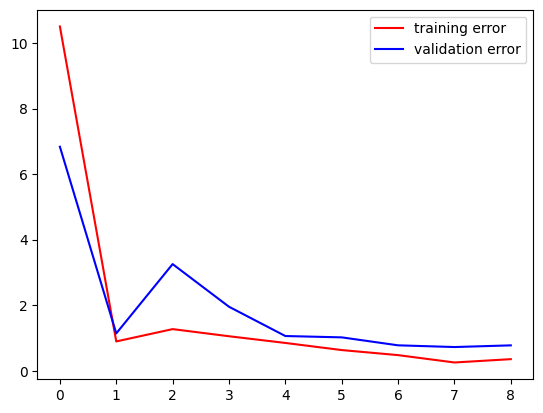

--------------------------------------------
Training = 45.0 %


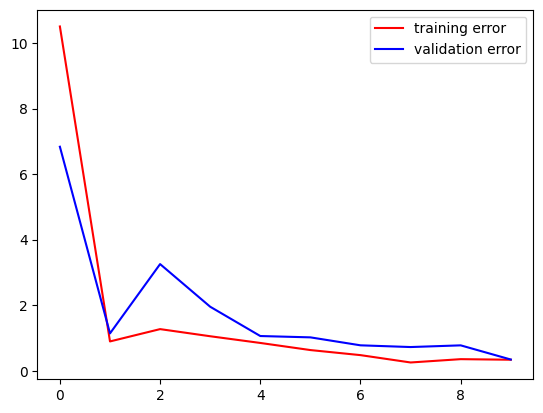

--------------------------------------------
Training = 50.0 %


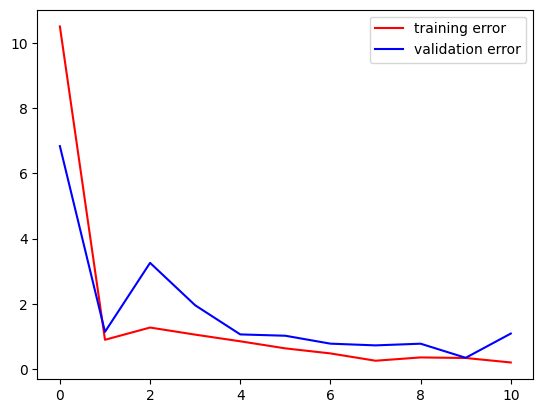

--------------------------------------------
Training = 55.0 %
epoch = 0
dim_clique = 50
training error = 0.1847175657749176
validation error = 0.46634578704833984
test error = 0.5475558042526245
--------------------------------------------
Training = 0.0 %


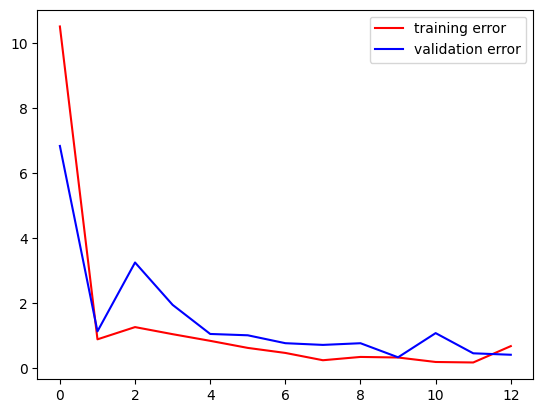

--------------------------------------------
Training = 5.0 %


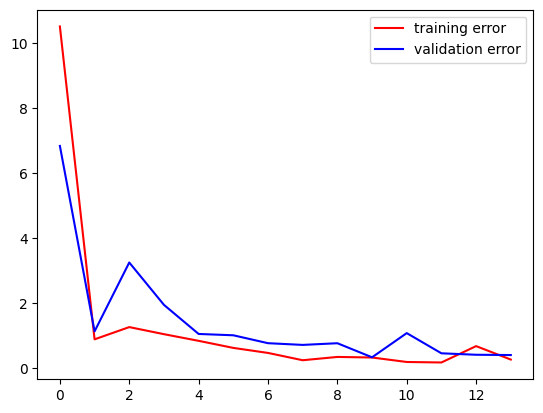

--------------------------------------------
Training = 10.0 %


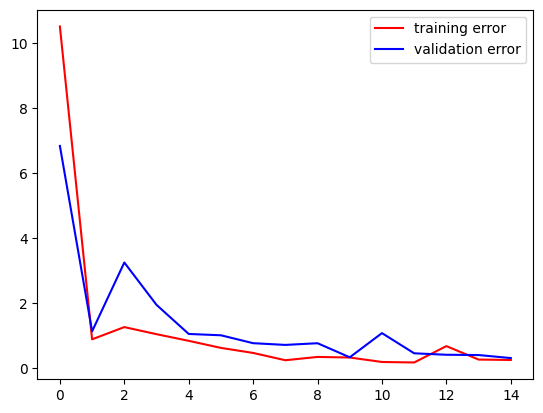

--------------------------------------------
Training = 15.0 %


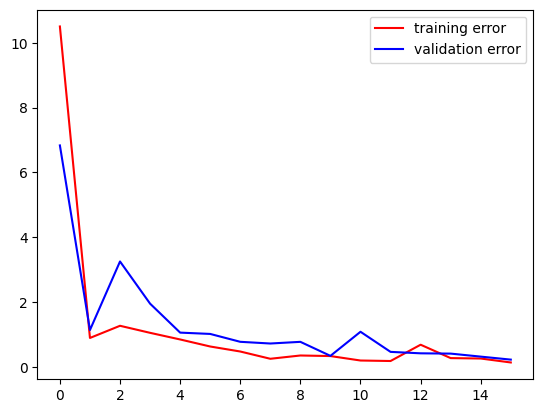

--------------------------------------------
Training = 20.0 %
epoch = 1
dim_clique = 50
training error = 0.2026321142911911
validation error = 0.09484102576971054
test error = 0.08802280575037003
--------------------------------------------
Early stop
--------------------------------------------


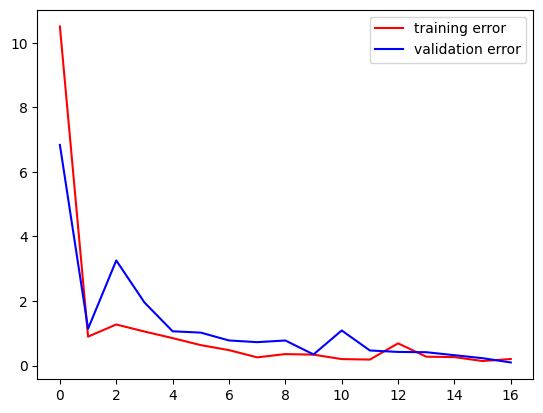

k/n = [5.0] % = [99.5]
Training = 0.0 %


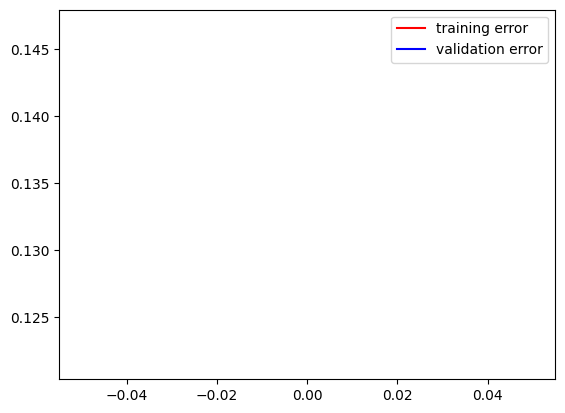

--------------------------------------------
Training = 5.0 %
epoch = 0
dim_clique = 45
training error = 0.10855148732662201
validation error = 0.07716044038534164
test error = 0.18883557617664337
--------------------------------------------
Early stop
--------------------------------------------


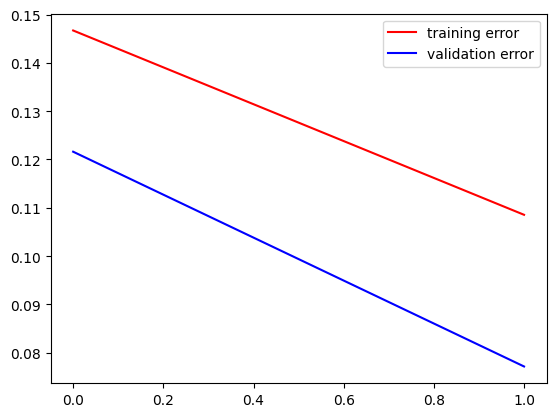

k/n = [5.0, 4.5] % = [99.5, 95.5]
Training = 0.0 %


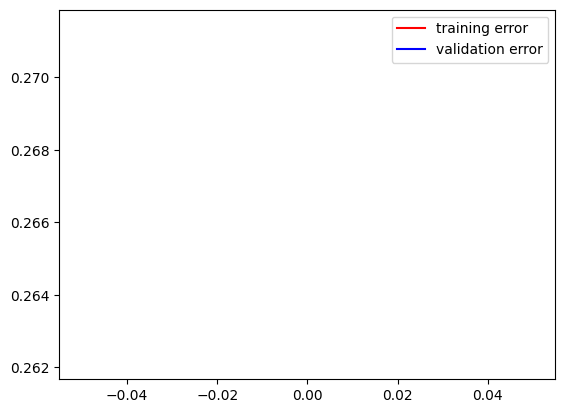

--------------------------------------------
Training = 5.0 %


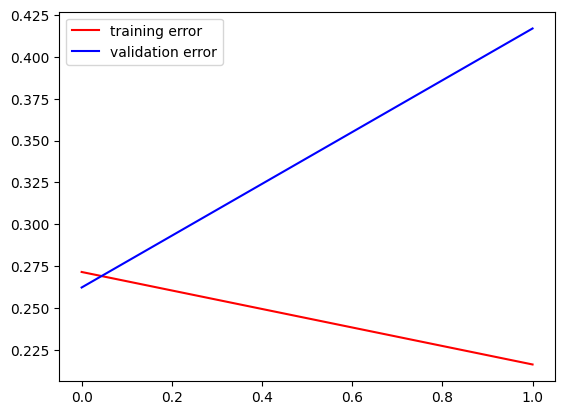

--------------------------------------------
Training = 10.0 %
epoch = 0
dim_clique = 40
training error = 0.12063299119472504
validation error = 0.09205921739339828
test error = 0.10754106193780899
--------------------------------------------
Early stop
--------------------------------------------


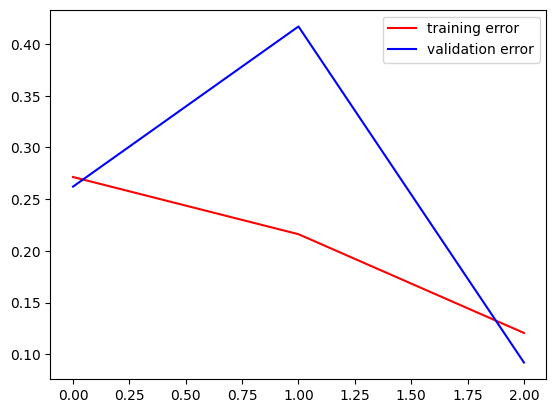

k/n = [5.0, 4.5, 4.0] % = [99.5, 95.5, 99.5]
Training = 0.0 %


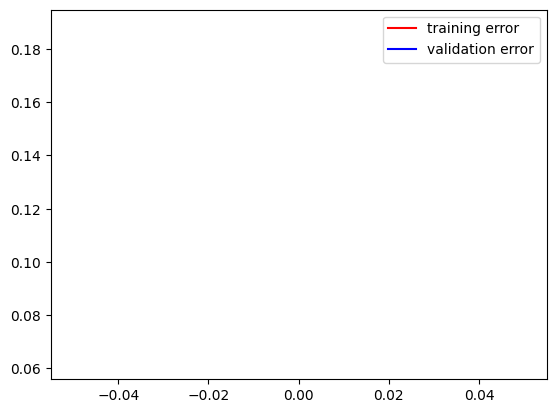

--------------------------------------------
Training = 5.0 %


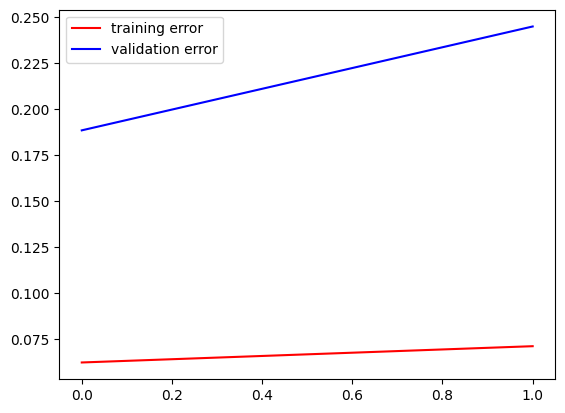

--------------------------------------------
Training = 10.0 %
epoch = 0
dim_clique = 35
training error = 0.036570850759744644
validation error = 0.06945910304784775
test error = 0.10002069175243378
--------------------------------------------
Early stop
--------------------------------------------


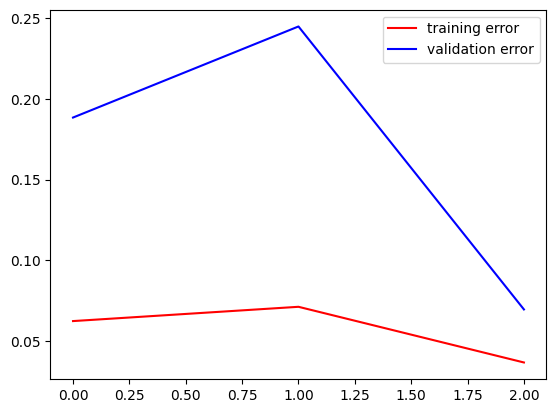

k/n = [5.0, 4.5, 4.0, 3.5] % = [99.5, 95.5, 99.5, 99.0]
Training = 0.0 %


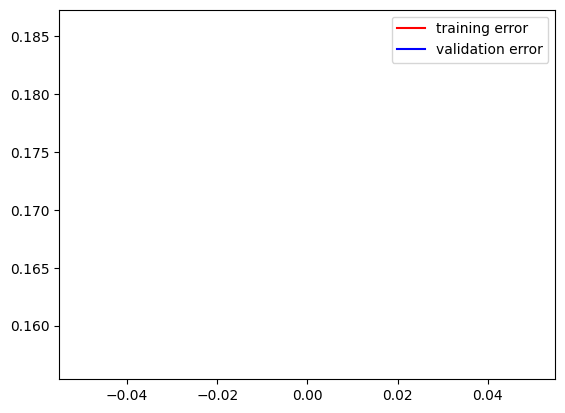

--------------------------------------------
Training = 5.0 %
epoch = 0
dim_clique = 30
training error = 0.1233259066939354
validation error = 0.08435366302728653
test error = 0.1032283678650856
--------------------------------------------
Early stop
--------------------------------------------


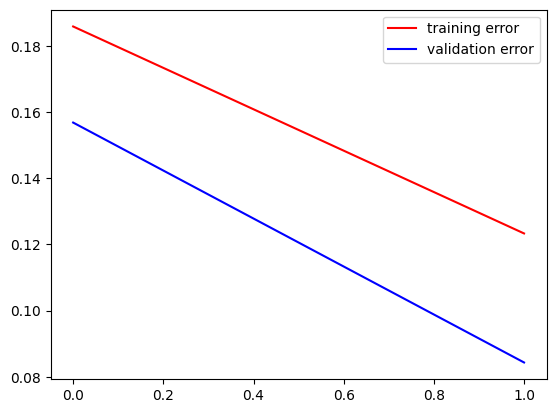

k/n = [5.0, 4.5, 4.0, 3.5, 3.0] % = [99.5, 95.5, 99.5, 99.0, 98.0]
Training = 0.0 %


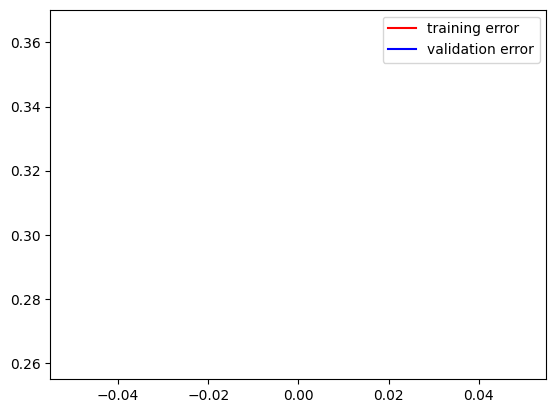

--------------------------------------------
Training = 5.0 %


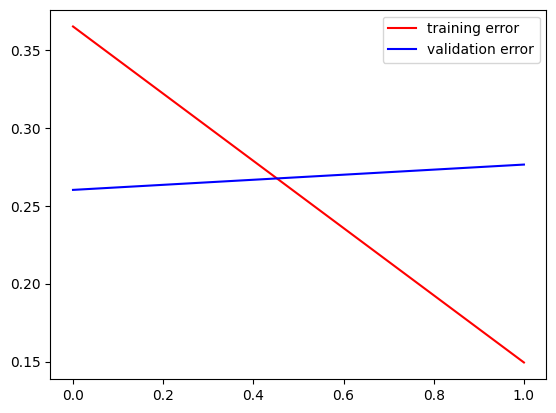

--------------------------------------------
Training = 10.0 %


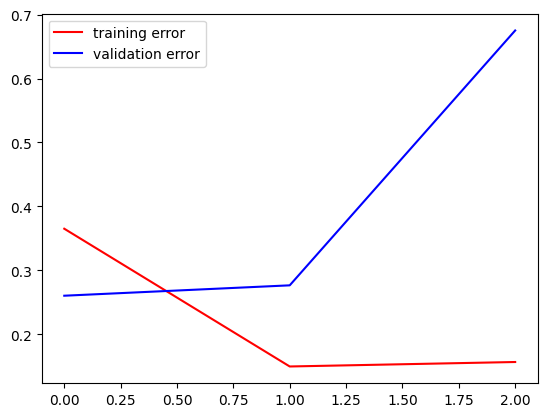

--------------------------------------------
Training = 15.0 %


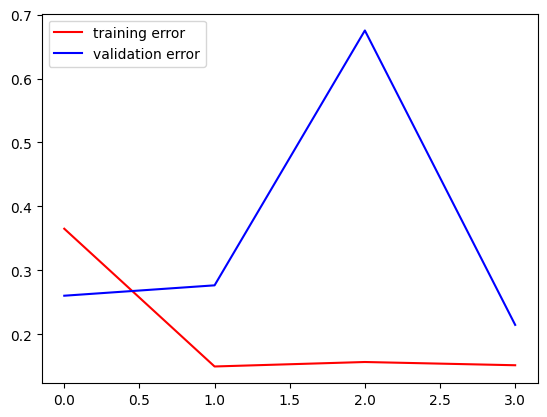

--------------------------------------------
Training = 20.0 %


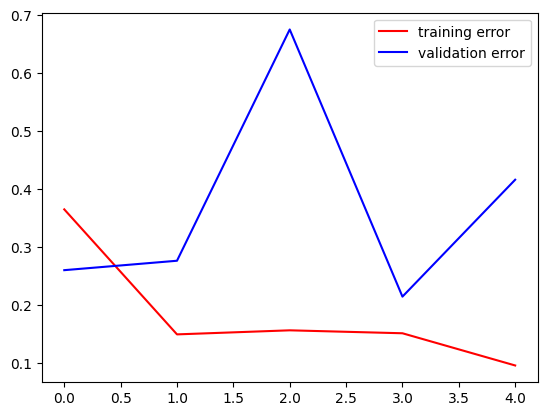

--------------------------------------------
Training = 25.0 %


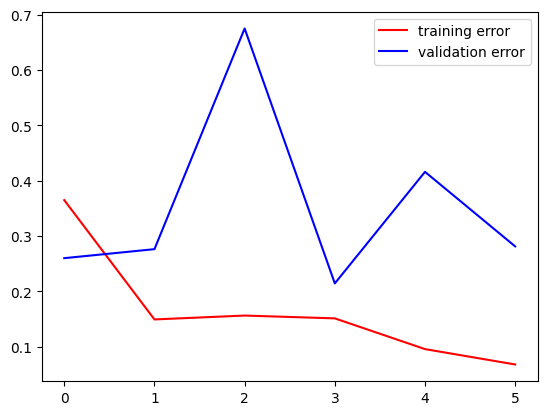

--------------------------------------------
Training = 30.0 %


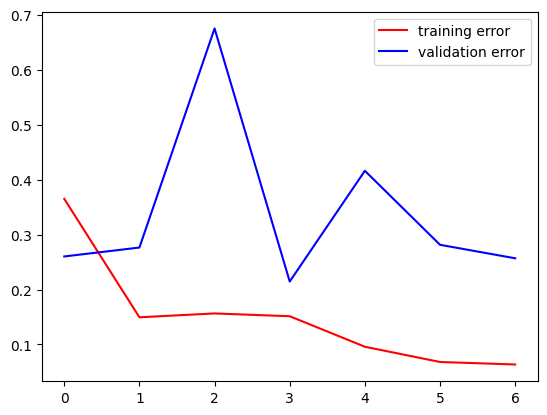

--------------------------------------------
Training = 35.0 %


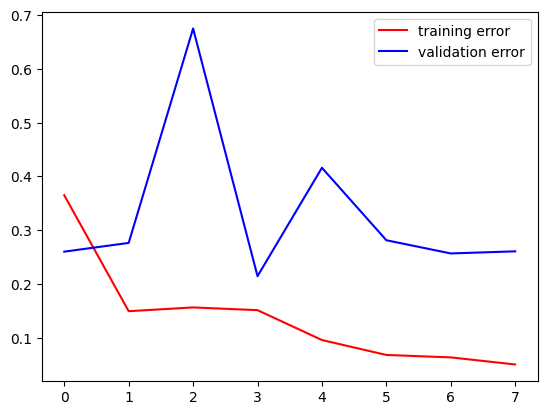

--------------------------------------------
Training = 40.0 %


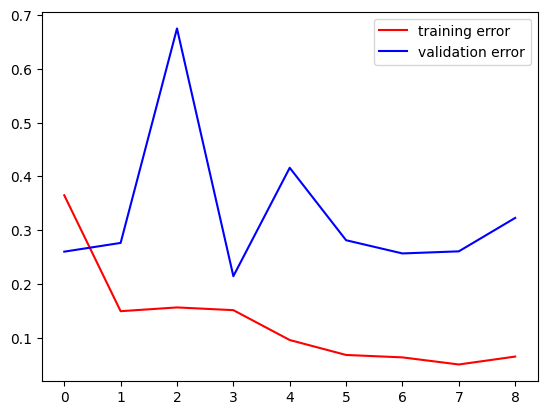

--------------------------------------------
Training = 45.0 %
epoch = 0
dim_clique = 25
training error = 0.029134605079889297
validation error = 0.3599596619606018
test error = 0.210947185754776
--------------------------------------------
Training = 0.0 %


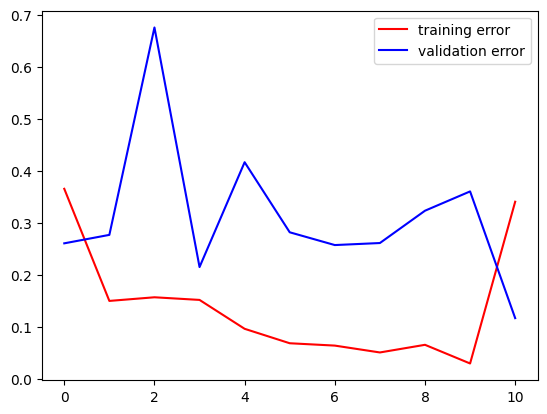

--------------------------------------------
Training = 5.0 %
epoch = 1
dim_clique = 25
training error = 0.19250163435935974
validation error = 0.05906631797552109
test error = 0.09789155423641205
--------------------------------------------
Early stop
--------------------------------------------


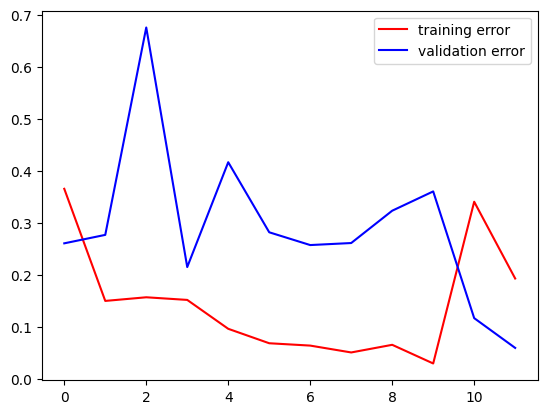

k/n = [5.0, 4.5, 4.0, 3.5, 3.0, 2.5] % = [99.5, 95.5, 99.5, 99.0, 98.0, 97.0]
Training = 0.0 %


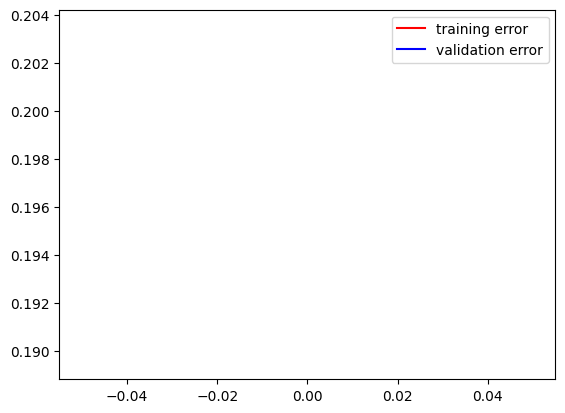

--------------------------------------------
Training = 5.0 %


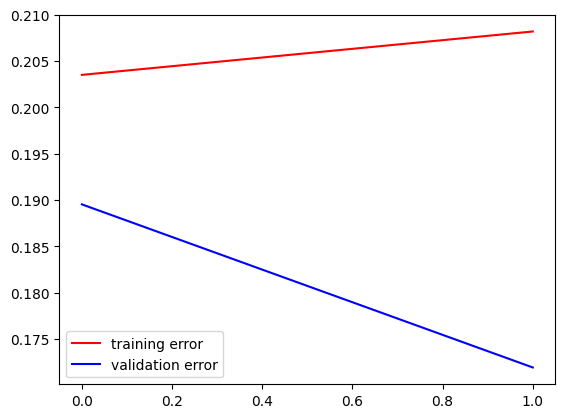

--------------------------------------------
Training = 10.0 %


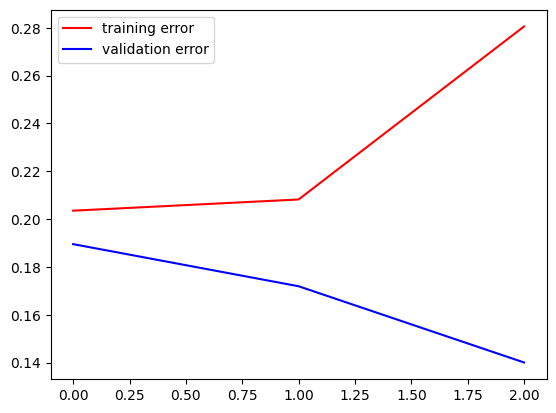

--------------------------------------------
Training = 15.0 %


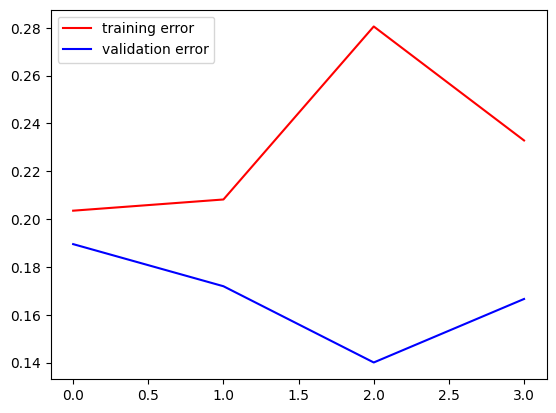

--------------------------------------------
Training = 20.0 %


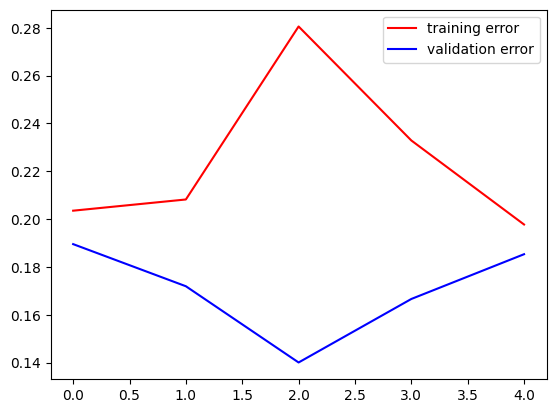

--------------------------------------------
Training = 25.0 %


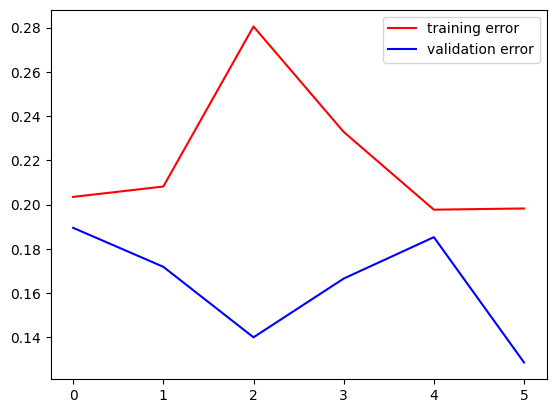

--------------------------------------------
Training = 30.0 %


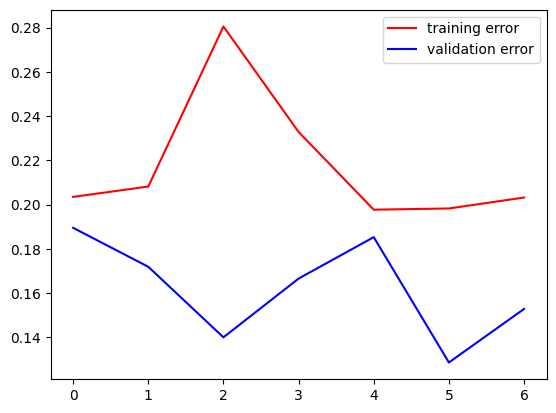

--------------------------------------------
Training = 35.0 %


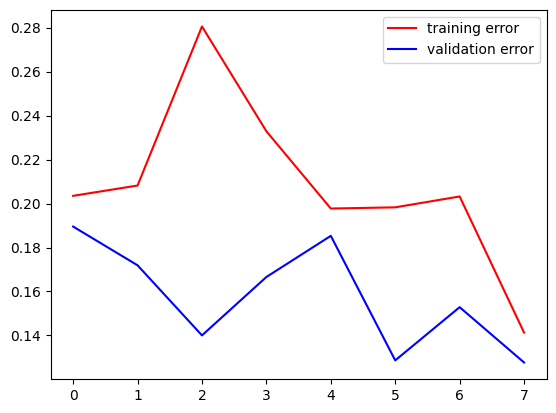

--------------------------------------------
Training = 40.0 %


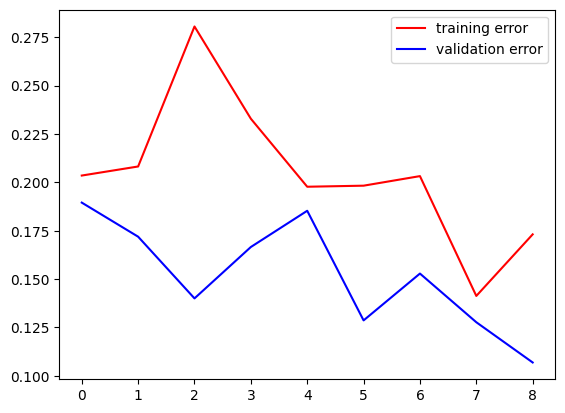

--------------------------------------------
Training = 45.0 %


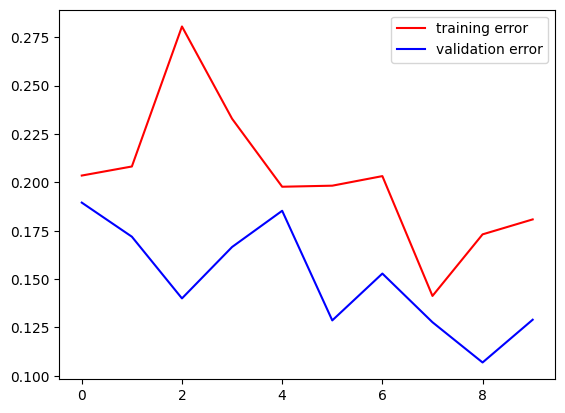

--------------------------------------------
Training = 50.0 %
epoch = 0
dim_clique = 20
training error = 0.17859894037246704
validation error = 0.09868927299976349
test error = 0.5133718252182007
--------------------------------------------
Early stop
--------------------------------------------


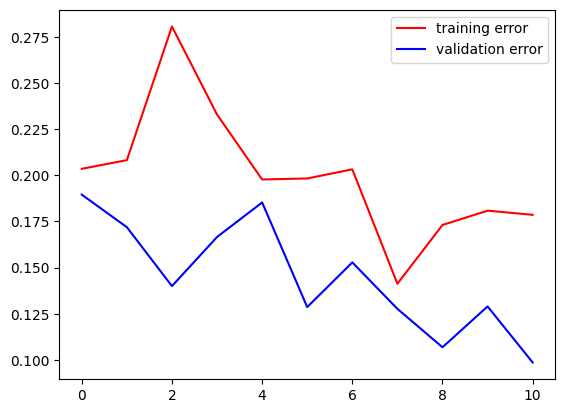

k/n = [5.0, 4.5, 4.0, 3.5, 3.0, 2.5, 2.0] % = [99.5, 95.5, 99.5, 99.0, 98.0, 97.0, 90.0]


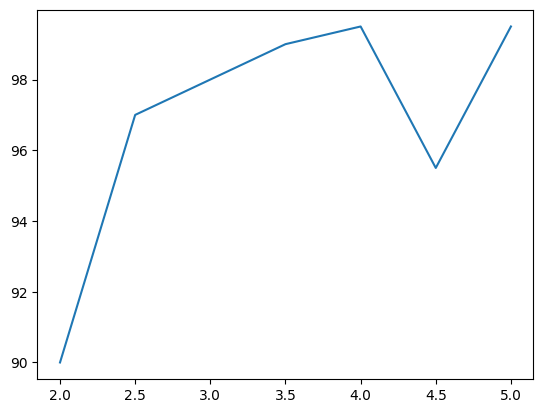

In [ ]:
epoch=10                  # number of epochs
max_steps=100             # maximum number of steps for each epoch
num_train=10              # dimension of the training set at each epoch
num_val=10               # dimension of the validation set
num_test=20              # dimension of the test set
dim_graph= 100            # number of nodes
start_dim_clique=50       # dimension of the clique to start with
jump=5                    # jump lengths for the first loop
save_step=5               # number of steps after which we check the early stopping criterion
stop = 19                     # clique size at which we stop
training_exit_error = 0.2    # training error below which we can stop early
validation_exit_error = 0.1  # validation error below which we can stop early
times=10

train_error=[]
val_error=[]

generalization=[]
k_over_sqrt_n=[]
for m in range(0,start_dim_clique - stop,jump):
  dim_clique = start_dim_clique - m
  test = GetClique(num_test,dim_graph,dim_clique,prob = 0.5)
  k_over_sqrt_n.append(1.0*dim_clique/math.sqrt(dim_graph))
  loss=1.0
  count=0

  for j in range(epoch):
    early_stop_counter=0
    min_validation_loss = np.inf
    train = GetClique(num_train,dim_graph,dim_clique, prob = 0.5)
    val = GetClique(num_val,dim_graph,dim_clique, prob = 0.5)
    for i in range(max_steps):
      output = model_g(train[0].to(device),train[1].to(device),train[2].to(device))
      loss=criterion(output.type(torch.float).to(device), torch.Tensor(train[3]).type(torch.long).to(device))

      # every "print_step" steps we save the error of the train and validation set
      if (i%save_step == 0):
        print('Training =',100.0*i/max_steps,'%')
        train_error.append(loss.item())
        check = model_g(val[0].to(device),val[1].to(device),val[2].to(device))   # checks the output on the validation set
        val_loss = criterion(check.to(device), torch.Tensor(val[3]).type(torch.long).to(device)).item()
        val_error.append(val_loss)

        # early_stopping needs the validation loss to check if it has decresed,
        # and if it has, it will make a checkpoint of the current model
        early_exit,min_validation_loss,early_stop_counter = EarlyStopper(np.array(val_error), early_stop_counter, min_validation_loss)
        if (val_error[count]<validation_exit_error or (early_exit and train_error[count]<training_exit_error)):
          count=count+1
          break

        count=count+1
        if (count > 30):
          # plot of test and validation error curves
          x_axis = np.arange(30)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[count-30:count], 'r', label='training error')
          ax.plot(x_axis, val_error[count-30:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')
        else:
          # plot of test and validation error curves
          x_axis = np.arange(count)
          fig, ax = plt.subplots()
          ax.plot(x_axis, train_error[:count], 'r', label='training error')
          ax.plot(x_axis, val_error[:count], 'b', label='validation error')
          ax.legend()
          plt.show()
          print('--------------------------------------------')

      loss.backward()
      optim.step()
      optim.zero_grad(set_to_none=True)


    # test error
    test_output = model_g(test[0].to(device),test[1].to(device),test[2].to(device))   # checks the output on the test set
    test_error = criterion(test_output.to(device), torch.Tensor(test[3]).type(torch.long).to(device))
    if (j%1 == 0):
      print('epoch =',j)
      print('dim_clique =',dim_clique)
      print('training error =', train_error[count-1])
      print('validation error =',val_error[count-1])
      print('test error =',test_error.item())
      print('--------------------------------------------')

    if (val_error[count-1]<validation_exit_error):
          print('Early stop')
          print('--------------------------------------------')
          break
  # plot of test and validation error curves
  x_axis = np.arange(count)
  fig, ax = plt.subplots()
  ax.plot(x_axis, train_error[:count], 'r', label='training error')
  ax.plot(x_axis, val_error[:count], 'b', label='validation error')
  ax.legend()
  plt.show()

  train_error=[]
  val_error=[]

  mean=0
  for j in range(times):
    data = GetClique(num_test,dim_graph,dim_clique)
    hard_output = torch.zeros([num_test,2])

    soft_output = model_g(data[0].to(device),data[1].to(device),data[2].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[3])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization.append(mean)

  print('k/n =', k_over_sqrt_n, '% =', generalization)
  print('==========================================')

plt.plot(k_over_sqrt_n,generalization)

Here we check the generalization error and we compute the transition at which the GNN starts to fail.

k = 85 ----> % = 100.0
k = 84 ----> % = 100.0
k = 83 ----> % = 100.0
k = 82 ----> % = 100.0
k = 81 ----> % = 100.0
k = 80 ----> % = 100.0
k = 79 ----> % = 100.0
k = 78 ----> % = 100.0
k = 77 ----> % = 100.0
k = 76 ----> % = 100.0
k = 75 ----> % = 100.0
k = 74 ----> % = 100.0
k = 73 ----> % = 100.0
k = 72 ----> % = 100.0
k = 71 ----> % = 100.0
k = 70 ----> % = 100.0
k = 69 ----> % = 100.0
k = 68 ----> % = 100.0
k = 67 ----> % = 100.0
k = 66 ----> % = 100.0
k = 65 ----> % = 100.0
k = 64 ----> % = 100.0
k = 63 ----> % = 100.0
k = 62 ----> % = 100.0
k = 61 ----> % = 100.0
k = 60 ----> % = 100.0
k = 59 ----> % = 100.0
k = 58 ----> % = 100.0
k = 57 ----> % = 100.0
k = 56 ----> % = 100.0
k = 55 ----> % = 100.0
k = 54 ----> % = 100.0
k = 53 ----> % = 100.0
k = 52 ----> % = 100.0
k = 51 ----> % = 99.66666666666667
k = 50 ----> % = 100.0
k = 49 ----> % = 100.0
k = 48 ----> % = 99.33333333333333
k = 47 ----> % = 99.33333333333333
k = 46 ----> % = 100.0
k = 45 ----> % = 99.66666666666667
k = 44 --

k = 3 ----> % = 47.333333333333336
k over sqrt(n) = [8.5, 8.4, 8.3, 8.2, 8.1, 8.0, 7.9, 7.8, 7.7, 7.6, 7.5, 7.4, 7.3, 7.2, 7.1, 7.0, 6.9, 6.8, 6.7, 6.6, 6.5, 6.4, 6.3, 6.2, 6.1, 6.0, 5.9, 5.8, 5.7, 5.6, 5.5, 5.4, 5.3, 5.2, 5.1, 5.0, 4.9, 4.8, 4.7, 4.6, 4.5, 4.4, 4.3, 4.2, 4.1, 4.0, 3.9, 3.8, 3.7, 3.6, 3.5, 3.4, 3.3, 3.2, 3.1, 3.0, 2.9, 2.8, 2.7, 2.6, 2.5, 2.4, 2.3, 2.2, 2.1, 2.0, 1.9, 1.8, 1.7, 1.6, 1.5, 1.4, 1.3, 1.2, 1.1, 1.0, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3] % = [100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 100.0, 99.66666666666667, 100.0, 100.0, 99.33333333333333, 99.33333333333333, 100.0, 99.66666666666667, 98.33333333333333, 99.0, 98.66666666666667, 99.33333333333333, 98.33333333333333, 99.33333333333333, 98.66666666666667, 97.66666666666667, 96.66666666666667, 98.66666666666667, 96.333333333333

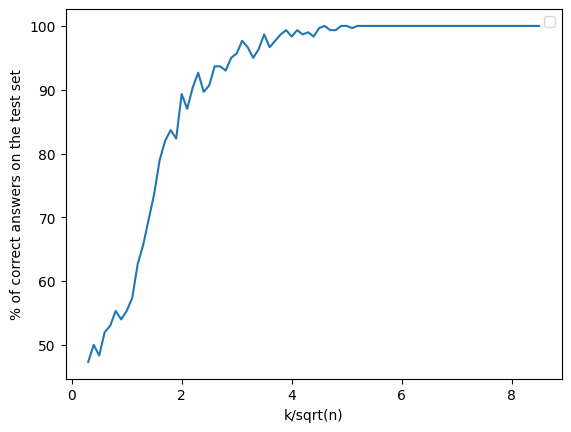

In [ ]:
start_dim_clique=85
stop = 2
times = 15

generalization_GNN = []
k_vs_sqrt_n_GNN = []

for m in range(0,start_dim_clique - stop,1):
  dim_clique = start_dim_clique - m
  k_vs_sqrt_n_GNN.append(1.0*dim_clique/math.sqrt(dim_graph))
  mean = 0

  for j in range(times):
    data = GetClique(num_test,dim_graph,dim_clique)
    hard_output = torch.zeros([num_test,2])

    soft_output = model_g(data[0].to(device),data[1].to(device),data[2].to(device))
    for l in range(num_test):
      if (soft_output[l][0] > soft_output[l][1]):
        hard_output[l][0] = 1.0
      else: hard_output[l][1] = 1.0
    predicted_output = hard_output

    mean = mean + 100*(1-torch.sum(torch.square(torch.Tensor(data[3])-torch.transpose(predicted_output,1,0)[1])).item()/(1.0*num_test))

  mean = mean/times
  generalization_GNN.append(mean)
  print('k =',dim_clique,'---->', '% =', mean)
  print('==========================================')
print('k over sqrt(n) =', list(k_vs_sqrt_n_GNN), '% =', list(generalization_GNN))
print('==========================================')

fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_GNN,generalization_GNN)
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()

# Performance Comparison

This is a comparison of the performance between the different models we tested on the problem

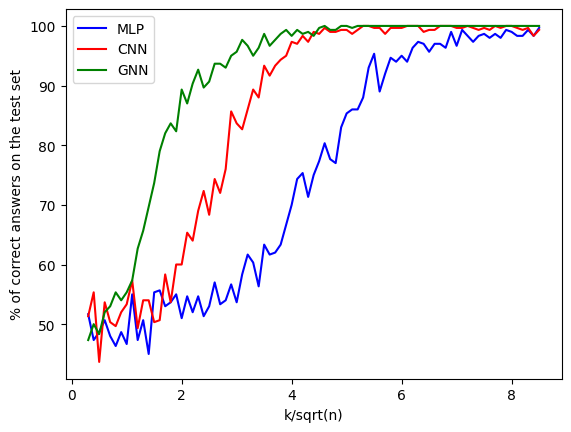

In [ ]:
fig, ax = plt.subplots()
ax.plot(k_vs_sqrt_n_MLP,generalization_MLP, 'b', label='MLP')
ax.plot(k_vs_sqrt_n_CNN,generalization_CNN, 'r', label='CNN')
ax.plot(k_vs_sqrt_n_GNN,generalization_GNN, 'g', label='GNN')
plt.xlabel('k/sqrt(n)')
plt.ylabel('% of correct answers on the test set')
ax.legend()
plt.show()